In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm
from dynamics import SatelliteDynamics
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Process noise
q_chief_pos = 1e-1  # [m]
q_chief_vel = 1e-2 # [m / s]
Q_chief = (
    np.diag(np.concatenate([q_chief_pos * np.ones(3), q_chief_vel * np.ones(3)]))
    ** 2
)
q_deputy_pos = 1e0  # [m]
q_deputy_vel = 1e-2  # [m / s]
Q_deputy = (
    np.diag(np.concatenate([q_deputy_pos * np.ones(3), q_deputy_vel * np.ones(3)]))
    ** 2
)
Q_deputies = block_diag(Q_deputy, Q_deputy, Q_deputy)
Q = block_diag(Q_chief, Q_deputies)

# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [4]:
def h_function_chief(x_vec):
    """
    Computes the measurement vector based on the current state vector.
    The measurement vector includes position components.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).
    """
    return x_vec[0:3]

def h_function_deputy(x_vec):
    """
    Computes the measurement vector based on the current state vector.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).

    Returns:
    y (np.array): The measurement vector of the satellite (range [km]).
    """
    r_chief = x_vec[:3]
    r_deputy1 = x_vec[6:9]
    r_deputy2 = x_vec[12:15]
    r_deputy3 = x_vec[18:21]

    range_deputy1_chief = np.linalg.norm(r_deputy1 - r_chief)
    range_deputy1_deputy2 = np.linalg.norm(r_deputy1 - r_deputy2)
    range_deputy1_deputy3 = np.linalg.norm(r_deputy1 - r_deputy3)
    range_deputy2_chief = np.linalg.norm(r_deputy2 - r_chief)
    range_deputy2_deputy3 = np.linalg.norm(r_deputy2 - r_deputy3)
    range_deputy3_chief = np.linalg.norm(r_deputy3 - r_chief)

    return np.array(
        [
            [range_deputy1_chief],
            [range_deputy1_deputy2],
            [range_deputy1_deputy3],
            [range_deputy2_chief],
            [range_deputy2_deputy3],
            [range_deputy3_chief],
        ]
    )

def h(x_vec):
    return np.concatenate([h_function_chief(x_vec), h_function_deputy(x_vec)])

In [5]:
# Simulation setup
np.random.seed(42)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [6]:
def surrogate_function(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the surrogate function Φ_ij.
    
    Args:
        x_i, x_j: Current position vectors for agents i and j
        z_i, z_j: Previous iteration position vectors (denoted as bar_x in the equation)
        d_ij: True measurement between agents i and j
        sigma: Standard deviation parameter
    """
    # Compute the norm of the difference between previous positions
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    
    # Term 1: ||x_i - bar_x_i||^2 / sigma^2
    term1 = np.linalg.norm(P @ x_i - P @ z_i)**2 / sigma**2
    
    # Term 2: (||bar_x_i - bar_x_j|| - d_ij) * (x_i - bar_x_i)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term2 = ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_i - P @ z_i).T @ (P @ z_i - P @ z_j)
    
    # Term 3: ||x_j - bar_x_j||^2 / sigma^2
    term3 = np.linalg.norm(P @ x_j - P @ z_j)**2 / sigma**2
    
    # Term 4: -(||bar_x_i - bar_x_j|| - d_ij) * (x_j - bar_x_j)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term4 = -((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_j - P @ z_j).T @ (P @ z_i - P @ z_j)
    
    # Term 5: ||bar_x_i - bar_x_j||^2 / (2*sigma^2)
    term5 = z_ij_norm**2 / (2 * sigma**2)
    
    # Term 6: -d_ij * ||bar_x_i - bar_x_j|| / sigma^2
    term6 = -(d_ij * z_ij_norm) / sigma**2
    
    # Term 7: d_ij^2 / (2*sigma^2)
    term7 = d_ij**2 / (2 * sigma**2)
    
    return term1 + term2 + term3 + term4 + term5 + term6 + term7

def surrogate_gradient(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the gradient of the surrogate function Φ_ij.
    """
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    z_ij = P @ z_i - P @ z_j
    
    # Gradient with respect to x_i
    grad_i = (2/sigma**2) * P.T @ (P @ x_i - P @ z_i) + ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    # Gradient with respect to x_j
    grad_j = (2/sigma**2) * P.T @ (P @ x_j - P @ z_j) - ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    return grad_i, grad_j

def surrogate_hessian(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the Hessian of the surrogate function Φ_ij.
    """
    n = len(x_i)
    
    # The Hessian is constant with respect to x_i and x_j
    H_ii = (2/sigma**2) * P.T @ P
    H_ij = P.T @ np.zeros((n, n)) @ P
    H_ji = P.T @ np.zeros((n, n)) @ P
    H_jj = (2/sigma**2) * P.T @ P
    
    return H_ii, H_ij, H_ji, H_jj

In [7]:
def f(x_0, y, z_0=None):
    """
    Cost function combining direct measurements and surrogate terms.
    """
    f_x_0 = 0
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions for each satellite
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    for k in range(W):    
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1/2 * residual.T @ np.linalg.inv(R_chief) @ residual

        # Deputy-to-chief measurements
        y_21_k = y_rel_k[0]  # Deputy 1 to chief
        y_31_k = y_rel_k[3]  # Deputy 2 to chief
        y_41_k = y_rel_k[5]  # Deputy 3 to chief

        # Process direct measurements (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_21_k),
            (3, 1, x_3_k, x_1_k, y_31_k),
            (4, 1, x_4_k, x_1_k, y_41_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * r_deputy_pos**2)

        # 2. Surrogate terms for residual edges (between deputies)
        pairs_surrogate = [
            (x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1]),  # Deputies 1-2
            (x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2]),  # Deputies 1-3
            (x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4]),  # Deputies 2-3
        ]

        for x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k in pairs_surrogate:
            f_x_0 += surrogate_function(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)

        if k < W - 1:
            # Propagate states
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return f_x_0

def grad_f(x_0, y, z_0=None):
    """
    Gradient of cost function.
    """
    grad_f_x_0 = np.zeros_like(x_0)
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements gradient
        grad_f_x_0[:n_x, :] -= F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ (y_1_k - P @ x_1_k)

        # Process direct measurements gradients (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            grad_i = -(y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_j = (y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += grad_j

        # 2. Surrogate terms gradients (between deputies)
        pairs_surrogate = [
            (2, 3, x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            grad_i, grad_j = surrogate_gradient(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += STM_t0_i.T @ grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += STM_t0_j.T @ grad_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return grad_f_x_0

def hessian_f(x_0, y, z_0=None):
    """
    Hessian of cost function combining direct measurements and surrogate terms.
    """
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements Hessian
        hessian_f_x_0[:n_x, :n_x] += F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ P @ F_1_k

        # Process direct measurements Hessian (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            # Compute Hessian blocks for direct measurements
            H_term = 1/r_deputy_pos**2 * (
                ((y_ij_k - d_ij_k)/d_ij_k) * P.T @ P -
                (y_ij_k/d_ij_k**3) * P.T @ (d_ij_k_vec @ d_ij_k_vec.T) @ P
            )
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] -= STM_t0_i.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_term @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] -= STM_t0_j.T @ H_term @ STM_t0_j

        # 2. Surrogate terms Hessian (between deputies)
        pairs_surrogate = [
            (2, 3, P @ x_2_k, P @ x_3_k, P @ z_2_k, P @ z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, P @ x_2_k, P @ x_4_k, P @ z_2_k, P @ z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, P @ x_3_k, P @ x_4_k, P @ z_3_k, P @ z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            H_ii, H_ij, H_ji, H_jj = surrogate_hessian(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks with surrogate terms
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] += STM_t0_i.T @ H_ii @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_ij @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_ji @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] += STM_t0_j.T @ H_jj @ STM_t0_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return hessian_f_x_0

# def numerical_gradient(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical gradient of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         STM (numpy.ndarray): State transition matrix.
#         y (numpy.ndarray): Observed data.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical gradient of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     grad = np.zeros_like(x_0)
#     for i in range(x_0.size):
#         # Create perturbed versions of x_0
#         x_0_plus = x_0.copy()
#         x_0_minus = x_0.copy()
        
#         # Add and subtract epsilon to the i-th component
#         x_0_plus[i] += epsilon
#         x_0_minus[i] -= epsilon
        
#         # Compute the function value for perturbed inputs
#         f_plus = f(x_0_plus, y, z_0)
#         f_minus = f(x_0_minus, y, z_0)
        
#         # Central difference approximation
#         grad[i] = (f_plus - f_minus) / (2 * epsilon)
    
#     return grad

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 0
# W = 100
# numerical_grad = numerical_gradient(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# analytical_grad = grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# print("Numerical Gradient:", numerical_grad)
# print("Analytical Gradient:", analytical_grad)
# print("Gradient Difference:", numerical_grad - analytical_grad)
# -np.linalg.inv(hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])) @ grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# def numerical_hessian(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical Hessian of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         y (numpy.ndarray): Observed data.
#         z_0 (numpy.ndarray, optional): Previous iteration state vector.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical Hessian of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     n = x_0.size
#     H = np.zeros((n, n))
    
#     for i in range(n):
#         for j in range(n):
#             # Create perturbed versions of x_0
#             x_pp = x_0.copy()  # x plus-plus
#             x_pm = x_0.copy()  # x plus-minus
#             x_mp = x_0.copy()  # x minus-plus
#             x_mm = x_0.copy()  # x minus-minus
            
#             # Add/subtract epsilon to the i,j components
#             x_pp[i] += epsilon
#             x_pp[j] += epsilon
            
#             x_pm[i] += epsilon
#             x_pm[j] -= epsilon
            
#             x_mp[i] -= epsilon
#             x_mp[j] += epsilon
            
#             x_mm[i] -= epsilon
#             x_mm[j] -= epsilon
            
#             # Compute function values and ensure they're scalar
#             f_pp = f(x_pp, y, z_0).item()
#             f_pm = f(x_pm, y, z_0).item()
#             f_mp = f(x_mp, y, z_0).item()
#             f_mm = f(x_mm, y, z_0).item()
            
#             # Central difference approximation for second derivative
#             H[i, j] = (f_pp - f_pm - f_mp + f_mm) / (4 * epsilon * epsilon)
    
#     return H

# # Example usage to test:
# n = 0  # time index
# m = 0  # previous iteration time index
# W = 1  # window size

# numerical_H = numerical_hessian(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])
# analytical_H = hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# print("Numerical Hessian:", numerical_H)
# print("Analytical Hessian:", analytical_H)
# print("Hessian Difference:", np.linalg.norm(numerical_H - analytical_H))

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 10
# W = 10
# Y = np.zeros((9, 1, T))
# for t in range(T):
#     Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
# x_init = np.zeros((4 * n_x, 1))
# x_init[:4*n_x, :] = X_est[:, :, 0]
# f(x_init, Y[:, :, n:n + W]), f(x_init, Y[:, :, n:n + W], X_true[:, :, m]), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W])), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W], X_true[:, :, m]))

In [8]:
def L(x_0, y, z_0=None):
    """
    Lagrangian wrapper for the cost function.
    """
    return f(x_0, y, z_0)
    
def grad_L(x_0, y, z_0=None):
    """
    Gradient of Lagrangian wrapper.
    """
    return grad_f(x_0, y, z_0)

def hessian_L(x_0, y, z_0=None):
    """
    Hessian of Lagrangian wrapper.
    """
    return hessian_f(x_0, y, z_0)

In [9]:

class MM_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20, mm_tol=1e0, mm_max_iter=5):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        self.mm_tol = mm_tol
        self.mm_max_iter = mm_max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
        z = x_init.copy()  # Initialize z as current iterate
        
        for mm_iter in range(self.mm_max_iter):
            print(f"\nMajorization-Minimization Iteration {mm_iter + 1}")
            
            prev_cost_function_value = None
            prev_grad_norm_value = None
            prev_global_error = None
            
            # Solve the surrogate problem
            for iteration in range(self.max_iter):
                # Compute the cost function, gradient and Hessian using current z
                L_x = L(x, Y, z)
                grad_L_x = grad_L(x, Y, z)
                hessian_L_x = hessian_L(x, Y, z)

                # Convergence tracking
                cost_function_value = L_x[0][0]
                grad_norm_value = np.linalg.norm(grad_L_x)

                # Store the norms
                self.cost_function_values.append(cost_function_value)
                self.grad_norm_values.append(grad_norm_value)
                
                if prev_cost_function_value is not None:
                    cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                    grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                    global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
                prev_cost_function_value = cost_function_value
                prev_grad_norm_value = grad_norm_value
                prev_global_error = np.linalg.norm(x - X_true)

                # Check convergence and print metrics
                if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                    print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                    break
                else:
                    if iteration == 0:
                        print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                    else:
                        print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                        
                # Print relative errors 
                print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                
                # Solve for the Newton step
                delta_x = solve(hessian_L_x, -grad_L_x)
                x += delta_x
            
            # Update z for next majorization step
            if np.linalg.norm(x - z) < self.mm_tol:
                print(f"Majorization-Minimization converged after {mm_iter + 1} iterations")
                break
            
            # Update z for next majorization step
            z = x.copy()

        return x

In [10]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2766688490.2623305
Gradient norm: 75893974050.39305
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: 317007114.51137036 (-88.54%)
Gradient norm: 33238918.67160553 (-99.96%)
Global relative error = 385.3114196441972 (-2.60%)
Position relative errors: 2.236142993082619 m, 182.70183835791485 m, 236.67640649981826 m, 243.0307304335651 m

Iteration 2
Cost function: 316999421.7379867 (-0.00%)
Gradient norm: 1854.6931064241583 (-99.99%)
Global relative error = 386.60885604081085 (0.34%)
Position relative errors: 2.188321676285373 m, 183.49280494724403 m, 237.33162312200494 m, 243.85535947485292 m

Iteration 3
Cost function: 316999421.7378237 (-0.00%)
Gradient norm: 2.9403892986235944 (-99.84%)
Global relative error = 386.6088866702108 (0.00%)
Position relative errors: 2.18832289615

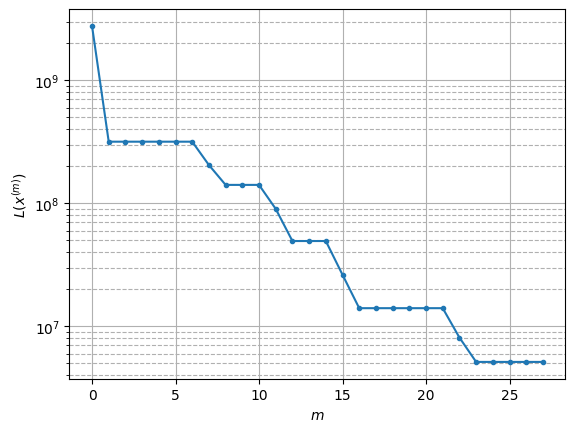

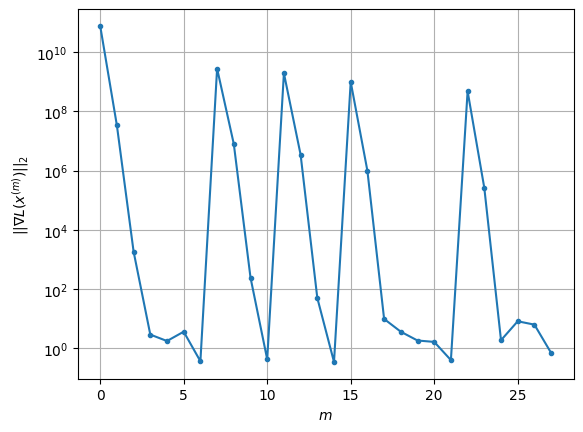

Windows:   0%|          | 1/296 [01:12<5:55:31, 72.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3722247.2526731603
Gradient norm: 271586451.9201731
Global relative error: 222.97261170082552
Position relative errors: 0.39738592772318493 m, 25.463529039203767 m, 207.9685224630719 m, 76.27020869724983 m

Iteration 1
Cost function: 2758410.364954439 (-25.89%)
Gradient norm: 85817.93289128815 (-99.97%)
Global relative error = 218.00241214006925 (-2.23%)
Position relative errors: 0.2788562848950889 m, 29.836504125747663 m, 206.48620502439687 m, 63.23003719627508 m

STOP on Iteration 2
Cost function = 2758410.2683666935 (-0.00%)
Gradient norm = 0.8963898765675625 (-100.00%)
Global relative error = 218.00528765381088 (0.00%)
Final position relative errors: 0.27954772761441904 m, 29.835377422211238 m, 206.48766514541595 m, 63.23571149126711 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 2169497.8583249208
Gradient norm: 177449053.93814498
Global relative error: 218.0

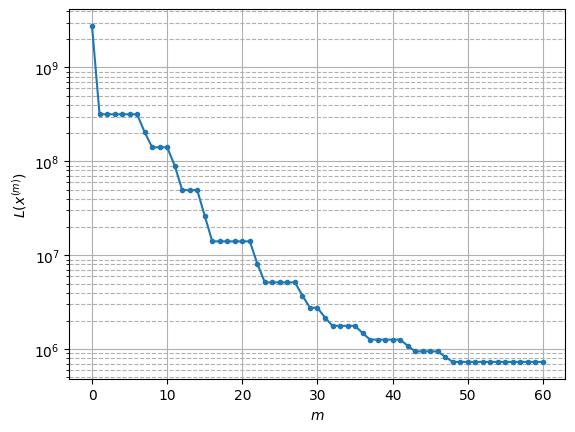

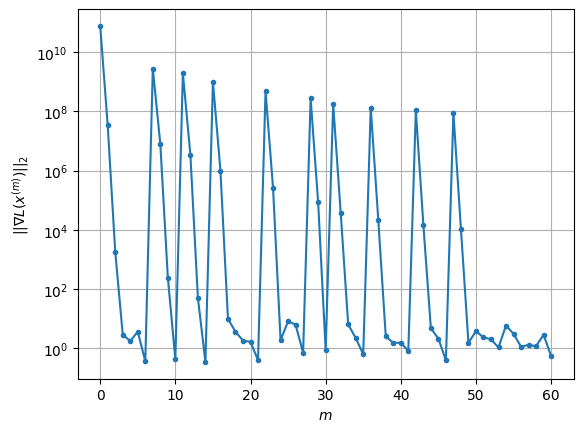

Windows:   1%|          | 2/296 [02:35<6:25:20, 78.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 646888.0582925787
Gradient norm: 74799604.00318107
Global relative error: 240.0066498951949
Position relative errors: 0.15988481213349998 m, 30.59133639410574 m, 207.39362267343876 m, 116.85500588598009 m

Iteration 1
Cost function: 575483.2884179255 (-11.04%)
Gradient norm: 8270.19923881372 (-99.99%)
Global relative error = 245.06913548173327 (2.11%)
Position relative errors: 0.16319832315768215 m, 32.60936370005855 m, 207.08197163278155 m, 126.93469218460457 m

STOP on Iteration 2
Cost function = 575483.2854298048 (-0.00%)
Gradient norm = 0.40397464857461585 (-100.00%)
Global relative error = 245.070213537405 (0.00%)
Final position relative errors: 0.16356529583703977 m, 32.60769390358323 m, 207.0816667604115 m, 126.93769938591618 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 514992.5604186637
Gradient norm: 62761053.75116595
Global relative error: 245.07021353

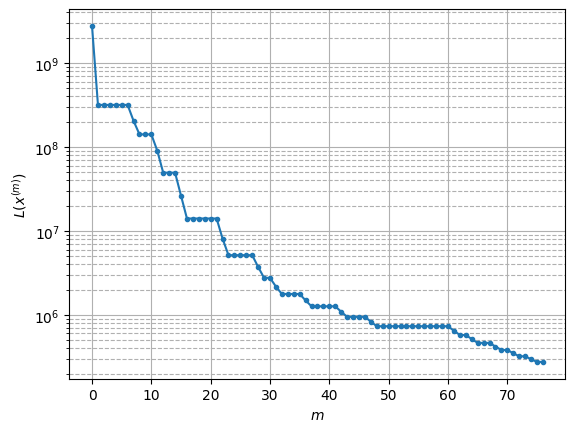

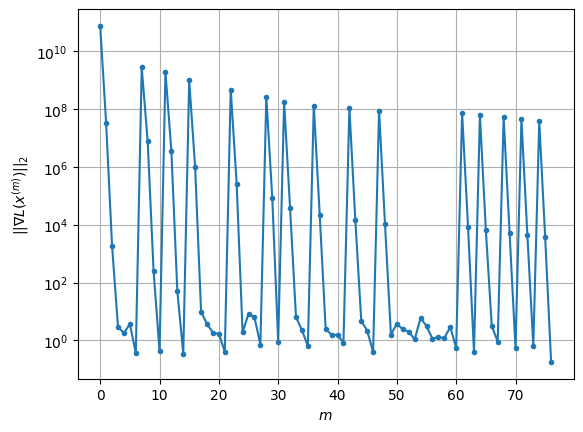

Windows:   1%|          | 3/296 [03:16<5:01:28, 61.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 251257.57732435362
Gradient norm: 32131869.332767308
Global relative error: 258.76026889030095
Position relative errors: 0.15910321023470864 m, 27.387075646897475 m, 202.95288625116632 m, 158.1670580768504 m

Iteration 1
Cost function: 234612.2574226899 (-6.62%)
Gradient norm: 3134.495571427693 (-99.99%)
Global relative error = 260.40453714539296 (0.64%)
Position relative errors: 0.1323210396912122 m, 29.051283865753426 m, 201.4521513681717 m, 162.42984515346987 m

STOP on Iteration 2
Cost function = 234612.2569948896 (-0.00%)
Gradient norm = 0.23066089940494658 (-99.99%)
Global relative error = 260.40473545198694 (0.00%)
Final position relative errors: 0.1324060426612145 m, 29.05087583993825 m, 201.45213611992685 m, 162.4302548953074 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 219995.20089763682
Gradient norm: 27317878.49061736
Global relative error: 260.40473

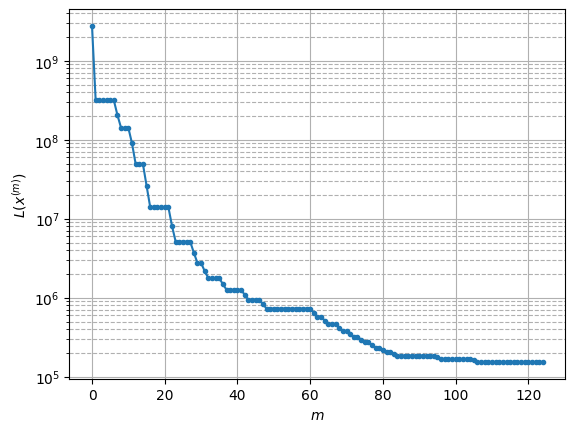

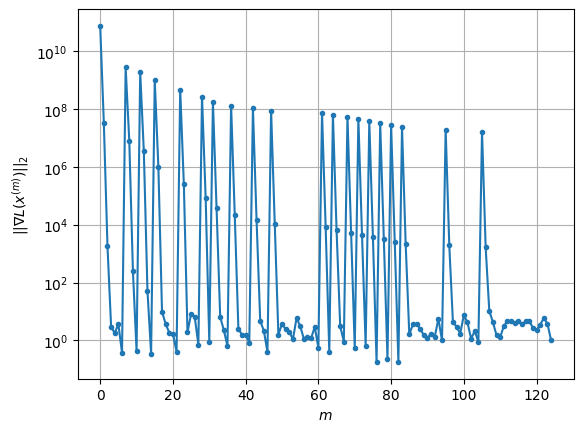

Windows:   1%|▏         | 4/296 [05:17<6:52:24, 84.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 146429.00807056628
Gradient norm: 14465553.556546668
Global relative error: 262.8863865734992
Position relative errors: 0.10454660975601417 m, 24.667365786452727 m, 194.219792061939 m, 175.44042793154696 m

Iteration 1
Cost function: 140917.49773282974 (-3.76%)
Gradient norm: 1548.374957912468 (-99.99%)
Global relative error = 262.199511471012 (-0.26%)
Position relative errors: 0.06988826930837222 m, 26.37926299164864 m, 192.1880336224624 m, 176.3983690091436 m

Iteration 2
Cost function: 140917.4976129061 (-0.00%)
Gradient norm: 5.63533817557437 (-99.64%)
Global relative error = 262.19952276511935 (0.00%)
Position relative errors: 0.06991708835093112 m, 26.379153162346196 m, 192.188033501262 m, 176.3984023424269 m

Iteration 3
Cost function: 140917.4976078835 (-0.00%)
Gradient norm: 1.091129736027113 (-80.64%)
Global relative error = 262.19952276813626 (0.00%)
Position relative errors: 0.06991708457222

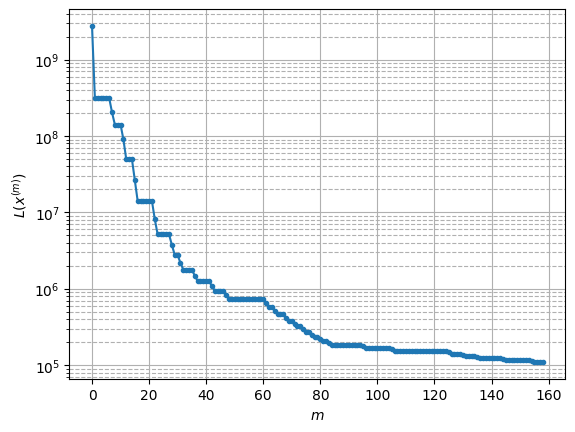

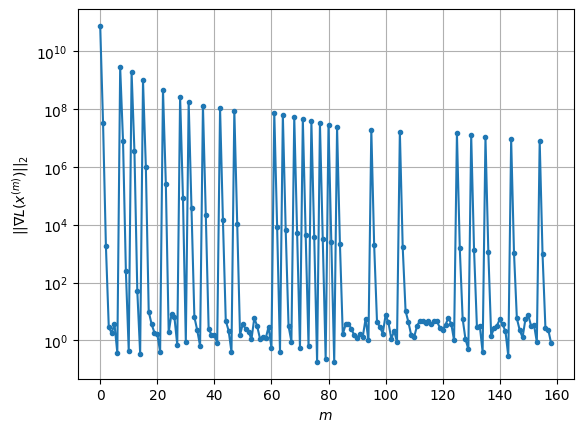

Windows:   2%|▏         | 5/296 [06:42<6:52:29, 85.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 108148.80883371059
Gradient norm: 6956185.649474237
Global relative error: 257.68373334705205
Position relative errors: 0.04831751719152166 m, 22.75154032865182 m, 183.89003221944225 m, 179.0744281687485 m

Iteration 1
Cost function: 105441.57769559568 (-2.50%)
Gradient norm: 931.6355208137504 (-99.99%)
Global relative error = 255.60103491962008 (-0.81%)
Position relative errors: 0.03905599709482822 m, 24.39102299268693 m, 181.71857908676688 m, 178.08775681579326 m

Iteration 2
Cost function: 105441.57765213803 (-0.00%)
Gradient norm: 7.934921599931831 (-99.15%)
Global relative error = 255.60102237655036 (-0.00%)
Position relative errors: 0.03906017476991569 m, 24.39099947622333 m, 181.71855389536844 m, 178.08776773860467 m

Iteration 3
Cost function: 105441.577650845 (-0.00%)
Gradient norm: 5.461400844486461 (-31.17%)
Global relative error = 255.6010223837966 (0.00%)
Position relative errors: 0.0390601

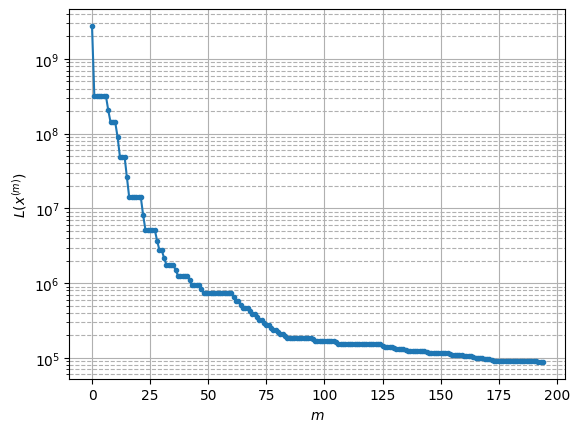

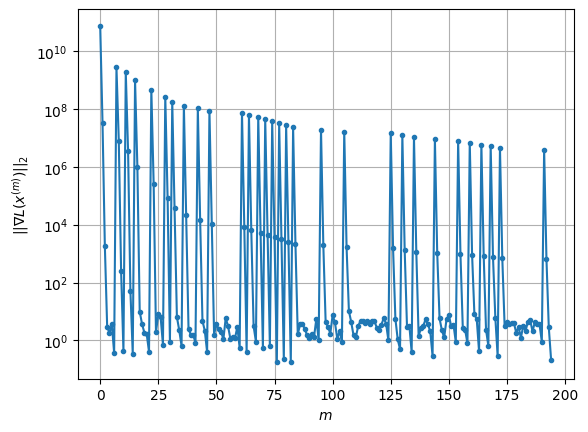

Windows:   2%|▏         | 6/296 [08:12<6:58:46, 86.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 88893.25923239072
Gradient norm: 3915689.8172776406
Global relative error: 246.96500809347
Position relative errors: 0.03581828359471387 m, 21.061172662965898 m, 173.22617751479405 m, 174.75917277258915 m

Iteration 1
Cost function: 87031.67107148973 (-2.09%)
Gradient norm: 653.1370615787496 (-99.98%)
Global relative error = 244.11625026324998 (-1.15%)
Position relative errors: 0.058155536112907365 m, 22.59593104018756 m, 171.1016390193188 m, 172.6451028983211 m

Iteration 2
Cost function: 87031.67105760779 (-0.00%)
Gradient norm: 1.2814114304544835 (-99.80%)
Global relative error = 244.11624997075265 (-0.00%)
Position relative errors: 0.058143727017045815 m, 22.595934559272777 m, 171.10160457517193 m, 172.64513616453024 m

Iteration 3
Cost function: 87031.67105372017 (-0.00%)
Gradient norm: 3.8176678449567896 (197.93%)
Global relative error = 244.11624996688897 (-0.00%)
Position relative errors: 0.0581

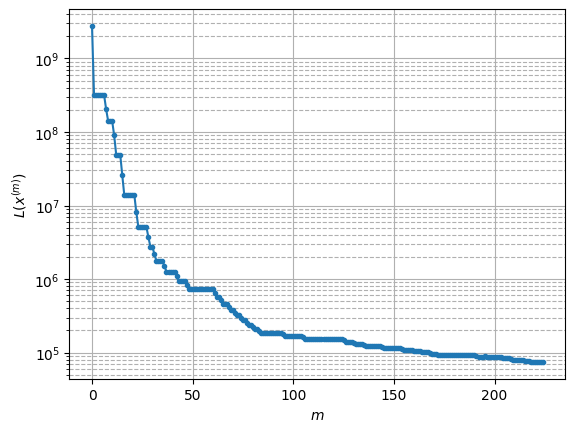

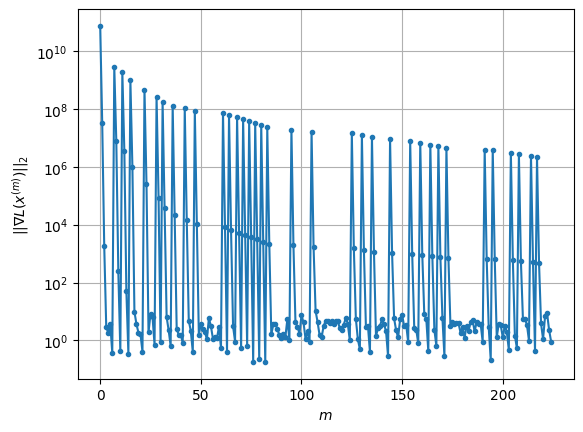

Windows:   2%|▏         | 7/296 [09:27<6:39:18, 82.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 76078.60171064992
Gradient norm: 2514768.0968389036
Global relative error: 233.2538475627585
Position relative errors: 0.060168319833659514 m, 19.431443145605037 m, 162.73906937152506 m, 165.9690196407913 m

Iteration 1
Cost function: 74554.0929898515 (-2.00%)
Gradient norm: 503.27398037348877 (-99.98%)
Global relative error = 230.08609022801306 (-1.36%)
Position relative errors: 0.07737822263531995 m, 20.884195753039528 m, 160.73139379778056 m, 163.30591434983242 m

STOP on Iteration 2
Cost function = 74554.09297818971 (-0.00%)
Gradient norm = 0.26391428544101486 (-99.95%)
Global relative error = 230.086102239832 (0.00%)
Final position relative errors: 0.07736730504437685 m, 20.884209653681157 m, 160.73136032971107 m, 163.3059624416383 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 73142.0881651193
Gradient norm: 1815916.7573485014
Global relative error: 230.0861

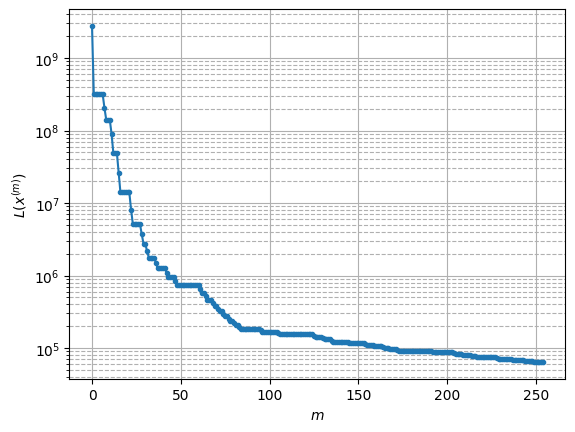

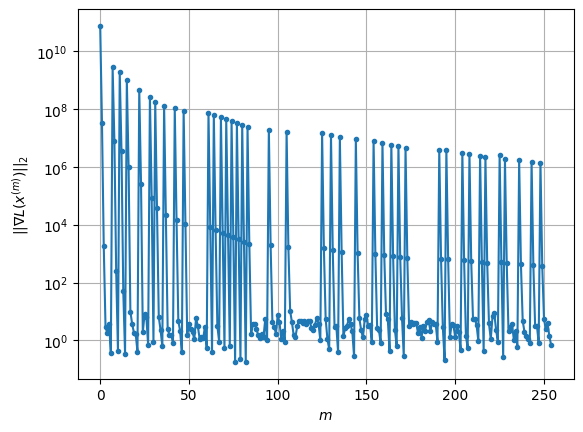

Windows:   3%|▎         | 8/296 [10:44<6:28:55, 81.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 65948.66469443496
Gradient norm: 1818593.2245786784
Global relative error: 218.2755620836337
Position relative errors: 0.07418476770680944 m, 17.88666844278154 m, 152.56175354246673 m, 155.07788645371295 m

Iteration 1
Cost function: 64624.03434331629 (-2.01%)
Gradient norm: 416.31465932786455 (-99.98%)
Global relative error = 215.0833336177614 (-1.46%)
Position relative errors: 0.0911531482049275 m, 19.27380730227979 m, 150.69563841197234 m, 152.2502400006703 m

Iteration 2
Cost function: 64624.03433015946 (-0.00%)
Gradient norm: 4.645068333567171 (-98.88%)
Global relative error = 215.08335253571448 (0.00%)
Position relative errors: 0.09114453279426966 m, 19.273823802841285 m, 150.69561187144052 m, 152.25029091185647 m

Iteration 3
Cost function: 64624.03433142476 (0.00%)
Gradient norm: 1.8955513667448844 (-59.19%)
Global relative error = 215.0833525384516 (0.00%)
Position relative errors: 0.0911445318

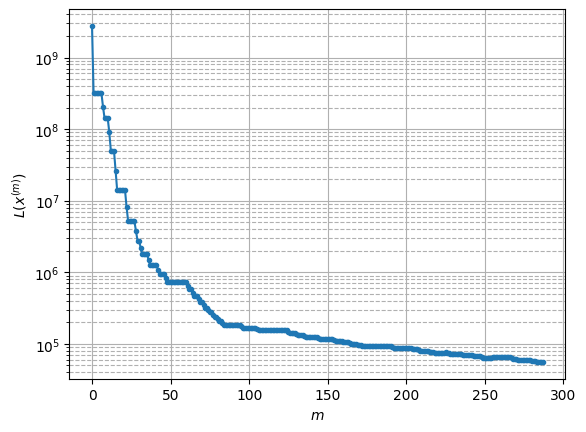

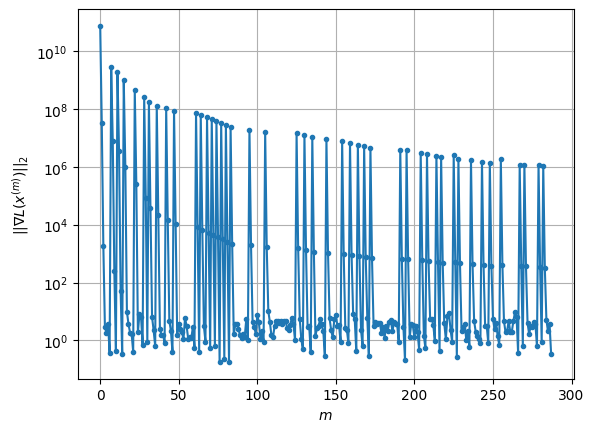

Windows:   3%|▎         | 9/296 [12:07<6:30:56, 81.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 57418.27204041493
Gradient norm: 1731524.97286711
Global relative error: 203.10926988397088
Position relative errors: 0.08409676776614605 m, 16.44664914786549 m, 142.7074446036186 m, 143.5876947468719 m

Iteration 1
Cost function: 56252.3717178111 (-2.03%)
Gradient norm: 349.3861811710221 (-99.98%)
Global relative error = 200.0583313652194 (-1.50%)
Position relative errors: 0.11001191739292002 m, 17.769819485832826 m, 140.98810160427684 m, 140.8186017177552 m

Iteration 2
Cost function: 56252.37171927923 (0.00%)
Gradient norm: 4.474706590145336 (-98.72%)
Global relative error = 200.0583518603622 (0.00%)
Position relative errors: 0.11000557151746701 m, 17.7698362453421 m, 140.98808343421118 m, 140.81864691684973 m

Iteration 3
Cost function: 56252.37171857298 (-0.00%)
Gradient norm: 8.621114329137704 (92.66%)
Global relative error = 200.0583518598683 (-0.00%)
Position relative errors: 0.11000558273470391

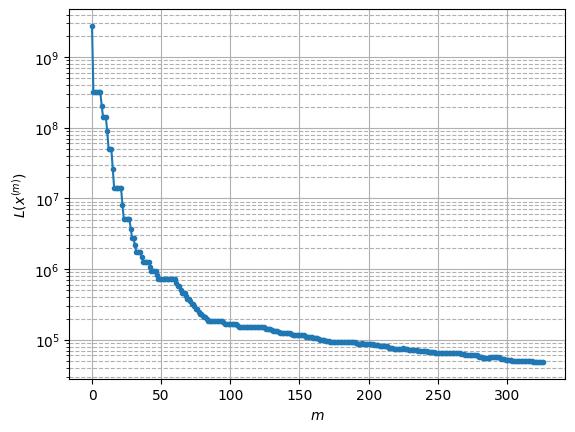

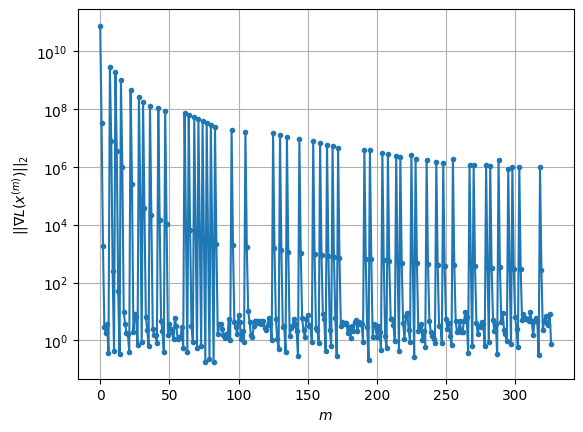

Windows:   3%|▎         | 10/296 [13:47<6:55:54, 87.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 49975.45584051117
Gradient norm: 1295942.3909694932
Global relative error: 188.31252689775266
Position relative errors: 0.09984845399795876 m, 15.078954635119388 m, 133.1466340628949 m, 132.3108743448767 m

Iteration 1
Cost function: 48958.34104085383 (-2.04%)
Gradient norm: 298.06663301875415 (-99.98%)
Global relative error = 185.46763207733207 (-1.51%)
Position relative errors: 0.10366660098871 m, 16.339238407976236 m, 131.53897828037583 m, 129.72559531591466 m

STOP on Iteration 2
Cost function = 48958.34104092093 (0.00%)
Gradient norm = 0.7169131193724702 (-99.76%)
Global relative error = 185.46765003380804 (0.00%)
Final position relative errors: 0.10366224866110152 m, 16.339254240567747 m, 131.53896536689322 m, 129.72563209146878 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 48022.830273028914
Gradient norm: 712970.1950810915
Global relative error: 185.46765

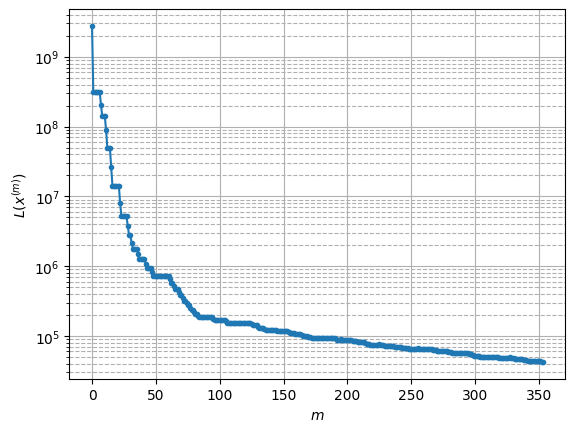

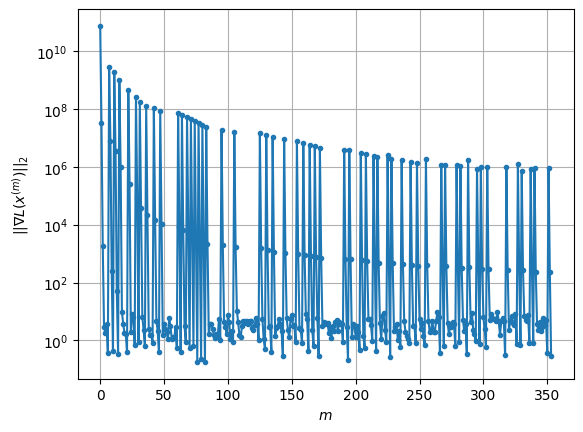

Windows:   4%|▎         | 11/296 [14:56<6:28:03, 81.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 43449.49348966574
Gradient norm: 1076639.3540076881
Global relative error: 174.05281467883717
Position relative errors: 0.0930278177347766 m, 13.746323828818234 m, 123.73631701647709 m, 121.63351233171704 m

Iteration 1
Cost function: 42568.95965942308 (-2.03%)
Gradient norm: 251.31070897039623 (-99.98%)
Global relative error = 171.44831997140756 (-1.50%)
Position relative errors: 0.10003244019403626 m, 14.948344286851862 m, 122.22365300698414 m, 119.29969905022365 m

Iteration 2
Cost function: 42568.95966157493 (0.00%)
Gradient norm: 1.04624449991175 (-99.58%)
Global relative error = 171.44833456555534 (0.00%)
Position relative errors: 0.10002979922441316 m, 14.948358090856338 m, 122.22364489565611 m, 119.29972660650341 m

Iteration 3
Cost function: 42568.95966018338 (-0.00%)
Gradient norm: 1.1568998561188335 (10.58%)
Global relative error = 171.44833456451656 (-0.00%)
Position relative errors: 0.10002

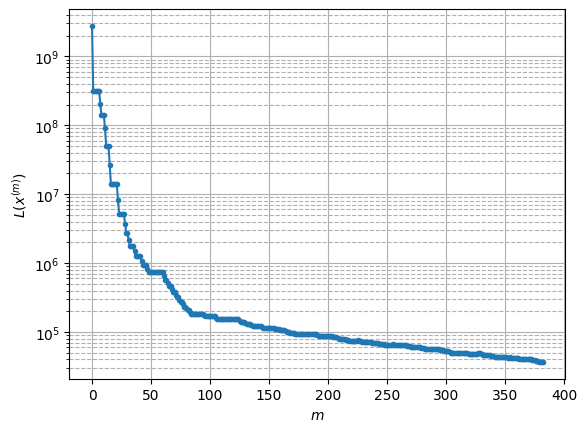

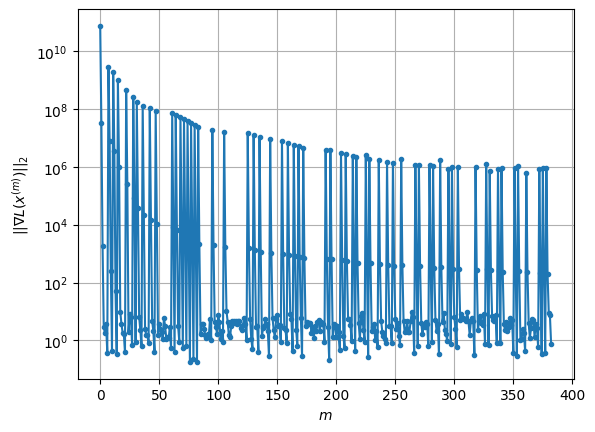

Windows:   4%|▍         | 12/296 [16:09<6:14:40, 79.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 37730.875294715006
Gradient norm: 780344.6731613369
Global relative error: 160.38762243992105
Position relative errors: 0.08971510959455323 m, 12.441131044000555 m, 114.41201684180267 m, 111.71064674256166 m

Iteration 1
Cost function: 36979.41886354166 (-1.99%)
Gradient norm: 214.49443162708488 (-99.97%)
Global relative error = 158.03156141781028 (-1.47%)
Position relative errors: 0.1049309920404583 m, 13.58291691617023 m, 112.97368758981584 m, 109.66491196487762 m

Iteration 2
Cost function: 36979.41886262793 (-0.00%)
Gradient norm: 3.258471907678001 (-98.48%)
Global relative error = 158.03157298053972 (0.00%)
Position relative errors: 0.10492968688512326 m, 13.582929081033035 m, 112.97368369245017 m, 109.66493113672686 m

Iteration 3
Cost function: 36979.418863281 (0.00%)
Gradient norm: 4.146480973666219 (27.25%)
Global relative error = 158.03157298147036 (0.00%)
Position relative errors: 0.104929680

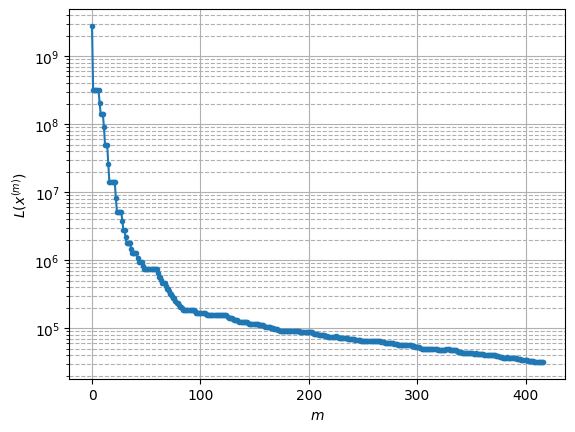

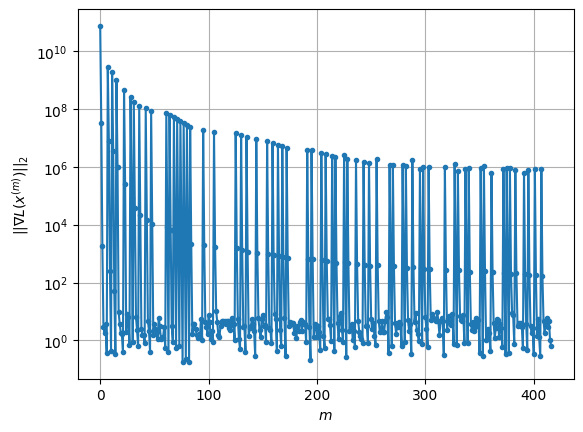

Windows:   4%|▍         | 13/296 [17:36<6:24:36, 81.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 32767.213049798396
Gradient norm: 825227.6736866555
Global relative error: 147.28430136592615
Position relative errors: 0.09529521266028543 m, 11.136304661404909 m, 105.11055172224955 m, 102.56896121205287 m

Iteration 1
Cost function: 32115.74676089917 (-1.99%)
Gradient norm: 181.06172018791534 (-99.98%)
Global relative error = 145.12463714103146 (-1.47%)
Position relative errors: 0.1065641724558702 m, 12.2089398215119 m, 103.73591641417774 m, 100.75183249875425 m

Iteration 2
Cost function: 32115.746761017268 (0.00%)
Gradient norm: 1.4146050184370755 (-99.22%)
Global relative error = 145.12464623524025 (0.00%)
Position relative errors: 0.1065636769916896 m, 12.208950911873279 m, 103.73591510987558 m, 100.7518455977576 m

Iteration 3
Cost function: 32115.746759323432 (-0.00%)
Gradient norm: 1.3901020645499458 (-1.73%)
Global relative error = 145.12464623529328 (0.00%)
Position relative errors: 0.106563

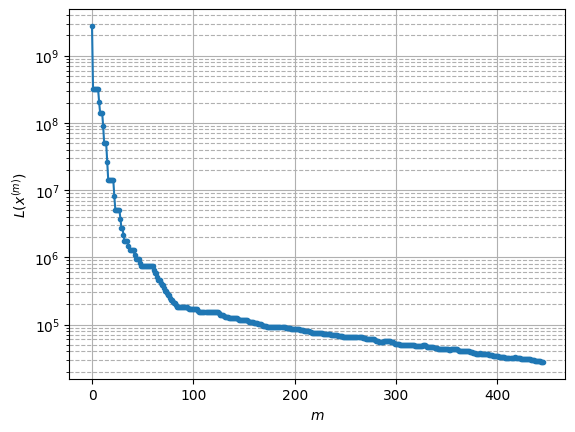

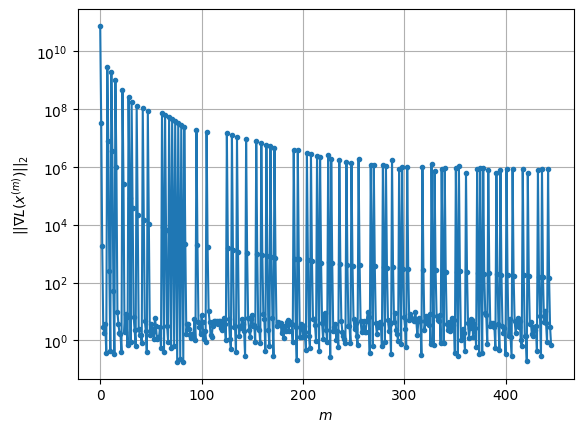

Windows:   5%|▍         | 14/296 [18:49<6:10:21, 78.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 28619.182361751395
Gradient norm: 497553.3267943914
Global relative error: 134.55753447050287
Position relative errors: 0.09777424844971203 m, 9.77926344343869 m, 95.81911218718598 m, 93.96151649055825 m

Iteration 1
Cost function: 28056.2568920853 (-1.97%)
Gradient norm: 155.24731445671824 (-99.97%)
Global relative error = 132.57451543039716 (-1.47%)
Position relative errors: 0.09300916263831464 m, 10.782596103214452 m, 94.48288727446882 m, 92.37259261474276 m

STOP on Iteration 2
Cost function = 28056.256895999035 (0.00%)
Gradient norm = 0.4677088578444784 (-99.70%)
Global relative error = 132.57452327591582 (0.00%)
Final position relative errors: 0.09300921957250995 m, 10.78260625038532 m, 94.48288862932473 m, 92.3726013044157 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 27530.2327485211
Gradient norm: 621234.7892795078
Global relative error: 132.574523275915

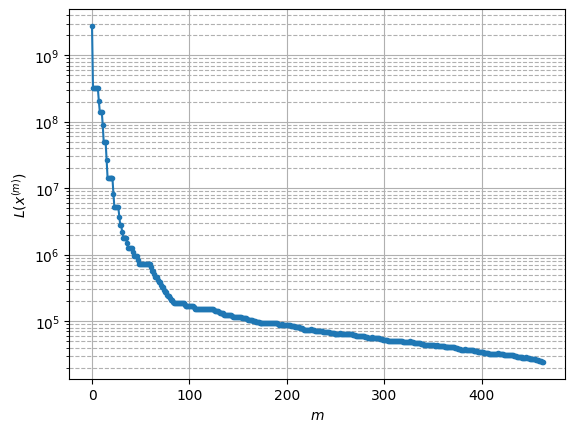

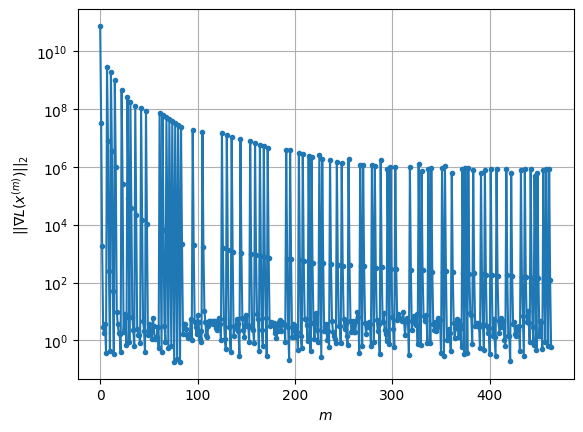

Windows:   5%|▌         | 15/296 [19:36<5:24:10, 69.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 24853.06907173447
Gradient norm: 470788.90139112854
Global relative error: 122.12052338093751
Position relative errors: 0.0857558426786839 m, 8.341875456433142 m, 86.47241145346256 m, 85.82734557674732 m

Iteration 1
Cost function: 24364.727005127334 (-1.96%)
Gradient norm: 127.60963371923718 (-99.97%)
Global relative error = 120.29319410249643 (-1.50%)
Position relative errors: 0.08152109186609828 m, 9.265941682159006 m, 85.19075102791915 m, 84.42219914493201 m

Iteration 2
Cost function: 24364.727004036165 (-0.00%)
Gradient norm: 1.8677978636808317 (-98.54%)
Global relative error = 120.29320157364643 (0.00%)
Position relative errors: 0.08152144729867339 m, 9.265949988105222 m, 85.19075457424313 m, 84.42220529999024 m

Iteration 3
Cost function: 24364.72700191349 (-0.00%)
Gradient norm: 1.7181891563943241 (-8.01%)
Global relative error = 120.2932015723395 (-0.00%)
Position relative errors: 0.0815214462

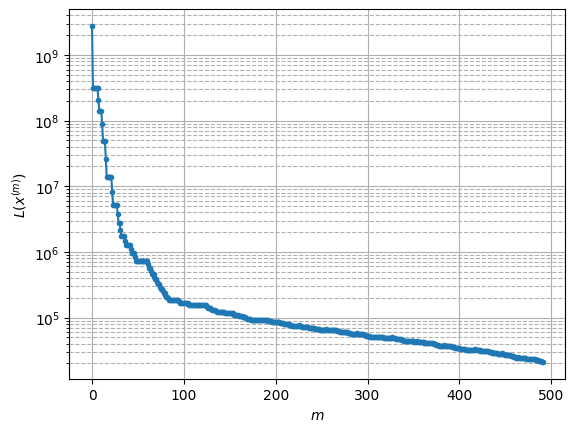

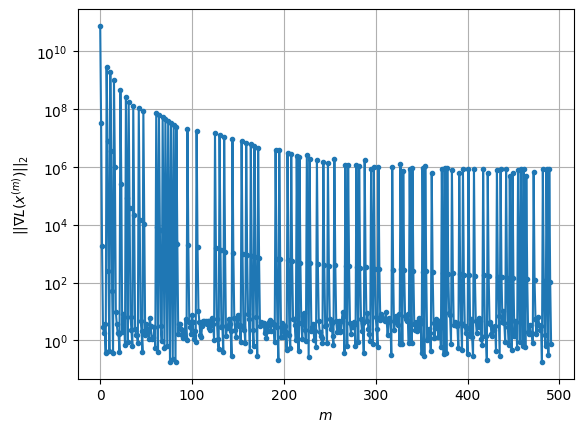

Windows:   5%|▌         | 16/296 [20:47<5:26:03, 69.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 21602.850782590027
Gradient norm: 512888.0077501811
Global relative error: 109.93183422699748
Position relative errors: 0.07577415944283145 m, 6.773213919484938 m, 77.16655611633257 m, 78.00277101242801 m

Iteration 1
Cost function: 21176.490136122044 (-1.97%)
Gradient norm: 108.17766728050094 (-99.98%)
Global relative error = 108.24169798714449 (-1.54%)
Position relative errors: 0.06669636406604158 m, 7.63648257452626 m, 75.92951947859726 m, 76.7635126545549 m

STOP on Iteration 2
Cost function = 21176.490132023522 (-0.00%)
Gradient norm = 0.7069091513096277 (-99.35%)
Global relative error = 108.24170489622647 (0.00%)
Final position relative errors: 0.06669681524378475 m, 7.636489889071455 m, 75.92952467191158 m, 76.76351653188914 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 20774.482758291004
Gradient norm: 733107.1350483261
Global relative error: 108.24170489

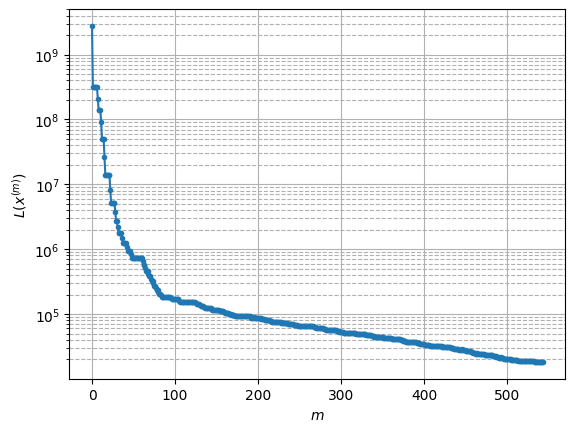

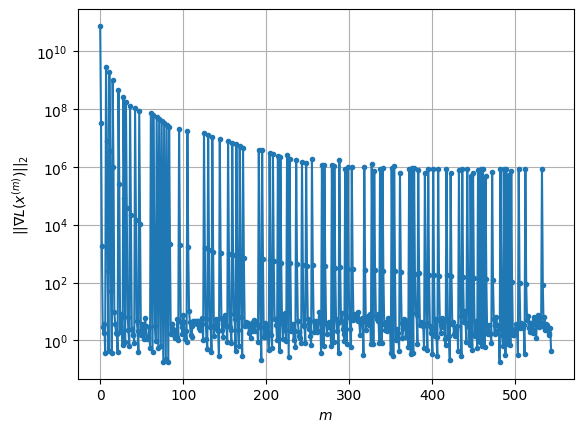

Windows:   6%|▌         | 17/296 [23:01<6:54:15, 89.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 18802.12889236806
Gradient norm: 658264.6229790675
Global relative error: 97.95946810580118
Position relative errors: 0.06304112591557814 m, 5.129921644865863 m, 67.919825844255 m, 70.40325562041933 m

Iteration 1
Cost function: 18427.065699622555 (-1.99%)
Gradient norm: 95.52641809362812 (-99.99%)
Global relative error = 96.39614659496735 (-1.60%)
Position relative errors: 0.05445653007493103 m, 5.923806676886907 m, 66.73510556223852 m, 69.30752021735738 m

Iteration 2
Cost function: 18427.065694847948 (-0.00%)
Gradient norm: 2.374316935509084 (-97.51%)
Global relative error = 96.39615345920286 (0.00%)
Position relative errors: 0.054457008858122255 m, 5.923812733303116 m, 66.73511238501891 m, 69.30752267688862 m

Iteration 3
Cost function: 18427.065693635446 (-0.00%)
Gradient norm: 4.050859234600735 (70.61%)
Global relative error = 96.39615345980886 (0.00%)
Position relative errors: 0.05445700998286188

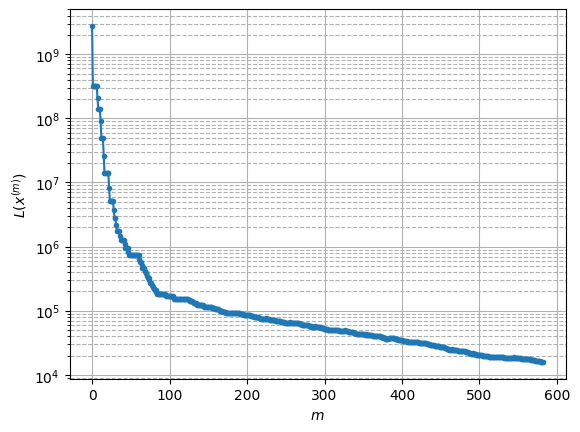

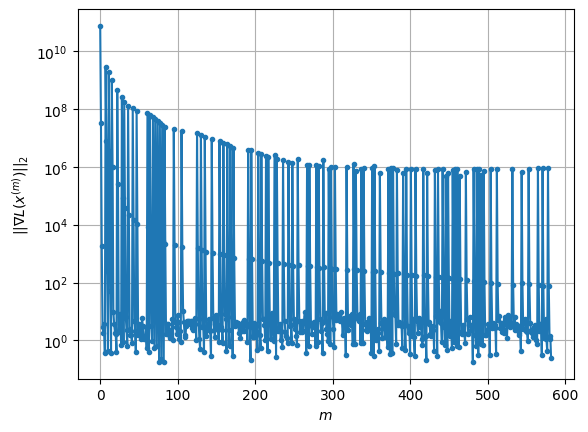

Windows:   6%|▌         | 18/296 [24:41<7:08:11, 92.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 16266.228588564492
Gradient norm: 762808.8763801913
Global relative error: 86.22180504389621
Position relative errors: 0.05185510741038056 m, 3.4058651636110278 m, 58.79478082445443 m, 62.974237638194204 m

Iteration 1
Cost function: 15935.545974063127 (-2.03%)
Gradient norm: 84.6484321300476 (-99.99%)
Global relative error = 84.78696379204858 (-1.66%)
Position relative errors: 0.039170092576142165 m, 4.121974839176181 m, 57.67464703424902 m, 62.01174155215453 m

Iteration 2
Cost function: 15935.54597752462 (0.00%)
Gradient norm: 11.056883840274748 (-86.94%)
Global relative error = 84.78697059224272 (0.00%)
Position relative errors: 0.039170327489121096 m, 4.121980018657289 m, 57.6746550277938 m, 62.01174307096657 m

Iteration 3
Cost function: 15935.545974354223 (-0.00%)
Gradient norm: 5.013814982802303 (-54.65%)
Global relative error = 84.78697059074754 (-0.00%)
Position relative errors: 0.039170320968

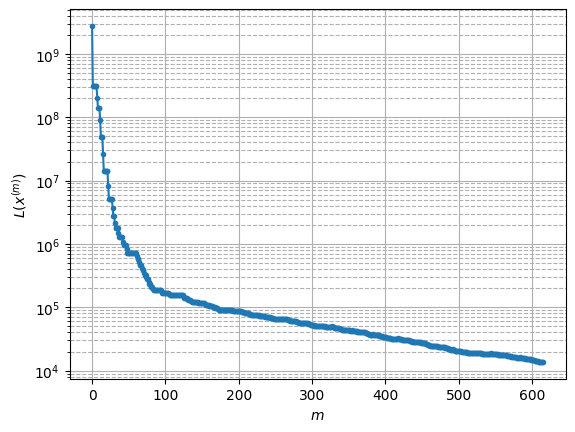

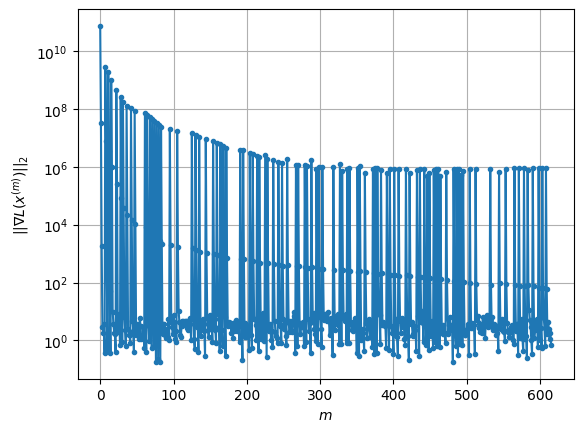

Windows:   6%|▋         | 19/296 [26:05<6:54:52, 89.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 13990.093488240927
Gradient norm: 860787.6718208357
Global relative error: 74.80910900725958
Position relative errors: 0.03742435945658358 m, 1.7494196491270924 m, 49.895693889736755 m, 55.711258570785006 m

Iteration 1
Cost function: 13701.13749325773 (-2.07%)
Gradient norm: 74.35706525636668 (-99.99%)
Global relative error = 73.50196612630369 (-1.75%)
Position relative errors: 0.039078100141293245 m, 2.292759914285067 m, 48.867973767086475 m, 54.856045447287066 m

Iteration 2
Cost function: 13701.137491038437 (-0.00%)
Gradient norm: 4.481671933375228 (-93.97%)
Global relative error = 73.50197262224202 (0.00%)
Position relative errors: 0.03907837153294141 m, 2.292763949559783 m, 48.86798205862552 m, 54.85604659594902 m

Iteration 3
Cost function: 13701.137494343053 (0.00%)
Gradient norm: 1.2300018230637093 (-72.55%)
Global relative error = 73.50197262190396 (-0.00%)
Position relative errors: 0.03907837

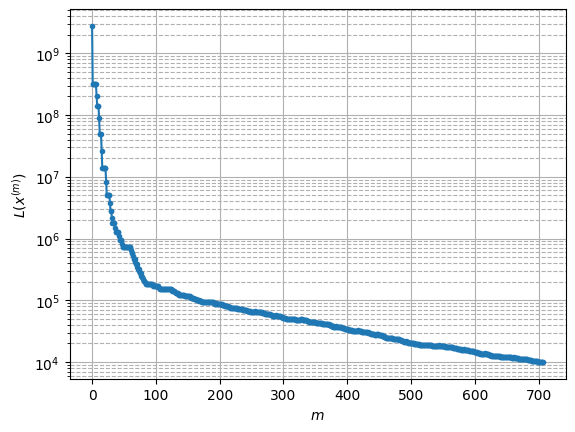

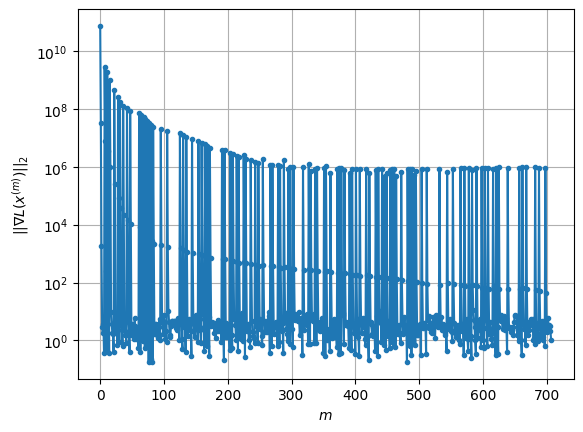

Windows:   7%|▋         | 21/296 [30:03<8:00:04, 104.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10067.801720315158
Gradient norm: 1024463.8047505898
Global relative error: 53.39499678373174
Position relative errors: 0.030041211830306266 m, 2.969939208881253 m, 33.404821184243374 m, 41.5488336641512 m

Iteration 1
Cost function: 9869.482173820114 (-1.97%)
Gradient norm: 54.19895751048279 (-99.99%)
Global relative error = 52.38229824562422 (-1.90%)
Position relative errors: 0.025633220272448173 m, 2.3355575981645686 m, 32.630178896806164 m, 40.91093544816225 m

STOP on Iteration 2
Cost function = 9869.48217596883 (0.00%)
Gradient norm = 0.6937528779909286 (-98.72%)
Global relative error = 52.38230267760929 (0.00%)
Final position relative errors: 0.02563310571992316 m, 2.335555140730518 m, 32.63018546770233 m, 40.91093602234715 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 9681.072523045596
Gradient norm: 971382.8415562286
Global relative error: 52.38230267760

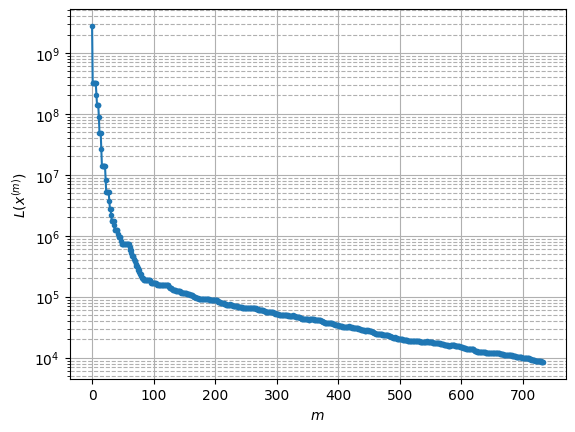

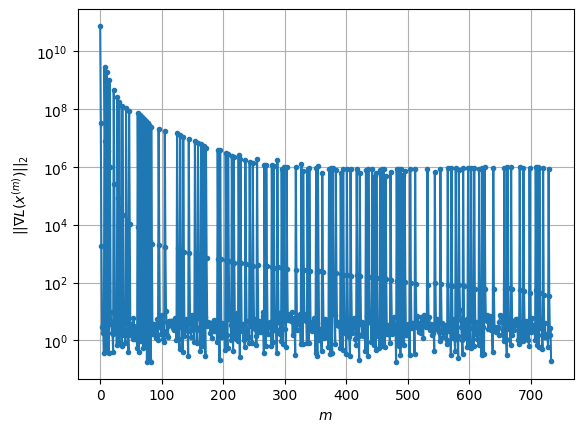

Windows:   7%|▋         | 22/296 [31:11<7:07:40, 93.65s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8533.891596239986
Gradient norm: 955421.3485938457
Global relative error: 43.70155323487159
Position relative errors: 0.023948028791605066 m, 5.119481610822271 m, 26.009487198654696 m, 34.743431608412145 m

Iteration 1
Cost function: 8375.546833827511 (-1.86%)
Gradient norm: 43.03793867107014 (-100.00%)
Global relative error = 42.81537926015483 (-2.03%)
Position relative errors: 0.022643828620003657 m, 4.516529543342522 m, 25.379621374303717 m, 34.18501787584564 m

Iteration 2
Cost function: 8375.546833364378 (-0.00%)
Gradient norm: 2.1844512857537093 (-94.92%)
Global relative error = 42.81538261080168 (0.00%)
Position relative errors: 0.02264389985324424 m, 4.516527683481588 m, 25.37962670836046 m, 34.18501835796686 m

Iteration 3
Cost function: 8375.546831103902 (-0.00%)
Gradient norm: 2.52957737569766 (15.80%)
Global relative error = 42.815382610219906 (-0.00%)
Position relative errors: 0.02264390045

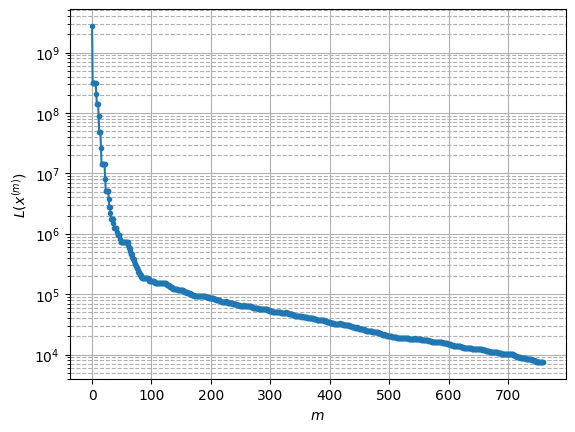

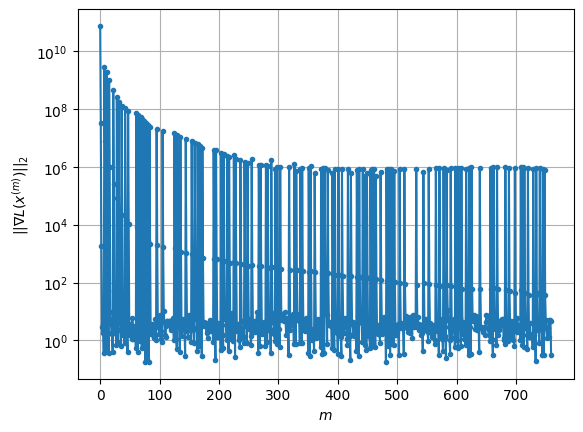

Windows:   8%|▊         | 23/296 [32:16<6:27:14, 85.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7488.417892445129
Gradient norm: 891955.6765602926
Global relative error: 35.68881774668383
Position relative errors: 0.021691743733407216 m, 8.005030445498424 m, 19.737878792656346 m, 28.635820418453832 m

Iteration 1
Cost function: 7359.26504647066 (-1.72%)
Gradient norm: 32.40132002883678 (-100.00%)
Global relative error = 34.89592149821937 (-2.22%)
Position relative errors: 0.012299520491735605 m, 7.440517347131828 m, 19.230867408142785 m, 28.151750692625647 m

Iteration 2
Cost function: 7359.265047958502 (0.00%)
Gradient norm: 1.8638439262913653 (-94.25%)
Global relative error = 34.89592379015318 (0.00%)
Position relative errors: 0.012299581609642661 m, 7.44051560446679 m, 19.230871573715014 m, 28.1517511486214 m

Iteration 3
Cost function: 7359.265047449402 (-0.00%)
Gradient norm: 4.009148142874304 (115.10%)
Global relative error = 34.89592379038941 (0.00%)
Position relative errors: 0.012299581831

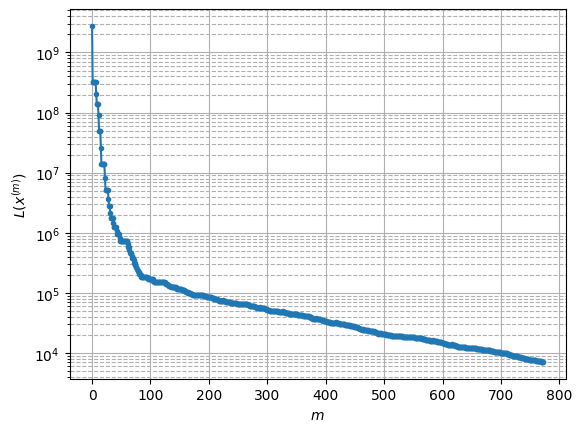

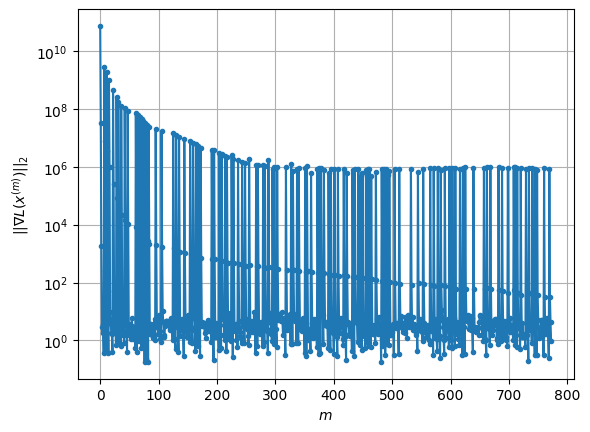

Windows:   8%|▊         | 24/296 [32:49<5:14:38, 69.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7041.467686409412
Gradient norm: 988986.4350333947
Global relative error: 30.314138980553132
Position relative errors: 0.011304046288748391 m, 12.037779529504695 m, 14.752477167789923 m, 23.587844681859842 m

Iteration 1
Cost function: 6918.810188095546 (-1.74%)
Gradient norm: 35.544755594180394 (-100.00%)
Global relative error = 29.545918178400438 (-2.53%)
Position relative errors: 0.009784459399615229 m, 11.476183411152208 m, 14.32646875031449 m, 23.151544932091223 m

Iteration 2
Cost function: 6918.81019374665 (0.00%)
Gradient norm: 2.8945868084183886 (-91.86%)
Global relative error = 29.54591971868657 (0.00%)
Position relative errors: 0.009784301357610764 m, 11.4761813164912 m, 14.326472791531431 m, 23.151545435426353 m

Iteration 3
Cost function: 6918.810191798274 (-0.00%)
Gradient norm: 1.683562384075461 (-41.84%)
Global relative error = 29.545919718843933 (0.00%)
Position relative errors: 0.00978

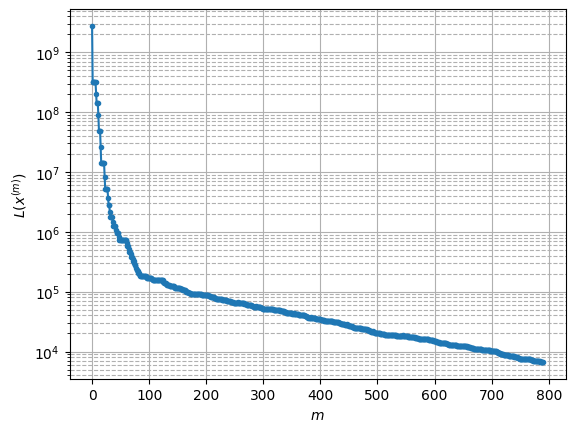

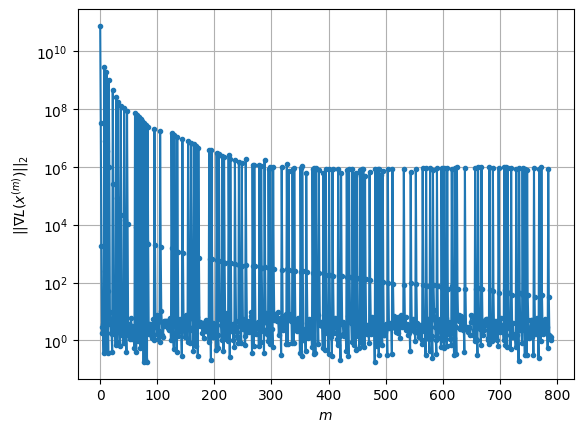

Windows:   8%|▊         | 25/296 [33:36<4:43:11, 62.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6624.391881518607
Gradient norm: 904032.7032844932
Global relative error: 26.44500150877539
Position relative errors: 0.0082653296599543 m, 16.007605129404094 m, 9.979646314107383 m, 18.53333629157083 m

Iteration 1
Cost function: 6516.120934537277 (-1.63%)
Gradient norm: 29.661881770481454 (-100.00%)
Global relative error = 25.723557807985255 (-2.73%)
Position relative errors: 0.005712458765237676 m, 15.45828071137464 m, 9.66238181309041 m, 18.14840784782467 m

Iteration 2
Cost function: 6516.120935733629 (0.00%)
Gradient norm: 5.143478120521841 (-82.66%)
Global relative error = 25.723558728906582 (0.00%)
Position relative errors: 0.005712520658462496 m, 15.458279488922493 m, 9.66238533327062 m, 18.14840832018481 m

STOP on Iteration 3
Cost function = 6516.120934899336 (-0.00%)
Gradient norm = 0.4420286317101821 (-91.41%)
Global relative error = 25.72355872976764 (0.00%)
Final position relative errors:

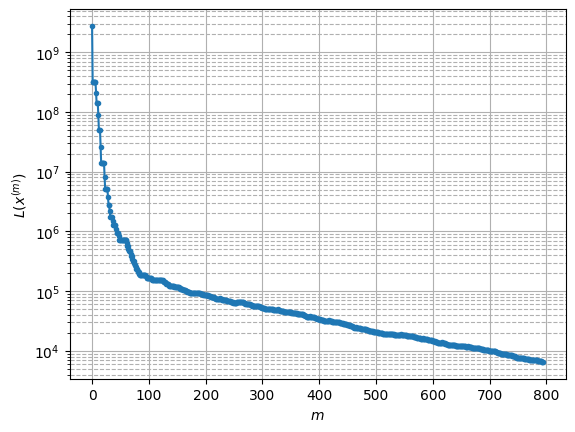

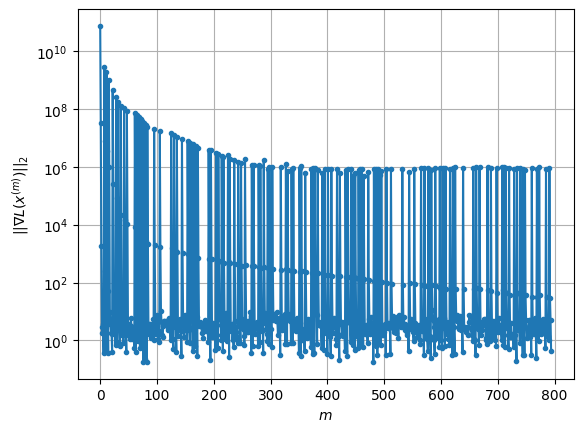

Windows:   9%|▉         | 26/296 [33:47<3:32:30, 47.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6473.250777178824
Gradient norm: 954371.0114619443
Global relative error: 25.417942938024474
Position relative errors: 0.004751992368276714 m, 20.453609201581774 m, 5.889176746422671 m, 13.893258409346485 m

Iteration 1
Cost function: 6366.022982236696 (-1.66%)
Gradient norm: 31.712158231069804 (-100.00%)
Global relative error = 24.752262970297906 (-2.62%)
Position relative errors: 0.003309104021481099 m, 19.896533915346964 m, 5.782015252169546 m, 13.54083483676907 m

Iteration 2
Cost function: 6366.022983239443 (0.00%)
Gradient norm: 3.403140660859727 (-89.27%)
Global relative error = 24.75226252527914 (-0.00%)
Position relative errors: 0.0033089967780594353 m, 19.896532104867 m, 5.782018413428086 m, 13.540835333697043 m

Iteration 3
Cost function: 6366.022980892282 (-0.00%)
Gradient norm: 2.4878056103680244 (-26.90%)
Global relative error = 24.752262526586318 (0.00%)
Position relative errors: 0.003308

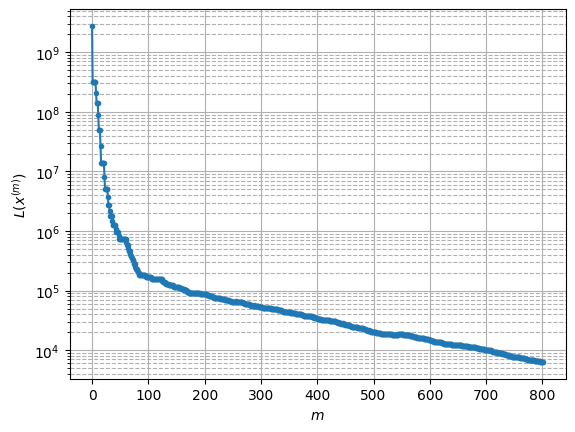

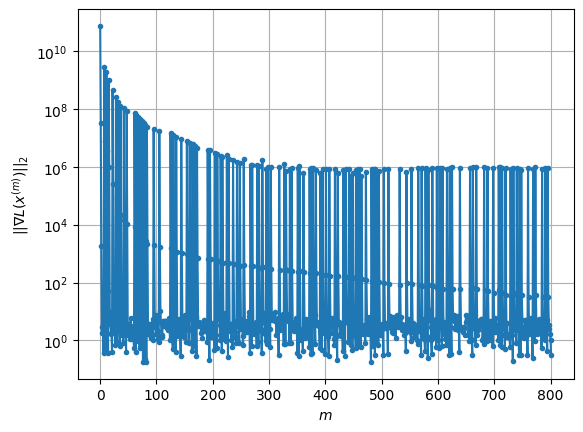

Windows:   9%|▉         | 27/296 [34:05<2:53:01, 38.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6336.20169703285
Gradient norm: 982189.6462024921
Global relative error: 26.670634967943354
Position relative errors: 0.0023208586087745393 m, 24.795619204728066 m, 3.2929832857380874 m, 9.254181384618109 m

Iteration 1
Cost function: 6233.552867096508 (-1.62%)
Gradient norm: 32.86404128317872 (-100.00%)
Global relative error = 26.09683919218218 (-2.15%)
Position relative errors: 0.0035127678862413424 m, 24.238026053252195 m, 3.7085411784954965 m, 8.93272053358856 m

Iteration 2
Cost function: 6233.552868143674 (0.00%)
Gradient norm: 4.920418012507896 (-85.03%)
Global relative error = 26.09683775203959 (-0.00%)
Position relative errors: 0.003513178477026012 m, 24.238024251712616 m, 3.708541596245275 m, 8.932721040909554 m

Iteration 3
Cost function: 6233.552867252298 (-0.00%)
Gradient norm: 2.528919044266448 (-48.60%)
Global relative error = 26.096837751927644 (-0.00%)
Position relative errors: 0.003513

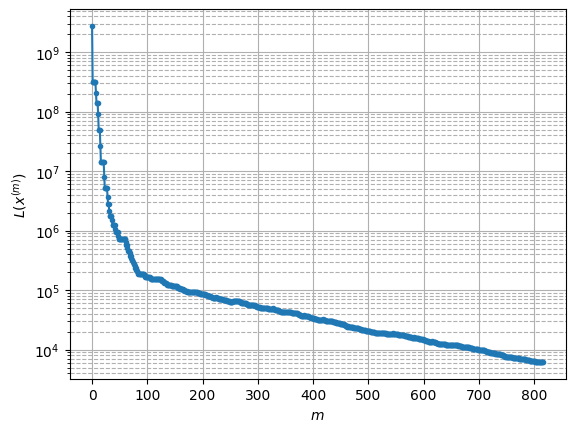

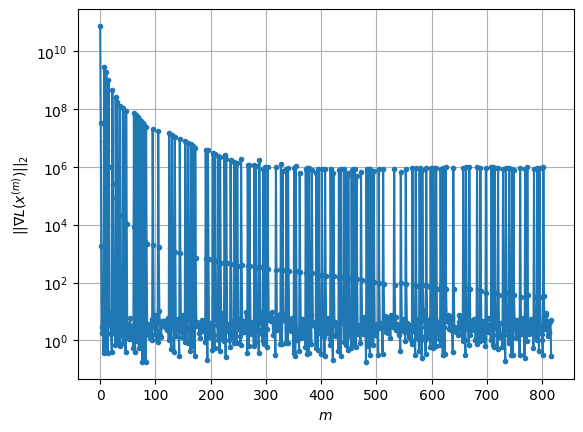

Windows:   9%|▉         | 28/296 [34:44<2:52:44, 38.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6174.979066811372
Gradient norm: 943956.8419196525
Global relative error: 29.85224528795155
Position relative errors: 0.00438153436430269 m, 29.02361372675681 m, 5.165573383585247 m, 4.699697872782539 m

Iteration 1
Cost function: 6079.823524478316 (-1.54%)
Gradient norm: 30.503626225696845 (-100.00%)
Global relative error = 29.372716460747068 (-1.61%)
Position relative errors: 0.005154966684628284 m, 28.46988861080536 m, 5.742757100040822 m, 4.38482131779891 m

Iteration 2
Cost function: 6079.823524342013 (-0.00%)
Gradient norm: 2.3178981923639235 (-92.40%)
Global relative error = 29.372713971849482 (-0.00%)
Position relative errors: 0.005155258718105059 m, 28.469886447115247 m, 5.742754747696564 m, 4.384821774285088 m

Iteration 3
Cost function: 6079.823526129452 (0.00%)
Gradient norm: 1.8045604929221684 (-22.15%)
Global relative error = 29.37271396994335 (-0.00%)
Position relative errors: 0.005155259

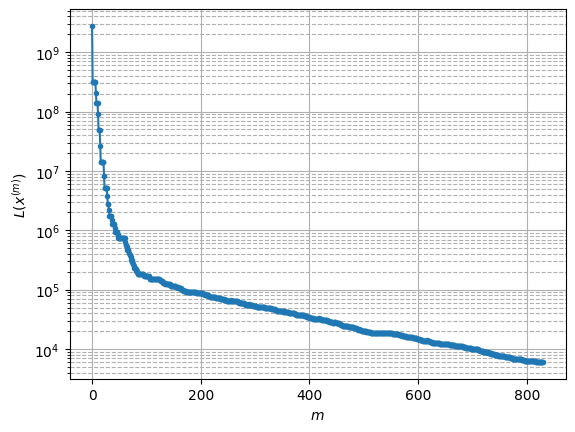

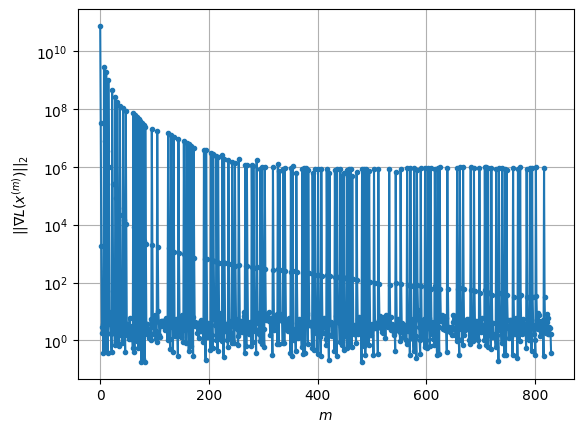

Windows:  10%|▉         | 29/296 [35:20<2:48:31, 37.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6050.576059498881
Gradient norm: 884004.6873069645
Global relative error: 34.34506617032563
Position relative errors: 0.006115963937995166 m, 33.12550576596483 m, 8.948582305541679 m, 1.4804353702970279 m

Iteration 1
Cost function: 5963.7410926776065 (-1.44%)
Gradient norm: 28.37381180674532 (-100.00%)
Global relative error = 33.940745844096554 (-1.18%)
Position relative errors: 0.006780204982542623 m, 32.58032077256906 m, 9.420199277767491 m, 1.3195583916668743 m

Iteration 2
Cost function: 5963.741093001152 (0.00%)
Gradient norm: 3.161162577585775 (-88.86%)
Global relative error = 33.94074350303592 (-0.00%)
Position relative errors: 0.00678012296400705 m, 32.580319141779086 m, 9.420196453947675 m, 1.3195586005667947 m

Iteration 3
Cost function: 5963.741092949868 (-0.00%)
Gradient norm: 5.901884390133811 (86.70%)
Global relative error = 33.94074350436724 (0.00%)
Position relative errors: 0.0067801263

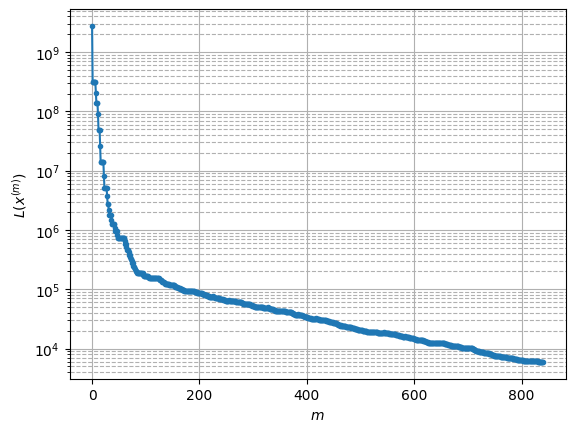

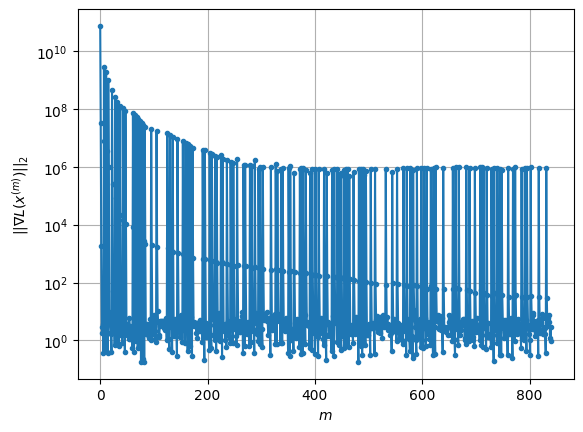

Windows:  10%|█         | 30/296 [35:47<2:32:31, 34.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5922.143336272671
Gradient norm: 806526.3818493113
Global relative error: 39.609841316141804
Position relative errors: 0.007714847278204445 m, 37.09009063892115 m, 12.96363009581462 m, 5.01935798788687 m

Iteration 1
Cost function: 5842.88492164766 (-1.34%)
Gradient norm: 33.77708198615276 (-100.00%)
Global relative error = 39.260186922579926 (-0.88%)
Position relative errors: 0.012666801944304187 m, 36.55845496606237 m, 13.354354156422142 m, 5.146631703628559 m

Iteration 2
Cost function: 5842.884922093767 (0.00%)
Gradient norm: 1.4597937339340523 (-95.68%)
Global relative error = 39.26018467056837 (-0.00%)
Position relative errors: 0.012666599703789309 m, 36.558453530387894 m, 13.354351531168618 m, 5.146631535095761 m

STOP on Iteration 3
Cost function = 5842.884922255896 (0.00%)
Gradient norm = 0.9363021838022946 (-35.86%)
Global relative error = 39.26018467212328 (0.00%)
Final position relative erro

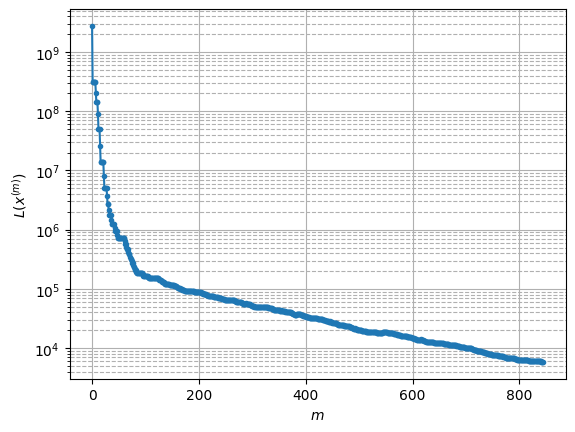

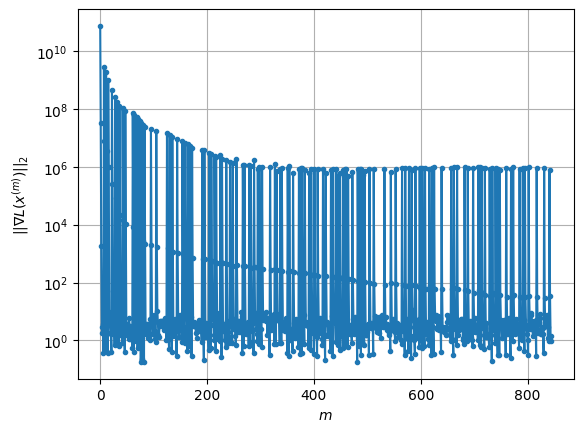

Windows:  10%|█         | 31/296 [35:57<2:00:18, 27.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5819.8355590877145
Gradient norm: 744840.8474220021
Global relative error: 45.27912235050942
Position relative errors: 0.013626535623303022 m, 40.90702628421367 m, 16.950194605922512 m, 9.459945105741392 m

Iteration 1
Cost function: 5748.281168495363 (-1.23%)
Gradient norm: 28.700488477052893 (-100.00%)
Global relative error = 44.9591523405946 (-0.71%)
Position relative errors: 0.025227393087924845 m, 40.39360332789425 m, 17.25733885427067 m, 9.58392511225916 m

STOP on Iteration 2
Cost function = 5748.281167564193 (-0.00%)
Gradient norm = 0.725528268712388 (-97.47%)
Global relative error = 44.95915089740118 (-0.00%)
Final position relative errors: 0.02522711379973594 m, 40.39360279390376 m, 17.25733644713321 m, 9.583924927860393 m

Majorization-Minimization converged after 1 iterations


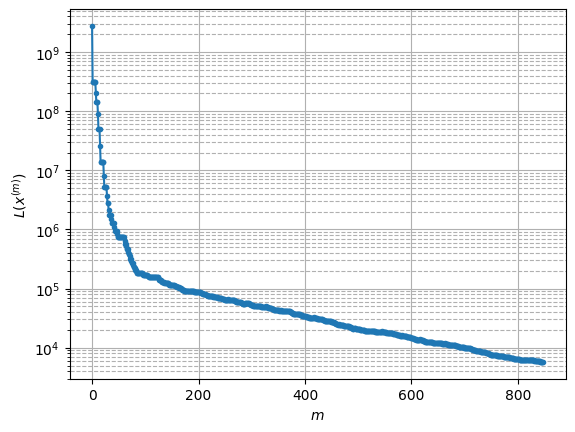

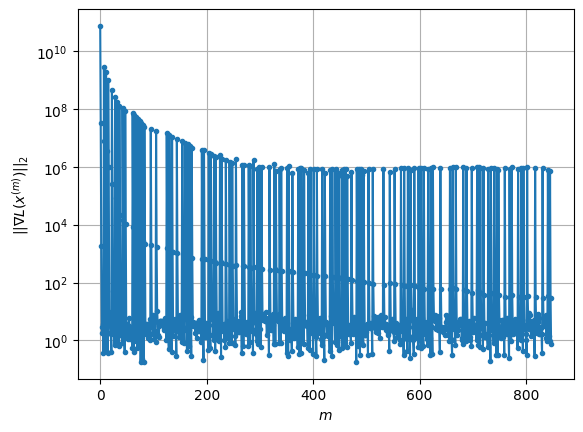

Windows:  11%|█         | 32/296 [36:05<1:34:23, 21.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5742.4670187255915
Gradient norm: 707222.248322632
Global relative error: 51.11088683123229
Position relative errors: 0.02566689407044181 m, 44.5662263808948 m, 20.81987149337549 m, 13.88139185065887 m

Iteration 1
Cost function: 5676.436369296929 (-1.15%)
Gradient norm: 28.973365625036276 (-100.00%)
Global relative error = 50.807895807979214 (-0.59%)
Position relative errors: 0.03780565877727554 m, 44.07080191871457 m, 21.06150093594073 m, 13.985887829304323 m

Iteration 2
Cost function: 5676.436370661844 (0.00%)
Gradient norm: 3.3674704718923594 (-88.38%)
Global relative error = 50.80789492694348 (-0.00%)
Position relative errors: 0.03780535225712531 m, 44.07080193360995 m, 21.061498894450647 m, 13.985887656864948 m

Iteration 3
Cost function: 5676.436371326551 (0.00%)
Gradient norm: 7.256009449394355 (115.47%)
Global relative error = 50.807894926152585 (-0.00%)
Position relative errors: 0.03780536205

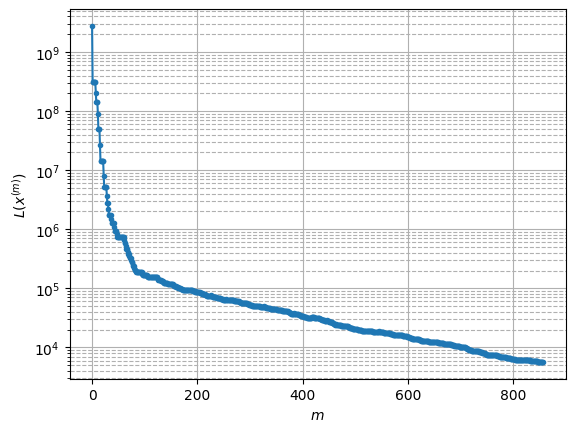

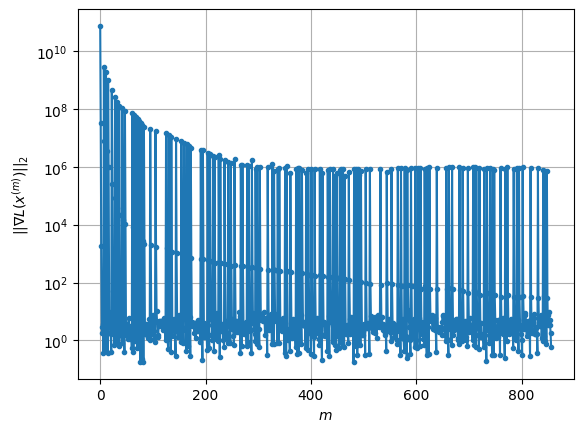

Windows:  11%|█         | 33/296 [36:28<1:35:34, 21.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5651.6840043220045
Gradient norm: 609225.1711846982
Global relative error: 56.952198078646965
Position relative errors: 0.037623626164210784 m, 48.053287612566415 m, 24.546245074205334 m, 18.218185151558163 m

Iteration 1
Cost function: 5590.417943996019 (-1.08%)
Gradient norm: 28.988106788412704 (-100.00%)
Global relative error = 56.66081185733338 (-0.51%)
Position relative errors: 0.027586004945693632 m, 47.57821956998805 m, 24.733886085845253 m, 18.302520060932174 m

Iteration 2
Cost function: 5590.4179446216785 (0.00%)
Gradient norm: 2.7928121577228984 (-90.37%)
Global relative error = 56.660811378074705 (-0.00%)
Position relative errors: 0.0275857828989741 m, 47.578219907246485 m, 24.733884443906707 m, 18.30251991976003 m

Iteration 3
Cost function: 5590.417945089354 (0.00%)
Gradient norm: 1.794407116220293 (-35.75%)
Global relative error = 56.66081137843868 (0.00%)
Position relative errors: 0.0275

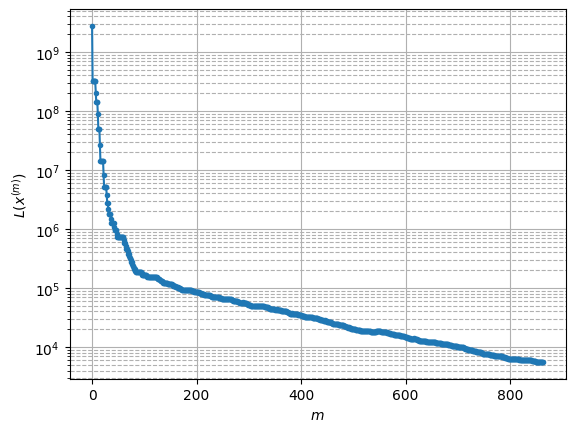

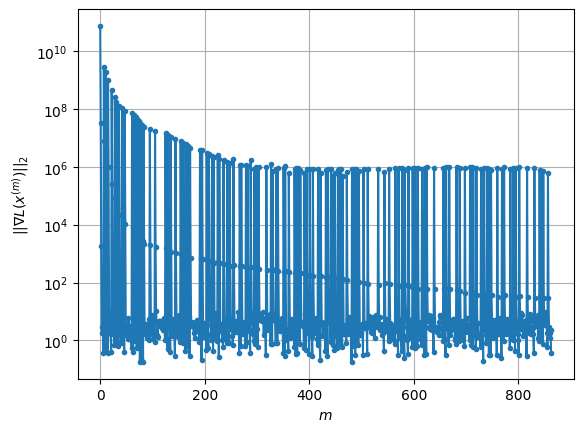

Windows:  11%|█▏        | 34/296 [36:46<1:30:08, 20.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5621.810688607751
Gradient norm: 622479.8886442998
Global relative error: 62.70158186885232
Position relative errors: 0.028088875767168252 m, 51.35705546236568 m, 28.11041760564047 m, 22.444002088285185 m

Iteration 1
Cost function: 5562.58327266687 (-1.05%)
Gradient norm: 24.930617967419348 (-100.00%)
Global relative error = 62.41390334299074 (-0.46%)
Position relative errors: 0.03072364940697512 m, 50.89865017826771 m, 28.253213892512598 m, 22.507024522973065 m

Iteration 2
Cost function: 5562.58327315284 (0.00%)
Gradient norm: 3.265927752723184 (-86.90%)
Global relative error = 62.41390256112162 (-0.00%)
Position relative errors: 0.030723463032256208 m, 50.89864999127669 m, 28.253212627662368 m, 22.507024365679953 m

Iteration 3
Cost function: 5562.583274471477 (0.00%)
Gradient norm: 2.6331568029338923 (-19.37%)
Global relative error = 62.413902561273915 (0.00%)
Position relative errors: 0.0307234643

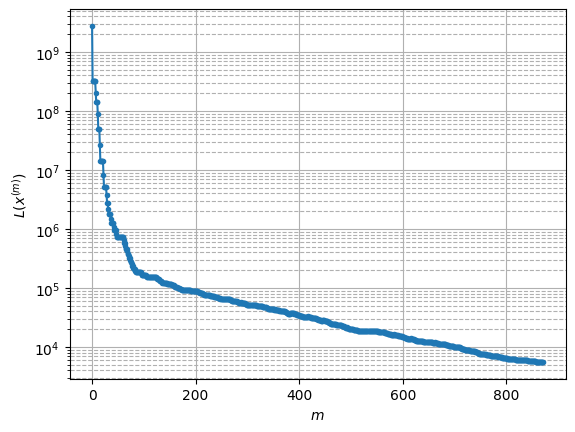

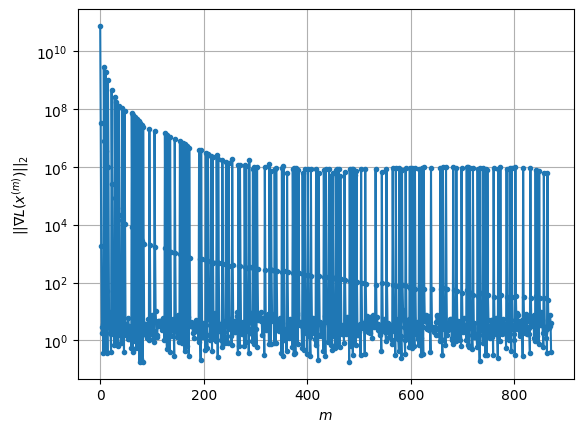

Windows:  12%|█▏        | 35/296 [37:06<1:29:29, 20.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5564.653709118599
Gradient norm: 544171.7436542268
Global relative error: 68.28132915212035
Position relative errors: 0.03117877922654757 m, 54.46100644580463 m, 31.49851046254663 m, 26.53621930740895 m

Iteration 1
Cost function: 5508.273828919982 (-1.01%)
Gradient norm: 27.41347227538097 (-99.99%)
Global relative error = 67.99563733182859 (-0.42%)
Position relative errors: 0.03425757560390899 m, 54.01919830654324 m, 31.604697011650828 m, 26.579396485797286 m

Iteration 2
Cost function: 5508.273829656789 (0.00%)
Gradient norm: 1.8443377693250307 (-93.27%)
Global relative error = 67.99563653862411 (-0.00%)
Position relative errors: 0.03425744405578996 m, 54.01919792502864 m, 31.604696068004873 m, 26.579396354219902 m

STOP on Iteration 3
Cost function = 5508.273830164328 (0.00%)
Gradient norm = 0.3405576202770872 (-81.53%)
Global relative error = 67.99563653908427 (0.00%)
Final position relative errors:

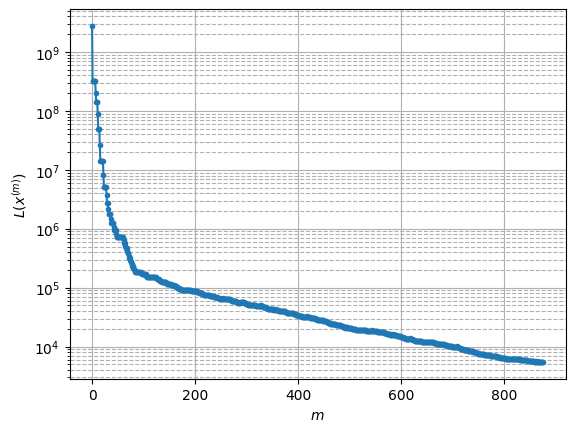

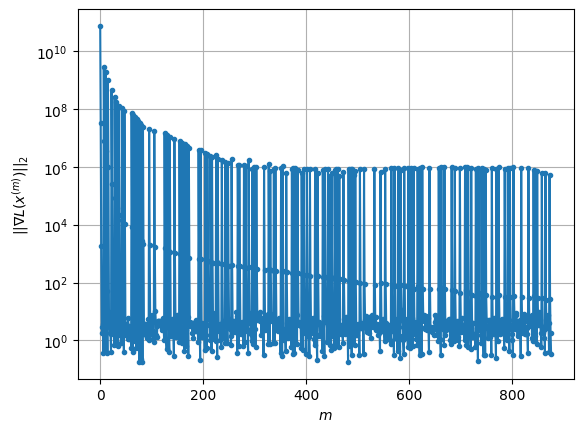

Windows:  12%|█▏        | 36/296 [37:17<1:16:05, 17.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5480.409414314799
Gradient norm: 520115.583166976
Global relative error: 73.63580608541155
Position relative errors: 0.034731168154222024 m, 57.35308488936776 m, 34.698754148981166 m, 30.476897278311853 m

Iteration 1
Cost function: 5426.269466974713 (-0.99%)
Gradient norm: 24.58414016257874 (-100.00%)
Global relative error = 73.35086478892167 (-0.39%)
Position relative errors: 0.02992316124496181 m, 56.929815661149185 m, 34.76506733913316 m, 30.507788205416013 m

Iteration 2
Cost function: 5426.269466349556 (-0.00%)
Gradient norm: 4.689115290960997 (-80.93%)
Global relative error = 73.35086412203025 (-0.00%)
Position relative errors: 0.029923058049116456 m, 56.92981527788338 m, 34.76506667482851 m, 30.50778807429604 m

Iteration 3
Cost function: 5426.269466736081 (0.00%)
Gradient norm: 8.127450864735758 (73.33%)
Global relative error = 73.35086412175151 (-0.00%)
Position relative errors: 0.029923054669

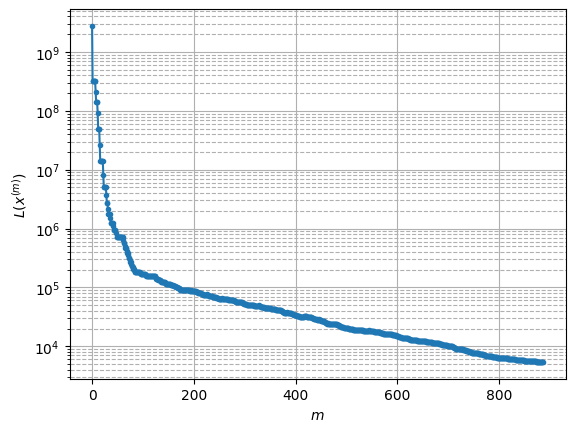

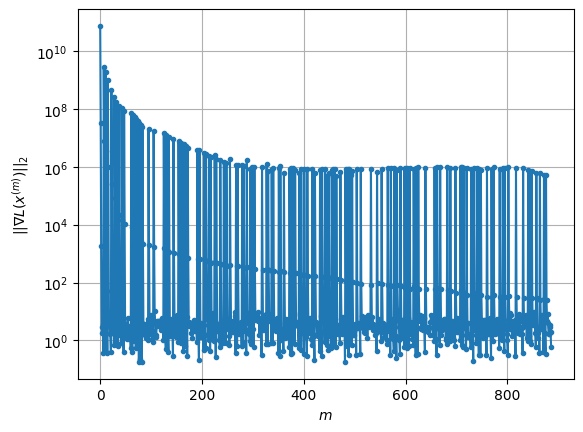

Windows:  12%|█▎        | 37/296 [37:46<1:31:25, 21.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5414.493698770467
Gradient norm: 521862.1511957292
Global relative error: 78.72081510251851
Position relative errors: 0.03036704973274795 m, 60.024046544710224 m, 37.69178594564593 m, 34.25493243485693 m

Iteration 1
Cost function: 5362.103343066486 (-0.97%)
Gradient norm: 25.24837828776104 (-100.00%)
Global relative error = 78.4336015158509 (-0.36%)
Position relative errors: 0.037663266921718126 m, 59.615367083250895 m, 37.72895003601744 m, 34.26885329730857 m

Iteration 2
Cost function: 5362.103342731756 (-0.00%)
Gradient norm: 2.3932404161317944 (-90.52%)
Global relative error = 78.43360084562225 (-0.00%)
Position relative errors: 0.03766312436061084 m, 59.61536660674628 m, 37.72894952507397 m, 34.26885315494111 m

Iteration 3
Cost function: 5362.103342974637 (0.00%)
Gradient norm: 3.0501716172252777 (27.45%)
Global relative error = 78.43360084644911 (0.00%)
Position relative errors: 0.03766312691243

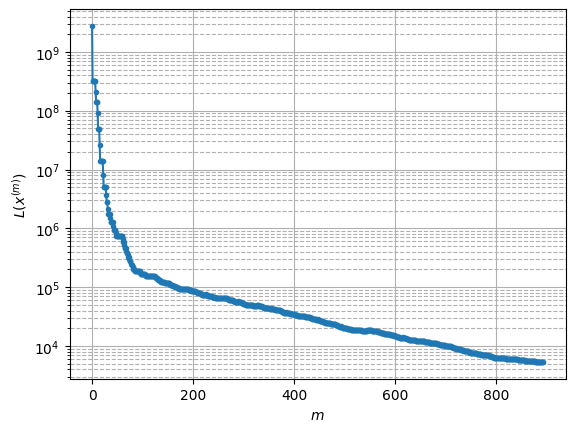

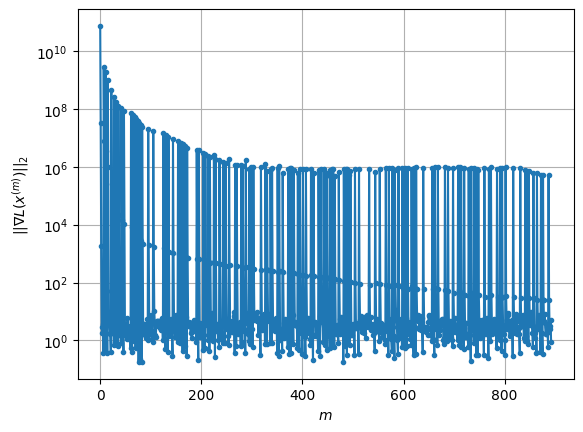

Windows:  13%|█▎        | 38/296 [38:02<1:24:12, 19.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5329.66527152179
Gradient norm: 419353.18729899864
Global relative error: 83.49761386777799
Position relative errors: 0.03734831908621808 m, 62.45954082722703 m, 40.47410416122991 m, 37.84831982896398 m

Iteration 1
Cost function: 5280.323774086617 (-0.93%)
Gradient norm: 22.223492241208834 (-99.99%)
Global relative error = 83.20991749432156 (-0.34%)
Position relative errors: 0.04065541144326616 m, 62.06542619811017 m, 40.482720911373754 m, 37.85384374369173 m

Iteration 2
Cost function: 5280.323773525059 (-0.00%)
Gradient norm: 4.482301269770149 (-79.83%)
Global relative error = 83.20991684499552 (-0.00%)
Position relative errors: 0.04065529497662534 m, 62.06542569235042 m, 40.482720482062824 m, 37.85384360484712 m

Iteration 3
Cost function: 5280.32377357501 (0.00%)
Gradient norm: 1.7626548903106702 (-60.68%)
Global relative error = 83.20991684434945 (-0.00%)
Position relative errors: 0.04065529072887

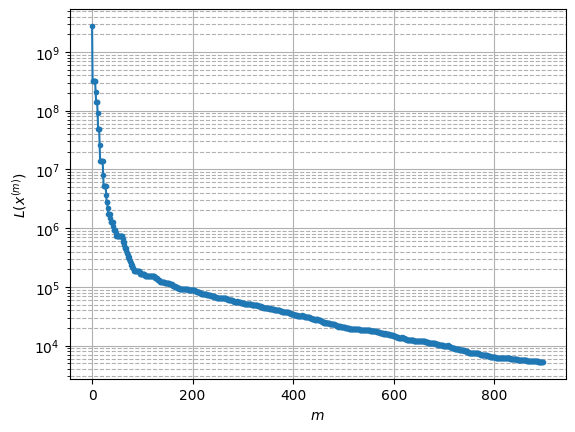

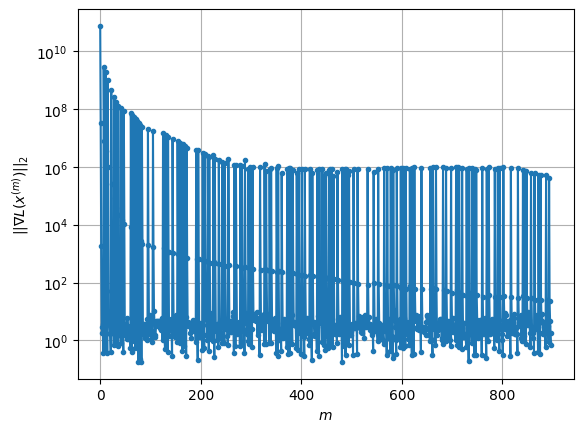

Windows:  13%|█▎        | 39/296 [38:15<1:15:49, 17.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5249.98913720609
Gradient norm: 395189.66358031717
Global relative error: 87.93730536383742
Position relative errors: 0.040335620126342994 m, 64.65006027878519 m, 43.03296827025233 m, 41.24918141378414 m

Iteration 1
Cost function: 5202.125973922331 (-0.91%)
Gradient norm: 23.054023849042732 (-99.99%)
Global relative error = 87.64782665316085 (-0.33%)
Position relative errors: 0.04756898560812271 m, 64.27182171861672 m, 43.015580167094676 m, 41.24228014864578 m

Iteration 2
Cost function: 5202.125973334756 (-0.00%)
Gradient norm: 1.3920837622841877 (-93.96%)
Global relative error = 87.64782622204646 (-0.00%)
Position relative errors: 0.04756887879477555 m, 64.2718214612167 m, 43.015579820755676 m, 41.24227999492859 m

Iteration 3
Cost function: 5202.125974082983 (0.00%)
Gradient norm: 3.081211059678466 (121.34%)
Global relative error = 87.6478262221915 (0.00%)
Position relative errors: 0.047568874661560

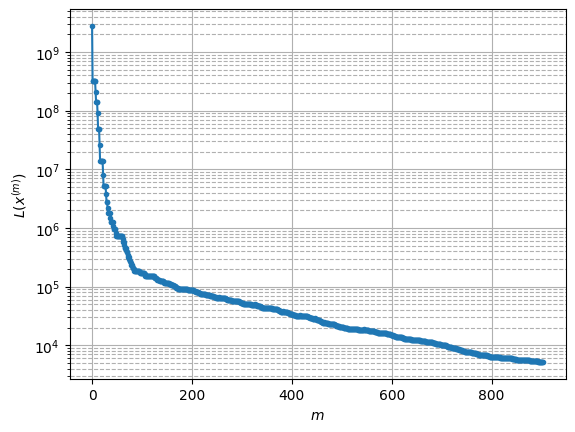

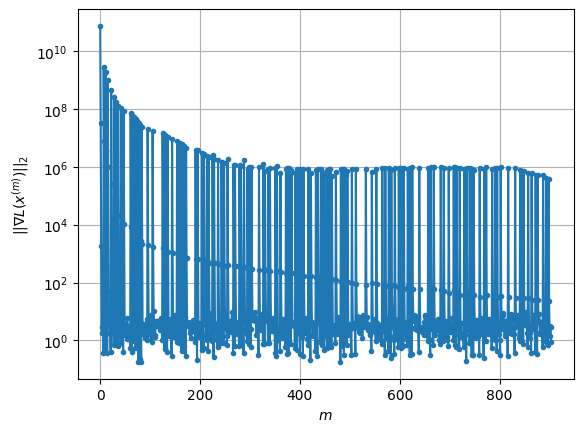

Windows:  14%|█▎        | 40/296 [38:31<1:13:01, 17.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5183.89239529992
Gradient norm: 431456.50540492346
Global relative error: 92.01235656309706
Position relative errors: 0.04699411095232632 m, 66.5883682521492 m, 45.3595581906235 m, 44.43833726075381 m

Iteration 1
Cost function: 5137.3334467472805 (-0.90%)
Gradient norm: 24.759123538547144 (-99.99%)
Global relative error = 91.72071589579535 (-0.32%)
Position relative errors: 0.04073018389756294 m, 66.22686845667711 m, 45.31557123800543 m, 44.42053106050655 m

Iteration 2
Cost function: 5137.33344674131 (-0.00%)
Gradient norm: 3.438242979763144 (-86.11%)
Global relative error = 91.72071574604067 (-0.00%)
Position relative errors: 0.04073009040477687 m, 66.22686854254013 m, 45.315570964636564 m, 44.42053090223764 m

Iteration 3
Cost function: 5137.3334465362295 (-0.00%)
Gradient norm: 5.25294518623595 (52.78%)
Global relative error = 91.7207157456623 (-0.00%)
Position relative errors: 0.0407300901694313 m

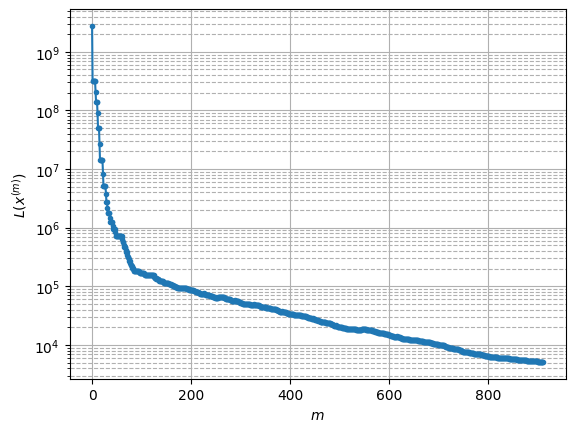

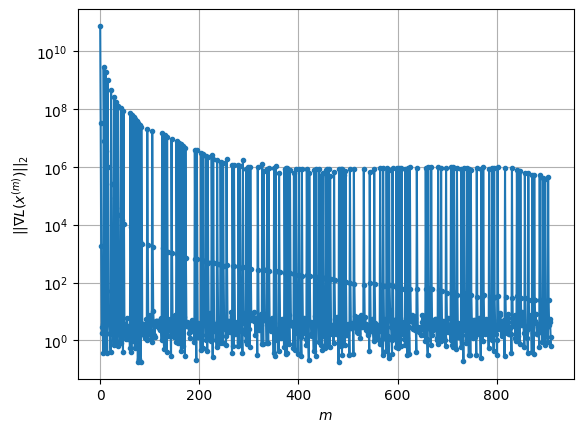

Windows:  14%|█▍        | 41/296 [38:50<1:14:32, 17.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5092.811056263865
Gradient norm: 307379.1373681517
Global relative error: 95.69969267330616
Position relative errors: 0.04027242046740566 m, 68.26783821991027 m, 47.44318873854553 m, 47.40328241485652 m

Iteration 1
Cost function: 5049.54448419131 (-0.85%)
Gradient norm: 24.717244055028107 (-99.99%)
Global relative error = 95.40472761818805 (-0.31%)
Position relative errors: 0.039157092709190794 m, 67.92056400246224 m, 47.370645429402764 m, 47.38011201730745 m

Iteration 2
Cost function: 5049.544484330792 (0.00%)
Gradient norm: 1.0753384117442446 (-95.65%)
Global relative error = 95.40472770396161 (0.00%)
Position relative errors: 0.03915700337357182 m, 67.92056441149204 m, 47.37064517743371 m, 47.38011185565902 m

Iteration 3
Cost function: 5049.5444847162435 (0.00%)
Gradient norm: 4.549938422926534 (323.12%)
Global relative error = 95.40472770375167 (-0.00%)
Position relative errors: 0.039157013507857

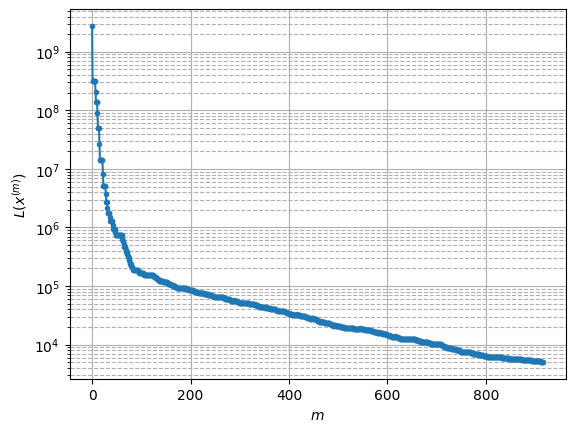

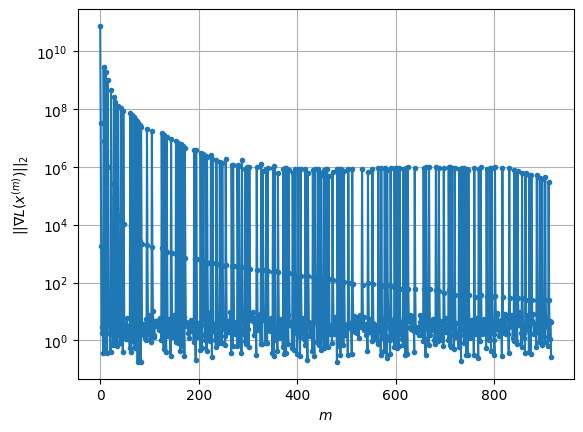

Windows:  14%|█▍        | 42/296 [39:05<1:11:26, 16.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5012.567070806838
Gradient norm: 619333.3778965814
Global relative error: 98.97883545729444
Position relative errors: 0.03859406002362902 m, 69.67947299326308 m, 49.27365001653395 m, 50.13664566041438 m

Iteration 1
Cost function: 4969.149280933417 (-0.87%)
Gradient norm: 25.456820051623144 (-100.00%)
Global relative error = 98.68378714987185 (-0.30%)
Position relative errors: 0.04579182380602953 m, 69.34941757258674 m, 49.177389602526205 m, 50.10715335708505 m

Iteration 2
Cost function: 4969.149279881841 (-0.00%)
Gradient norm: 5.750029621106091 (-77.41%)
Global relative error = 98.6837873393201 (0.00%)
Position relative errors: 0.04579174971913115 m, 69.34941815018968 m, 49.17738936229557 m, 50.107153166620066 m

STOP on Iteration 3
Cost function = 4969.149280354521 (0.00%)
Gradient norm = 0.41784908655143144 (-92.73%)
Global relative error = 98.68378733903442 (-0.00%)
Final position relative errors:

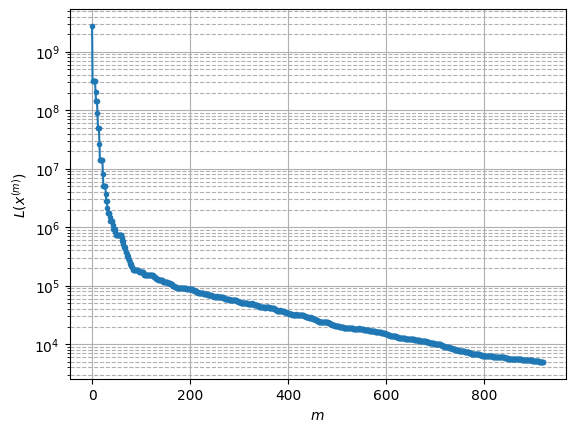

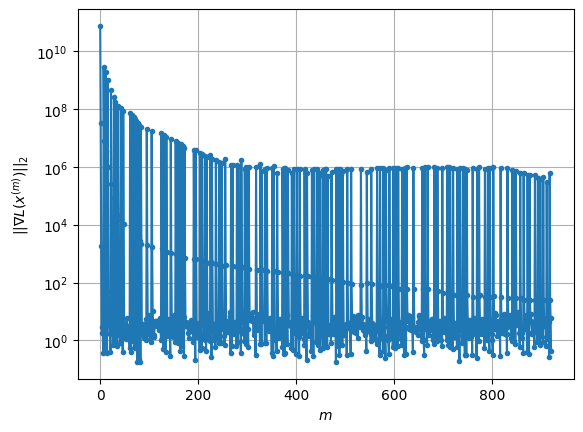

Windows:  15%|█▍        | 43/296 [39:16<1:03:13, 14.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4918.582695822657
Gradient norm: 287130.6091519174
Global relative error: 101.83618300042512
Position relative errors: 0.0445386278067044 m, 70.82084979987359 m, 50.848439327055345 m, 52.625534078858315 m

Iteration 1
Cost function: 4878.1571424824515 (-0.82%)
Gradient norm: 25.508470110577907 (-99.99%)
Global relative error = 101.53909225475219 (-0.29%)
Position relative errors: 0.048922932470286534 m, 70.50661065059913 m, 50.72884775818549 m, 52.58881963293159 m

Iteration 2
Cost function: 4878.157142696791 (0.00%)
Gradient norm: 1.157156298793798 (-95.46%)
Global relative error = 101.53909232129386 (0.00%)
Position relative errors: 0.048922873096276284 m, 70.50661103236862 m, 50.72884754013461 m, 52.58881945996088 m

Iteration 3
Cost function: 4878.157140883704 (-0.00%)
Gradient norm: 1.884771947425542 (62.88%)
Global relative error = 101.53909232074506 (-0.00%)
Position relative errors: 0.0489228776

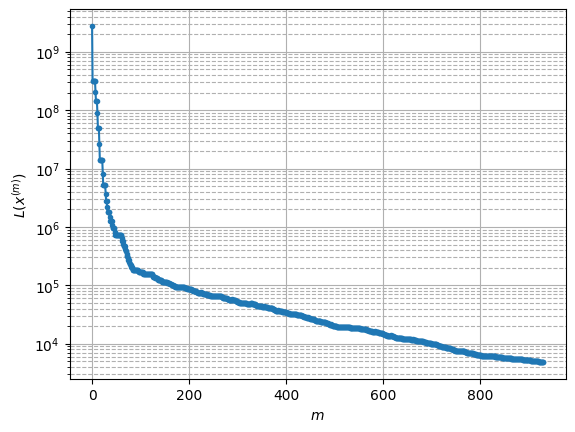

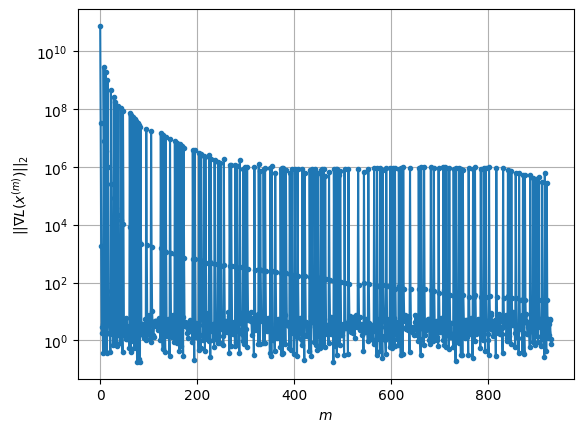

Windows:  15%|█▍        | 44/296 [39:41<1:15:47, 18.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4827.567740877352
Gradient norm: 263115.92253550957
Global relative error: 104.25583644844274
Position relative errors: 0.04747313920317138 m, 71.68628252169201 m, 52.161922173650915 m, 54.85878106820461 m

Iteration 1
Cost function: 4789.420423788951 (-0.79%)
Gradient norm: 24.85075445089566 (-99.99%)
Global relative error = 103.95695091268693 (-0.29%)
Position relative errors: 0.034738894854421234 m, 71.38736172059089 m, 52.020482483520624 m, 54.81567617434298 m

Iteration 2
Cost function: 4789.42042366796 (-0.00%)
Gradient norm: 1.6506657123130841 (-93.36%)
Global relative error = 103.9569504689252 (-0.00%)
Position relative errors: 0.034738862090744754 m, 71.38736130474483 m, 52.02048234436263 m, 54.81567600640242 m

STOP on Iteration 3
Cost function = 4789.420426169973 (0.00%)
Gradient norm = 0.4146155827829208 (-74.88%)
Global relative error = 103.95695046868182 (-0.00%)
Final position relative er

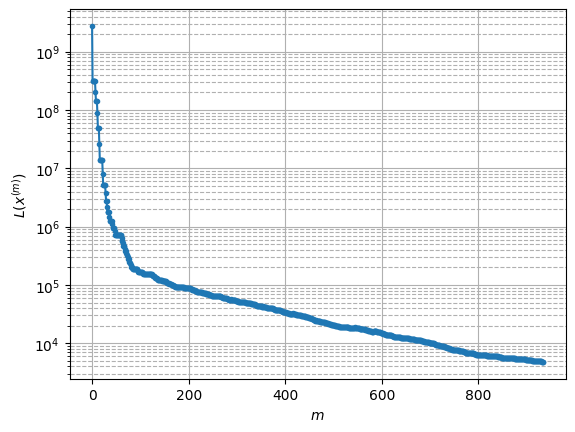

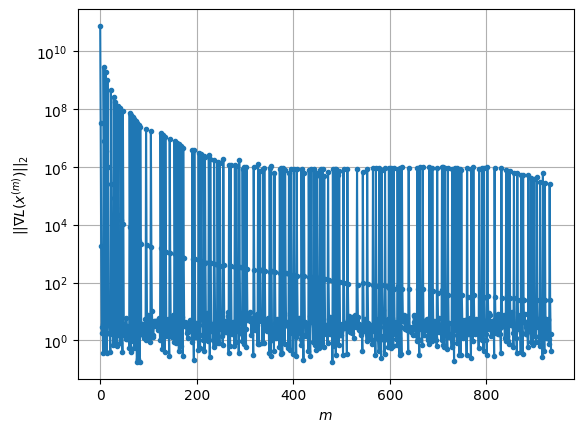

Windows:  15%|█▌        | 45/296 [39:51<1:05:55, 15.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4728.232333703718
Gradient norm: 226083.3383862993
Global relative error: 106.22667835042769
Position relative errors: 0.03376267313353448 m, 72.27204896964317 m, 53.21116540030609 m, 56.82805096932272 m

Iteration 1
Cost function: 4691.077290917798 (-0.79%)
Gradient norm: 20.076509015542914 (-99.99%)
Global relative error = 105.9278860405975 (-0.28%)
Position relative errors: 0.020899601290549637 m, 71.98905407525446 m, 53.046166502294106 m, 56.78376038788128 m

STOP on Iteration 2
Cost function = 4691.077289529594 (-0.00%)
Gradient norm = 0.7035697965820342 (-96.50%)
Global relative error = 105.9278856182735 (-0.00%)
Final position relative errors: 0.020899589286468557 m, 71.98905361839145 m, 53.04616646535763 m, 56.78376021376154 m

Majorization-Minimization converged after 1 iterations


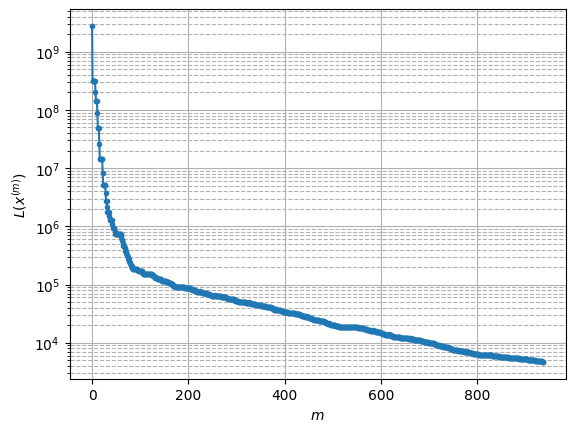

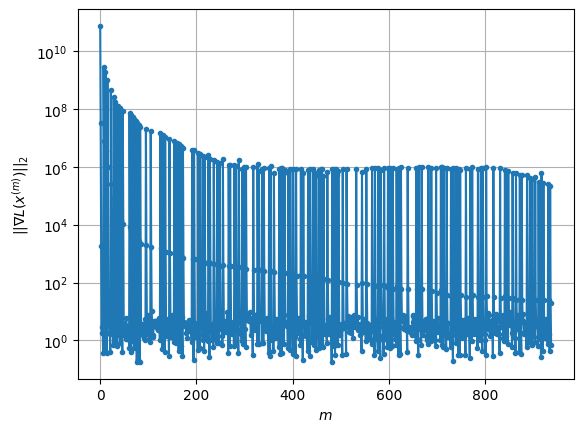

Windows:  16%|█▌        | 46/296 [39:59<56:00, 13.44s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4641.480749610562
Gradient norm: 173555.14323213501
Global relative error: 107.74162520132653
Position relative errors: 0.0203592305949426 m, 72.57663962178809 m, 53.99148045408959 m, 58.53040068425821 m

Iteration 1
Cost function: 4608.176606830535 (-0.72%)
Gradient norm: 19.734289441059353 (-99.99%)
Global relative error = 107.44018220148094 (-0.28%)
Position relative errors: 0.018272999153699343 m, 72.30991915946093 m, 53.80857933189182 m, 58.47481348242905 m

Iteration 2
Cost function: 4608.176607120173 (0.00%)
Gradient norm: 3.8875730090455693 (-80.30%)
Global relative error = 107.44018218045815 (-0.00%)
Position relative errors: 0.01827298320188324 m, 72.30991925031019 m, 53.80857932692674 m, 58.474813336031936 m

Iteration 3
Cost function: 4608.176606039189 (-0.00%)
Gradient norm: 5.158921362036243 (32.70%)
Global relative error = 107.44018218044884 (-0.00%)
Position relative errors: 0.0182729889

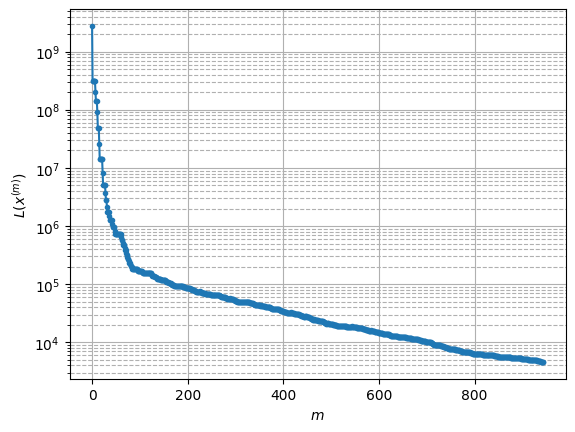

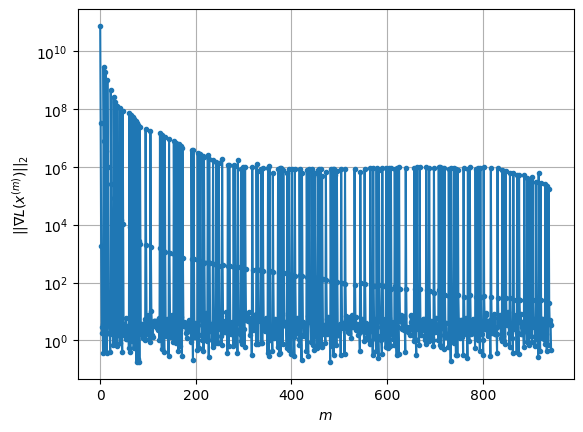

Windows:  16%|█▌        | 47/296 [40:15<58:16, 14.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4567.277451846063
Gradient norm: 139454.25571950534
Global relative error: 108.79157654235753
Position relative errors: 0.017698445571374816 m, 72.59934158363212 m, 54.506489179124664 m, 59.94984921631304 m

Iteration 1
Cost function: 4535.452209875604 (-0.70%)
Gradient norm: 22.85465781069335 (-99.98%)
Global relative error = 108.48976122246464 (-0.28%)
Position relative errors: 0.016795398445027594 m, 72.3472101373473 m, 54.3096506194718 m, 59.88631248753538 m

Iteration 2
Cost function: 4535.452210391197 (0.00%)
Gradient norm: 9.39956367358532 (-58.87%)
Global relative error = 108.48976110906344 (-0.00%)
Position relative errors: 0.016795401018256873 m, 72.34721005755657 m, 54.30965065400321 m, 59.886312347174965 m

Iteration 3
Cost function: 4535.452210217672 (-0.00%)
Gradient norm: 6.595290073255889 (-29.83%)
Global relative error = 108.48976110949253 (0.00%)
Position relative errors: 0.01679540193

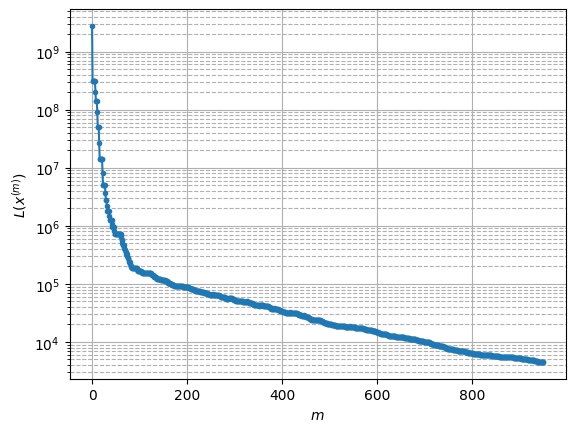

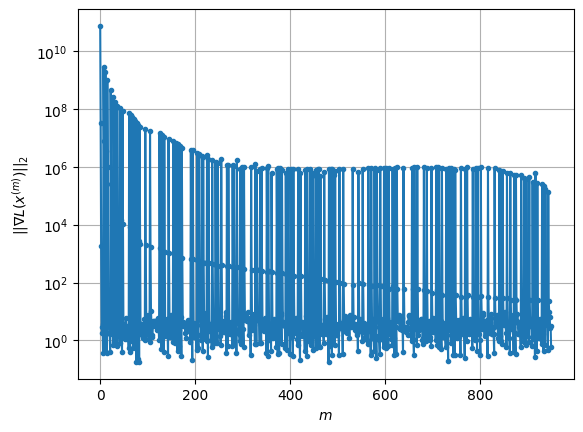

Windows:  16%|█▌        | 48/296 [40:33<1:03:10, 15.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4504.869088833593
Gradient norm: 200164.04200853553
Global relative error: 109.37453434028875
Position relative errors: 0.016287035503776307 m, 72.33861249120166 m, 54.759390481143235 m, 61.08455131861849 m

Iteration 1
Cost function: 4474.705629863 (-0.67%)
Gradient norm: 17.49610930388427 (-99.99%)
Global relative error = 109.07138512108477 (-0.28%)
Position relative errors: 0.018488109135263196 m, 72.10019590443535 m, 54.55132376470944 m, 61.0105004261947 m

Iteration 2
Cost function: 4474.705630050743 (0.00%)
Gradient norm: 2.5226530676258845 (-85.58%)
Global relative error = 109.0713854296471 (0.00%)
Position relative errors: 0.018488096914972368 m, 72.10019636012706 m, 54.551323918752196 m, 61.01050030157432 m

Iteration 3
Cost function: 4474.705630161663 (0.00%)
Gradient norm: 1.78024543550184 (-29.43%)
Global relative error = 109.07138542962348 (-0.00%)
Position relative errors: 0.01848809375520

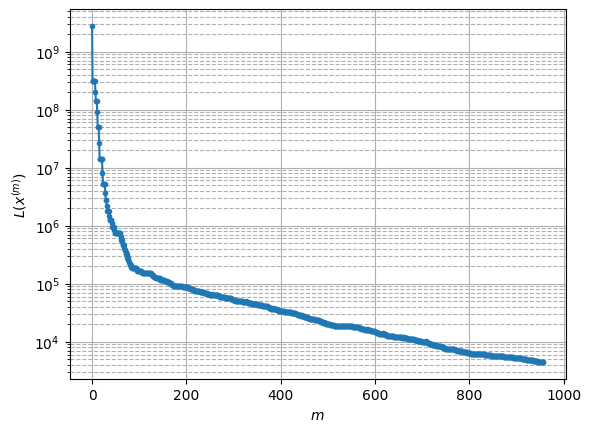

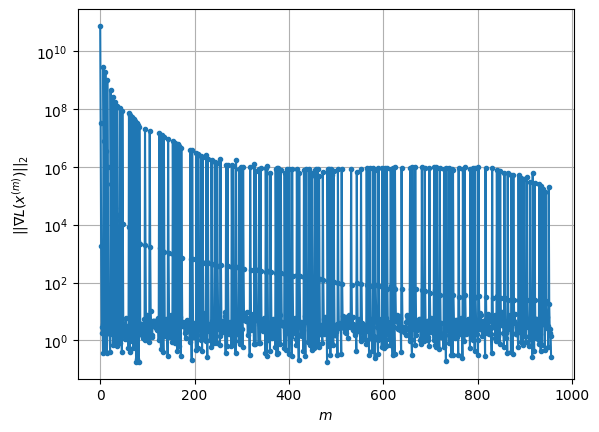

Windows:  17%|█▋        | 49/296 [40:49<1:03:40, 15.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4450.869007844498
Gradient norm: 142904.48054224602
Global relative error: 109.48784379915361
Position relative errors: 0.018020493528588206 m, 71.79486324826159 m, 54.75363352998805 m, 61.928382664918914 m

Iteration 1
Cost function: 4422.550782971631 (-0.64%)
Gradient norm: 16.10700323343403 (-99.99%)
Global relative error = 109.18511076832444 (-0.28%)
Position relative errors: 0.02333233542874898 m, 71.57069483817068 m, 54.53469099717005 m, 61.84650947053287 m

STOP on Iteration 2
Cost function = 4422.55078238457 (-0.00%)
Gradient norm = 0.4148795380362736 (-97.42%)
Global relative error = 109.1851108271271 (0.00%)
Final position relative errors: 0.023332338936262003 m, 71.57069489807961 m, 54.53469116591179 m, 61.84650935622238 m

Majorization-Minimization converged after 1 iterations


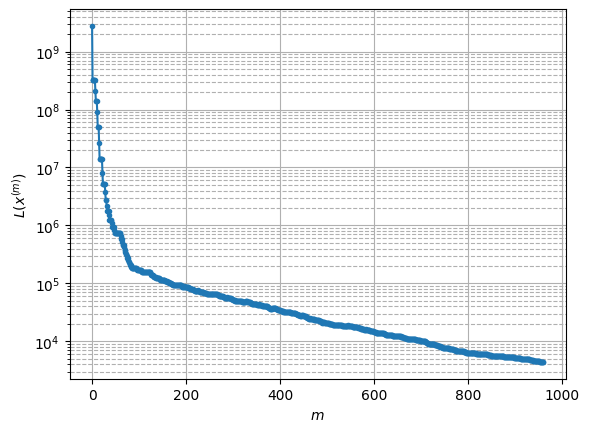

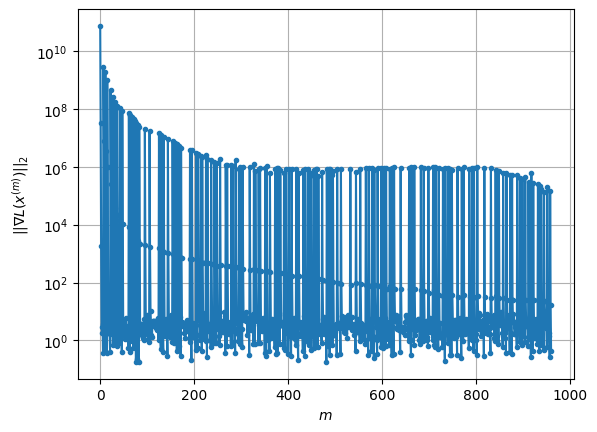

Windows:  17%|█▋        | 50/296 [40:57<54:17, 13.24s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4406.502244141832
Gradient norm: 132409.6821127671
Global relative error: 109.13348513076816
Position relative errors: 0.022578103270219484 m, 70.97109721497586 m, 54.491003397384105 m, 62.48160297693982 m

Iteration 1
Cost function: 4379.324301493301 (-0.62%)
Gradient norm: 16.866625351703888 (-99.99%)
Global relative error = 108.8308380905558 (-0.28%)
Position relative errors: 0.03585527084101204 m, 70.7612310280571 m, 54.26368118812644 m, 62.3895092456604 m

STOP on Iteration 2
Cost function = 4379.324301265042 (-0.00%)
Gradient norm = 0.7016977090080148 (-95.84%)
Global relative error = 108.83083834458952 (0.00%)
Final position relative errors: 0.0358552680242885 m, 70.76123132376017 m, 54.263681437105696 m, 62.3895091368594 m

Majorization-Minimization converged after 1 iterations


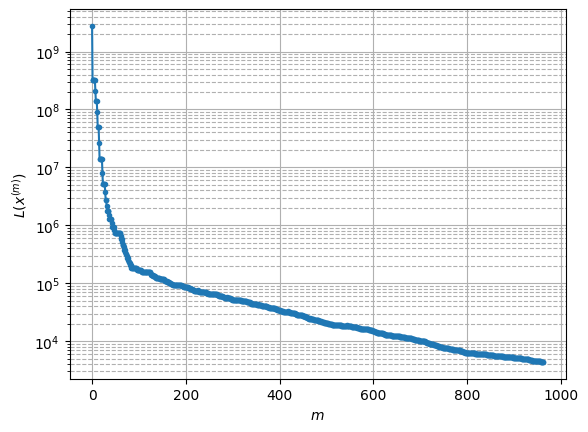

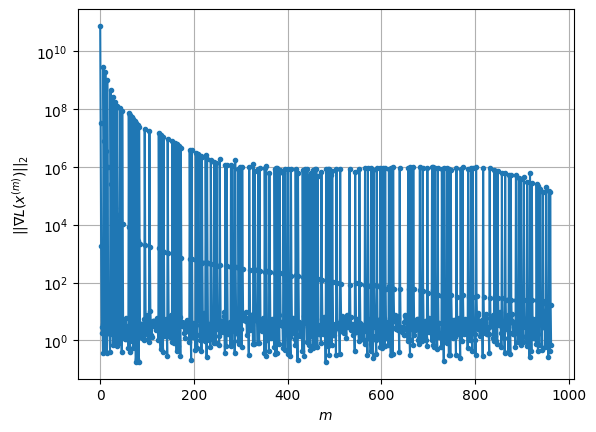

Windows:  17%|█▋        | 51/296 [41:05<47:49, 11.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4371.006155989529
Gradient norm: 400214.58593775856
Global relative error: 108.31380902575278
Position relative errors: 0.03479126329343417 m, 69.87110633845217 m, 53.976858049499505 m, 62.74079149998653 m

Iteration 1
Cost function: 4344.990314332819 (-0.60%)
Gradient norm: 14.642943804623059 (-100.00%)
Global relative error = 108.01057356716952 (-0.28%)
Position relative errors: 0.04887889464869465 m, 69.6752615766903 m, 53.741808727667056 m, 62.63750593193247 m

Iteration 2
Cost function: 4344.99031455366 (0.00%)
Gradient norm: 1.9127640357981976 (-86.94%)
Global relative error = 108.0105740995506 (0.00%)
Position relative errors: 0.04887888648838992 m, 69.67526218091285 m, 53.74180911926886 m, 62.63750584186563 m

Iteration 3
Cost function: 4344.990313685361 (-0.00%)
Gradient norm: 7.324442726693472 (282.92%)
Global relative error = 108.01057409949834 (-0.00%)
Position relative errors: 0.04887888559

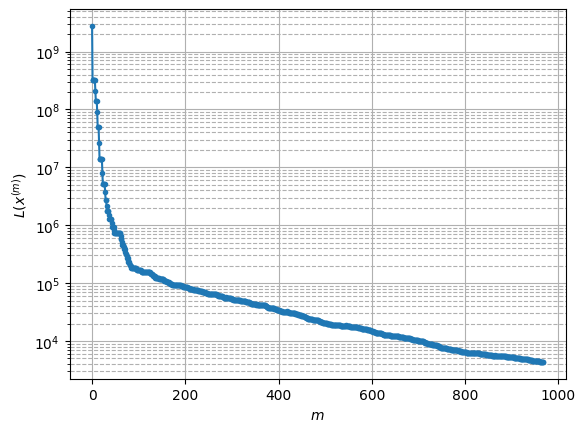

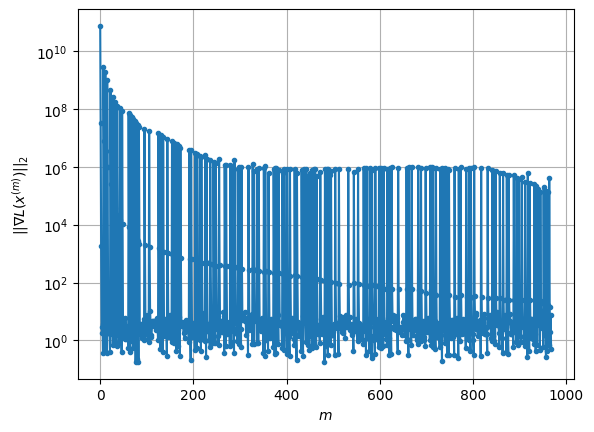

Windows:  18%|█▊        | 52/296 [41:18<49:07, 12.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4376.148086711687
Gradient norm: 211941.9088558024
Global relative error: 107.03300056647346
Position relative errors: 0.04724581974517315 m, 68.4993687560058 m, 53.21578645243118 m, 62.705477391746236 m

Iteration 1
Cost function: 4351.5669964953595 (-0.56%)
Gradient norm: 13.128419360579825 (-99.99%)
Global relative error = 106.729150580155 (-0.28%)
Position relative errors: 0.04823668381683248 m, 68.31814675499862 m, 52.97174765719676 m, 62.591799823790815 m

Iteration 2
Cost function: 4351.566995933463 (-0.00%)
Gradient norm: 2.6933922398468546 (-79.48%)
Global relative error = 106.7291509240023 (0.00%)
Position relative errors: 0.04823668923512115 m, 68.31814703752309 m, 52.97174807956793 m, 62.591799744275434 m

STOP on Iteration 3
Cost function = 4351.566995541188 (-0.00%)
Gradient norm = 0.6738991293367178 (-74.98%)
Global relative error = 106.7291509233101 (-0.00%)
Final position relative error

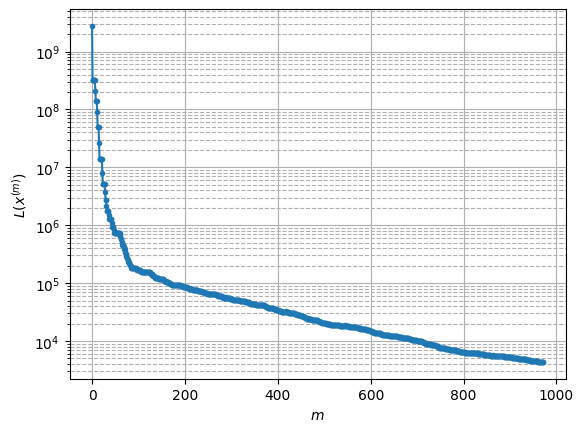

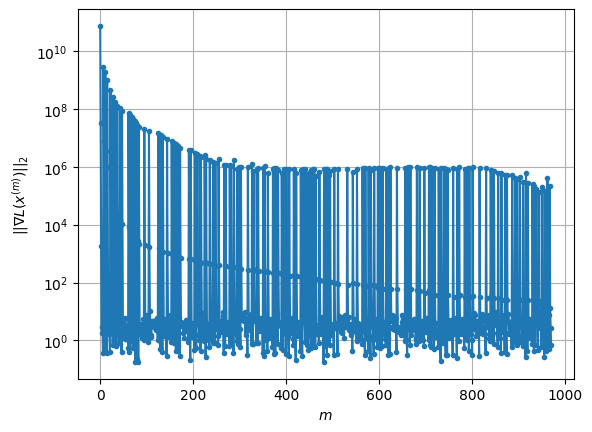

Windows:  18%|█▊        | 53/296 [41:29<47:24, 11.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4388.456256692719
Gradient norm: 345497.72704148426
Global relative error: 105.29792510577127
Position relative errors: 0.046537708068098683 m, 66.86247402287636 m, 52.2114130297168 m, 62.3781034607931 m

Iteration 1
Cost function: 4364.839272172207 (-0.54%)
Gradient norm: 17.58449672416972 (-99.99%)
Global relative error = 104.99268116057038 (-0.29%)
Position relative errors: 0.04057817957041075 m, 66.69682461274607 m, 51.95705497286425 m, 62.2531806113173 m

Iteration 2
Cost function: 4364.839272287411 (0.00%)
Gradient norm: 1.9789939408075394 (-88.75%)
Global relative error = 104.99268137792394 (0.00%)
Position relative errors: 0.0405782023712967 m, 66.69682465648437 m, 51.95705543688184 m, 62.25318054374526 m

Iteration 3
Cost function: 4364.839272317286 (0.00%)
Gradient norm: 3.5205206886772915 (77.89%)
Global relative error = 104.99268137775935 (-0.00%)
Position relative errors: 0.0405782047792450

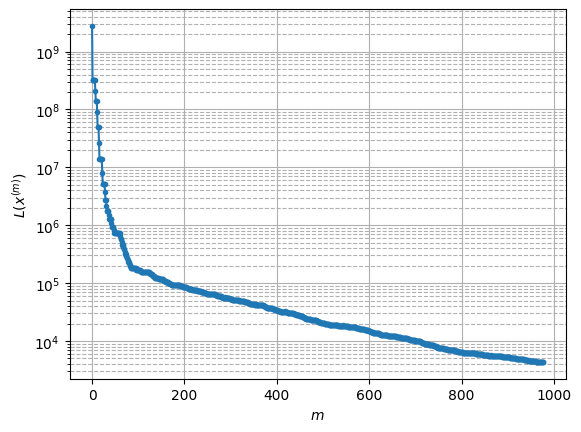

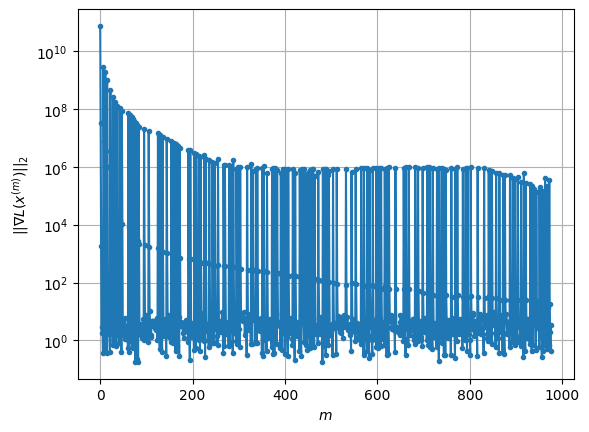

Windows:  18%|█▊        | 54/296 [41:42<48:39, 12.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4403.673732941977
Gradient norm: 240803.0682715317
Global relative error: 103.11684509586087
Position relative errors: 0.03944446998603536 m, 64.96849694408961 m, 50.968276033607246 m, 61.760909797408786 m

Iteration 1
Cost function: 4381.078784440137 (-0.51%)
Gradient norm: 11.141120999253406 (-100.00%)
Global relative error = 102.81107211630754 (-0.30%)
Position relative errors: 0.03358186241183054 m, 64.81787705270301 m, 50.7089436940171 m, 61.62272170092853 m

Iteration 2
Cost function: 4381.078783926086 (-0.00%)
Gradient norm: 1.4174836199537169 (-87.28%)
Global relative error = 102.81107241083447 (0.00%)
Position relative errors: 0.033581885411596936 m, 64.81787715178248 m, 50.7089442427112 m, 61.62272163656988 m

STOP on Iteration 3
Cost function = 4381.0787837771895 (-0.00%)
Gradient norm = 0.9211790427032792 (-35.01%)
Global relative error = 102.81107241096984 (0.00%)
Final position relative er

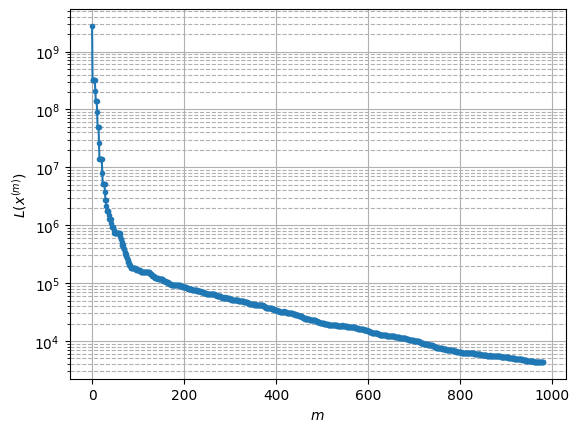

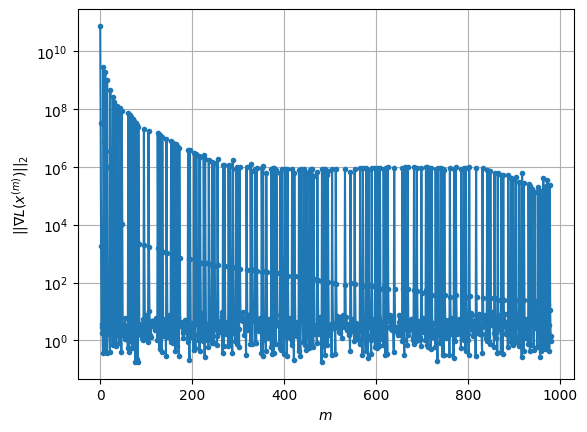

Windows:  19%|█▊        | 55/296 [41:52<46:19, 11.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4442.3823509776375
Gradient norm: 361031.5911493123
Global relative error: 100.50182749463754
Position relative errors: 0.03271923030762215 m, 62.82512752735457 m, 49.49885124370608 m, 60.85623495615888 m

Iteration 1
Cost function: 4420.416054997276 (-0.49%)
Gradient norm: 13.280308285189237 (-100.00%)
Global relative error = 100.19445963265407 (-0.31%)
Position relative errors: 0.027993475642115694 m, 62.69119464017975 m, 49.229634555047355 m, 60.705717762033785 m

Iteration 2
Cost function: 4420.416055580566 (0.00%)
Gradient norm: 1.1388286505250054 (-91.42%)
Global relative error = 100.19445982884433 (0.00%)
Position relative errors: 0.027993501397024896 m, 62.6911945546666 m, 49.229635134180185 m, 60.705717704492166 m

STOP on Iteration 3
Cost function = 4420.416054996037 (-0.00%)
Gradient norm = 0.33039708771442067 (-70.99%)
Global relative error = 100.19445982878152 (-0.00%)
Final position relati

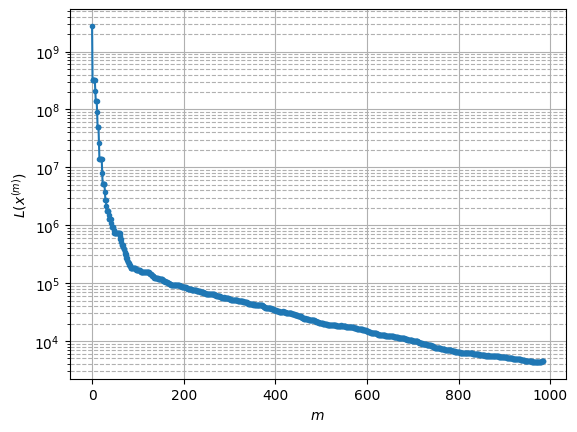

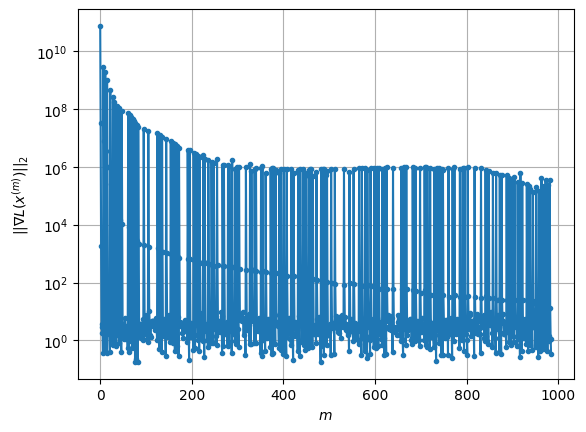

Windows:  19%|█▉        | 56/296 [42:03<45:07, 11.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4467.431066811648
Gradient norm: 464540.4897927261
Global relative error: 97.4649404580198
Position relative errors: 0.027338631284880396 m, 60.44334268055273 m, 47.806153598225514 m, 59.670639667894456 m

Iteration 1
Cost function: 4445.603342464249 (-0.49%)
Gradient norm: 12.038919565631097 (-100.00%)
Global relative error = 97.15854152291233 (-0.31%)
Position relative errors: 0.02594596957391444 m, 60.32656414141492 m, 47.53014167381168 m, 59.50941265695717 m

Iteration 2
Cost function: 4445.603341841964 (-0.00%)
Gradient norm: 3.4741218752788776 (-71.14%)
Global relative error = 97.1585418224521 (0.00%)
Position relative errors: 0.02594599771777305 m, 60.32656423251835 m, 47.53014225110074 m, 59.50941259255633 m

STOP on Iteration 3
Cost function = 4445.603342196016 (0.00%)
Gradient norm = 0.9965474055001089 (-71.32%)
Global relative error = 97.1585418226123 (0.00%)
Final position relative errors: 0

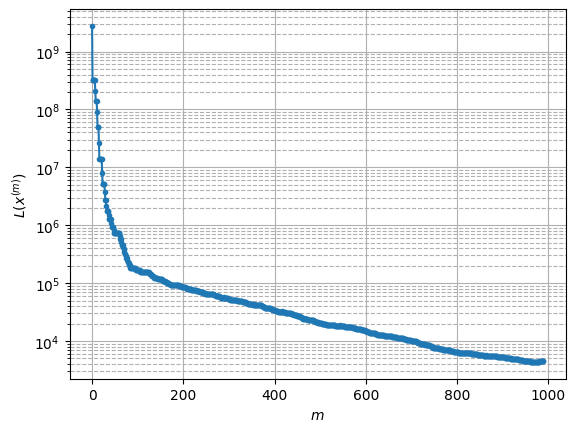

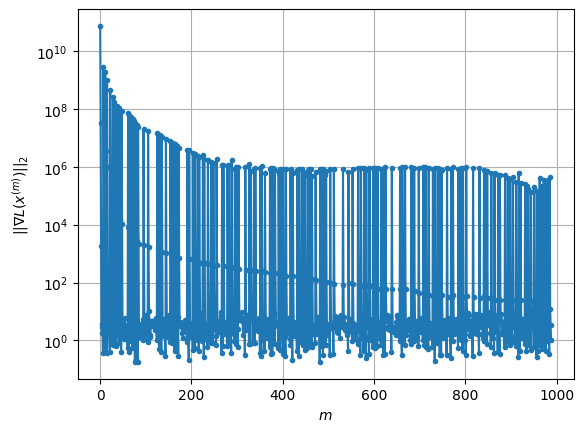

Windows:  19%|█▉        | 57/296 [42:14<44:48, 11.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4533.158900411438
Gradient norm: 321595.9461835274
Global relative error: 94.02372105944603
Position relative errors: 0.025624167974231934 m, 57.83388462390533 m, 45.902326223707064 m, 58.21232140382299 m

Iteration 1
Cost function: 4511.068992647475 (-0.49%)
Gradient norm: 16.38562668706033 (-99.99%)
Global relative error = 93.71689209143972 (-0.33%)
Position relative errors: 0.023422570488694422 m, 57.73457185949587 m, 45.61593529662066 m, 58.04099983299476 m

Iteration 2
Cost function: 4511.068992872207 (0.00%)
Gradient norm: 1.083471624055549 (-93.39%)
Global relative error = 93.71689238747713 (0.00%)
Position relative errors: 0.02342260492444266 m, 57.73457184438683 m, 45.615936018764764 m, 58.04099975846037 m

Iteration 3
Cost function: 4511.068992447557 (-0.00%)
Gradient norm: 3.5426538982329205 (226.97%)
Global relative error = 93.7168923879885 (0.00%)
Position relative errors: 0.023422603503653

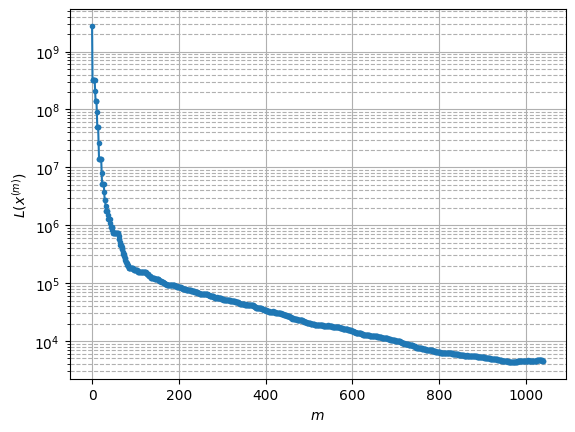

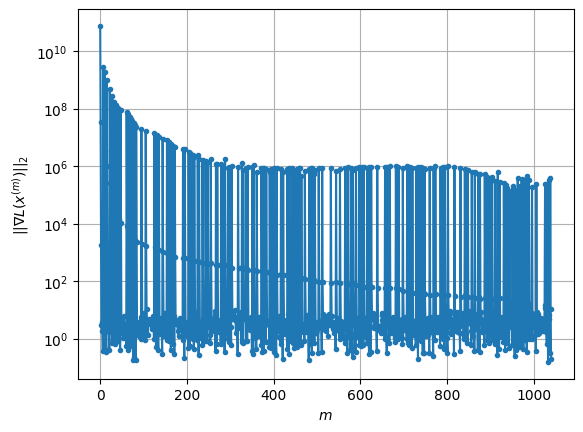

Windows:  22%|██▏       | 64/296 [44:28<53:16, 13.78s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4578.794197266563
Gradient norm: 644691.0720354983
Global relative error: 60.33649785126507
Position relative errors: 0.01337977879158545 m, 34.233016651914326 m, 27.689383923100404 m, 41.253878024730184 m

Iteration 1
Cost function: 4548.365245602916 (-0.66%)
Gradient norm: 6.786842624944133 (-100.00%)
Global relative error = 60.08729462844872 (-0.41%)
Position relative errors: 0.017361346545586416 m, 34.24889402517621 m, 27.420301924268152 m, 41.05623104080399 m

Iteration 2
Cost function: 4548.365244455959 (-0.00%)
Gradient norm: 1.3450389306656674 (-80.18%)
Global relative error = 60.08729487978186 (0.00%)
Position relative errors: 0.01736127787133771 m, 34.24889384025233 m, 27.42030286481594 m, 41.056230934765715 m

Iteration 3
Cost function: 4548.3652453154355 (0.00%)
Gradient norm: 4.434672595084645 (229.71%)
Global relative error = 60.08729488073421 (0.00%)
Position relative errors: 0.0173612645

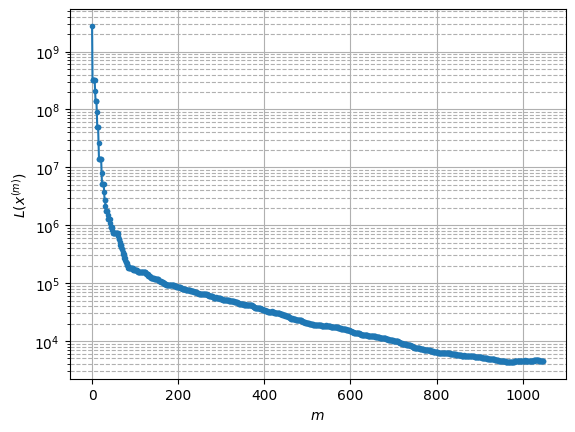

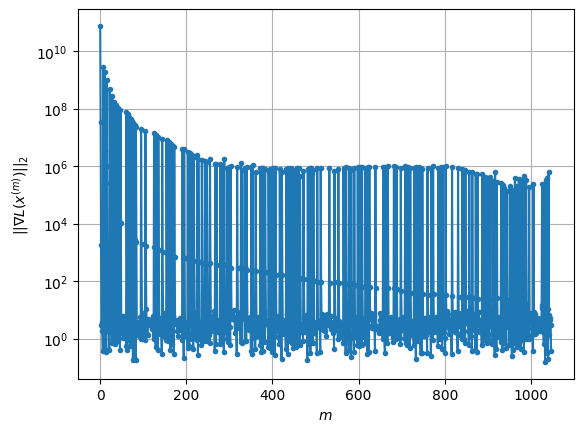

Windows:  22%|██▏       | 65/296 [44:47<58:00, 15.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4531.679505205362
Gradient norm: 520906.4112425472
Global relative error: 54.477681730769795
Position relative errors: 0.01620400072400829 m, 30.2798862974408 m, 24.597743782424608 m, 38.02482592015425 m

Iteration 1
Cost function: 4498.953230674149 (-0.72%)
Gradient norm: 10.802059457108708 (-100.00%)
Global relative error = 54.24677911478898 (-0.42%)
Position relative errors: 0.021193947745864368 m, 30.311098763814083 m, 24.348403056524894 m, 37.82982393621334 m

STOP on Iteration 2
Cost function = 4498.953229824896 (-0.00%)
Gradient norm = 0.7502096134500129 (-93.05%)
Global relative error = 54.246779345209994 (0.00%)
Final position relative errors: 0.021193875965698935 m, 30.311098560212294 m, 24.348403962632855 m, 37.8298238466079 m

Majorization-Minimization converged after 1 iterations


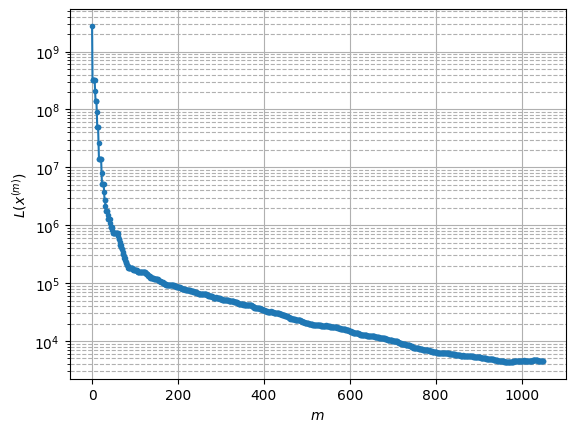

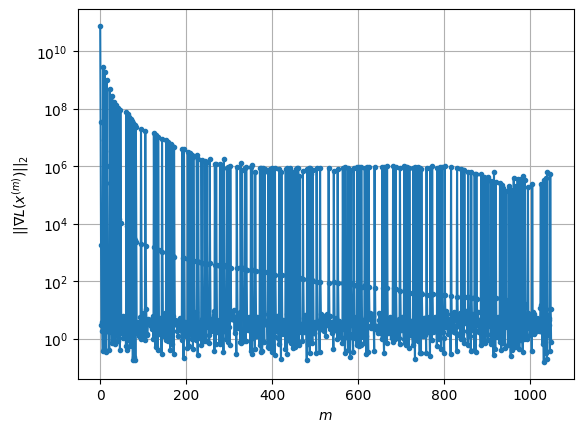

Windows:  22%|██▏       | 66/296 [44:55<50:13, 13.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4464.0271307686
Gradient norm: 450379.3697996613
Global relative error: 48.456308732270216
Position relative errors: 0.019762430736268627 m, 26.23154141459815 m, 21.44756903185099 m, 34.63973423218275 m

Iteration 1
Cost function: 4431.495023745798 (-0.73%)
Gradient norm: 7.3743164904857785 (-100.00%)
Global relative error = 48.248927287820216 (-0.43%)
Position relative errors: 0.01894243114479622 m, 26.276284440764087 m, 21.226130858566243 m, 34.452237191156534 m

Iteration 2
Cost function: 4431.495023742358 (-0.00%)
Gradient norm: 2.627797790173318 (-64.37%)
Global relative error = 48.24892747534184 (0.00%)
Position relative errors: 0.018942358362875607 m, 26.27628423227396 m, 21.226131654154855 m, 34.45223712266111 m

Iteration 3
Cost function: 4431.495022685838 (-0.00%)
Gradient norm: 1.3662040072368928 (-48.01%)
Global relative error = 48.24892747606149 (0.00%)
Position relative errors: 0.018942362

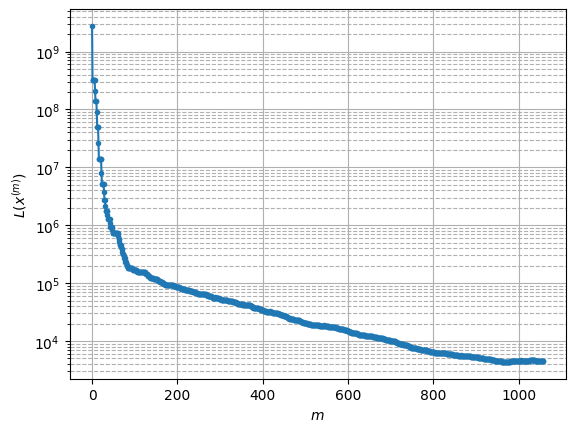

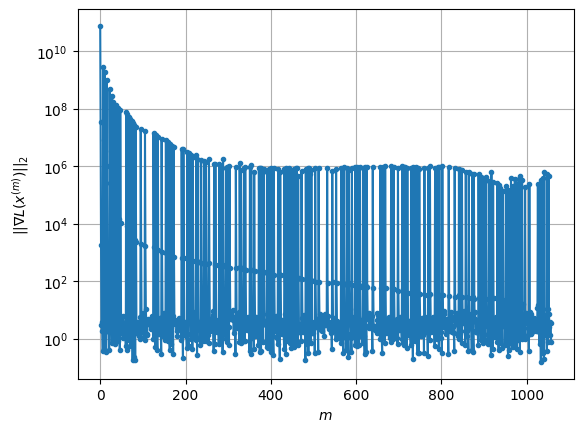

Windows:  23%|██▎       | 67/296 [45:14<56:29, 14.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4395.867705945606
Gradient norm: 521740.2474667613
Global relative error: 42.31877165587148
Position relative errors: 0.017898131234339927 m, 22.106919765783662 m, 18.269638476215857 m, 31.1186704495592 m

Iteration 1
Cost function: 4363.233711669217 (-0.74%)
Gradient norm: 7.343708459462424 (-100.00%)
Global relative error = 42.13978463814067 (-0.42%)
Position relative errors: 0.030518041219358232 m, 22.17372494417395 m, 18.080485537135413 m, 30.938191394089255 m

Iteration 2
Cost function: 4363.233712775102 (0.00%)
Gradient norm: 7.081228652446436 (-3.57%)
Global relative error = 42.1397847249357 (0.00%)
Position relative errors: 0.030517949574730748 m, 22.173724595904773 m, 18.080486291741433 m, 30.93819132101125 m

Iteration 3
Cost function: 4363.233711447754 (-0.00%)
Gradient norm: 6.981394553826599 (-1.41%)
Global relative error = 42.13978472515162 (0.00%)
Position relative errors: 0.0305179603084

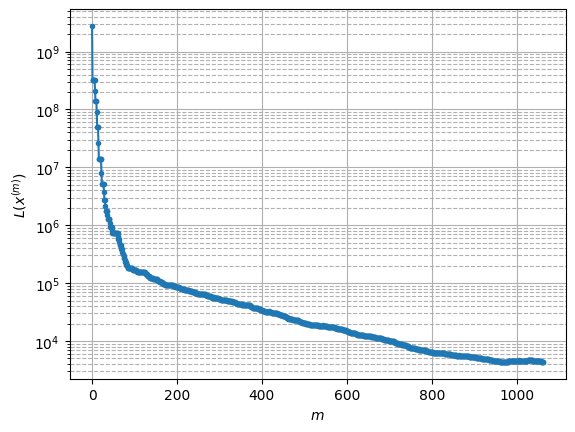

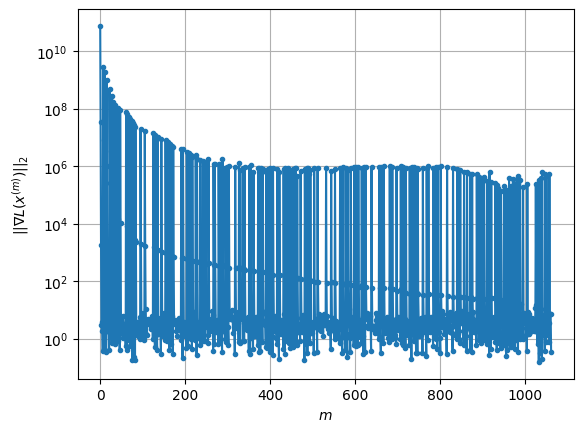

Windows:  23%|██▎       | 68/296 [45:27<54:34, 14.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4333.917579018529
Gradient norm: 430726.88250316604
Global relative error: 36.12168671545609
Position relative errors: 0.028694577379888356 m, 17.9399572687269 m, 15.097573997430006 m, 27.47699502087204 m

Iteration 1
Cost function: 4302.058113767927 (-0.74%)
Gradient norm: 9.952559515200942 (-100.00%)
Global relative error = 35.96534664312785 (-0.43%)
Position relative errors: 0.029733539321847968 m, 18.018663392770137 m, 14.932622088575616 m, 27.310044972538737 m

STOP on Iteration 2
Cost function = 4302.058113566365 (-0.00%)
Gradient norm = 0.5048833487149866 (-94.93%)
Global relative error = 35.965346671748996 (0.00%)
Final position relative errors: 0.0297334728435598 m, 18.018663031908627 m, 14.932622691286134 m, 27.310044918841825 m

Majorization-Minimization converged after 1 iterations


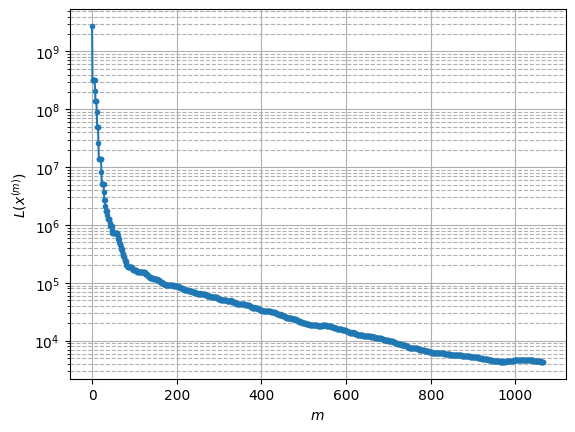

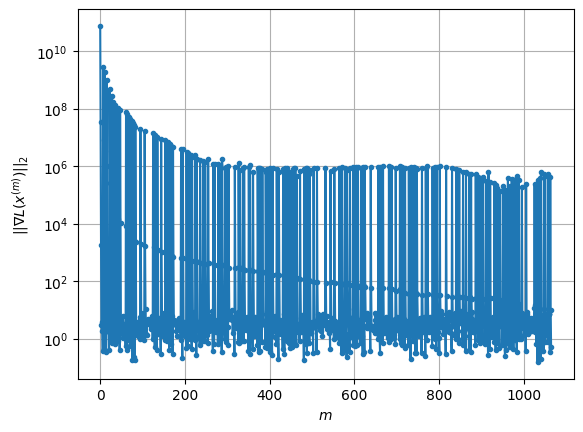

Windows:  23%|██▎       | 69/296 [45:36<47:49, 12.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4238.696389218019
Gradient norm: 354419.262145219
Global relative error: 29.931089429955936
Position relative errors: 0.028144087145520736 m, 13.754930868763765 m, 11.964929038292972 m, 23.738152973601544 m

Iteration 1
Cost function: 4207.802994048526 (-0.73%)
Gradient norm: 5.369860785871081 (-100.00%)
Global relative error = 29.80737036945227 (-0.41%)
Position relative errors: 0.019348346397639955 m, 13.864895456489464 m, 11.813922527191185 m, 23.59371057053558 m

Iteration 2
Cost function: 4207.802995054734 (0.00%)
Gradient norm: 2.7690271807877345 (-48.43%)
Global relative error = 29.807370302691638 (-0.00%)
Position relative errors: 0.01934828970183104 m, 13.864894920617806 m, 11.813923045268995 m, 23.59371054173145 m

Iteration 3
Cost function: 4207.80299379301 (-0.00%)
Gradient norm: 1.503879116779763 (-45.69%)
Global relative error = 29.807370301281942 (-0.00%)
Position relative errors: 0.01934

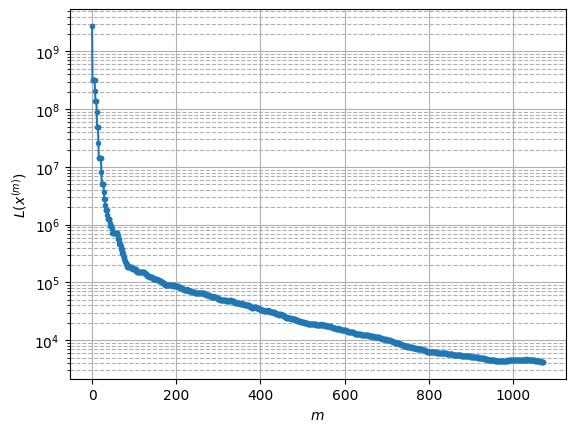

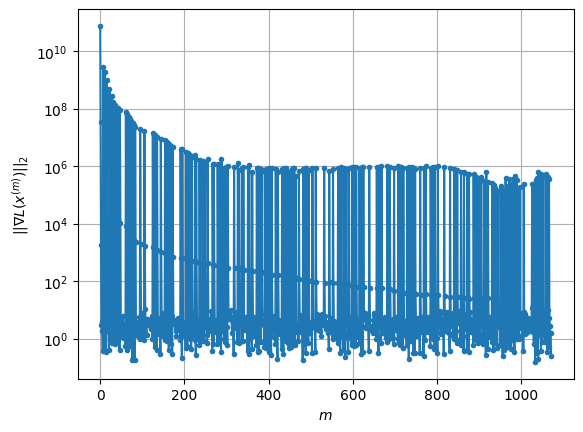

Windows:  24%|██▎       | 70/296 [45:52<51:20, 13.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4149.79542267448
Gradient norm: 404525.10175112577
Global relative error: 23.875184964351213
Position relative errors: 0.019087296943760705 m, 9.640128781643165 m, 8.938597458290133 m, 19.929410867089963 m

Iteration 1
Cost function: 4118.614710554733 (-0.75%)
Gradient norm: 5.684981835343397 (-100.00%)
Global relative error = 23.784679312938003 (-0.38%)
Position relative errors: 0.01223477666728712 m, 9.776631105816872 m, 8.795712802067197 m, 19.817965499385522 m

Iteration 2
Cost function: 4118.6147115306785 (0.00%)
Gradient norm: 2.3140942706839622 (-59.29%)
Global relative error = 23.784679210984482 (-0.00%)
Position relative errors: 0.012234744118144703 m, 9.776630449374109 m, 8.795713245797566 m, 19.81796550394325 m

Iteration 3
Cost function: 4118.614710373377 (-0.00%)
Gradient norm: 2.6388957806383297 (14.04%)
Global relative error = 23.784679211463843 (0.00%)
Position relative errors: 0.0122347

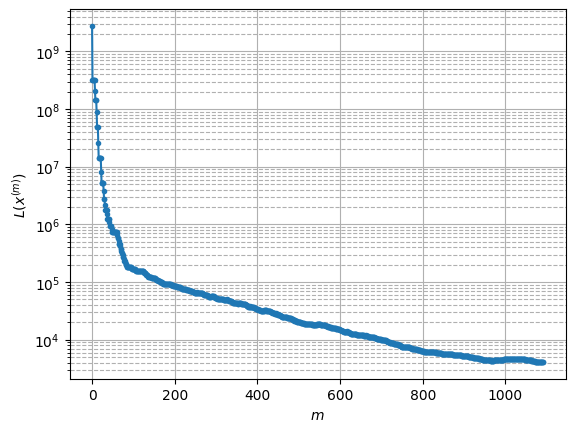

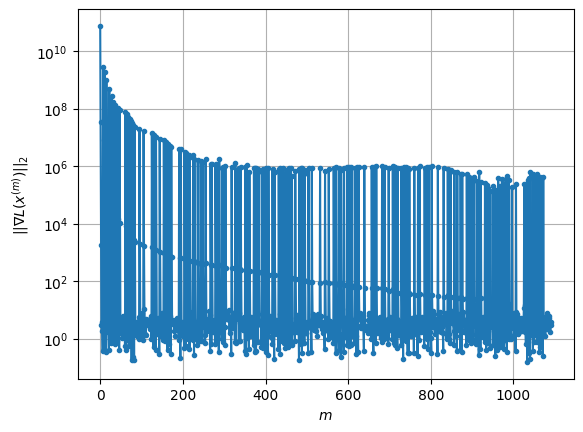

Windows:  24%|██▍       | 71/296 [46:42<1:32:17, 24.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4077.4713453231857
Gradient norm: 327784.43019265507
Global relative error: 18.18771536189974
Position relative errors: 0.012670761227137858 m, 5.802578062768011 m, 6.200323659990548 m, 16.08311652559132 m

Iteration 1
Cost function: 4049.4103224742203 (-0.69%)
Gradient norm: 10.444170638501866 (-100.00%)
Global relative error = 18.144359017400674 (-0.24%)
Position relative errors: 0.01135549093720876 m, 5.979908383116849 m, 6.139381309668624 m, 15.992315194918662 m

Iteration 2
Cost function: 4049.410322442781 (-0.00%)
Gradient norm: 1.5294014884334597 (-85.36%)
Global relative error = 18.144358796425394 (-0.00%)
Position relative errors: 0.011355486376253488 m, 5.979907410711735 m, 6.1393816233018805 m, 15.992315187412373 m

STOP on Iteration 3
Cost function = 4049.41032347791 (0.00%)
Gradient norm = 0.4626308732035136 (-69.75%)
Global relative error = 18.1443587988196 (0.00%)
Final position relative 

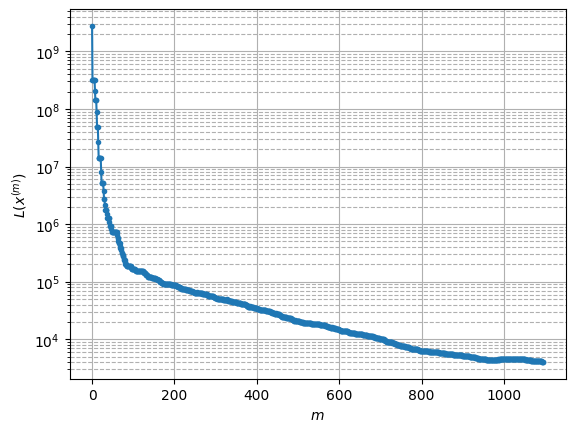

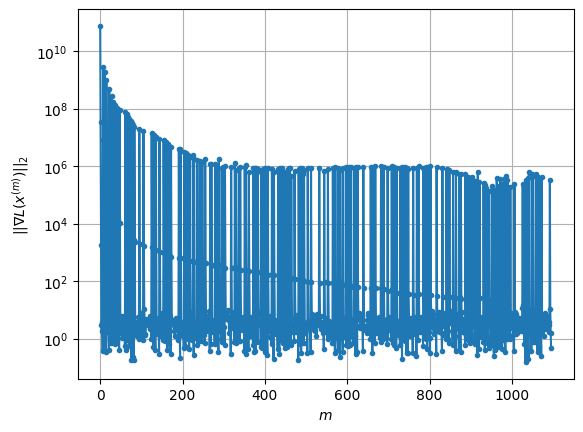

Windows:  24%|██▍       | 72/296 [46:52<1:15:56, 20.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4016.799309670628
Gradient norm: 324370.7294443469
Global relative error: 13.441139450165402
Position relative errors: 0.012144896161803496 m, 3.4350968426254274 m, 4.431216394730187 m, 12.215406376501221 m

Iteration 1
Cost function: 3991.120211940654 (-0.64%)
Gradient norm: 5.598439612122283 (-100.00%)
Global relative error = 13.445520217554389 (0.03%)
Position relative errors: 0.007471324736983003 m, 3.633200262778976 m, 4.466937095176419 m, 12.149732949203898 m

STOP on Iteration 2
Cost function = 3991.120211876082 (-0.00%)
Gradient norm = 0.5890915333756399 (-89.48%)
Global relative error = 13.445519821588471 (-0.00%)
Final position relative errors: 0.0074713127661956485 m, 3.633198856692641 m, 4.466937122944111 m, 12.149732921273248 m

Majorization-Minimization converged after 1 iterations


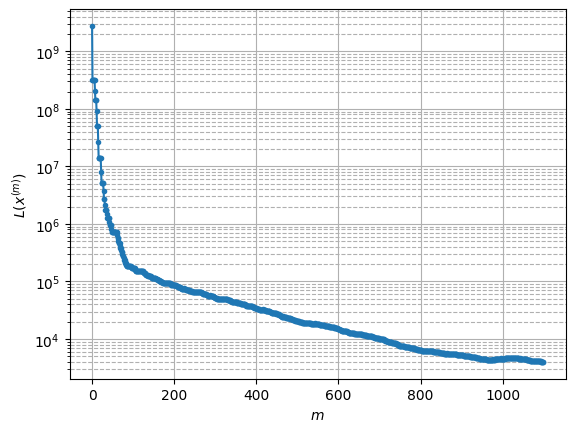

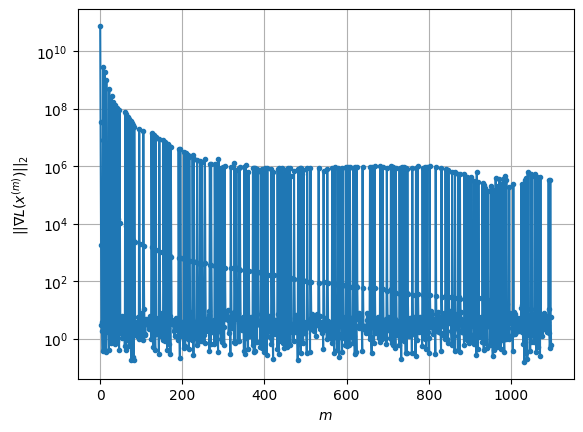

Windows:  25%|██▍       | 73/296 [47:01<1:02:12, 16.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3944.144255387589
Gradient norm: 215516.82174285734
Global relative error: 10.952037360273208
Position relative errors: 0.008109895273930178 m, 5.209387134407163 m, 4.745284726832258 m, 8.383273113221001 m

Iteration 1
Cost function: 3918.4917625461535 (-0.65%)
Gradient norm: 9.482143679101943 (-100.00%)
Global relative error = 11.006851510671966 (0.50%)
Position relative errors: 0.008172862585143622 m, 5.247268517457419 m, 4.798875262525387 m, 8.400917762119274 m

Iteration 2
Cost function: 3918.4917634698095 (0.00%)
Gradient norm: 1.2993813075122027 (-86.30%)
Global relative error = 11.00685098945331 (-0.00%)
Position relative errors: 0.008172884115031517 m, 5.247267758349577 m, 4.798874948246928 m, 8.400917732865302 m

Iteration 3
Cost function: 3918.4917646594117 (0.00%)
Gradient norm: 2.202244352226938 (69.48%)
Global relative error = 11.006850990549562 (0.00%)
Position relative errors: 0.008172883

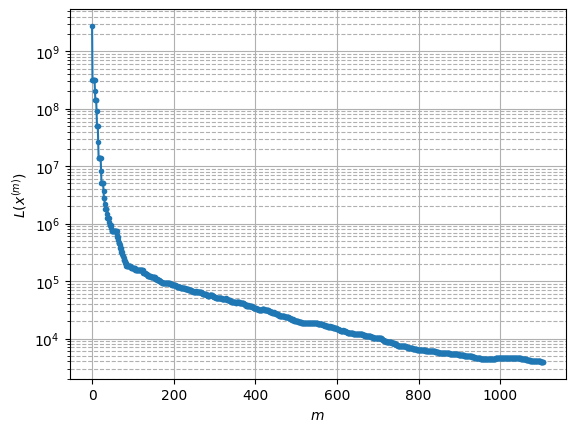

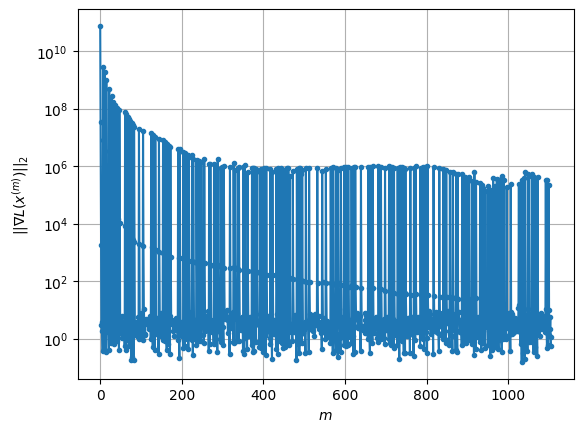

Windows:  25%|██▌       | 74/296 [47:19<1:03:35, 17.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3888.8793391552013
Gradient norm: 207157.4076017873
Global relative error: 12.158483215484653
Position relative errors: 0.008975877966730855 m, 8.873556132142818 m, 6.755409818395739 m, 4.841574685693402 m

Iteration 1
Cost function: 3865.225491682077 (-0.61%)
Gradient norm: 7.452910059500308 (-100.00%)
Global relative error = 12.229322285897156 (0.58%)
Position relative errors: 0.011449114935100861 m, 8.841668979714322 m, 6.837843275989081 m, 4.961132509723464 m

STOP on Iteration 2
Cost function = 3865.2254910777124 (-0.00%)
Gradient norm = 0.8327577398295649 (-88.83%)
Global relative error = 12.229321752179906 (-0.00%)
Final position relative errors: 0.011449161687477673 m, 8.84166862690491 m, 6.837842837057004 m, 4.9611324277250874 m

Majorization-Minimization converged after 1 iterations


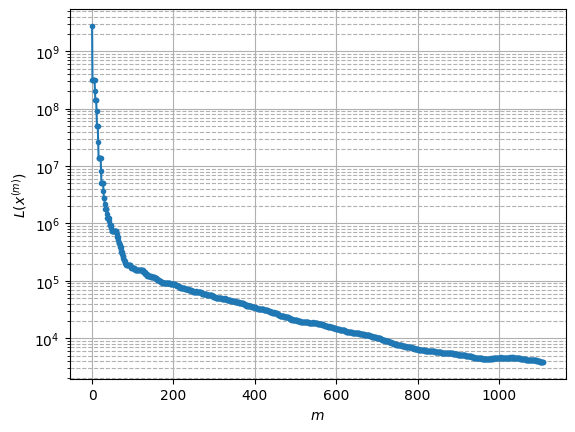

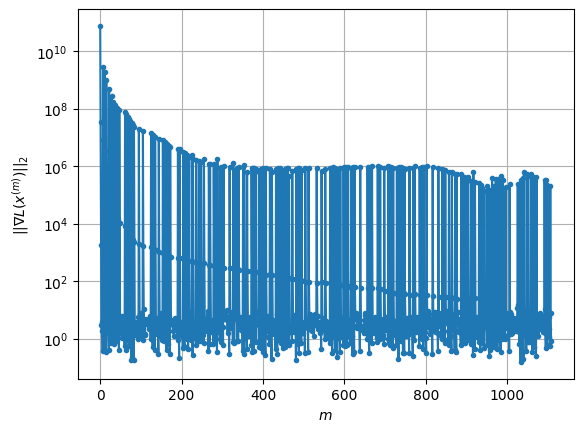

Windows:  25%|██▌       | 75/296 [47:27<53:17, 14.47s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3845.9608548286797
Gradient norm: 260550.25940091172
Global relative error: 16.187717707720086
Position relative errors: 0.011802982258760782 m, 12.858455669307881 m, 9.405124275408879 m, 2.869462453846785 m

Iteration 1
Cost function: 3823.419799825198 (-0.59%)
Gradient norm: 12.548836608101166 (-100.00%)
Global relative error = 16.228998897174026 (0.26%)
Position relative errors: 0.01013860698349826 m, 12.787820879784848 m, 9.469338163551523 m, 3.1893022893511227 m

Iteration 2
Cost function: 3823.419799918275 (0.00%)
Gradient norm: 2.609608216564875 (-79.20%)
Global relative error = 16.228998489198574 (-0.00%)
Position relative errors: 0.010138606274171057 m, 12.787820726724979 m, 9.469337727223353 m, 3.1893021225332454 m

STOP on Iteration 3
Cost function = 3823.419799582309 (-0.00%)
Gradient norm = 0.9747961753468634 (-62.65%)
Global relative error = 16.228998488160613 (-0.00%)
Final position relat

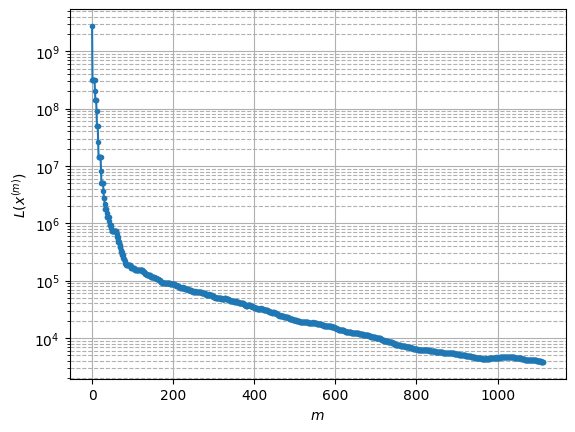

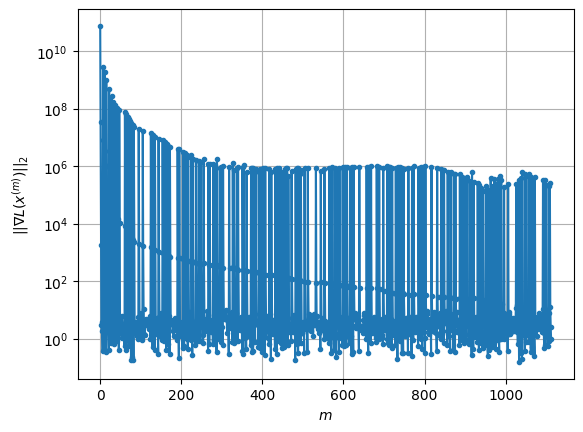

Windows:  26%|██▌       | 76/296 [47:38<49:03, 13.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3820.335446318365
Gradient norm: 272642.0663726481
Global relative error: 21.413351346664204
Position relative errors: 0.010763504307486564 m, 16.876407116715566 m, 12.214649863243233 m, 4.950659255334241 m

Iteration 1
Cost function: 3798.5470467629193 (-0.57%)
Gradient norm: 7.950605792587161 (-100.00%)
Global relative error = 21.41001361452338 (-0.02%)
Position relative errors: 0.01234320200702405 m, 16.767031100782543 m, 12.251335269386242 m, 5.210410433562086 m

STOP on Iteration 2
Cost function = 3798.5470463475795 (-0.00%)
Gradient norm = 0.6175042653091756 (-92.23%)
Global relative error = 21.410013284565824 (-0.00%)
Final position relative errors: 0.012343227173420618 m, 16.76703102928975 m, 12.251334846620209 m, 5.21041030179178 m

Majorization-Minimization converged after 1 iterations


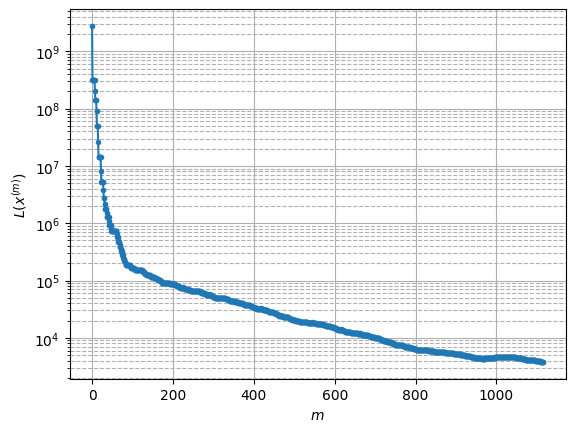

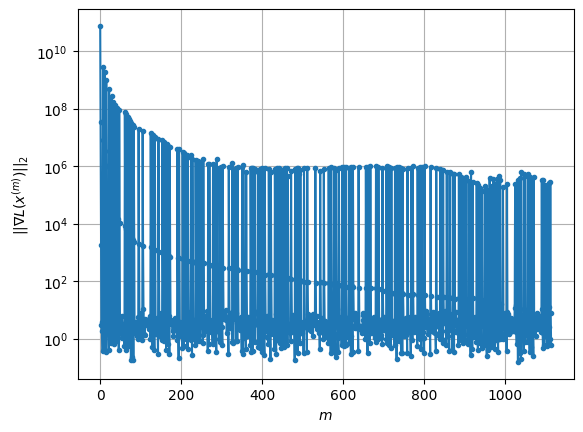

Windows:  26%|██▌       | 77/296 [47:46<42:58, 11.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3789.011499039128
Gradient norm: 415017.68919520156
Global relative error: 27.05054136032196
Position relative errors: 0.012928697362490218 m, 20.836915099732128 m, 15.030666156023832 m, 8.463001520058416 m

Iteration 1
Cost function: 3767.5606398303034 (-0.57%)
Gradient norm: 6.505660394068636 (-100.00%)
Global relative error = 27.01899636831925 (-0.12%)
Position relative errors: 0.012662199260263077 m, 20.71258905085048 m, 15.048013187909794 m, 8.634857511036378 m

Iteration 2
Cost function: 3767.560639944664 (0.00%)
Gradient norm: 1.6114335027471942 (-75.23%)
Global relative error = 27.01899608300097 (-0.00%)
Position relative errors: 0.012662235363034707 m, 20.712589018703923 m, 15.048012776668676 m, 8.634857411982619 m

Iteration 3
Cost function: 3767.560638374743 (-0.00%)
Gradient norm: 1.3469853118313133 (-16.41%)
Global relative error = 27.018996082036104 (-0.00%)
Position relative errors: 0.012

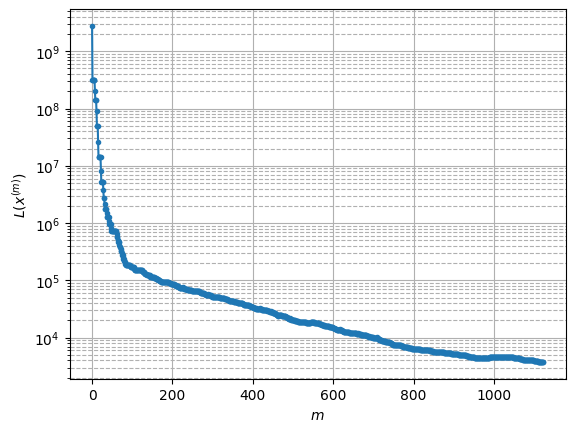

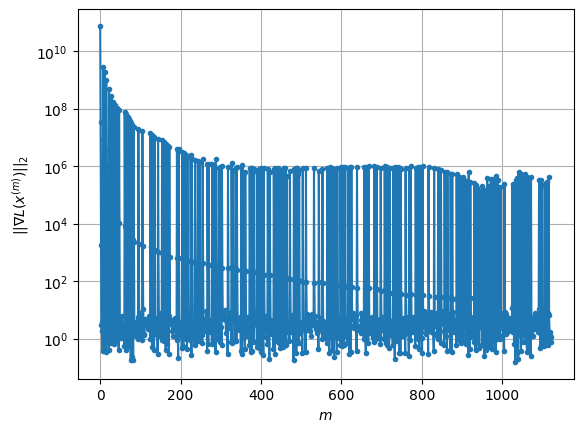

Windows:  26%|██▋       | 78/296 [48:04<49:23, 13.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3759.8579498783492
Gradient norm: 475461.5467775909
Global relative error: 32.79869299590503
Position relative errors: 0.012950226219415684 m, 24.716258429668144 m, 17.798921159497812 m, 12.167509987063909 m

Iteration 1
Cost function: 3739.331728726079 (-0.55%)
Gradient norm: 4.848020804677812 (-100.00%)
Global relative error = 32.738056756994915 (-0.18%)
Position relative errors: 0.011964094446596171 m, 24.579628968301265 m, 17.80390057137576 m, 12.273242626108518 m

Iteration 2
Cost function: 3739.3317295435813 (0.00%)
Gradient norm: 1.636624887814728 (-66.24%)
Global relative error = 32.73805652506534 (-0.00%)
Position relative errors: 0.011964116009280849 m, 24.57962896234137 m, 17.803900187367383 m, 12.27324257641594 m

Iteration 3
Cost function: 3739.3317288486633 (-0.00%)
Gradient norm: 3.3396902481422 (104.06%)
Global relative error = 32.73805652210328 (-0.00%)
Position relative errors: 0.01196

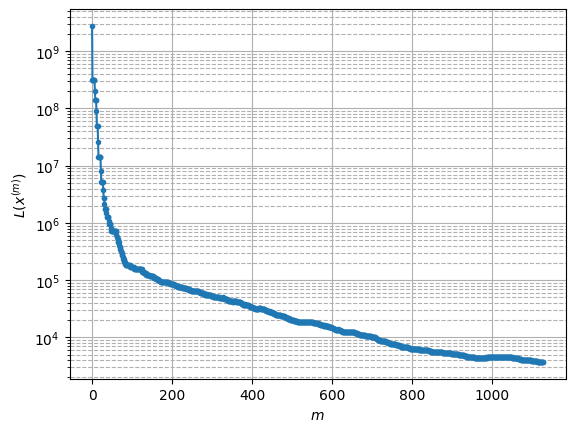

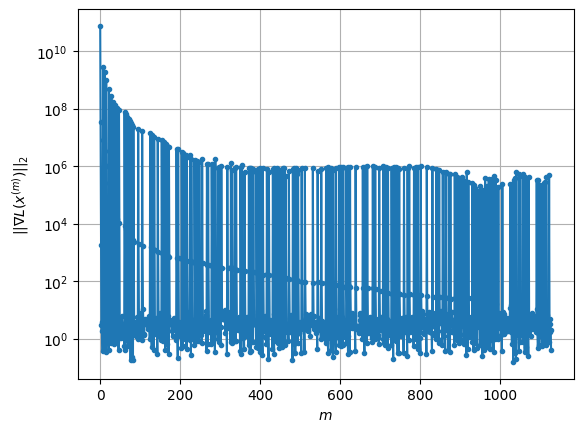

Windows:  27%|██▋       | 79/296 [48:20<51:33, 14.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3734.5725894047882
Gradient norm: 545985.467944288
Global relative error: 38.509636751239
Position relative errors: 0.012489951177864536 m, 28.48711280273791 m, 20.491061000062224 m, 15.861355459173694 m

Iteration 1
Cost function: 3714.343220211186 (-0.54%)
Gradient norm: 7.659869631132597 (-100.00%)
Global relative error = 38.426794005455314 (-0.22%)
Position relative errors: 0.015757624827817566 m, 28.346899862439784 m, 20.482157042238633 m, 15.923022252430236 m

Iteration 2
Cost function: 3714.343220948135 (0.00%)
Gradient norm: 2.8703176931717422 (-62.53%)
Global relative error = 38.426793817811486 (-0.00%)
Position relative errors: 0.015757638081875202 m, 28.346899870174855 m, 20.482156699266 m, 15.923022226979732 m

Iteration 3
Cost function: 3714.3432194507345 (-0.00%)
Gradient norm: 1.8653817696482948 (-35.01%)
Global relative error = 38.42679381818095 (0.00%)
Position relative errors: 0.015757

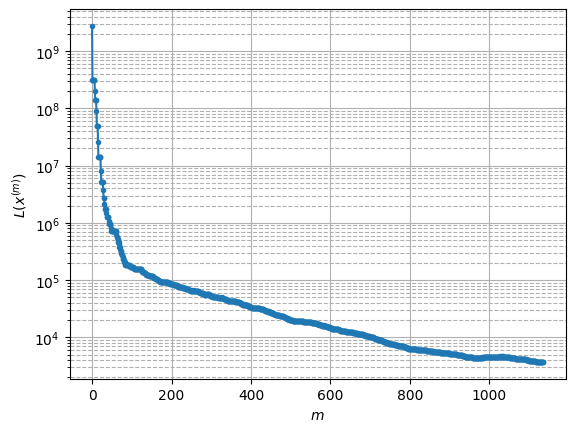

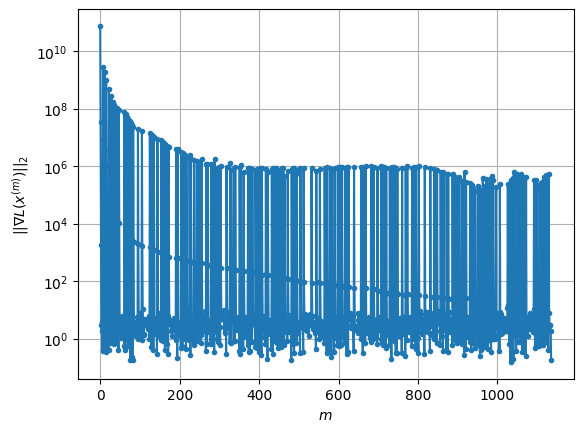

Windows:  27%|██▋       | 80/296 [48:38<55:48, 15.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3666.468492901231
Gradient norm: 558051.9645854027
Global relative error: 44.106059928297924
Position relative errors: 0.016398519144885708 m, 32.13448542499719 m, 23.08235810427675 m, 19.49139028959457 m

Iteration 1
Cost function: 3646.321239053985 (-0.55%)
Gradient norm: 3.387603958140851 (-100.00%)
Global relative error = 44.00848328399186 (-0.22%)
Position relative errors: 0.014498067813860345 m, 31.990030781717753 m, 23.06316768432083 m, 19.531132469116848 m

STOP on Iteration 2
Cost function = 3646.321238508842 (-0.00%)
Gradient norm = 0.25346293186001256 (-92.52%)
Global relative error = 44.00848309185772 (-0.00%)
Final position relative errors: 0.014498087993563846 m, 31.990030740332003 m, 23.06316738543967 m, 19.53113245689091 m

Majorization-Minimization converged after 1 iterations


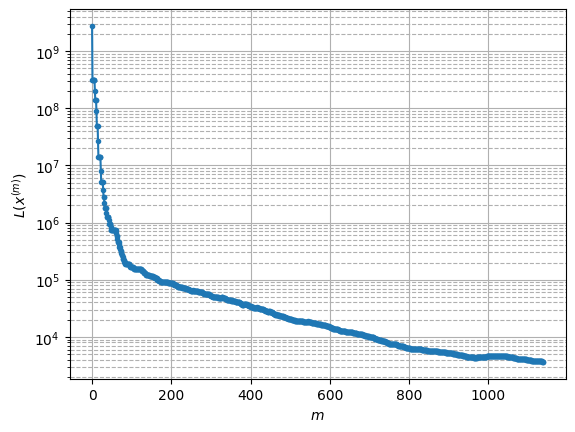

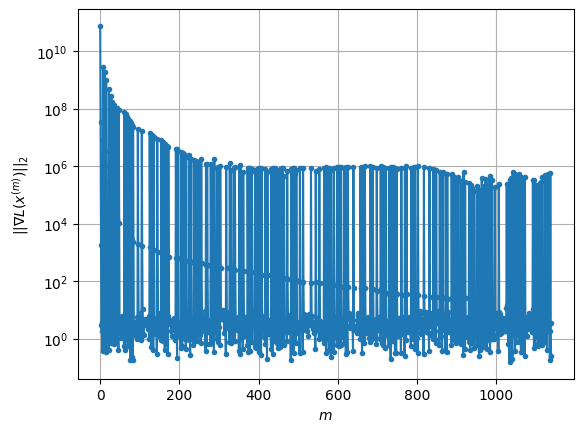

Windows:  27%|██▋       | 81/296 [48:46<48:00, 13.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3603.0555091899305
Gradient norm: 645970.7802992439
Global relative error: 49.53869489081753
Position relative errors: 0.014980159148387689 m, 35.638461047704354 m, 25.559290727687316 m, 23.036839399625016 m

Iteration 1
Cost function: 3582.7087336404034 (-0.56%)
Gradient norm: 10.764323807870325 (-100.00%)
Global relative error = 49.425451601194354 (-0.23%)
Position relative errors: 0.016372310089168795 m, 35.49331705575445 m, 25.534538141997107 m, 23.045130029990908 m

Iteration 2
Cost function: 3582.708733628006 (-0.00%)
Gradient norm: 2.3691146698791234 (-77.99%)
Global relative error = 49.425451449669225 (-0.00%)
Position relative errors: 0.01637231765356701 m, 35.49331702169285 m, 25.53453789622315 m, 23.045130029787714 m

STOP on Iteration 3
Cost function = 3582.7087327349436 (-0.00%)
Gradient norm = 0.9754580826442775 (-58.83%)
Global relative error = 49.42545144935246 (-0.00%)
Final position re

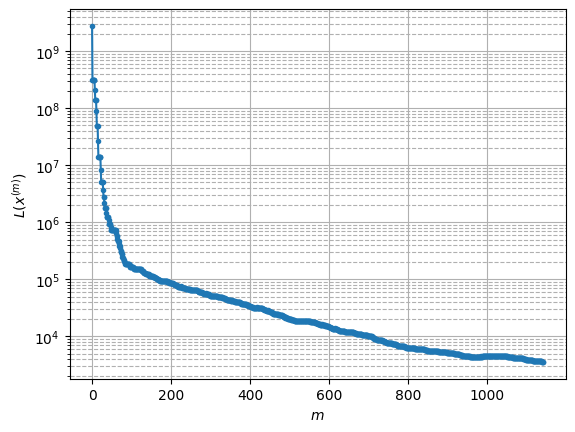

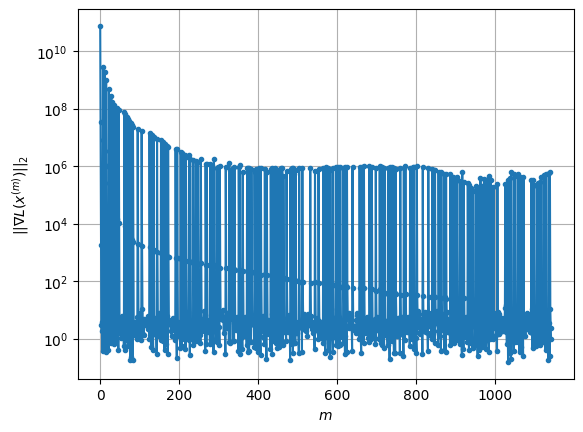

Windows:  28%|██▊       | 82/296 [48:58<45:23, 12.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3557.7826978044204
Gradient norm: 648653.0413279892
Global relative error: 54.765005965253394
Position relative errors: 0.017048202914259243 m, 38.985153394250645 m, 27.912306569273206 m, 26.462396695574753 m

Iteration 1
Cost function: 3537.68511554815 (-0.56%)
Gradient norm: 4.792262893400001 (-100.00%)
Global relative error = 54.63726835079841 (-0.23%)
Position relative errors: 0.014992667473641655 m, 38.8403985969866 m, 27.875704255639207 m, 26.44978961571182 m

STOP on Iteration 2
Cost function = 3537.6851146114914 (-0.00%)
Gradient norm = 0.6610401658061994 (-86.21%)
Global relative error = 54.637268247707006 (-0.00%)
Final position relative errors: 0.014992676445391866 m, 38.84039858831218 m, 27.875704070694745 m, 26.449789610402444 m

Majorization-Minimization converged after 1 iterations


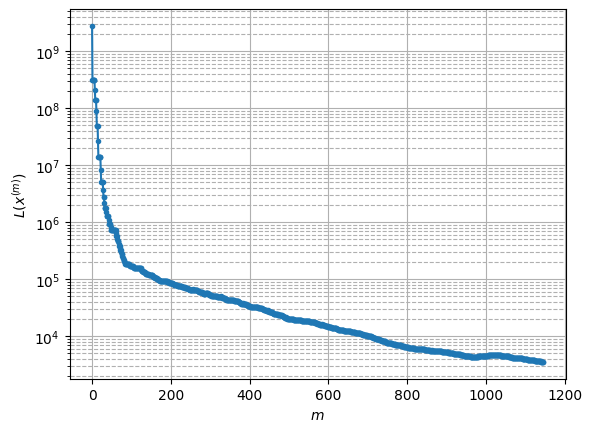

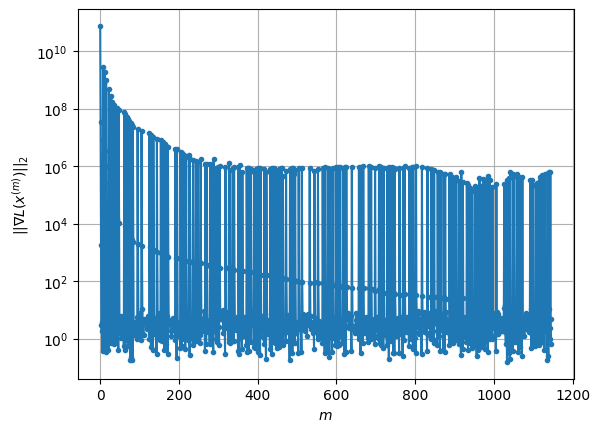

Windows:  28%|██▊       | 83/296 [49:06<40:32, 11.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3524.0654266789224
Gradient norm: 698704.5627095695
Global relative error: 59.75214640703288
Position relative errors: 0.015619223973359497 m, 42.159140956456 m, 30.12314048835013 m, 29.757598460611792 m

Iteration 1
Cost function: 3502.991847768535 (-0.60%)
Gradient norm: 3.02715739291831 (-100.00%)
Global relative error = 59.60751984835953 (-0.24%)
Position relative errors: 0.014374033697067677 m, 42.00960517946836 m, 30.075129736422525 m, 29.727572797205248 m

Iteration 2
Cost function: 3502.991847799043 (0.00%)
Gradient norm: 2.7731755345331712 (-8.39%)
Global relative error = 59.60751976684777 (-0.00%)
Position relative errors: 0.014374040763237105 m, 42.00960515924036 m, 30.075129633470553 m, 29.7275727665002 m

Iteration 3
Cost function: 3502.9918483021074 (0.00%)
Gradient norm: 1.459575720535701 (-47.37%)
Global relative error = 59.607519767833075 (0.00%)
Position relative errors: 0.014374040385

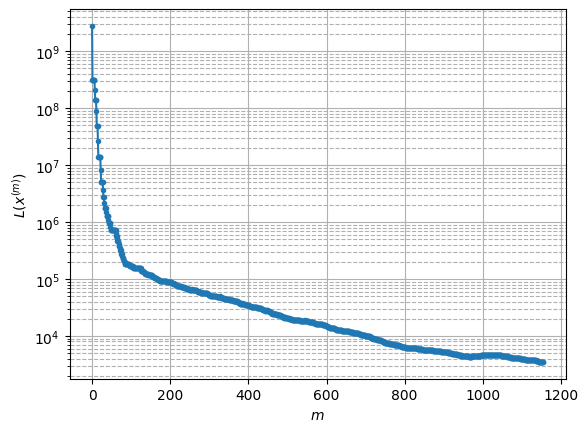

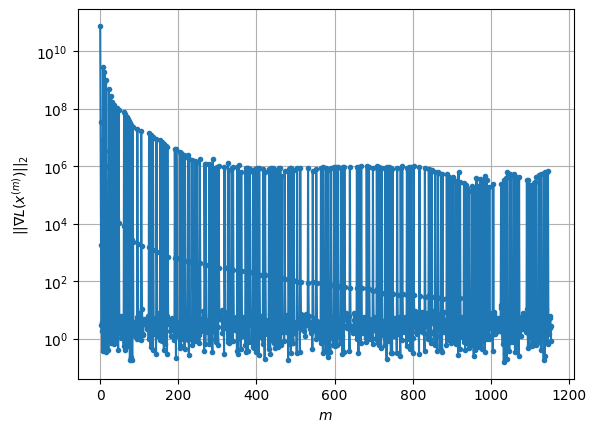

Windows:  28%|██▊       | 84/296 [49:30<53:56, 15.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3484.665164406514
Gradient norm: 794350.9148130772
Global relative error: 64.46952228683884
Position relative errors: 0.01448932948050835 m, 45.14087751356176 m, 32.18235394753039 m, 32.90759528500321 m

Iteration 1
Cost function: 3462.5128725638615 (-0.64%)
Gradient norm: 3.4124039555605012 (-100.00%)
Global relative error = 64.31188403530264 (-0.24%)
Position relative errors: 0.019337892531911652 m, 44.99058953223061 m, 32.120722372507245 m, 32.865142864285886 m

STOP on Iteration 2
Cost function = 3462.512870718887 (-0.00%)
Gradient norm = 0.5916996598966067 (-82.66%)
Global relative error = 64.31188391932092 (-0.00%)
Final position relative errors: 0.01933790236421898 m, 44.99058944353808 m, 32.1207223143217 m, 32.86514281560443 m

Majorization-Minimization converged after 1 iterations


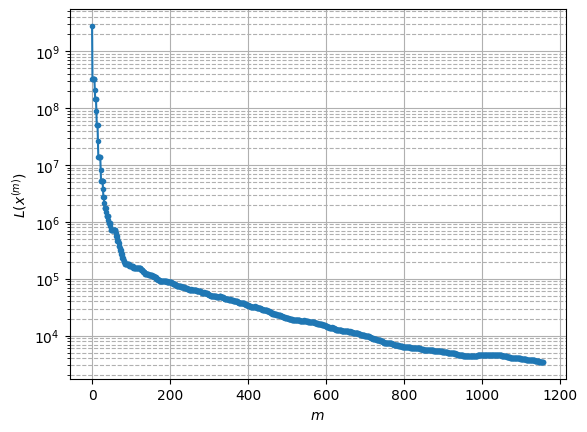

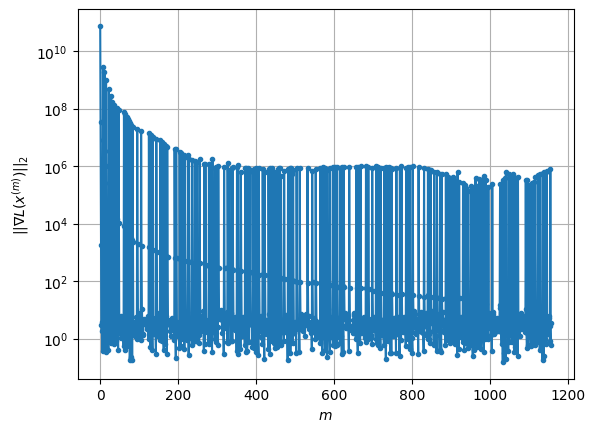

Windows:  29%|██▊       | 85/296 [49:39<46:29, 13.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3434.45596782535
Gradient norm: 947643.9218982571
Global relative error: 68.89564782767638
Position relative errors: 0.0186775056907792 m, 47.921394228393915 m, 34.07843111916121 m, 35.89992629083195 m

Iteration 1
Cost function: 3410.619181037545 (-0.69%)
Gradient norm: 3.1883713606022503 (-100.00%)
Global relative error = 68.72847005737168 (-0.24%)
Position relative errors: 0.0238277350614919 m, 47.77210869760651 m, 34.004773087728005 m, 35.84825481236231 m

STOP on Iteration 2
Cost function = 3410.6191798004884 (-0.00%)
Gradient norm = 0.8306981348308373 (-73.95%)
Global relative error = 68.728469948192 (-0.00%)
Final position relative errors: 0.023827752886686416 m, 47.772108645182804 m, 34.00477306991366 m, 35.84825468978922 m

Majorization-Minimization converged after 1 iterations


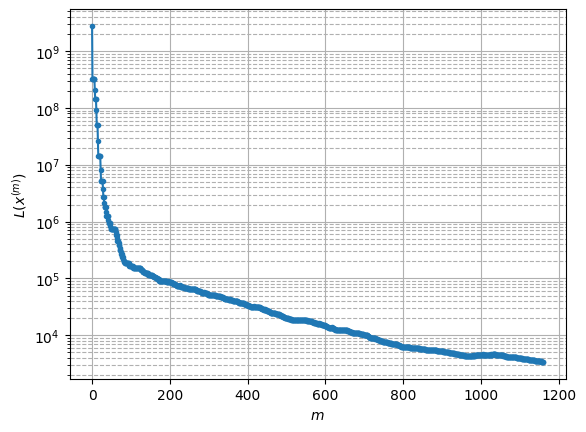

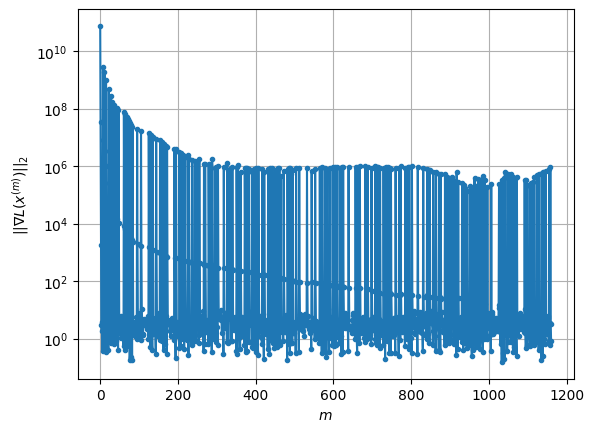

Windows:  29%|██▉       | 86/296 [49:47<41:05, 11.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3350.1741444614504
Gradient norm: 759909.0305949143
Global relative error: 73.01124137131414
Position relative errors: 0.022633611481604674 m, 50.48959899828732 m, 35.80454677656016 m, 38.72299994905346 m

Iteration 1
Cost function: 3326.8863449103496 (-0.70%)
Gradient norm: 6.56271808604236 (-100.00%)
Global relative error = 72.83672556741801 (-0.24%)
Position relative errors: 0.02060806945845998 m, 50.34262969095377 m, 35.717782176535344 m, 38.66578499545078 m

Iteration 2
Cost function: 3326.8863463261305 (0.00%)
Gradient norm: 8.451689716268929 (28.78%)
Global relative error = 72.83672549108833 (-0.00%)
Position relative errors: 0.02060807202369348 m, 50.34262961534722 m, 35.71778226118839 m, 38.66578487190336 m

STOP on Iteration 3
Cost function = 3326.886345423712 (-0.00%)
Gradient norm = 0.811066258446061 (-90.40%)
Global relative error = 72.83672549124049 (0.00%)
Final position relative errors: 

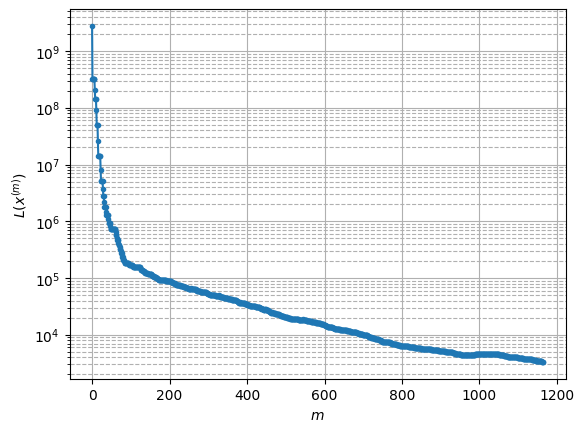

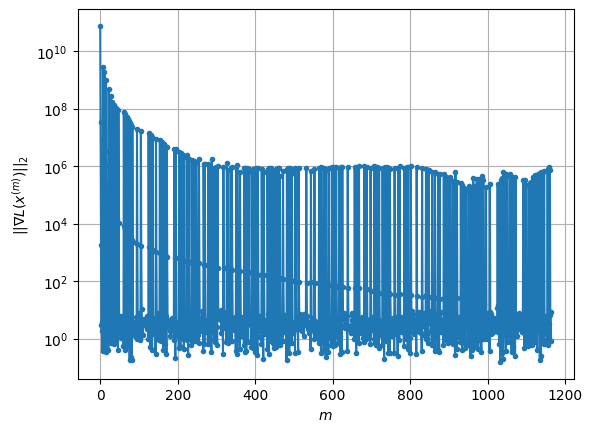

Windows:  29%|██▉       | 87/296 [49:58<40:03, 11.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3286.719159790923
Gradient norm: 731363.9190473838
Global relative error: 76.79803526188525
Position relative errors: 0.019638696477605338 m, 52.83541641087458 m, 37.35302682605072 m, 41.36549053978409 m

Iteration 1
Cost function: 3263.438631152572 (-0.71%)
Gradient norm: 7.090425322186001 (-100.00%)
Global relative error = 76.61767955005325 (-0.23%)
Position relative errors: 0.01771015751592144 m, 52.68675743939518 m, 37.25868554663745 m, 41.30569330156315 m

Iteration 2
Cost function: 3263.4386311324347 (-0.00%)
Gradient norm: 1.9695722576810044 (-72.22%)
Global relative error = 76.61767943702499 (-0.00%)
Position relative errors: 0.01771016394234164 m, 52.686757329277626 m, 37.25868563838629 m, 41.30569314960372 m

STOP on Iteration 3
Cost function = 3263.4386319949012 (0.00%)
Gradient norm = 0.46027926119910056 (-76.63%)
Global relative error = 76.61767943673289 (-0.00%)
Final position relative err

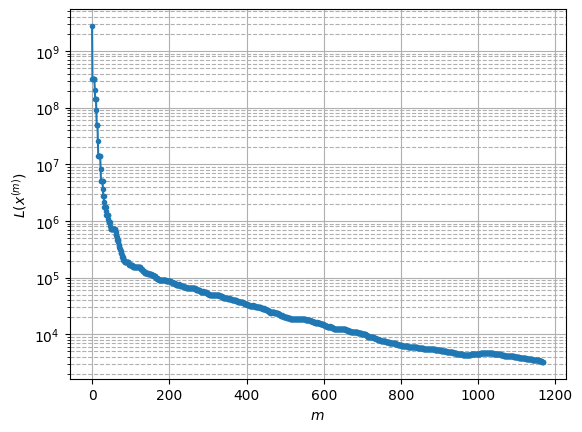

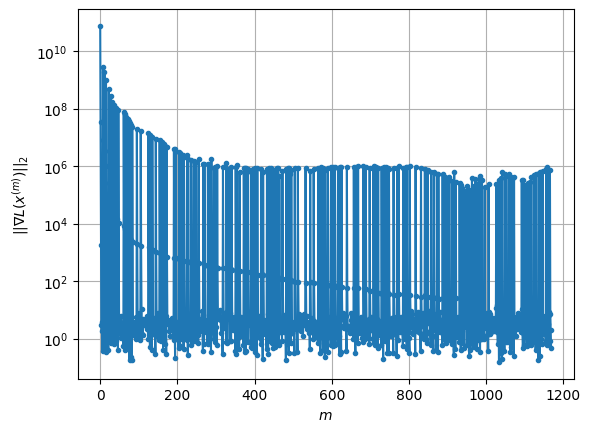

Windows:  30%|██▉       | 88/296 [50:09<39:21, 11.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3232.7552768170362
Gradient norm: 798809.0583372928
Global relative error: 80.23901334686002
Position relative errors: 0.01722430653759025 m, 54.94473404958781 m, 38.72241536374328 m, 43.81719135916668 m

Iteration 1
Cost function: 3207.7226507815153 (-0.77%)
Gradient norm: 2.814019602889421 (-100.00%)
Global relative error = 80.05266401452741 (-0.23%)
Position relative errors: 0.02253121572591094 m, 54.795784268188804 m, 38.61860456141706 m, 43.75443397984777 m

Iteration 2
Cost function: 3207.7226516170385 (0.00%)
Gradient norm: 1.3801652691092081 (-50.95%)
Global relative error = 80.05266387381484 (-0.00%)
Position relative errors: 0.022531227419798877 m, 54.79578410604198 m, 38.618604697588175 m, 43.75443380527217 m

Iteration 3
Cost function: 3207.7226518387724 (0.00%)
Gradient norm: 3.4075778420520906 (146.90%)
Global relative error = 80.0526638739025 (0.00%)
Position relative errors: 0.0225312295

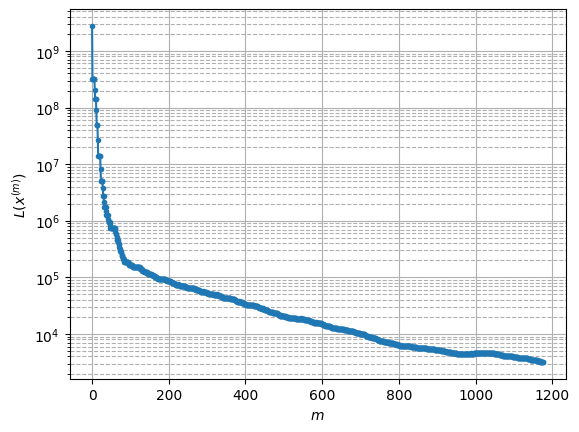

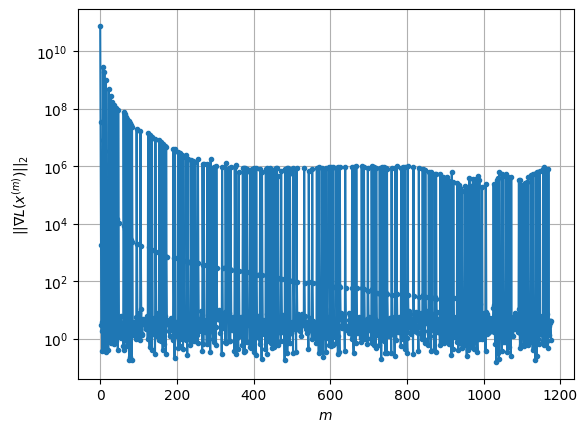

Windows:  30%|███       | 89/296 [50:30<49:10, 14.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3163.706022390187
Gradient norm: 738085.1339499567
Global relative error: 83.31780651925801
Position relative errors: 0.021552262279107726 m, 56.80998420458401 m, 39.905272492586754 m, 46.065698377609685 m

Iteration 1
Cost function: 3138.551555330975 (-0.80%)
Gradient norm: 3.518744632901222 (-100.00%)
Global relative error = 83.12800488915285 (-0.23%)
Position relative errors: 0.02139736805225286 m, 56.66438422389753 m, 39.79180022943551 m, 46.000241173101486 m

Iteration 2
Cost function: 3138.5515531354968 (-0.00%)
Gradient norm: 5.161775509447944 (46.69%)
Global relative error = 83.12800469803918 (-0.00%)
Position relative errors: 0.02139739357313755 m, 56.66438400705121 m, 39.791800336039344 m, 46.00024100262553 m

Iteration 3
Cost function: 3138.5515550472032 (0.00%)
Gradient norm: 2.27576427594219 (-55.91%)
Global relative error = 83.12800469825778 (0.00%)
Position relative errors: 0.021397379781

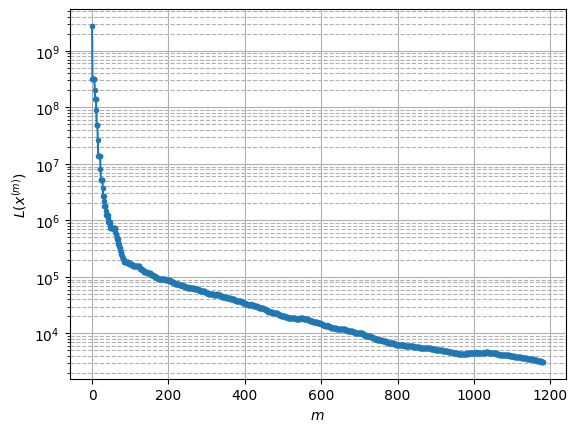

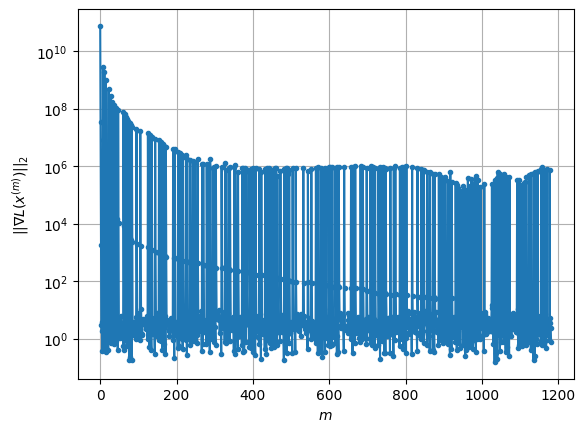

Windows:  30%|███       | 90/296 [50:43<48:08, 14.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3083.9072714884815
Gradient norm: 677963.4680635537
Global relative error: 86.02251603742137
Position relative errors: 0.020463556089398552 m, 58.42696706849093 m, 40.89632433072384 m, 48.10042486213306 m

Iteration 1
Cost function: 3057.8586949150695 (-0.84%)
Gradient norm: 3.4590188789897107 (-100.00%)
Global relative error = 85.83086066610572 (-0.22%)
Position relative errors: 0.023608162907924467 m, 58.2837583355532 m, 40.776133546122544 m, 48.03378399453783 m

Iteration 2
Cost function: 3057.8586943405344 (-0.00%)
Gradient norm: 6.746962089769148 (95.05%)
Global relative error = 85.83086053433043 (-0.00%)
Position relative errors: 0.0236081821355452 m, 58.283758155437596 m, 40.776133745447446 m, 48.033783808403804 m

Iteration 3
Cost function: 3057.858696049749 (0.00%)
Gradient norm: 2.1128530468693527 (-68.68%)
Global relative error = 85.83086053450504 (0.00%)
Position relative errors: 0.023608175

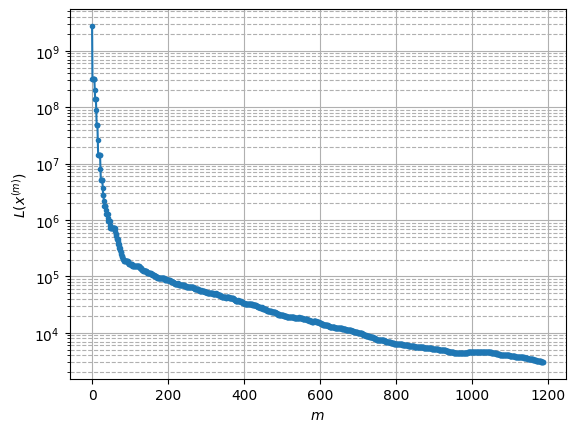

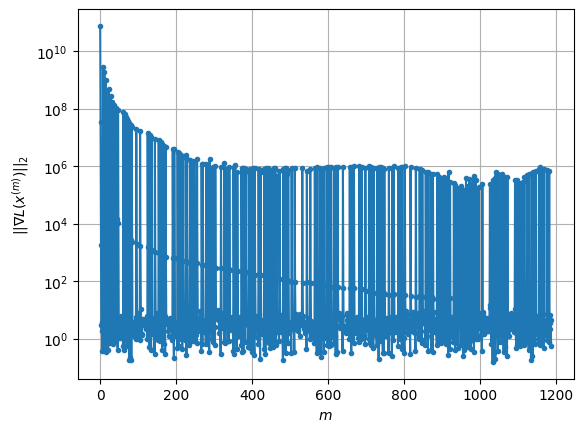

Windows:  31%|███       | 91/296 [50:59<49:52, 14.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3007.78973439772
Gradient norm: 601779.4854608872
Global relative error: 88.3424817470137
Position relative errors: 0.022298443147489664 m, 59.78778181075648 m, 41.69476953649082 m, 49.91351848459546 m

Iteration 1
Cost function: 2981.4841324098575 (-0.87%)
Gradient norm: 8.31071658359236 (-100.00%)
Global relative error = 88.15031981247624 (-0.22%)
Position relative errors: 0.027578442877496046 m, 59.64485345922158 m, 41.56889299118633 m, 49.849725526057895 m

Iteration 2
Cost function: 2981.48413377575 (0.00%)
Gradient norm: 5.624632112555235 (-32.32%)
Global relative error = 88.15031968415562 (-0.00%)
Position relative errors: 0.027578469249310223 m, 59.64485327066429 m, 41.568893226111605 m, 49.84972532883835 m

Iteration 3
Cost function: 2981.4841334589087 (-0.00%)
Gradient norm: 3.773816546398756 (-32.91%)
Global relative error = 88.1503196841894 (0.00%)
Position relative errors: 0.027578473569794

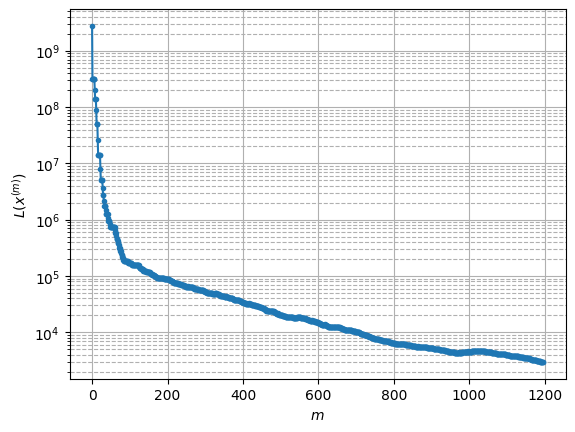

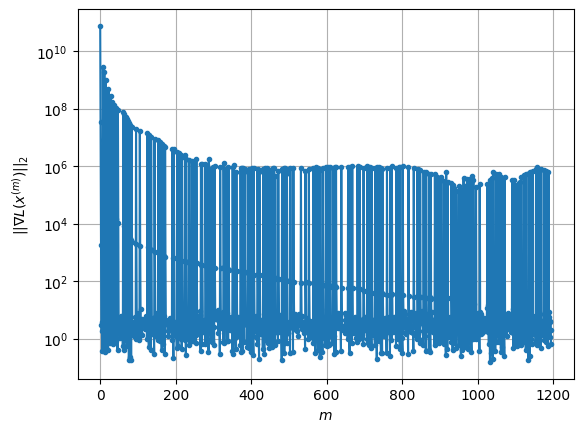

Windows:  31%|███       | 92/296 [51:21<56:27, 16.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2921.805388137464
Gradient norm: 524601.1147808405
Global relative error: 90.26871449498847
Position relative errors: 0.025863390855158208 m, 60.88453864670453 m, 42.298809405958636 m, 51.50070586414278 m

Iteration 1
Cost function: 2895.289306042517 (-0.91%)
Gradient norm: 4.531471849752805 (-100.00%)
Global relative error = 90.07780841955507 (-0.21%)
Position relative errors: 0.031798123462446044 m, 60.73986947706095 m, 42.168663430959285 m, 51.4439649625437 m

Iteration 2
Cost function: 2895.2893074371827 (0.00%)
Gradient norm: 2.7875829820085034 (-38.48%)
Global relative error = 90.07780828503824 (-0.00%)
Position relative errors: 0.031798162027670614 m, 60.739869294702835 m, 42.168663647796016 m, 51.44396476455139 m

STOP on Iteration 3
Cost function = 2895.289307187246 (-0.00%)
Gradient norm = 0.809966053468285 (-70.94%)
Global relative error = 90.07780828501595 (-0.00%)
Final position relative er

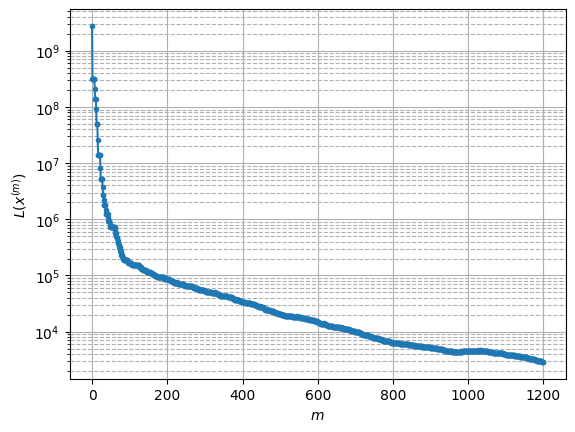

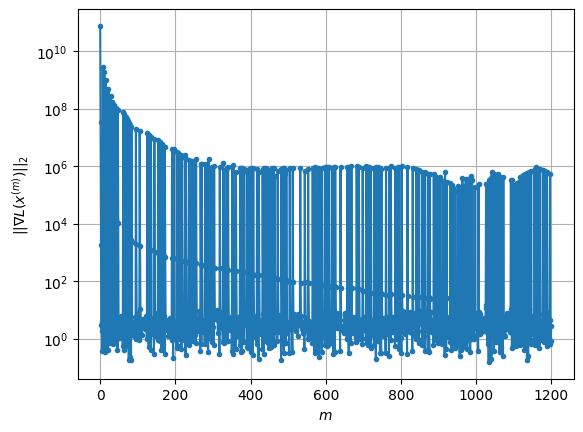

Windows:  31%|███▏      | 93/296 [51:31<50:13, 14.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2822.634430806465
Gradient norm: 462173.34825123765
Global relative error: 91.79455907132069
Position relative errors: 0.029926216180963174 m, 61.71089517166628 m, 42.707478763483394 m, 52.85902122732642 m

Iteration 1
Cost function: 2797.33103391272 (-0.90%)
Gradient norm: 7.835123477738302 (-100.00%)
Global relative error = 91.60481225430611 (-0.21%)
Position relative errors: 0.03630825888643162 m, 61.56613909518305 m, 42.57366653616387 m, 52.806562305779266 m

Iteration 2
Cost function: 2797.3310345405885 (0.00%)
Gradient norm: 3.514501958137946 (-55.14%)
Global relative error = 91.60481215418442 (-0.00%)
Position relative errors: 0.036308291005117406 m, 61.566138919204604 m, 42.573666785783104 m, 52.80656213599568 m

STOP on Iteration 3
Cost function = 2797.331032608278 (-0.00%)
Gradient norm = 0.2299953480787367 (-93.46%)
Global relative error = 91.60481215449651 (0.00%)
Final position relative err

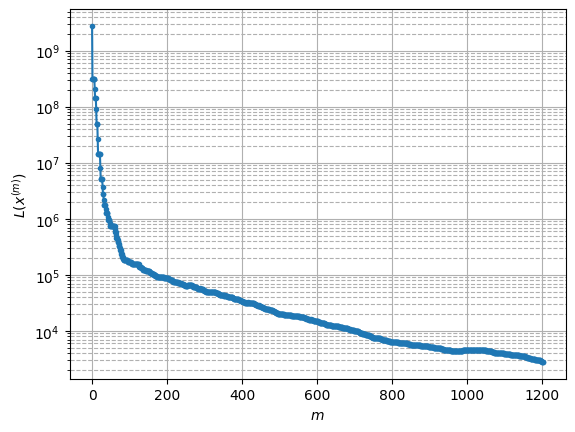

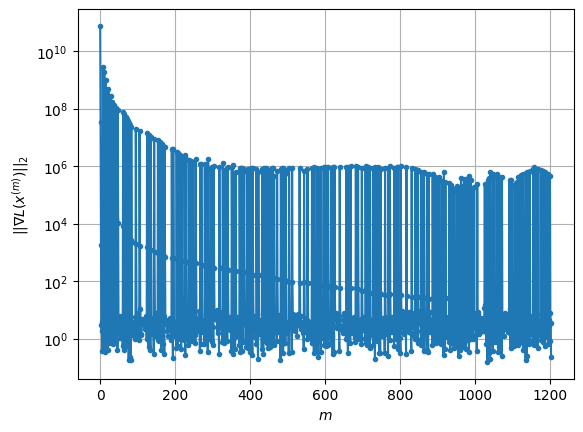

Windows:  32%|███▏      | 94/296 [51:42<45:33, 13.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2749.9439794368236
Gradient norm: 338658.54932628945
Global relative error: 92.91371593449851
Position relative errors: 0.034404585751994475 m, 62.26537257595055 m, 42.92027863665445 m, 53.97990418020325 m

Iteration 1
Cost function: 2727.223823920426 (-0.83%)
Gradient norm: 3.2470767503428366 (-100.00%)
Global relative error = 92.72369340579563 (-0.20%)
Position relative errors: 0.03527762092453128 m, 62.12065099799504 m, 42.78135628811858 m, 53.93015781283511 m

Iteration 2
Cost function: 2727.2238231330625 (-0.00%)
Gradient norm: 1.0160047158174683 (-68.71%)
Global relative error = 92.72369330477908 (-0.00%)
Position relative errors: 0.03527766560764716 m, 62.12065083993404 m, 42.78135645891764 m, 53.93015768570092 m

STOP on Iteration 3
Cost function = 2727.2238247483992 (0.00%)
Gradient norm = 0.732138509083221 (-27.94%)
Global relative error = 92.72369330488263 (0.00%)
Final position relative erro

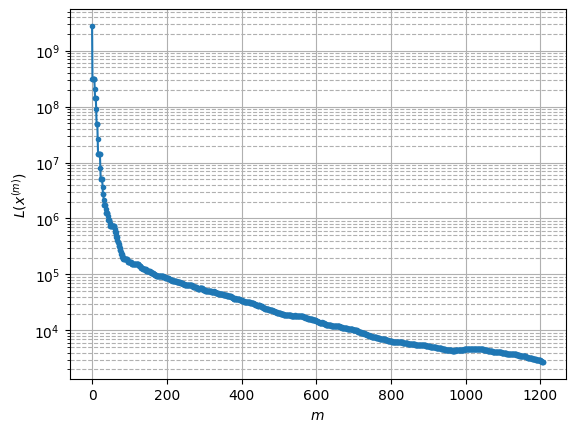

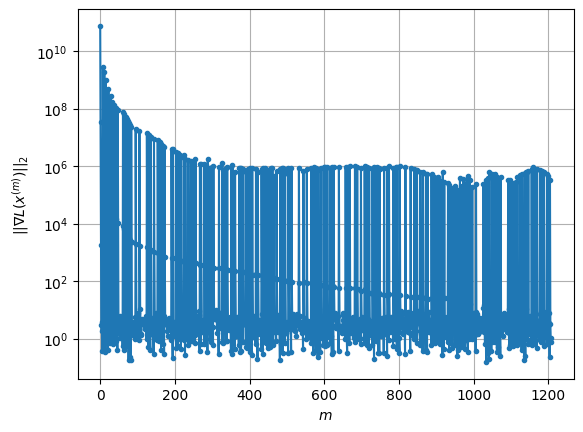

Windows:  32%|███▏      | 95/296 [51:53<42:34, 12.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2685.5937290398724
Gradient norm: 289487.1674775688
Global relative error: 93.62039235733296
Position relative errors: 0.033308235094749325 m, 62.546113021612065 m, 42.935160268314505 m, 54.85738136102046 m

Iteration 1
Cost function: 2664.0056232559264 (-0.80%)
Gradient norm: 3.1321817337004347 (-100.00%)
Global relative error = 93.42999677660232 (-0.20%)
Position relative errors: 0.02702920900071047 m, 62.40047389750752 m, 42.79420139028202 m, 54.80876323296408 m

STOP on Iteration 2
Cost function = 2664.005624249854 (0.00%)
Gradient norm = 0.43370268322301897 (-86.15%)
Global relative error = 93.42999670005611 (-0.00%)
Final position relative errors: 0.02702923806069407 m, 62.400473721310476 m, 42.794201603395194 m, 54.808763136670535 m

Majorization-Minimization converged after 1 iterations


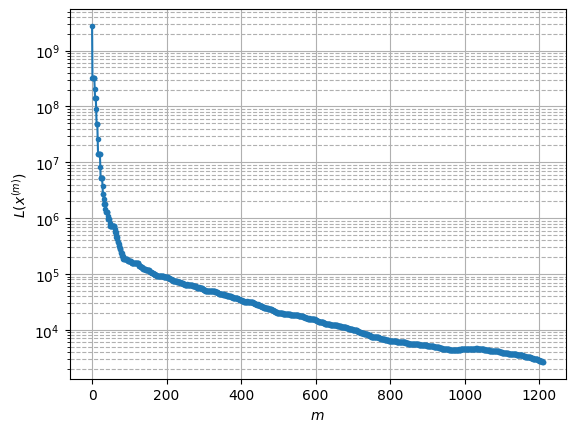

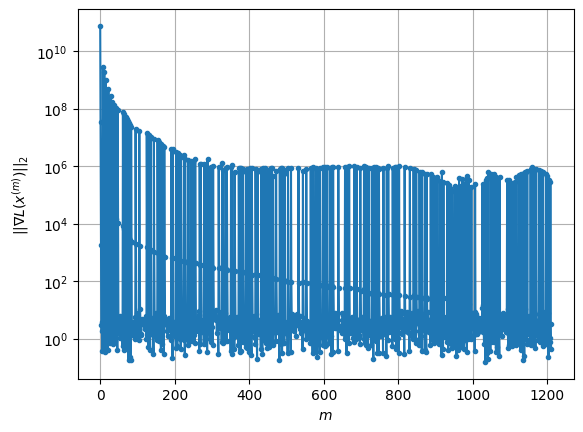

Windows:  32%|███▏      | 96/296 [52:02<39:21, 11.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2633.2107462912163
Gradient norm: 270855.877044457
Global relative error: 93.91247312258095
Position relative errors: 0.02541820900808455 m, 62.55150698838491 m, 42.75596536492496 m, 55.486829472737135 m

Iteration 1
Cost function: 2612.7012463273027 (-0.78%)
Gradient norm: 3.24488869975917 (-100.00%)
Global relative error = 93.72244745388544 (-0.20%)
Position relative errors: 0.032294821813527996 m, 62.40220354451718 m, 42.614655936412895 m, 55.44233118095269 m

Iteration 2
Cost function: 2612.701246118768 (-0.00%)
Gradient norm: 1.484630447578122 (-54.25%)
Global relative error = 93.72244740818807 (-0.00%)
Position relative errors: 0.03229487291979498 m, 62.402203378190514 m, 42.61465616794164 m, 55.44233111291998 m

STOP on Iteration 3
Cost function = 2612.701244984187 (-0.00%)
Gradient norm = 0.24446162260892332 (-83.53%)
Global relative error = 93.72244740771409 (-0.00%)
Final position relative err

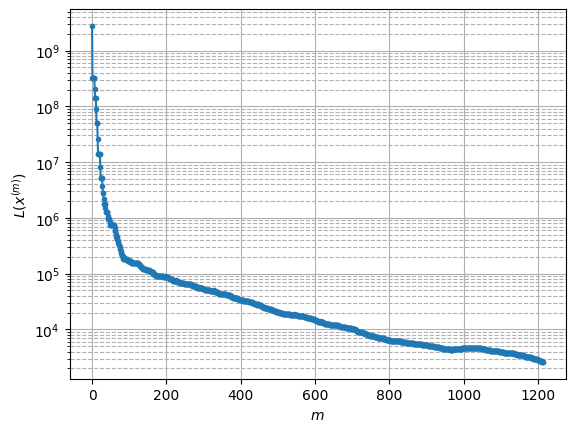

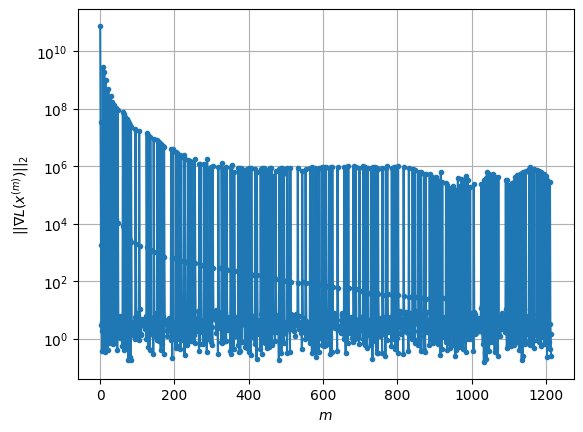

Windows:  33%|███▎      | 97/296 [52:14<39:00, 11.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2596.9683452557415
Gradient norm: 218894.63909460706
Global relative error: 93.7906306402723
Position relative errors: 0.030597548700195924 m, 62.279422253469036 m, 42.38592864077323 m, 55.86938313471002 m

Iteration 1
Cost function: 2579.403303272715 (-0.68%)
Gradient norm: 4.038926568629932 (-100.00%)
Global relative error = 93.59816538787172 (-0.21%)
Position relative errors: 0.028141551032929795 m, 62.12900180176035 m, 42.243365157368615 m, 55.82204669960389 m

Iteration 2
Cost function: 2579.403303593971 (0.00%)
Gradient norm: 3.345737725413917 (-17.16%)
Global relative error = 93.59816536273883 (-0.00%)
Position relative errors: 0.028141597297909302 m, 62.129001685214035 m, 42.24336533369338 m, 55.8220466537198 m

Iteration 3
Cost function: 2579.4033032958346 (-0.00%)
Gradient norm: 5.976475539470763 (78.63%)
Global relative error = 93.598165362847 (0.00%)
Position relative errors: 0.0281415855753

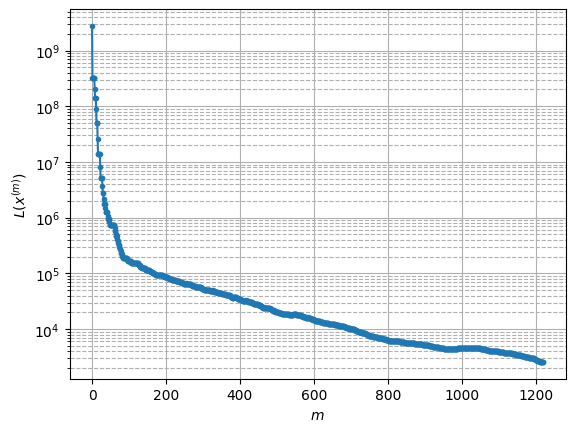

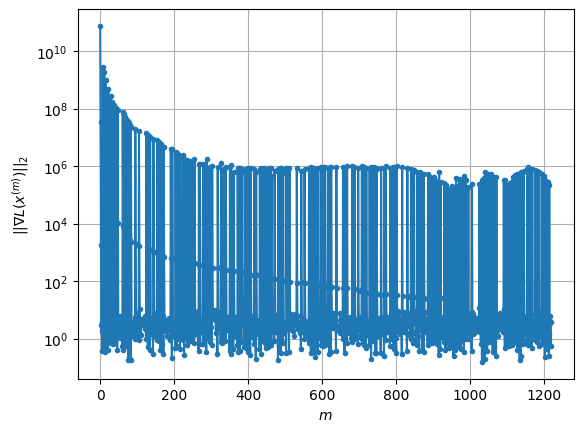

Windows:  33%|███▎      | 98/296 [52:32<45:02, 13.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2564.686264160054
Gradient norm: 295307.06596764916
Global relative error: 93.25401464773412
Position relative errors: 0.02639984655511967 m, 61.73419279013055 m, 41.82647911127189 m, 55.997727168271034 m

Iteration 1
Cost function: 2548.0068928775568 (-0.65%)
Gradient norm: 4.185747555885581 (-100.00%)
Global relative error = 93.06044698620265 (-0.21%)
Position relative errors: 0.033427389455354735 m, 61.5832764549149 m, 41.68672770425995 m, 55.94606577567522 m

Iteration 2
Cost function: 2548.006892373254 (-0.00%)
Gradient norm: 1.1788419327380517 (-71.84%)
Global relative error = 93.06044696091966 (-0.00%)
Position relative errors: 0.03342742785785267 m, 61.58327632444605 m, 41.6867278997578 m, 55.946065731541616 m

Iteration 3
Cost function: 2548.0068924135085 (0.00%)
Gradient norm: 1.584426107482974 (34.41%)
Global relative error = 93.06044696103363 (0.00%)
Position relative errors: 0.0334274344264

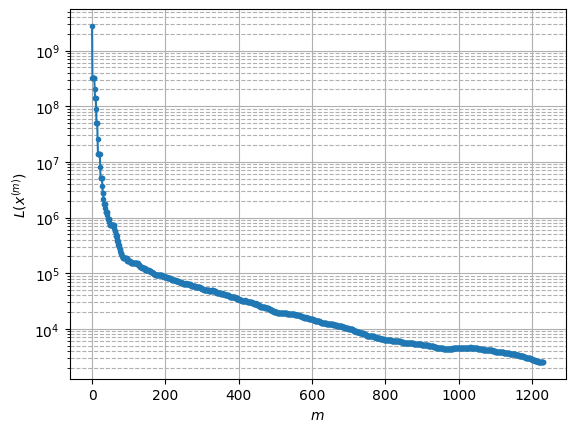

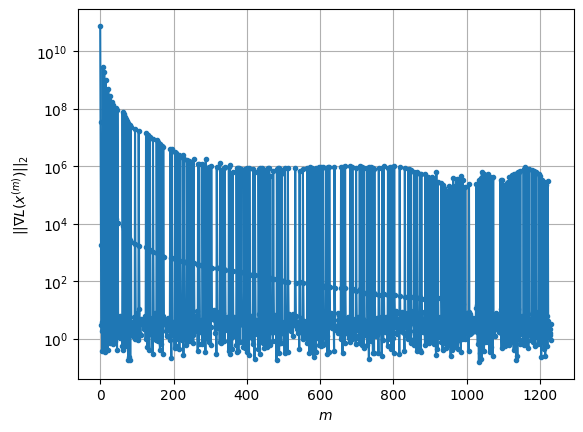

Windows:  33%|███▎      | 99/296 [53:00<58:29, 17.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2532.800957596407
Gradient norm: 335284.38477270893
Global relative error: 92.30798526217004
Position relative errors: 0.03155665921470508 m, 60.919404625648525 m, 41.08504993951977 m, 55.87134859947007 m

Iteration 1
Cost function: 2517.963838563363 (-0.59%)
Gradient norm: 2.3472608279450715 (-100.00%)
Global relative error = 92.11319357555506 (-0.21%)
Position relative errors: 0.03541569316134262 m, 60.766486782507165 m, 40.94783496973794 m, 55.81709147887227 m

Iteration 2
Cost function: 2517.9638393395303 (0.00%)
Gradient norm: 2.4759221269016742 (5.48%)
Global relative error = 92.11319356726568 (-0.00%)
Position relative errors: 0.03541573445185951 m, 60.76648666979934 m, 40.94783516214437 m, 55.817091446717356 m

STOP on Iteration 3
Cost function = 2517.963839619347 (0.00%)
Gradient norm = 0.5251317204921289 (-78.79%)
Global relative error = 92.1131935662449 (-0.00%)
Final position relative errors

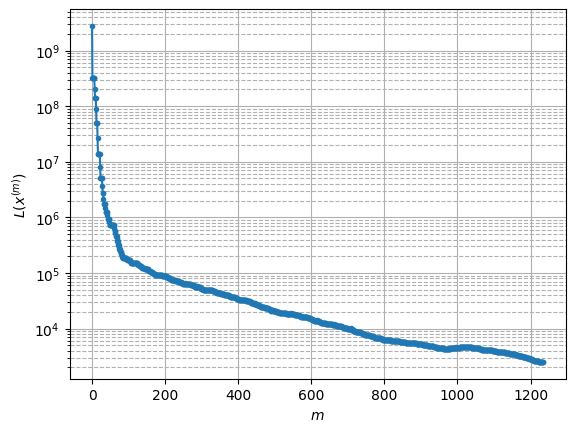

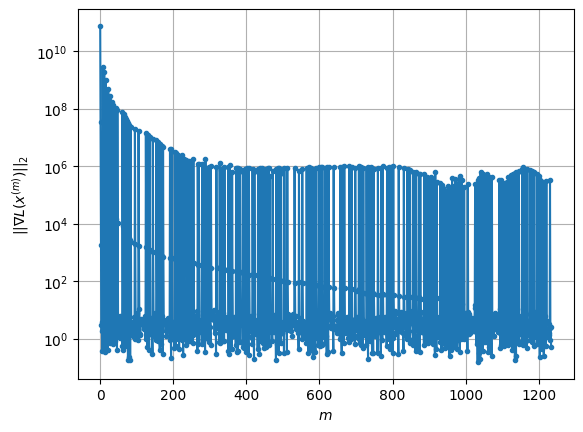

Windows:  34%|███▍      | 100/296 [53:12<52:32, 16.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2527.1068370986063
Gradient norm: 306691.3575400199
Global relative error: 90.9582602858711
Position relative errors: 0.033526520732351565 m, 59.837679366172054 m, 40.16554383119598 m, 55.494004896001904 m

Iteration 1
Cost function: 2515.252066738938 (-0.47%)
Gradient norm: 1.932911169002553 (-100.00%)
Global relative error = 90.75811146088257 (-0.22%)
Position relative errors: 0.041457256066039457 m, 59.68720150162905 m, 40.02820783664086 m, 55.427547292641 m

Iteration 2
Cost function: 2515.252066365693 (-0.00%)
Gradient norm: 5.952731270111394 (207.97%)
Global relative error = 90.75811142960794 (-0.00%)
Position relative errors: 0.04145729215910517 m, 59.68720138590206 m, 40.02820803052135 m, 55.42754722600995 m

Iteration 3
Cost function: 2515.2520677297366 (0.00%)
Gradient norm: 6.781117984298924 (13.92%)
Global relative error = 90.758111429545 (-0.00%)
Position relative errors: 0.0414572965166220

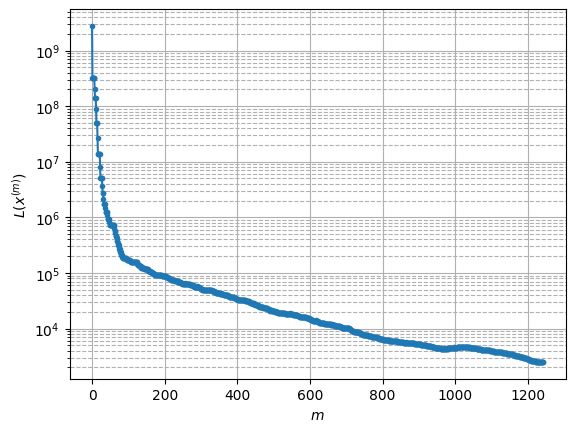

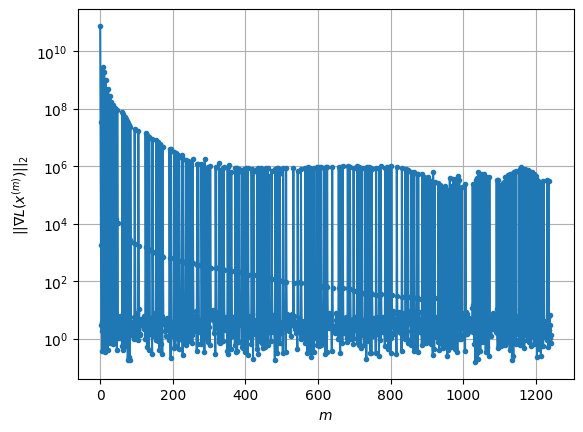

Windows:  34%|███▍      | 101/296 [53:35<58:59, 18.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2527.6123198894393
Gradient norm: 359188.1378374149
Global relative error: 89.2085652895733
Position relative errors: 0.039403710628860125 m, 58.49867357688233 m, 39.070327130834634 m, 54.85964204220163 m

Iteration 1
Cost function: 2517.9516416894016 (-0.38%)
Gradient norm: 7.4427006298123475 (-100.00%)
Global relative error = 89.00275660278754 (-0.23%)
Position relative errors: 0.03918487717610706 m, 58.35065213666697 m, 38.93306939737843 m, 54.78052277748436 m

Iteration 2
Cost function: 2517.951640353487 (-0.00%)
Gradient norm: 2.8105970043234025 (-62.24%)
Global relative error = 89.00275657882945 (-0.00%)
Position relative errors: 0.03918488216192585 m, 58.350652043582706 m, 38.933069599694875 m, 54.780522693918044 m

Iteration 3
Cost function: 2517.951640815613 (0.00%)
Gradient norm: 2.5970419837192322 (-7.60%)
Global relative error = 89.00275658014577 (0.00%)
Position relative errors: 0.039184890

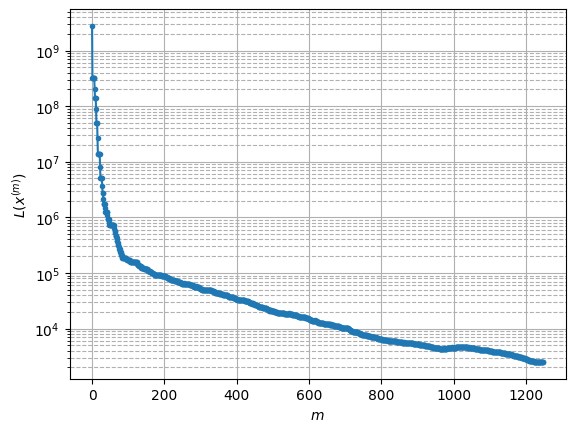

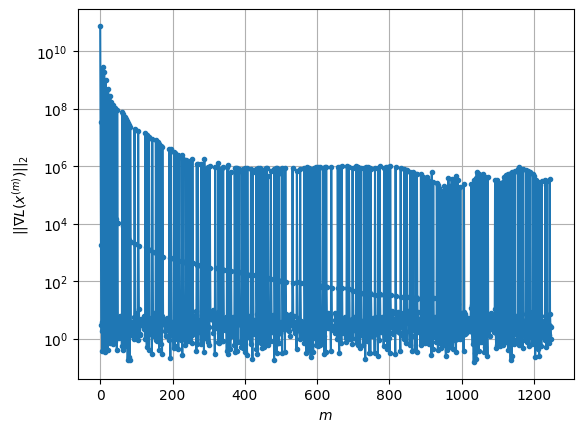

Windows:  34%|███▍      | 102/296 [53:48<54:14, 16.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2513.7455770214747
Gradient norm: 299843.8893735313
Global relative error: 87.06830137775906
Position relative errors: 0.037205177477534754 m, 56.908853924298384 m, 37.80544234784151 m, 53.97237448436903 m

Iteration 1
Cost function: 2505.3015829769356 (-0.34%)
Gradient norm: 6.129646640970234 (-100.00%)
Global relative error = 86.85761648163405 (-0.24%)
Position relative errors: 0.0395405212018416 m, 56.763462274925566 m, 37.670029870090346 m, 53.880616086978165 m

Iteration 2
Cost function: 2505.301582153069 (-0.00%)
Gradient norm: 4.986360708612424 (-18.65%)
Global relative error = 86.85761643831879 (-0.00%)
Position relative errors: 0.03954053218036156 m, 56.763462198823945 m, 37.67003003410557 m, 53.8806159826482 m

Iteration 3
Cost function: 2505.3015828283 (0.00%)
Gradient norm: 2.626563632854373 (-47.33%)
Global relative error = 86.85761643814982 (-0.00%)
Position relative errors: 0.039540536101

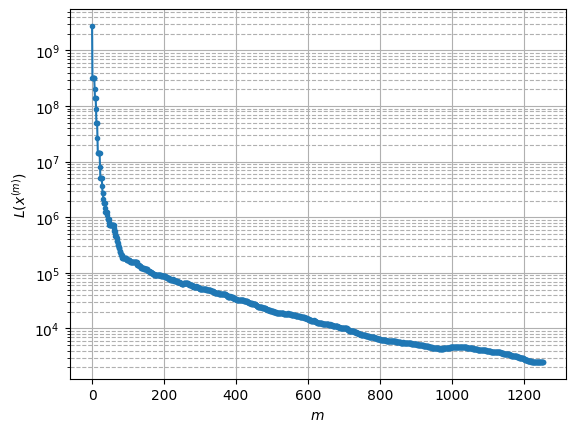

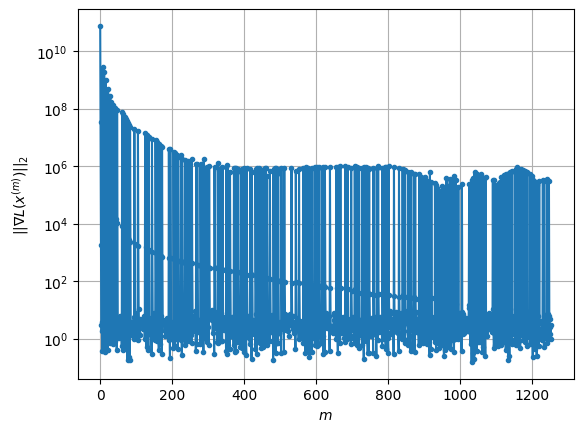

Windows:  35%|███▍      | 103/296 [54:07<55:58, 17.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2515.621522017319
Gradient norm: 437420.10646239354
Global relative error: 84.54959525764247
Position relative errors: 0.03746334650476778 m, 55.07597687811629 m, 36.379115728780484 m, 52.83774690184563 m

Iteration 1
Cost function: 2507.3678898635135 (-0.33%)
Gradient norm: 3.3709532912996796 (-100.00%)
Global relative error = 84.3322705444148 (-0.26%)
Position relative errors: 0.022765992335759527 m, 54.93195659328492 m, 36.249238158224344 m, 52.72952067460221 m

Iteration 2
Cost function: 2507.3678898926187 (0.00%)
Gradient norm: 2.2281246187103565 (-33.90%)
Global relative error = 84.33227049066694 (-0.00%)
Position relative errors: 0.022765995259047912 m, 54.931956520927365 m, 36.24923830520316 m, 52.72952056297842 m

STOP on Iteration 3
Cost function = 2507.3678895597095 (-0.00%)
Gradient norm = 0.20430463962112352 (-90.83%)
Global relative error = 84.33227049093918 (0.00%)
Final position relative

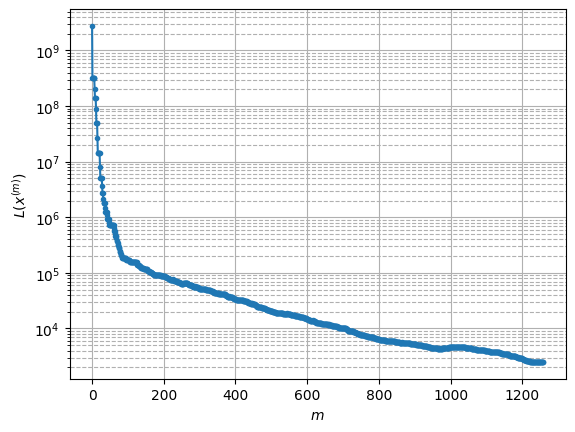

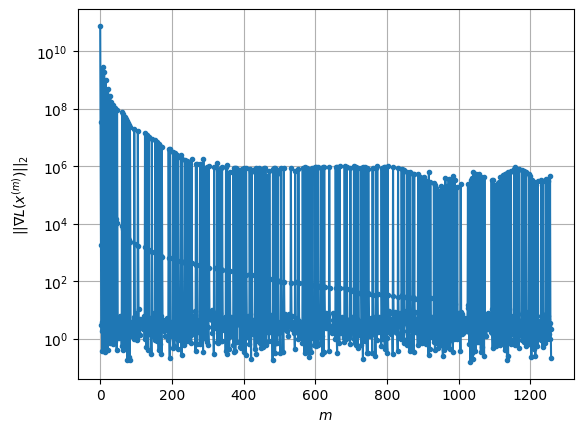

Windows:  35%|███▌      | 104/296 [54:18<49:28, 15.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2505.6045848833223
Gradient norm: 378002.185226967
Global relative error: 81.66379762551082
Position relative errors: 0.021355734202934303 m, 53.00750361547723 m, 34.802233600779054 m, 51.45854723081968 m

Iteration 1
Cost function: 2497.291890351902 (-0.33%)
Gradient norm: 6.694028746264604 (-100.00%)
Global relative error = 81.44279149015742 (-0.27%)
Position relative errors: 0.02423968985170479 m, 52.87021234052033 m, 34.67867949557284 m, 51.33278815205888 m

Iteration 2
Cost function: 2497.291889439888 (-0.00%)
Gradient norm: 7.365861699237742 (10.04%)
Global relative error = 81.44279146571753 (-0.00%)
Position relative errors: 0.02423969438521527 m, 52.87021231076771 m, 34.67867964997497 m, 51.33278803961624 m

Iteration 3
Cost function: 2497.291890824723 (0.00%)
Gradient norm: 2.844586021573625 (-61.38%)
Global relative error = 81.44279146652721 (0.00%)
Position relative errors: 0.0242396990725665

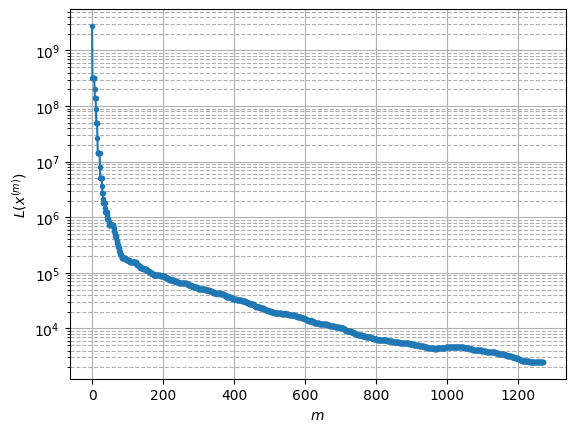

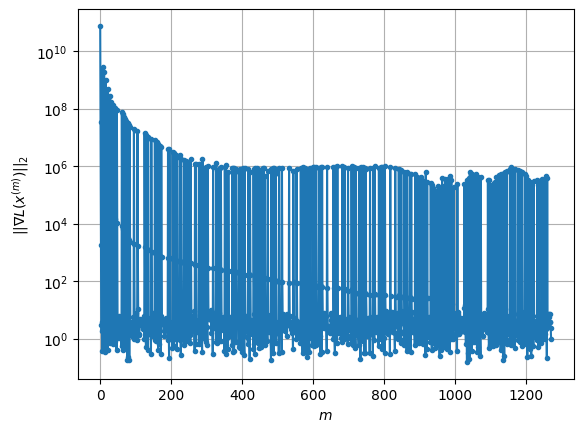

Windows:  35%|███▌      | 105/296 [54:49<1:03:44, 20.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2486.809768162762
Gradient norm: 610203.3891954728
Global relative error: 78.42846703505046
Position relative errors: 0.022613823858252752 m, 50.718417688179414 m, 33.08361959290088 m, 49.841119315015334 m

Iteration 1
Cost function: 2478.3348168582356 (-0.34%)
Gradient norm: 2.41797080937008 (-100.00%)
Global relative error = 78.20660171033289 (-0.28%)
Position relative errors: 0.02047914677071289 m, 50.58518802089915 m, 32.965512895538694 m, 49.7059641897569 m

Iteration 2
Cost function: 2478.334814438607 (-0.00%)
Gradient norm: 1.1598679682312185 (-52.03%)
Global relative error = 78.206601645878 (-0.00%)
Position relative errors: 0.020479127945173613 m, 50.58518795627681 m, 32.965513012588694 m, 49.70596407648904 m

Iteration 3
Cost function: 2478.3348141186175 (-0.00%)
Gradient norm: 2.446563656181751 (110.93%)
Global relative error = 78.20660164570856 (-0.00%)
Position relative errors: 0.0204791425

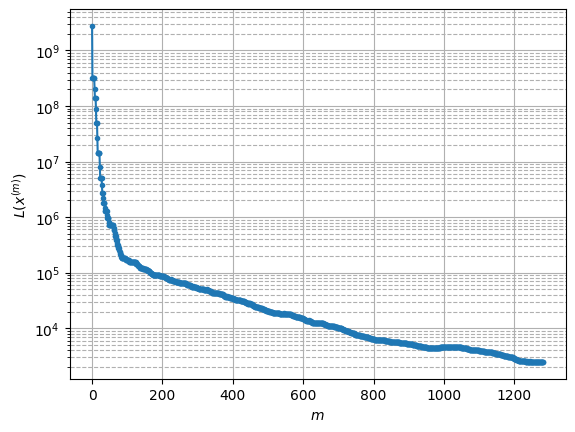

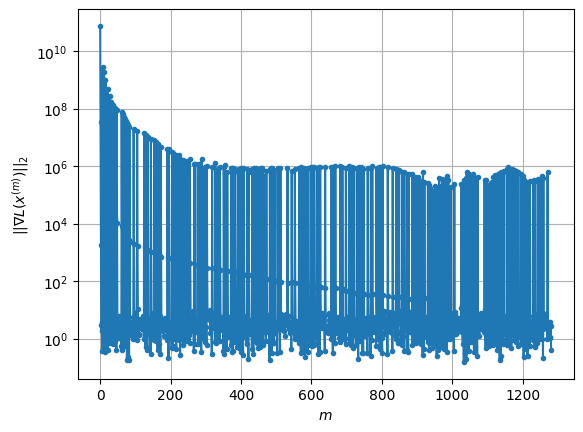

Windows:  36%|███▌      | 106/296 [55:16<1:10:33, 22.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2467.351082923472
Gradient norm: 411290.0780504188
Global relative error: 74.86241081161681
Position relative errors: 0.01913412329565955 m, 48.21670432066028 m, 31.230864774531423 m, 48.0016573566324 m

Iteration 1
Cost function: 2457.8062015477813 (-0.39%)
Gradient norm: 1.0952620503335955 (-100.00%)
Global relative error = 74.63923522962483 (-0.30%)
Position relative errors: 0.010453688288892976 m, 48.0921813009367 m, 31.11908848034625 m, 47.8513968640508 m

STOP on Iteration 2
Cost function = 2457.806201762916 (0.00%)
Gradient norm = 0.9856727808412193 (-10.01%)
Global relative error = 74.63923517417116 (-0.00%)
Final position relative errors: 0.010453686598866098 m, 48.0921812630508 m, 31.11908854928811 m, 47.85139677079566 m

Majorization-Minimization converged after 1 iterations


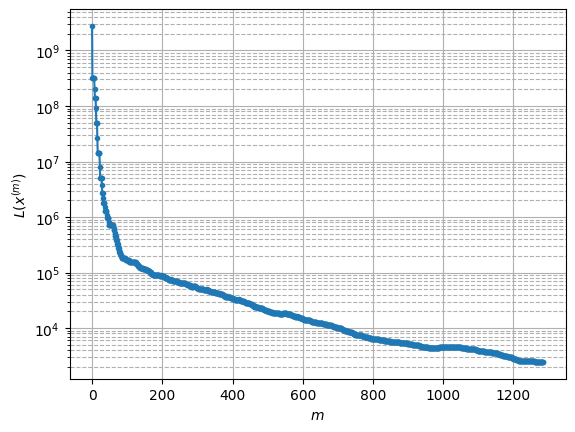

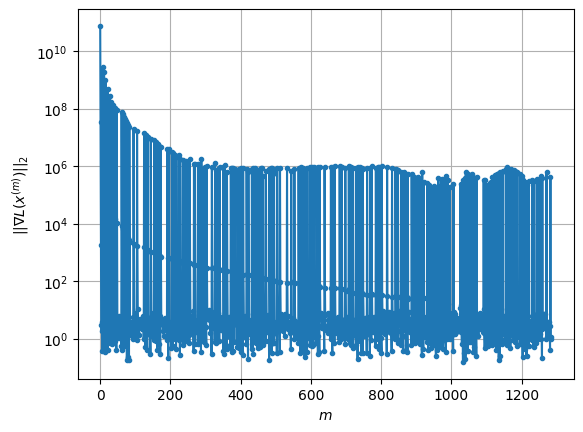

Windows:  36%|███▌      | 107/296 [55:25<57:13, 18.17s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2434.77639291062
Gradient norm: 432072.73270870256
Global relative error: 70.98268718384199
Position relative errors: 0.009996733760435564 m, 45.51866235864063 m, 29.25379481767962 m, 45.94349167561257 m

Iteration 1
Cost function: 2424.7813075011723 (-0.41%)
Gradient norm: 1.0626391682437089 (-100.00%)
Global relative error = 70.76048076833666 (-0.31%)
Position relative errors: 0.012217989329212644 m, 45.400759590758874 m, 29.148167485146377 m, 45.784240172476224 m

Iteration 2
Cost function: 2424.781307894354 (0.00%)
Gradient norm: 3.271237544633819 (207.84%)
Global relative error = 70.76048073331492 (-0.00%)
Position relative errors: 0.012217984786279465 m, 45.40075955395139 m, 29.148167563624103 m, 45.78424010488772 m

Iteration 3
Cost function: 2424.7813060774774 (-0.00%)
Gradient norm: 2.6351511264107144 (-19.44%)
Global relative error = 70.76048073337478 (0.00%)
Position relative errors: 0.012217

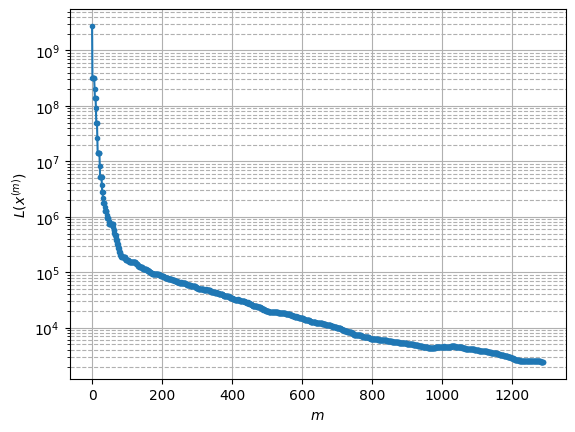

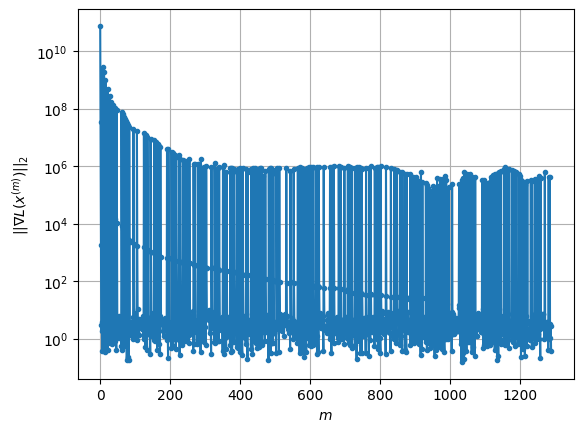

Windows:  36%|███▋      | 108/296 [55:38<52:40, 16.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2400.0876282344448
Gradient norm: 395414.6130367099
Global relative error: 66.81048605262093
Position relative errors: 0.011979924324048378 m, 42.634739417171396 m, 27.161835292666662 m, 43.68237336032569 m

Iteration 1
Cost function: 2389.396124122001 (-0.45%)
Gradient norm: 2.3532609779907823 (-100.00%)
Global relative error = 66.59147048759607 (-0.33%)
Position relative errors: 0.007963390710762264 m, 42.52030179363139 m, 27.06605534072324 m, 43.5186353490104 m

Iteration 2
Cost function: 2389.396124905849 (0.00%)
Gradient norm: 5.534050739551279 (135.17%)
Global relative error = 66.59147043934469 (-0.00%)
Position relative errors: 0.007963385449723462 m, 42.52030172732611 m, 27.066055397868194 m, 43.5186353044215 m

Iteration 3
Cost function: 2389.396124814697 (-0.00%)
Gradient norm: 6.494559046865039 (17.36%)
Global relative error = 66.59147044067029 (0.00%)
Position relative errors: 0.007963385935

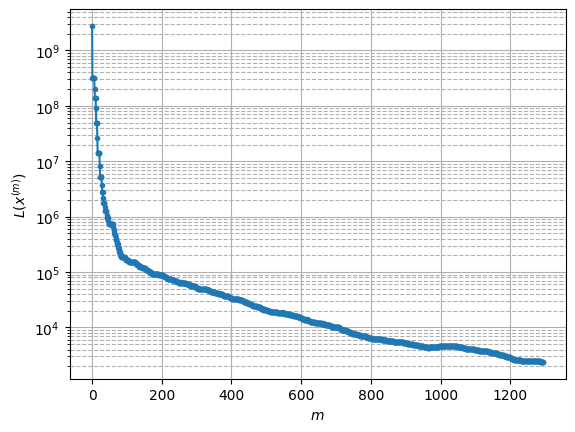

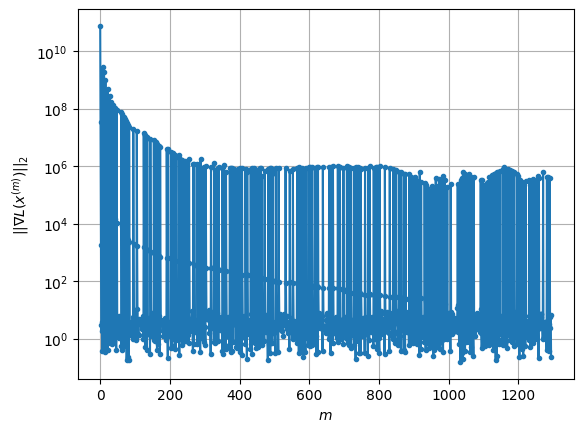

Windows:  37%|███▋      | 109/296 [55:52<49:04, 15.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2351.1397529005053
Gradient norm: 418212.31460455246
Global relative error: 62.36829789446344
Position relative errors: 0.00747817672320823 m, 39.5751376724411 m, 24.96877179519621 m, 41.233092799568446 m

Iteration 1
Cost function: 2339.2206984937316 (-0.51%)
Gradient norm: 2.4713762573805123 (-100.00%)
Global relative error = 62.154342862513566 (-0.34%)
Position relative errors: 0.017181972623649924 m, 39.47030848169315 m, 24.881773112901655 m, 41.0627407971814 m

Iteration 2
Cost function: 2339.220696608541 (-0.00%)
Gradient norm: 4.366871234352788 (76.70%)
Global relative error = 62.154342867207184 (0.00%)
Position relative errors: 0.017181955419907826 m, 39.47030845740922 m, 24.881773159057435 m, 41.06274079966749 m

Iteration 3
Cost function: 2339.2206976373113 (0.00%)
Gradient norm: 3.848415122970714 (-11.87%)
Global relative error = 62.1543428662905 (-0.00%)
Position relative errors: 0.017181948

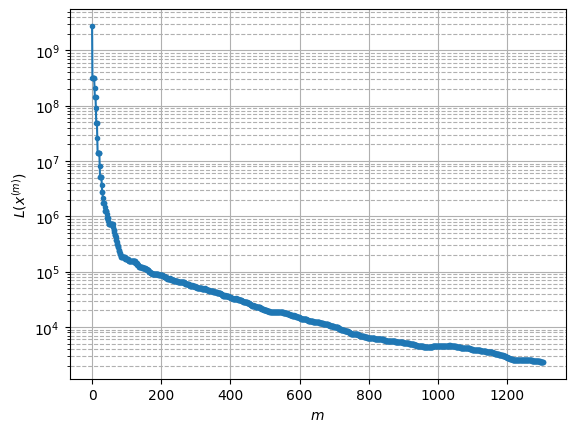

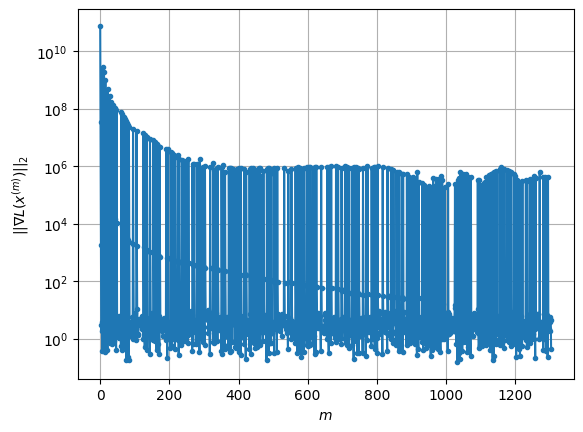

Windows:  37%|███▋      | 110/296 [56:17<58:09, 18.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2289.1002438081287
Gradient norm: 338621.5656053034
Global relative error: 57.67965034158863
Position relative errors: 0.017032560263414553 m, 36.360111759590005 m, 22.684289998863967 m, 38.60441568655278 m

Iteration 1
Cost function: 2276.8258294511347 (-0.54%)
Gradient norm: 8.829175850491076 (-100.00%)
Global relative error = 57.47358084198293 (-0.36%)
Position relative errors: 0.024348684540048387 m, 36.260590617333605 m, 22.607605106070896 m, 38.43529060765664 m

Iteration 2
Cost function: 2276.82583024587 (0.00%)
Gradient norm: 2.7472321470527006 (-68.88%)
Global relative error = 57.47358083816238 (-0.00%)
Position relative errors: 0.02434866952388191 m, 36.260590560398114 m, 22.607605135634998 m, 38.43529063827785 m

Iteration 3
Cost function: 2276.825830629474 (0.00%)
Gradient norm: 3.8435711026502317 (39.91%)
Global relative error = 57.47358083773789 (-0.00%)
Position relative errors: 0.0243486

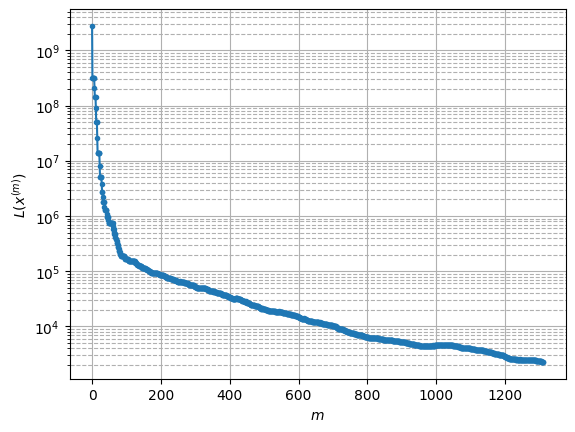

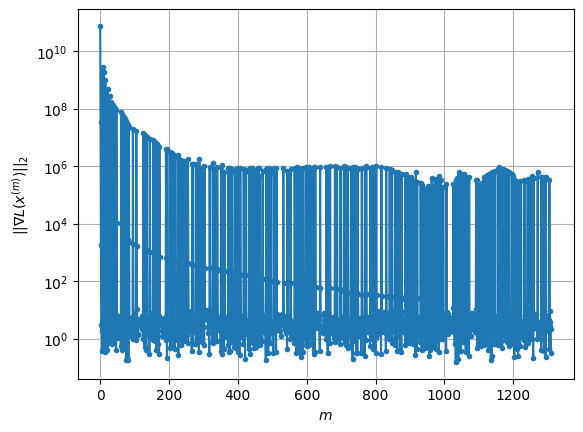

Windows:  38%|███▊      | 111/296 [56:33<55:22, 17.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2225.6712572481338
Gradient norm: 318516.473996166
Global relative error: 52.7705574190989
Position relative errors: 0.023833230201987774 m, 33.00031313047504 m, 20.32112824238184 m, 35.815576479585964 m

Iteration 1
Cost function: 2213.1744128613414 (-0.56%)
Gradient norm: 2.3410457874712303 (-100.00%)
Global relative error = 52.575969665996745 (-0.37%)
Position relative errors: 0.02850554554535569 m, 32.909901609356176 m, 20.255403933174904 m, 35.649432888444764 m

STOP on Iteration 2
Cost function = 2213.1744128639307 (0.00%)
Gradient norm = 0.3376239142434824 (-85.58%)
Global relative error = 52.575969679875136 (0.00%)
Final position relative errors: 0.02850552420893439 m, 32.909901554202364 m, 20.255403968579138 m, 35.64943293972931 m

Majorization-Minimization converged after 1 iterations


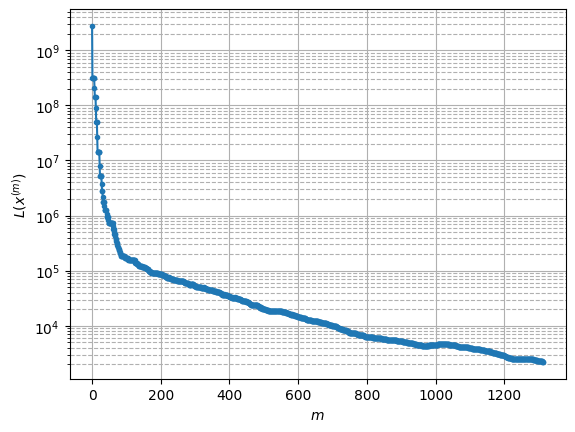

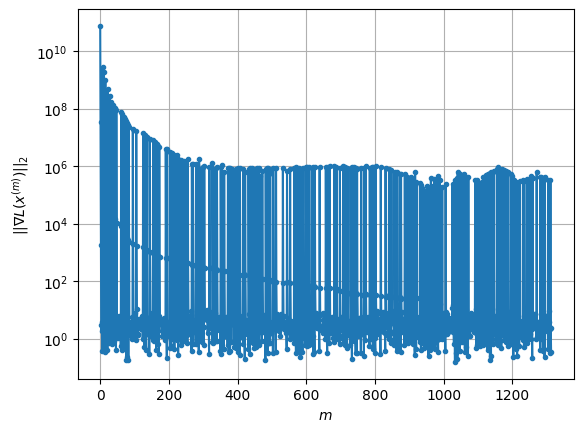

Windows:  38%|███▊      | 112/296 [56:42<46:10, 15.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2166.086778383039
Gradient norm: 284746.75322118145
Global relative error: 47.66979541323024
Position relative errors: 0.027955531459753234 m, 29.515141597679037 m, 17.89243518977334 m, 32.880366516183884 m

Iteration 1
Cost function: 2154.980863365061 (-0.51%)
Gradient norm: 3.95216291398219 (-100.00%)
Global relative error = 47.490282378927624 (-0.38%)
Position relative errors: 0.029287551453674846 m, 29.43319716033283 m, 17.840140016176278 m, 32.72208904158736 m

STOP on Iteration 2
Cost function = 2154.9808644062678 (0.00%)
Gradient norm = 0.42419707590225036 (-89.27%)
Global relative error = 47.49028238221582 (0.00%)
Final position relative errors: 0.029287535518656413 m, 29.43319710882275 m, 17.84014003893099 m, 32.72208908030093 m

Majorization-Minimization converged after 1 iterations


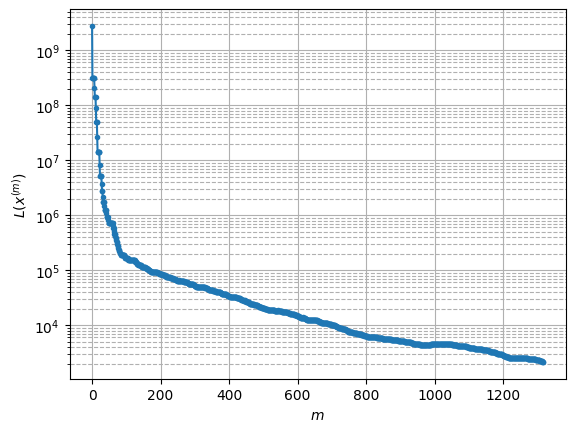

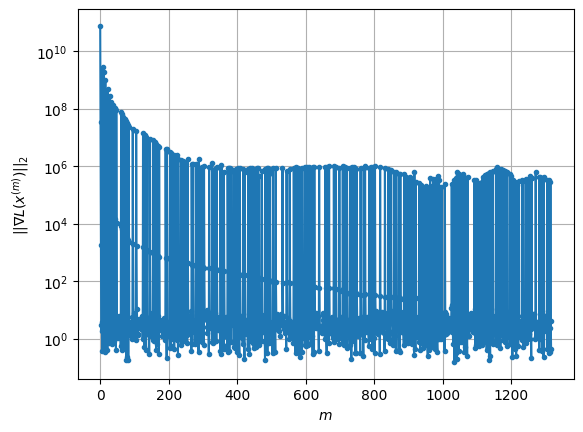

Windows:  38%|███▊      | 113/296 [56:50<39:55, 13.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2117.2264319720075
Gradient norm: 254487.79954580654
Global relative error: 42.408411508694726
Position relative errors: 0.028799827824424674 m, 25.9199628778167 m, 15.41381852930953 m, 29.81668069135298 m

Iteration 1
Cost function: 2105.700763841475 (-0.54%)
Gradient norm: 4.092651035157246 (-100.00%)
Global relative error = 42.24103377467646 (-0.39%)
Position relative errors: 0.041954113555030405 m, 25.84931758785122 m, 15.369990709038516 m, 29.662628997905678 m

Iteration 2
Cost function: 2105.7007633427993 (-0.00%)
Gradient norm: 2.218739621875897 (-45.79%)
Global relative error = 42.241033791318976 (0.00%)
Position relative errors: 0.041954089643379815 m, 25.84931752679256 m, 15.369990745756235 m, 29.662629055822876 m

Iteration 3
Cost function: 2105.700763477314 (0.00%)
Gradient norm: 1.9659088459845393 (-11.40%)
Global relative error = 42.241033790967776 (-0.00%)
Position relative errors: 0.0419

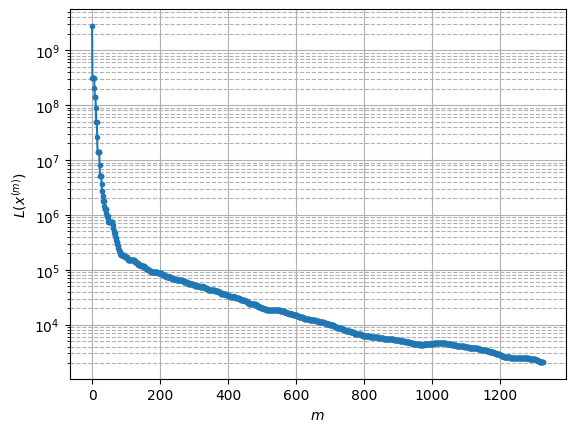

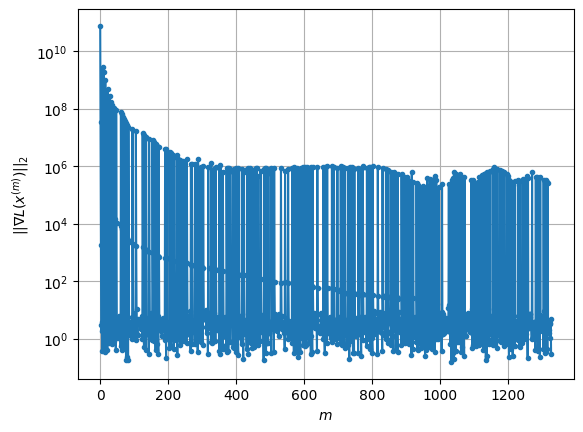

Windows:  39%|███▊      | 114/296 [57:18<53:27, 17.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2044.608459775904
Gradient norm: 166765.62224177833
Global relative error: 37.01469976007603
Position relative errors: 0.04091257891668572 m, 22.234500051015406 m, 12.896556486513584 m, 26.634261419546508 m

Iteration 1
Cost function: 2034.120313654348 (-0.51%)
Gradient norm: 1.7071534069403724 (-100.00%)
Global relative error = 36.86452248977461 (-0.41%)
Position relative errors: 0.03497183977126667 m, 22.17694401356616 m, 12.87021844181969 m, 26.48630171161838 m

Iteration 2
Cost function: 2034.1203131431473 (-0.00%)
Gradient norm: 3.021672947203523 (77.00%)
Global relative error = 36.864522499452775 (0.00%)
Position relative errors: 0.03497181314620094 m, 22.176943954593327 m, 12.870218469196526 m, 26.486301761198924 m

STOP on Iteration 3
Cost function = 2034.1203127010833 (-0.00%)
Gradient norm = 0.47060985927549026 (-84.43%)
Global relative error = 36.86452249947246 (0.00%)
Final position relative

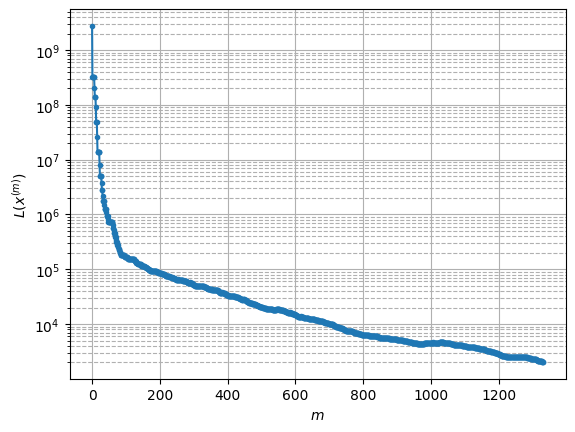

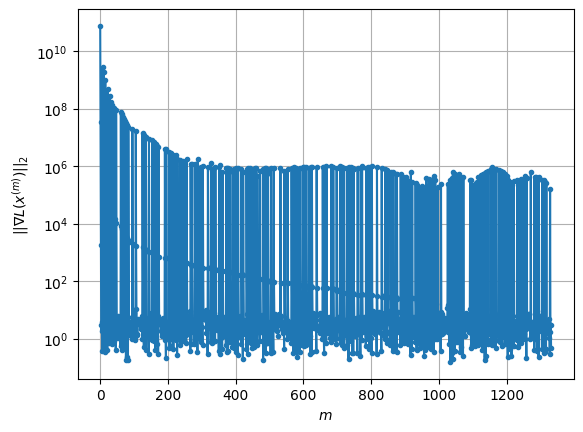

Windows:  39%|███▉      | 115/296 [57:29<46:49, 15.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2001.015618738311
Gradient norm: 125399.06537150737
Global relative error: 31.53073728381826
Position relative errors: 0.0341628457959128 m, 18.478761711495974 m, 10.369784606824707 m, 23.349099988254032 m

Iteration 1
Cost function: 1991.893666484029 (-0.46%)
Gradient norm: 1.597464881941811 (-100.00%)
Global relative error = 31.398596090500785 (-0.42%)
Position relative errors: 0.026759818181657718 m, 18.432696020381698 m, 10.357633851895883 m, 23.212445013436792 m

Iteration 2
Cost function: 1991.893665521208 (-0.00%)
Gradient norm: 2.9659740983768708 (85.67%)
Global relative error = 31.39859609728799 (0.00%)
Position relative errors: 0.026759796711066777 m, 18.43269594251723 m, 10.357633889165829 m, 23.212445067843305 m

STOP on Iteration 3
Cost function = 1991.8936664522823 (0.00%)
Gradient norm = 0.5256995235796444 (-82.28%)
Global relative error = 31.398596097208827 (-0.00%)
Final position relati

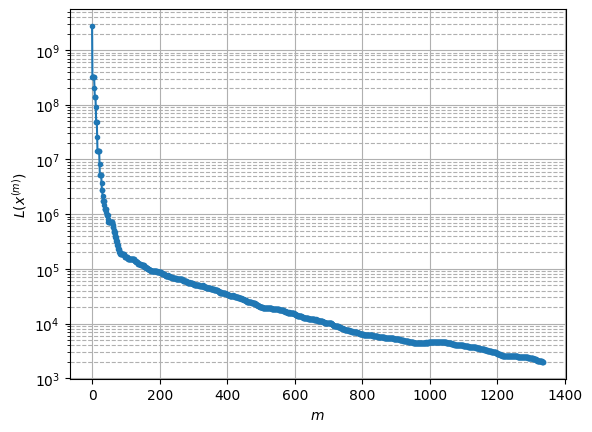

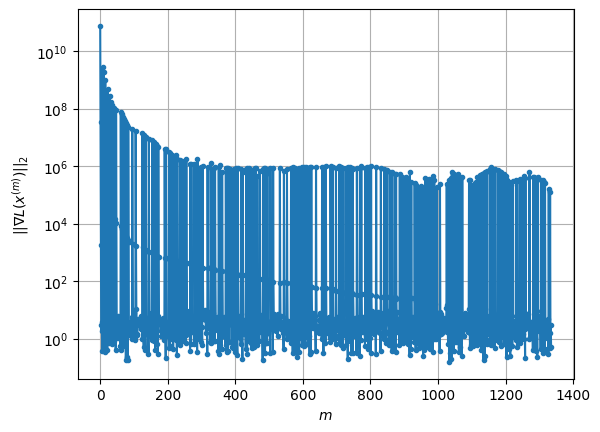

Windows:  39%|███▉      | 116/296 [57:40<42:18, 14.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1972.6205976395313
Gradient norm: 105424.71057076448
Global relative error: 26.007039155000506
Position relative errors: 0.026210441712205962 m, 14.671220988807804 m, 7.864781860305424 m, 19.98141262790464 m

Iteration 1
Cost function: 1963.9386209174656 (-0.44%)
Gradient norm: 1.4650929970185638 (-100.00%)
Global relative error = 25.889185495737316 (-0.45%)
Position relative errors: 0.02735326999324047 m, 14.632623850461853 m, 7.876605236681674 m, 19.85158916412376 m

Iteration 2
Cost function: 1963.938620839215 (-0.00%)
Gradient norm: 4.9252696625123145 (236.17%)
Global relative error = 25.889185486595103 (-0.00%)
Position relative errors: 0.0273532441599996 m, 14.632623742763137 m, 7.876605275526302 m, 19.851589216208758 m

STOP on Iteration 3
Cost function = 1963.938621206694 (0.00%)
Gradient norm = 0.8198572925553155 (-83.35%)
Global relative error = 25.889185487774323 (0.00%)
Final position relati

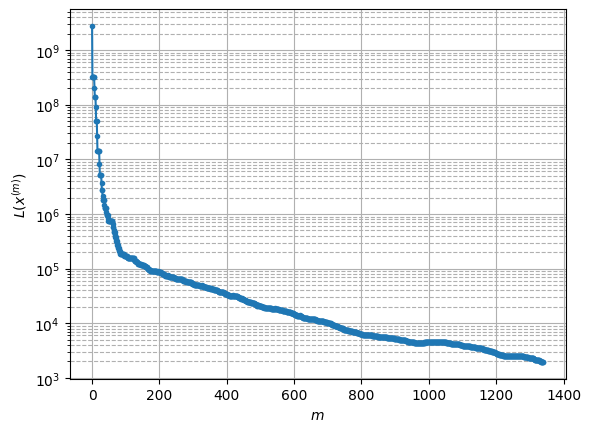

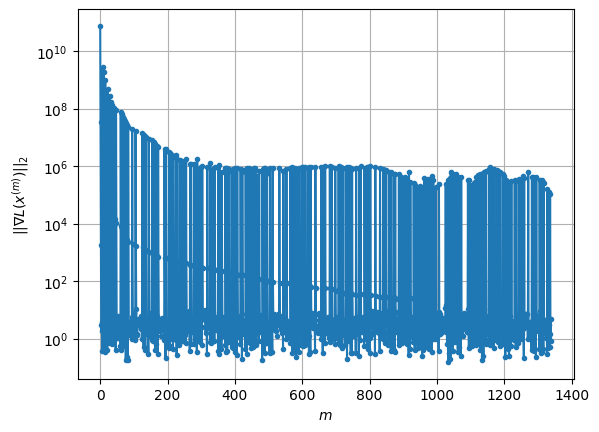

Windows:  40%|███▉      | 117/296 [57:51<39:32, 13.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1929.790399579051
Gradient norm: 248868.80720492807
Global relative error: 20.515781227863645
Position relative errors: 0.02664912004853027 m, 10.831511001437644 m, 5.4682254432830115 m, 16.5427976436357 m

Iteration 1
Cost function: 1921.213732679593 (-0.44%)
Gradient norm: 3.399972869409052 (-100.00%)
Global relative error = 20.41892975084955 (-0.47%)
Position relative errors: 0.02375233731153411 m, 10.803371929945213 m, 5.520927036944314 m, 16.423440181896588 m

Iteration 2
Cost function: 1921.21373326346 (0.00%)
Gradient norm: 4.69781588813991 (38.17%)
Global relative error = 20.41892977074358 (0.00%)
Position relative errors: 0.023752309219439927 m, 10.803371813016543 m, 5.520927145714601 m, 16.423440247022082 m

STOP on Iteration 3
Cost function = 1921.2137328258198 (-0.00%)
Gradient norm = 0.39255553011628797 (-91.64%)
Global relative error = 20.418929771368667 (0.00%)
Final position relative err

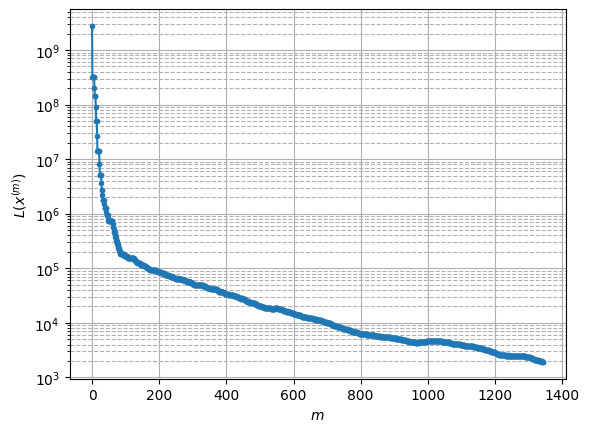

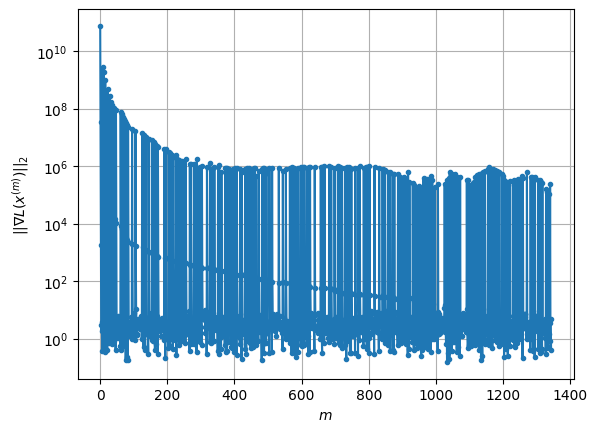

Windows:  40%|███▉      | 118/296 [58:02<37:01, 12.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1917.1588289644346
Gradient norm: 195173.65327419442
Global relative error: 15.214718775478083
Position relative errors: 0.0233214254832758 m, 7.001601478920383 m, 3.4704579114638756 m, 13.054161722259822 m

Iteration 1
Cost function: 1908.4662860582882 (-0.45%)
Gradient norm: 3.768497505196655 (-100.00%)
Global relative error = 15.141621853870662 (-0.48%)
Position relative errors: 0.028032235499760208 m, 6.976597031703559 m, 3.601641908126245 m, 12.94657280258794 m

Iteration 2
Cost function: 1908.466286243464 (0.00%)
Gradient norm: 1.0600766200767215 (-71.87%)
Global relative error = 15.141621942787996 (0.00%)
Position relative errors: 0.028032198320616295 m, 6.9765969371685985 m, 3.601642201093001 m, 12.946572876102021 m

STOP on Iteration 3
Cost function = 1908.4662865716848 (0.00%)
Gradient norm = 0.364825423591872 (-65.58%)
Global relative error = 15.141621943674066 (0.00%)
Final position relative

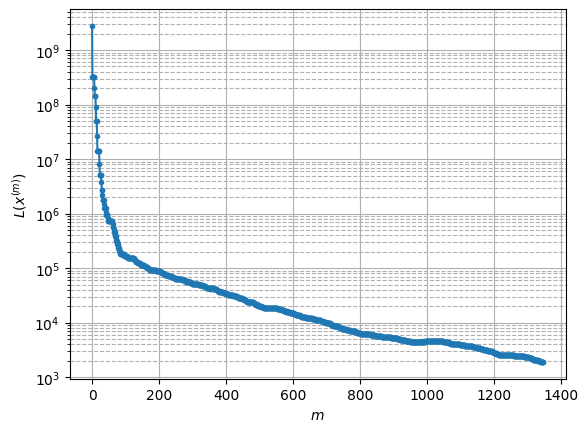

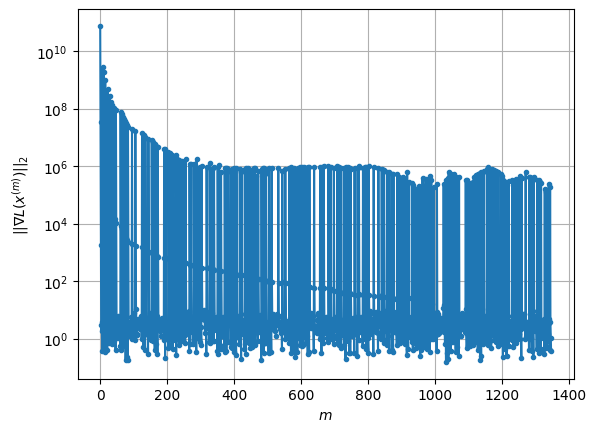

Windows:  40%|████      | 119/296 [58:13<35:13, 11.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1903.0664216045025
Gradient norm: 300950.86544810515
Global relative error: 10.505922491560062
Position relative errors: 0.027367552223015464 m, 3.313823008565456 m, 2.9020569522470723 m, 9.537332388989746 m

Iteration 1
Cost function: 1894.705345446732 (-0.44%)
Gradient norm: 1.7411976273866223 (-100.00%)
Global relative error = 10.458486558831439 (-0.45%)
Position relative errors: 0.024133212640722077 m, 3.286587749520372 m, 3.0752314193667374 m, 9.43986729822277 m

Iteration 2
Cost function: 1894.705345137028 (-0.00%)
Gradient norm: 1.9043533917118638 (9.37%)
Global relative error = 10.458486779263767 (0.00%)
Position relative errors: 0.024133172773254018 m, 3.286587813961929 m, 3.075231891385437 m, 9.439867366336868 m

STOP on Iteration 3
Cost function = 1894.7053449589957 (-0.00%)
Gradient norm = 0.5139028875400841 (-73.01%)
Global relative error = 10.458486780876925 (0.00%)
Final position relative

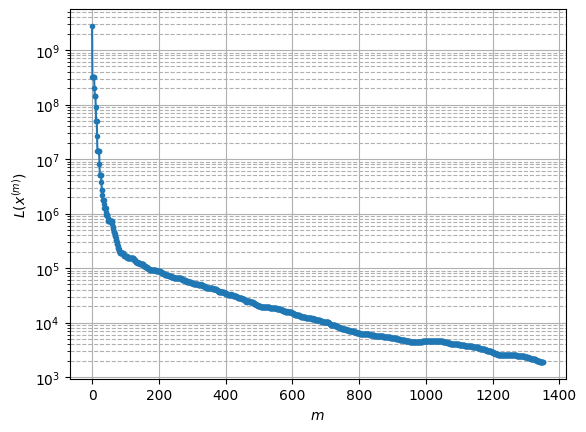

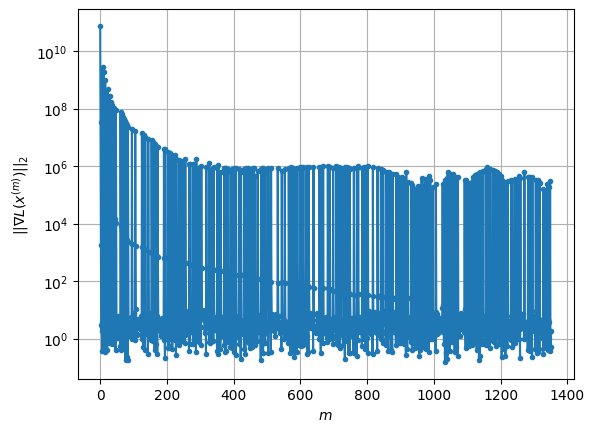

Windows:  41%|████      | 120/296 [58:23<34:00, 11.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1907.148806161605
Gradient norm: 470216.53842682653
Global relative error: 7.650000518027408
Position relative errors: 0.02366218246514209 m, 1.8749747996855408 m, 4.3248339465747465 m, 6.024334920118022 m

Iteration 1
Cost function: 1899.88392367698 (-0.38%)
Gradient norm: 4.2335500216298545 (-100.00%)
Global relative error = 7.62062145008398 (-0.38%)
Position relative errors: 0.0166647704001232 m, 1.8015465665516222 m, 4.429584452816293 m, 5.932724702575115 m

Iteration 2
Cost function: 1899.8839236815797 (0.00%)
Gradient norm: 1.8375130685173544 (-56.60%)
Global relative error = 7.62062174624701 (0.00%)
Position relative errors: 0.01666472805048653 m, 1.8015469522004537 m, 4.429584737106181 m, 5.932724753747461 m

Iteration 3
Cost function: 1899.8839243305351 (0.00%)
Gradient norm: 5.613531412422896 (205.50%)
Global relative error = 7.620621747589036 (0.00%)
Position relative errors: 0.01666472757180

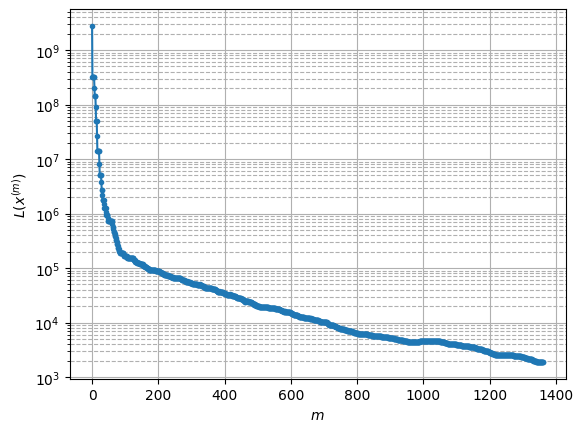

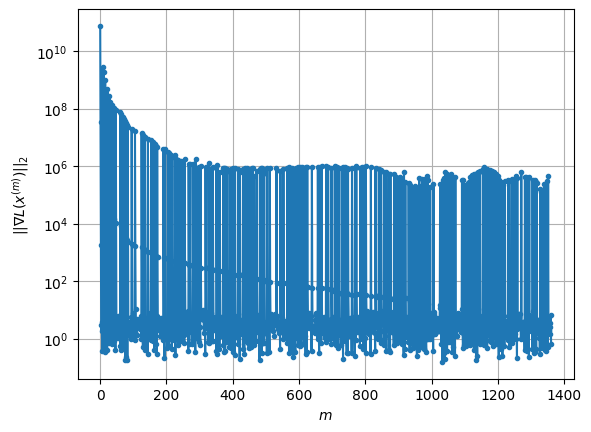

Windows:  41%|████      | 121/296 [58:49<46:18, 15.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1922.0159029011584
Gradient norm: 387035.4852635423
Global relative error: 8.692177910095333
Position relative errors: 0.01665262773455983 m, 5.114510833681374 m, 6.509116469077184 m, 2.64901874652237 m

Iteration 1
Cost function: 1915.169266449071 (-0.36%)
Gradient norm: 2.1090955264609272 (-100.00%)
Global relative error = 8.667218743437761 (-0.29%)
Position relative errors: 0.009279355973391468 m, 5.051436039197961 m, 6.564170768851567 m, 2.5506321809322587 m

Iteration 2
Cost function: 1915.1692667976934 (0.00%)
Gradient norm: 1.1166474414367156 (-47.06%)
Global relative error = 8.667218979181566 (0.00%)
Position relative errors: 0.009279320470988964 m, 5.051436251596587 m, 6.564170898115485 m, 2.550632228816701 m

STOP on Iteration 3
Cost function = 1915.1692672217857 (0.00%)
Gradient norm = 0.6829463217409988 (-38.84%)
Global relative error = 8.667218977056429 (-0.00%)
Final position relative erro

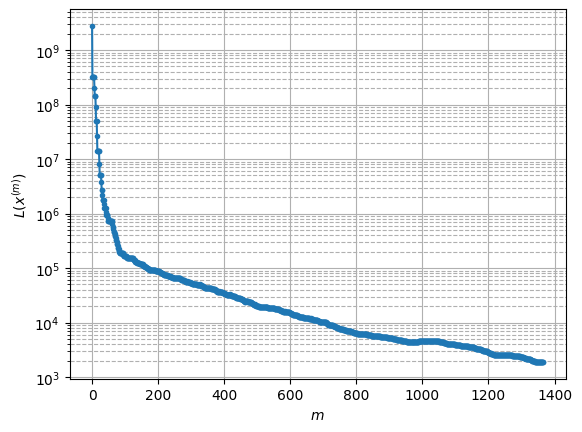

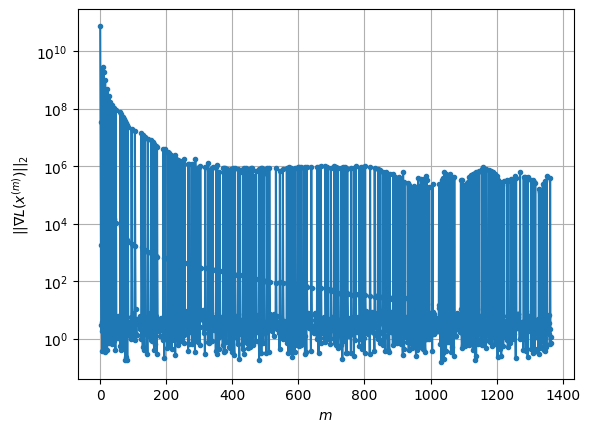

Windows:  41%|████      | 122/296 [59:00<41:50, 14.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1953.905820593192
Gradient norm: 428053.1941881503
Global relative error: 12.65162251201763
Position relative errors: 0.009228086667572787 m, 8.827367086852371 m, 8.878363670271915 m, 1.818321509702892 m

Iteration 1
Cost function: 1946.4347340610334 (-0.38%)
Gradient norm: 5.48351234554161 (-100.00%)
Global relative error = 12.613650295290876 (-0.30%)
Position relative errors: 0.0022556714863708324 m, 8.764380987512487 m, 8.902799476344965 m, 1.737978035317502 m

Iteration 2
Cost function: 1946.434732860314 (-0.00%)
Gradient norm: 6.046503580156856 (10.27%)
Global relative error = 12.613650452574477 (0.00%)
Position relative errors: 0.0022556514876664793 m, 8.764381104004762 m, 8.90279958164348 m, 1.7379780500044124 m

Iteration 3
Cost function: 1946.4347319062472 (-0.00%)
Gradient norm: 3.4435128944957984 (-43.05%)
Global relative error = 12.61365045248137 (-0.00%)
Position relative errors: 0.00225564

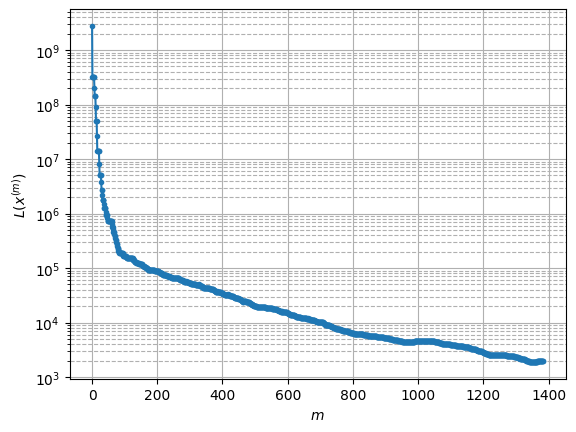

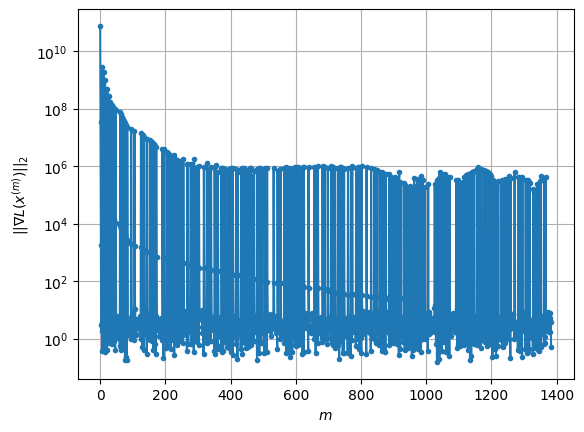

Windows:  42%|████▏     | 123/296 [59:44<1:07:12, 23.31s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2004.3245334534463
Gradient norm: 513621.2871820512
Global relative error: 17.590912191272988
Position relative errors: 0.002197510098785669 m, 12.551996077775023 m, 11.276776971409276 m, 4.971184628589838 m

Iteration 1
Cost function: 1996.2641544959786 (-0.40%)
Gradient norm: 1.8668124639213164 (-100.00%)
Global relative error = 17.530997878118217 (-0.34%)
Position relative errors: 0.008733212643337476 m, 12.47815721551922 m, 11.268150724677684 m, 4.964978367096722 m

Iteration 2
Cost function: 1996.2641557161578 (0.00%)
Gradient norm: 3.7544006673080177 (101.11%)
Global relative error = 17.530997960098297 (0.00%)
Position relative errors: 0.008733186153681951 m, 12.47815733337966 m, 11.268150733097913 m, 4.9649783412868445 m

Iteration 3
Cost function: 1996.2641557283457 (0.00%)
Gradient norm: 4.033389324037204 (7.43%)
Global relative error = 17.530997958735163 (-0.00%)
Position relative errors: 0.00

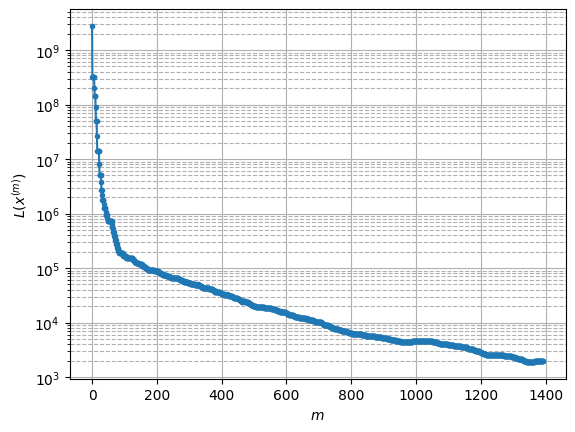

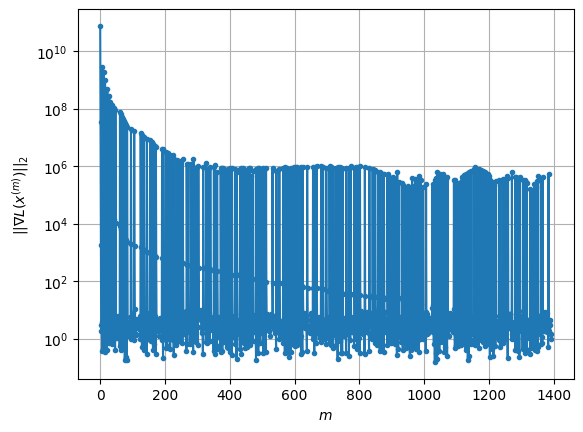

Windows:  42%|████▏     | 124/296 [1:00:08<1:07:29, 23.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2099.7266917698294
Gradient norm: 581930.7683078203
Global relative error: 22.80159100394027
Position relative errors: 0.008445664359212943 m, 16.220915492582993 m, 13.641659454853489 m, 8.407769908123074 m

Iteration 1
Cost function: 2090.1202043503326 (-0.46%)
Gradient norm: 2.7836801888461746 (-100.00%)
Global relative error = 22.714127855615757 (-0.38%)
Position relative errors: 0.006251123463373839 m, 16.142043155251965 m, 13.589882179896673 m, 8.406677688014573 m

Iteration 2
Cost function: 2090.1202055136196 (0.00%)
Gradient norm: 4.806901455609742 (72.68%)
Global relative error = 22.714127853807682 (-0.00%)
Position relative errors: 0.0062510919621112234 m, 16.14204319022817 m, 13.589882153962472 m, 8.406677657917028 m

STOP on Iteration 3
Cost function = 2090.1202042475734 (-0.00%)
Gradient norm = 0.5703164280953197 (-88.14%)
Global relative error = 22.714127854113517 (0.00%)
Final position rel

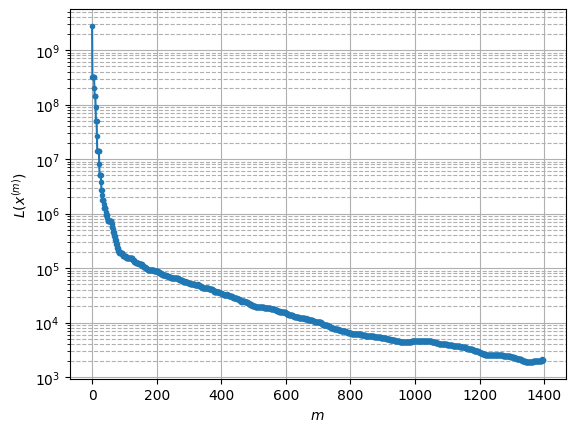

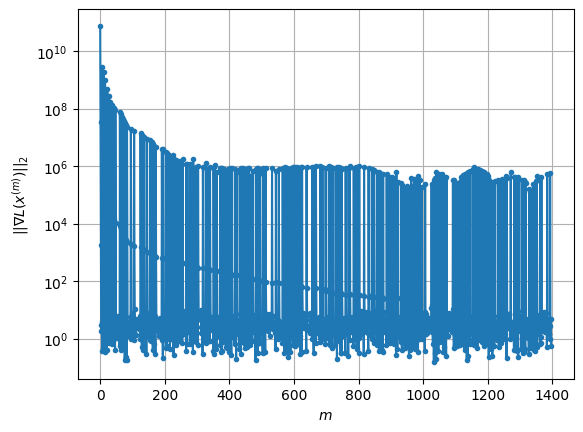

Windows:  42%|████▏     | 125/296 [1:00:20<56:37, 19.87s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2187.356188537351
Gradient norm: 750032.8103224188
Global relative error: 28.044652553615766
Position relative errors: 0.005772060970989797 m, 19.814002147795655 m, 15.930810995705611 m, 11.83674494668403 m

Iteration 1
Cost function: 2175.7880737452174 (-0.53%)
Gradient norm: 5.68186408609315 (-100.00%)
Global relative error = 27.931427324391205 (-0.40%)
Position relative errors: 0.0046346883145588925 m, 19.731929010941027 m, 15.836567288814772 m, 11.83259081298014 m

Iteration 2
Cost function: 2175.78807343462 (-0.00%)
Gradient norm: 2.1512526033399175 (-62.14%)
Global relative error = 27.931427276282427 (-0.00%)
Position relative errors: 0.004634674543493158 m, 19.731928977377745 m, 15.836567270732333 m, 11.832590779593234 m

Iteration 3
Cost function: 2175.788073376295 (-0.00%)
Gradient norm: 3.0273025979177786 (40.72%)
Global relative error = 27.931427276357837 (0.00%)
Position relative errors: 0.0

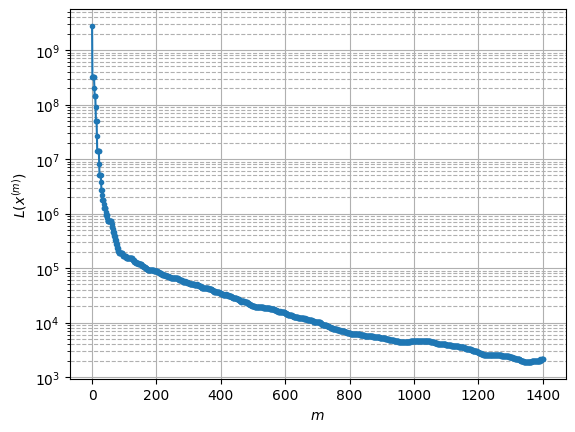

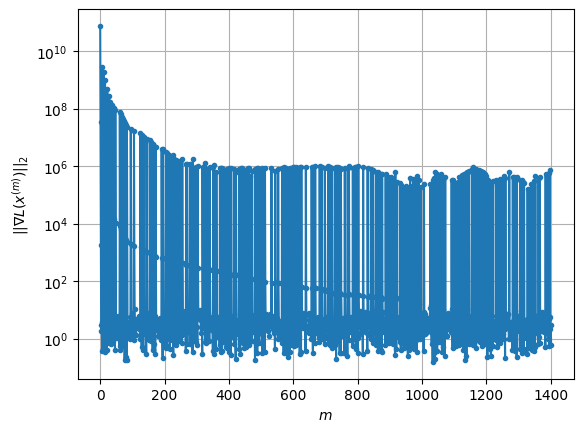

Windows:  43%|████▎     | 126/296 [1:00:33<50:45, 17.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2299.817956304104
Gradient norm: 670934.9091481771
Global relative error: 33.21953711251115
Position relative errors: 0.003959197068595639 m, 23.31393910155078 m, 18.124664307796802 m, 15.21467350718149 m

Iteration 1
Cost function: 2285.869593206404 (-0.61%)
Gradient norm: 1.9867190658292324 (-100.00%)
Global relative error = 33.07973681161479 (-0.42%)
Position relative errors: 0.005720799688461595 m, 23.229199670762327 m, 17.983578839589384 m, 15.20710472428205 m

STOP on Iteration 2
Cost function = 2285.869593138183 (-0.00%)
Gradient norm = 0.19795860697400394 (-90.04%)
Global relative error = 33.079736764756866 (-0.00%)
Final position relative errors: 0.005720769913583563 m, 23.22919968026192 m, 17.983578774087604 m, 15.207104685313858 m

Majorization-Minimization converged after 1 iterations


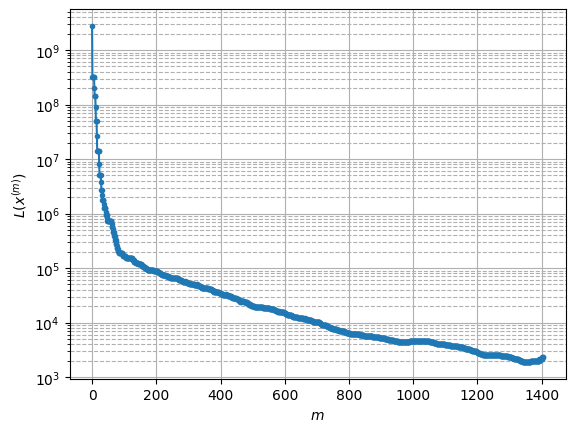

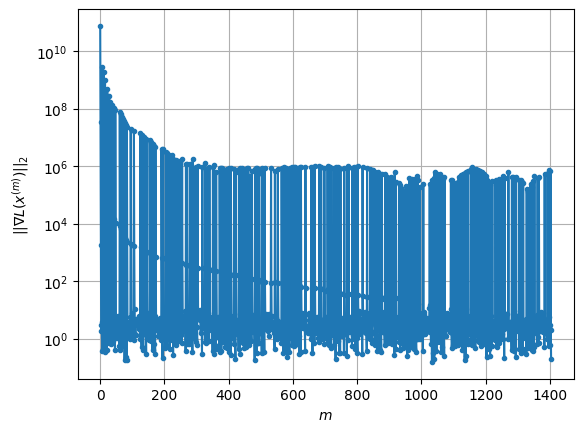

Windows:  43%|████▎     | 127/296 [1:00:41<42:21, 15.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2426.5649855372462
Gradient norm: 694598.3548378366
Global relative error: 38.267065258323214
Position relative errors: 0.005491525723064818 m, 26.705317283079303 m, 20.20302739770877 m, 18.52091571872522 m

Iteration 1
Cost function: 2410.8926790307696 (-0.65%)
Gradient norm: 1.4675719466595152 (-100.00%)
Global relative error = 38.10128037086384 (-0.43%)
Position relative errors: 0.008286869158160078 m, 26.622725557822896 m, 20.00595465656506 m, 18.51194596233998 m

STOP on Iteration 2
Cost function = 2410.8926792091447 (0.00%)
Gradient norm = 0.3964023221111753 (-72.99%)
Global relative error = 38.101280241674836 (-0.00%)
Final position relative errors: 0.00828688127926052 m, 26.622725521060943 m, 20.00595449004132 m, 18.511945929269448 m

Majorization-Minimization converged after 1 iterations


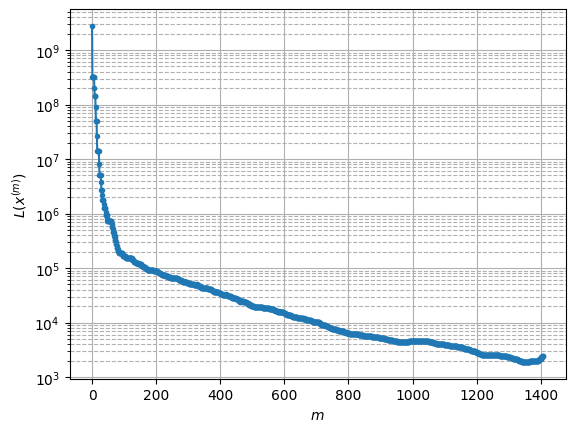

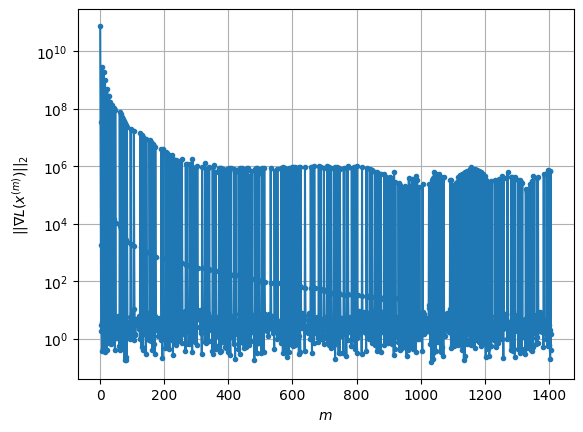

Windows:  43%|████▎     | 128/296 [1:00:49<36:15, 12.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2627.3831616282796
Gradient norm: 569309.8967404214
Global relative error: 43.14689964385464
Position relative errors: 0.0075478817953819576 m, 29.97774487931916 m, 22.14267212281306 m, 21.74131218996587 m

Iteration 1
Cost function: 2609.026853498832 (-0.70%)
Gradient norm: 2.564268115852901 (-100.00%)
Global relative error = 42.94558368960713 (-0.47%)
Position relative errors: 0.00861985179549005 m, 29.891671183038774 m, 21.883133321532522 m, 21.72400664049256 m

Iteration 2
Cost function: 2609.026853594516 (0.00%)
Gradient norm: 2.4901633980337334 (-2.89%)
Global relative error = 42.945583493859935 (-0.00%)
Position relative errors: 0.008619810263796844 m, 29.89167126550006 m, 21.883132852123666 m, 21.724006612924207 m

Iteration 3
Cost function: 2609.0268538426317 (0.00%)
Gradient norm: 1.5007395054193404 (-39.73%)
Global relative error = 42.94558349452334 (0.00%)
Position relative errors: 0.0086198

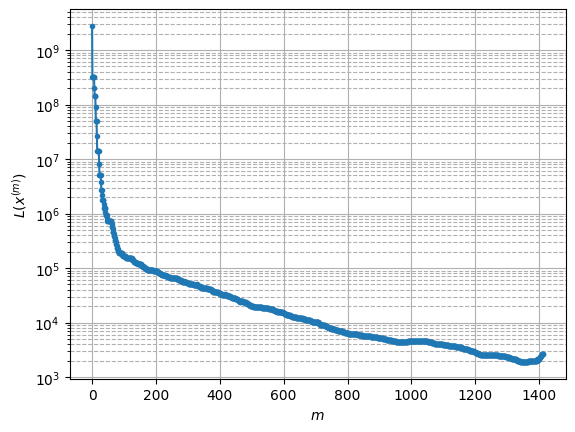

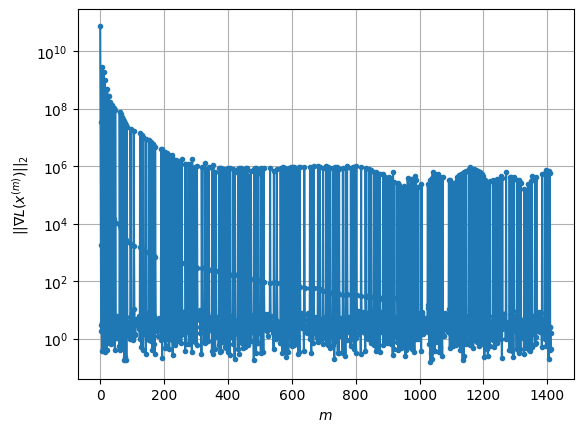

Windows:  44%|████▎     | 129/296 [1:01:03<36:12, 13.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2858.179528788242
Gradient norm: 552440.0458050206
Global relative error: 47.818059056758635
Position relative errors: 0.009043162060300647 m, 33.11205396452394 m, 23.92508823783378 m, 24.85441955720932 m

Iteration 1
Cost function: 2835.3087743115257 (-0.80%)
Gradient norm: 1.015130739615954 (-100.00%)
Global relative error = 47.58147138672007 (-0.49%)
Position relative errors: 0.013732659526653082 m, 33.02731588908684 m, 23.592770460463242 m, 24.830773096300458 m

Iteration 2
Cost function: 2835.3087755560823 (0.00%)
Gradient norm: 5.597951479895226 (451.45%)
Global relative error = 47.58147095664342 (-0.00%)
Position relative errors: 0.013732629609997986 m, 33.027315940378934 m, 23.592769549563045 m, 24.83077306945246 m

Iteration 3
Cost function: 2835.308776038059 (0.00%)
Gradient norm: 9.67040277867143 (72.75%)
Global relative error = 47.58147095645862 (-0.00%)
Position relative errors: 0.013732628

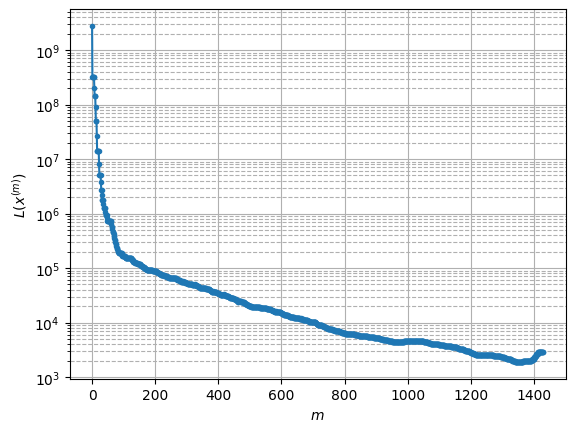

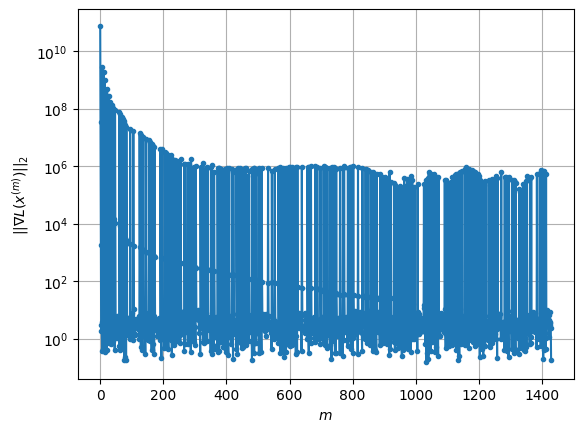

Windows:  44%|████▍     | 130/296 [1:01:45<1:00:34, 21.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3145.1211102431853
Gradient norm: 719752.7475284226
Global relative error: 52.25400727284154
Position relative errors: 0.014273147961058868 m, 36.09950748309988 m, 25.52996238343962 m, 27.8481901104651 m

Iteration 1
Cost function: 3114.224377129285 (-0.98%)
Gradient norm: 2.32749231894106 (-100.00%)
Global relative error = 51.97753383382455 (-0.53%)
Position relative errors: 0.012746074734324883 m, 36.01637067530302 m, 25.111477184175527 m, 27.818926732617477 m

Iteration 2
Cost function: 3114.224377868048 (0.00%)
Gradient norm: 1.6738319656489151 (-28.08%)
Global relative error = 51.97753310562353 (-0.00%)
Position relative errors: 0.01274606984686141 m, 36.01637078173135 m, 25.111475554437906 m, 27.818926705366714 m

Iteration 3
Cost function: 3114.2243770441464 (-0.00%)
Gradient norm: 4.739268283429023 (183.14%)
Global relative error = 51.977533105501756 (-0.00%)
Position relative errors: 0.01274607

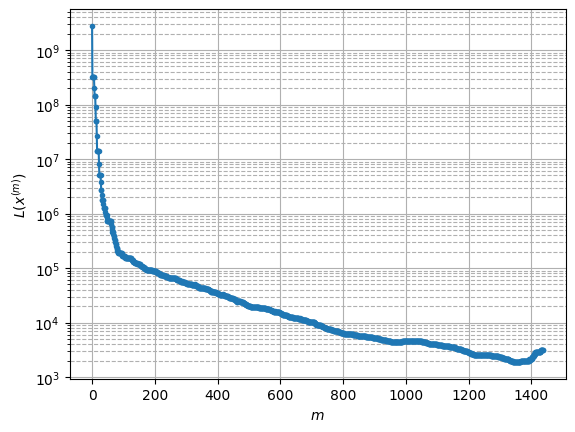

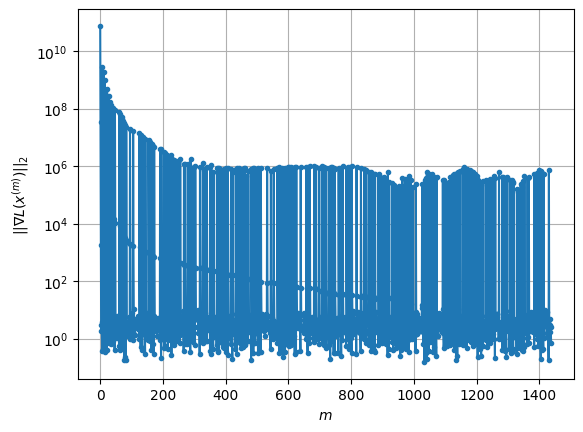

Windows:  44%|████▍     | 131/296 [1:02:06<58:56, 21.43s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3482.015631619352
Gradient norm: 511895.3481596865
Global relative error: 56.42673604315417
Position relative errors: 0.013489803893450404 m, 38.927287464562895 m, 26.9356052403767 m, 30.71010372124599 m

Iteration 1
Cost function: 3441.5220927318 (-1.16%)
Gradient norm: 3.9017370316803155 (-100.00%)
Global relative error = 56.10531972674749 (-0.57%)
Position relative errors: 0.01433689886186642 m, 38.84356504978022 m, 26.41771417669196 m, 30.67707945386169 m

Iteration 2
Cost function: 3441.5220938592815 (0.00%)
Gradient norm: 1.4508105430574394 (-62.82%)
Global relative error = 56.10531845411565 (-0.00%)
Position relative errors: 0.014336927376138908 m, 38.84356513790986 m, 26.417711372143145 m, 30.67707942989119 m

Iteration 3
Cost function: 3441.52209379716 (-0.00%)
Gradient norm: 3.6540957057513834 (151.87%)
Global relative error = 56.105318453198585 (-0.00%)
Position relative errors: 0.01433693078

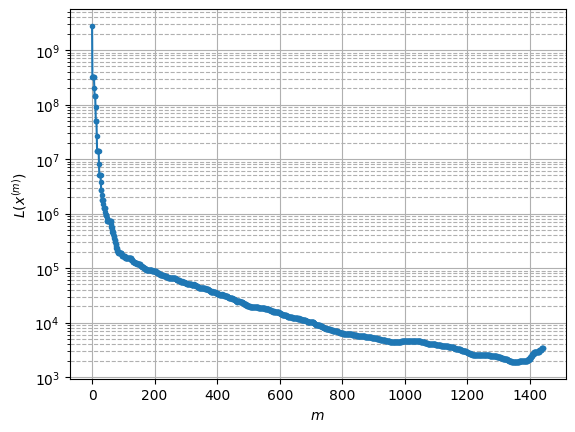

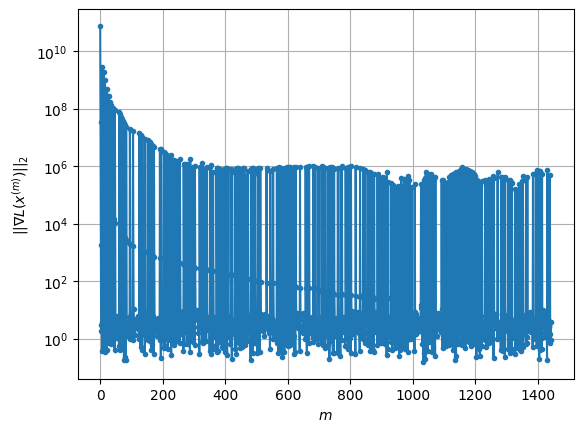

Windows:  45%|████▍     | 132/296 [1:02:18<51:31, 18.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3862.957780032231
Gradient norm: 420948.65444925096
Global relative error: 60.31035337008198
Position relative errors: 0.01511980639321658 m, 41.58102924384296 m, 28.121743618159687 m, 33.42931807729026 m

Iteration 1
Cost function: 3809.5541523059796 (-1.38%)
Gradient norm: 8.902084669929497 (-100.00%)
Global relative error = 59.939212961871974 (-0.62%)
Position relative errors: 0.014783498234496288 m, 41.49719634343731 m, 27.487196815899804 m, 33.39372741543224 m

Iteration 2
Cost function: 3809.554152148684 (-0.00%)
Gradient norm: 1.4133861447944422 (-84.12%)
Global relative error = 59.93921107810682 (-0.00%)
Position relative errors: 0.014783657066237734 m, 41.49719643155864 m, 27.487192601143086 m, 33.393727393909444 m

STOP on Iteration 3
Cost function = 3809.554152996965 (0.00%)
Gradient norm = 0.2389926758539551 (-83.09%)
Global relative error = 59.93921107818514 (0.00%)
Final position relative 

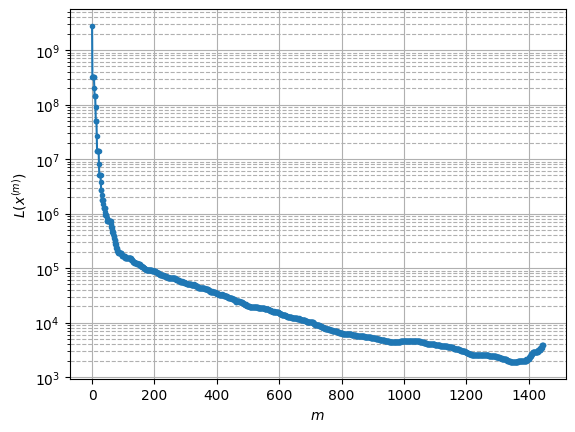

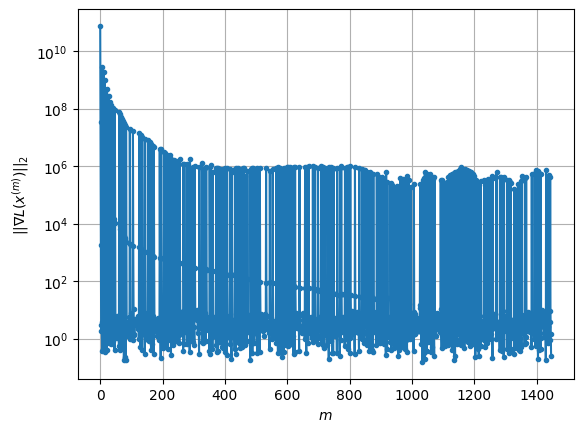

Windows:  45%|████▍     | 133/296 [1:02:29<44:30, 16.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4195.819282779778
Gradient norm: 447091.4282430036
Global relative error: 63.88152655191913
Position relative errors: 0.0157023565164573 m, 44.05003240904772 m, 29.0651717865645 m, 35.99521503690421 m

Iteration 1
Cost function: 4127.03120398914 (-1.64%)
Gradient norm: 10.4025000197905 (-100.00%)
Global relative error = 63.46365409164492 (-0.65%)
Position relative errors: 0.01558400404202216 m, 43.964231047934966 m, 28.319892429170526 m, 35.95498759216963 m

Iteration 2
Cost function: 4127.031204775378 (0.00%)
Gradient norm: 7.261427956324245 (-30.20%)
Global relative error = 63.46365151913271 (-0.00%)
Position relative errors: 0.015584183656836921 m, 43.96423115058145 m, 28.319886528177936 m, 35.95498757378048 m

Iteration 3
Cost function: 4127.031205204631 (0.00%)
Gradient norm: 4.175963641308646 (-42.49%)
Global relative error = 63.463651519550424 (0.00%)
Position relative errors: 0.01558418536457314

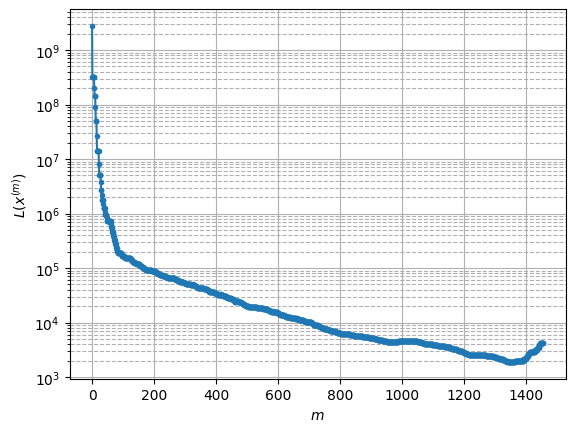

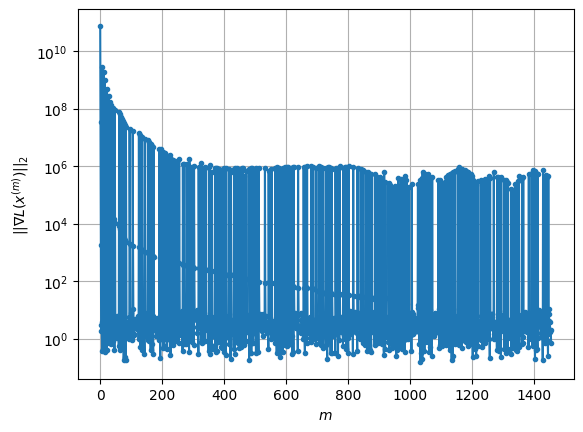

Windows:  45%|████▌     | 134/296 [1:02:54<51:12, 18.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4603.6717127199045
Gradient norm: 285268.22004695545
Global relative error: 67.12644027733954
Position relative errors: 0.016437803226177744 m, 46.321846547531834 m, 29.76728371578106 m, 38.394668257154585 m

Iteration 1
Cost function: 4514.269758604244 (-1.94%)
Gradient norm: 13.651425215749983 (-100.00%)
Global relative error = 66.65923670739079 (-0.70%)
Position relative errors: 0.020937518701527894 m, 46.23218912066379 m, 28.896734522299045 m, 38.353791526964834 m

Iteration 2
Cost function: 4514.2697586446975 (0.00%)
Gradient norm: 6.524183896768021 (-52.21%)
Global relative error = 66.65923325055186 (-0.00%)
Position relative errors: 0.0209378549393403 m, 46.2321892880317 m, 28.896726310575794 m, 38.35379150393768 m

Iteration 3
Cost function: 4514.269757652283 (-0.00%)
Gradient norm: 3.6649543209610456 (-43.83%)
Global relative error = 66.65923325117433 (0.00%)
Position relative errors: 0.0209378

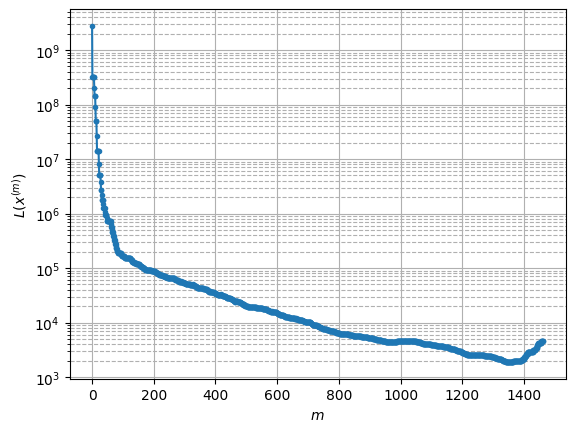

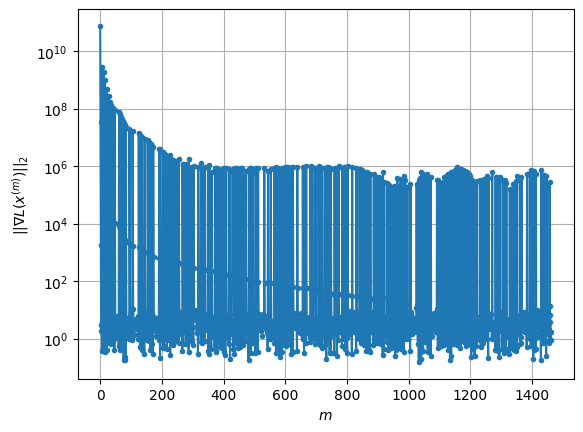

Windows:  46%|████▌     | 135/296 [1:03:09<47:58, 17.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4852.32798370785
Gradient norm: 239791.9691013489
Global relative error: 70.027851168748
Position relative errors: 0.022012010768867094 m, 48.38537094958472 m, 30.210665987301212 m, 40.62102969397898 m

Iteration 1
Cost function: 4748.744239473973 (-2.13%)
Gradient norm: 13.876229476059365 (-99.99%)
Global relative error = 69.53290418490657 (-0.71%)
Position relative errors: 0.026700319162312674 m, 48.29193234713668 m, 29.260423211104122 m, 40.577555732240754 m

STOP on Iteration 2
Cost function = 4748.7442410723015 (0.00%)
Gradient norm = 0.26207912201924793 (-98.11%)
Global relative error = 69.53289953543494 (-0.00%)
Final position relative errors: 0.02670082044343287 m, 48.2919324814694 m, 29.26041197119018 m, 40.57755570988047 m

Majorization-Minimization converged after 1 iterations


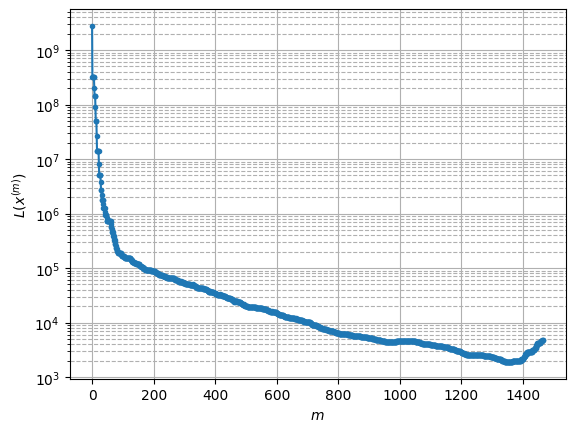

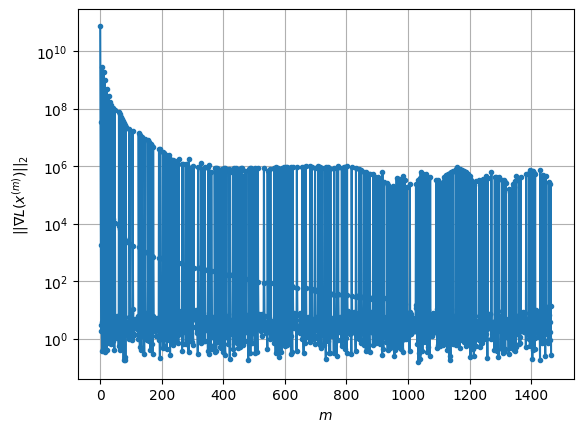

Windows:  46%|████▌     | 136/296 [1:03:17<39:45, 14.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4805.672975263224
Gradient norm: 166454.59541245876
Global relative error: 72.5947077170006
Position relative errors: 0.02774312901851482 m, 50.231864343079714 m, 30.440532174267055 m, 42.66289050745903 m

Iteration 1
Cost function: 4701.0753673401705 (-2.18%)
Gradient norm: 9.009052765959314 (-99.99%)
Global relative error = 72.10179164159457 (-0.68%)
Position relative errors: 0.0316393604865913 m, 50.131994031878726 m, 29.482420761379522 m, 42.61730879876854 m

Iteration 2
Cost function: 4701.075366824799 (-0.00%)
Gradient norm: 1.8261779471393431 (-79.73%)
Global relative error = 72.10178622039344 (-0.00%)
Position relative errors: 0.03163995967454426 m, 50.131994123184526 m, 29.482407378807064 m, 42.617308777084205 m

Iteration 3
Cost function: 4701.075367922872 (0.00%)
Gradient norm: 3.041096063487622 (66.53%)
Global relative error = 72.10178622052278 (0.00%)
Position relative errors: 0.03163995844

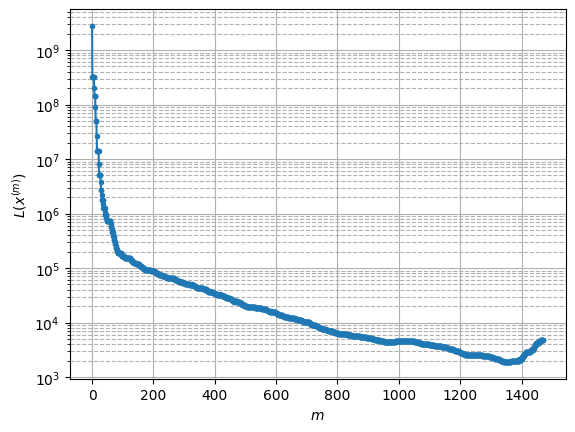

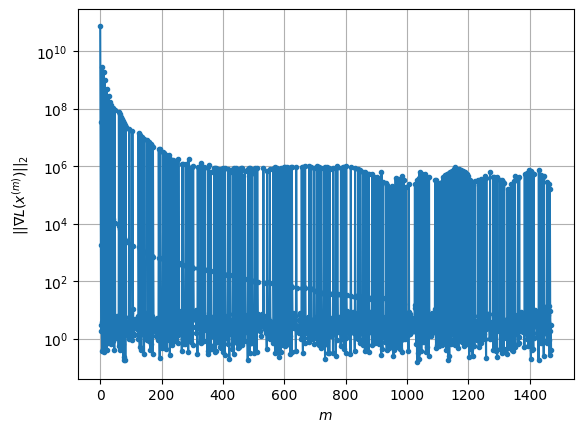

Windows:  46%|████▋     | 137/296 [1:03:30<38:04, 14.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4606.86321291202
Gradient norm: 322176.3581743807
Global relative error: 74.84624966681729
Position relative errors: 0.03249506752027683 m, 51.850755884089324 m, 30.530867109978086 m, 44.51205906756656 m

Iteration 1
Cost function: 4507.8255113627265 (-2.15%)
Gradient norm: 11.608185404693504 (-100.00%)
Global relative error = 74.37087501700137 (-0.64%)
Position relative errors: 0.03926319874611302 m, 51.74569043265967 m, 29.60163182897937 m, 44.46516087051637 m

Iteration 2
Cost function: 4507.825511245179 (-0.00%)
Gradient norm: 2.474631443668625 (-78.68%)
Global relative error = 74.37086967943912 (-0.00%)
Position relative errors: 0.03926381242681926 m, 51.745690554460474 m, 29.601618239827893 m, 44.46516084746411 m

Iteration 3
Cost function: 4507.825510704441 (-0.00%)
Gradient norm: 3.8371733951100992 (55.06%)
Global relative error = 74.3708696793112 (-0.00%)
Position relative errors: 0.03926381723

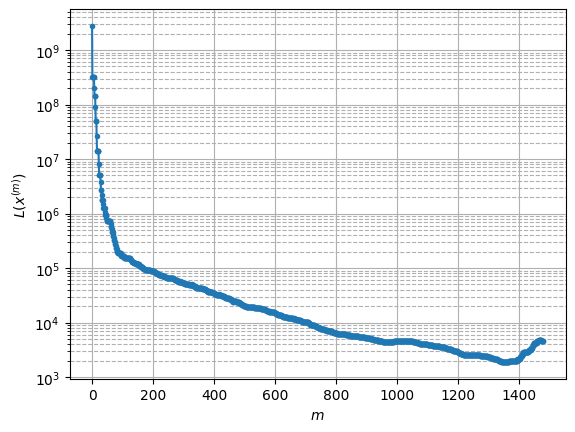

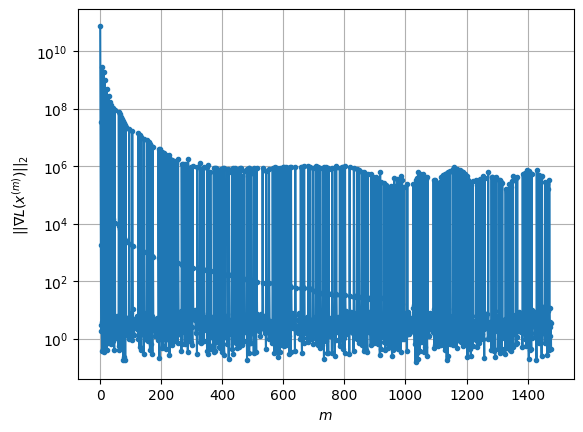

Windows:  47%|████▋     | 138/296 [1:03:48<40:38, 15.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4404.284296275435
Gradient norm: 242167.9421348892
Global relative error: 76.78927177377179
Position relative errors: 0.03927376492704348 m, 53.236474617321036 m, 30.521730327041773 m, 46.16157510782852 m

Iteration 1
Cost function: 4312.7576088420365 (-2.08%)
Gradient norm: 9.827817601744918 (-100.00%)
Global relative error = 76.33356807656328 (-0.59%)
Position relative errors: 0.03754233554660723 m, 53.128399872131354 m, 29.63016048700118 m, 46.11114264859265 m

Iteration 2
Cost function: 4312.7576086784675 (-0.00%)
Gradient norm: 2.6907914024624198 (-72.62%)
Global relative error = 76.33356311915277 (-0.00%)
Position relative errors: 0.03754296131507129 m, 53.12839995451205 m, 29.630147598011167 m, 46.11114262876284 m

Iteration 3
Cost function: 4312.757607698905 (-0.00%)
Gradient norm: 3.2013287281181864 (18.97%)
Global relative error = 76.3335631190803 (-0.00%)
Position relative errors: 0.037542964

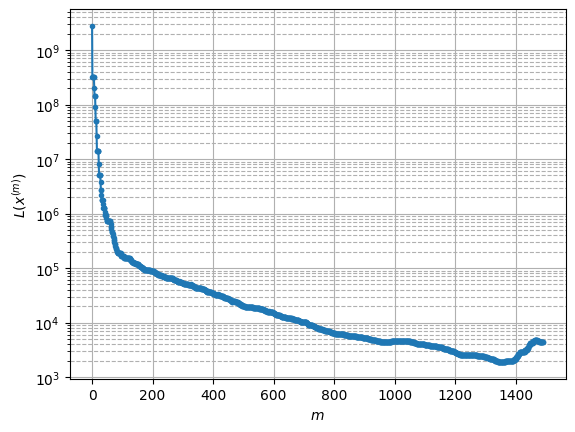

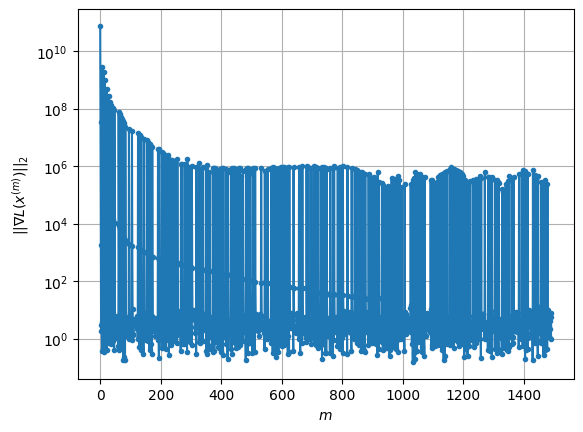

Windows:  47%|████▋     | 139/296 [1:04:21<53:47, 20.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4220.363242709
Gradient norm: 202764.30690346324
Global relative error: 78.41865929079982
Position relative errors: 0.03775961497338361 m, 54.38536388621274 m, 30.4254449369389 m, 47.60260644471788 m

Iteration 1
Cost function: 4135.074507943325 (-2.02%)
Gradient norm: 10.64599690572461 (-99.99%)
Global relative error = 77.98303294440345 (-0.56%)
Position relative errors: 0.039492014979671836 m, 54.27306521332661 m, 29.57638878752016 m, 47.55020959228754 m

Iteration 2
Cost function: 4135.074507576256 (-0.00%)
Gradient norm: 1.5726972634563152 (-85.23%)
Global relative error = 77.98302862968293 (-0.00%)
Position relative errors: 0.039492595444558645 m, 54.27306525650189 m, 29.576377364032552 m, 47.55020957176652 m

STOP on Iteration 3
Cost function = 4135.074507454874 (-0.00%)
Gradient norm = 0.536937598920954 (-65.86%)
Global relative error = 77.98302862959787 (-0.00%)
Final position relative errors: 0

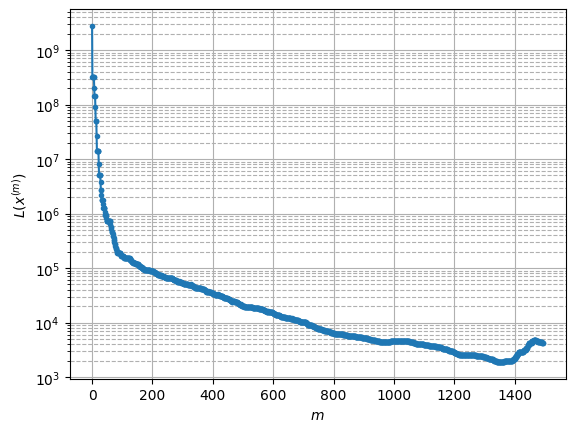

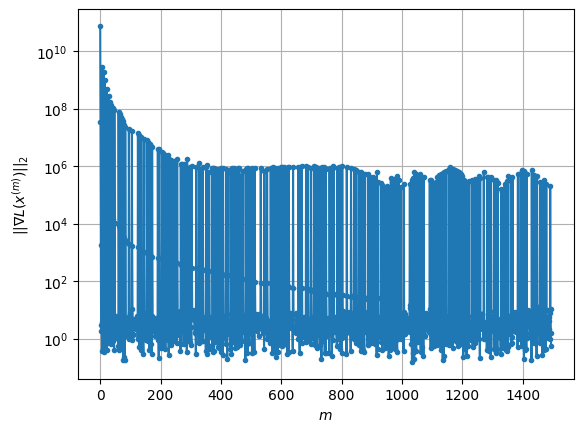

Windows:  47%|████▋     | 140/296 [1:04:32<46:02, 17.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4052.8067716605337
Gradient norm: 438029.1457413294
Global relative error: 79.72890059376779
Position relative errors: 0.03935372953898853 m, 55.291492723678374 m, 30.250503915501906 m, 48.830862852787966 m

Iteration 1
Cost function: 3972.363365803566 (-1.98%)
Gradient norm: 15.512563675620024 (-100.00%)
Global relative error = 79.31321464899831 (-0.52%)
Position relative errors: 0.03484307421390499 m, 55.17416781775405 m, 29.447744774780503 m, 48.77730636213459 m

Iteration 2
Cost function: 3972.3633665144184 (0.00%)
Gradient norm: 2.5727980387869733 (-83.41%)
Global relative error = 79.31321100248059 (-0.00%)
Position relative errors: 0.03484355727423087 m, 55.17416776218676 m, 29.447735093128355 m, 48.77730634029507 m

STOP on Iteration 3
Cost function = 3972.363366540561 (0.00%)
Gradient norm = 0.5228591025137014 (-79.68%)
Global relative error = 79.31321100240197 (-0.00%)
Final position relative e

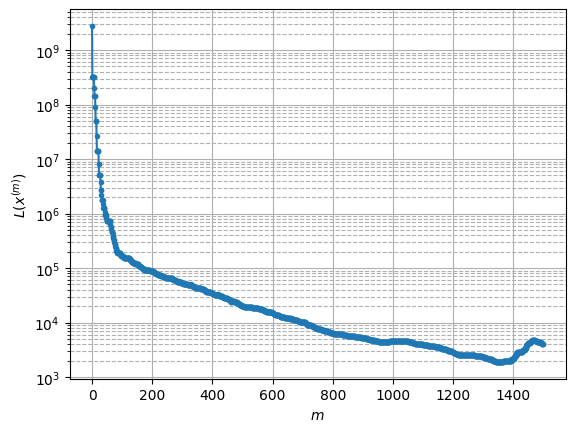

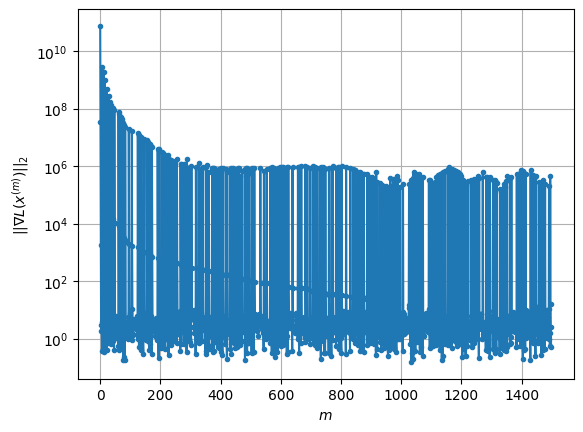

Windows:  48%|████▊     | 141/296 [1:04:43<40:15, 15.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3916.4562636413198
Gradient norm: 328934.0190882233
Global relative error: 80.7152061287143
Position relative errors: 0.03515603893493093 m, 55.950398712574106 m, 30.004231125815725 m, 49.84216903720273 m

Iteration 1
Cost function: 3841.6308616351607 (-1.91%)
Gradient norm: 13.070068725795108 (-100.00%)
Global relative error = 80.314807072981 (-0.50%)
Position relative errors: 0.03677967037333396 m, 55.82803873760353 m, 29.242664845166477 m, 49.785169224503704 m

Iteration 2
Cost function: 3841.6308609889775 (-0.00%)
Gradient norm: 2.7454550788336007 (-78.99%)
Global relative error = 80.3148038583733 (-0.00%)
Position relative errors: 0.036780124439647795 m, 55.82803867516651 m, 29.2426561725014 m, 49.78516920241273 m

Iteration 3
Cost function: 3841.630861640823 (0.00%)
Gradient norm: 3.365253405678679 (22.58%)
Global relative error = 80.3148038581196 (-0.00%)
Position relative errors: 0.0367801224084

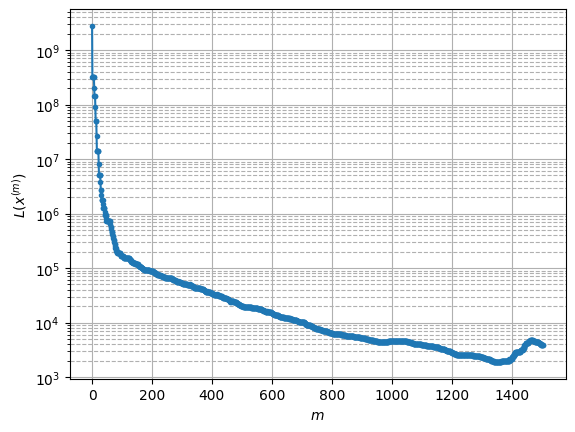

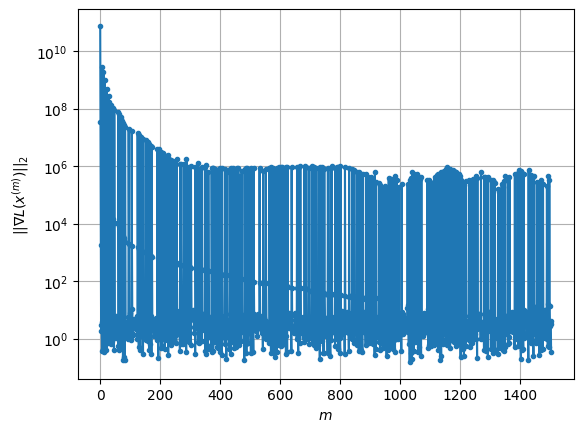

Windows:  48%|████▊     | 142/296 [1:05:00<41:48, 16.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3774.5759199883382
Gradient norm: 438880.8620628887
Global relative error: 81.3699305623139
Position relative errors: 0.03690146840432311 m, 56.35965702538753 m, 29.685073984613428 m, 50.63051882833021 m

Iteration 1
Cost function: 3702.6764250378014 (-1.90%)
Gradient norm: 13.187483440213024 (-100.00%)
Global relative error = 80.9873010924483 (-0.47%)
Position relative errors: 0.0472910190587699 m, 56.23375754308109 m, 28.96687158072968 m, 50.5729702327485 m

Iteration 2
Cost function: 3702.676424700695 (-0.00%)
Gradient norm: 6.424398532626539 (-51.28%)
Global relative error = 80.98729837279375 (-0.00%)
Position relative errors: 0.047291449080297816 m, 56.233757406508126 m, 28.966864289503437 m, 50.572970205187275 m

Iteration 3
Cost function: 3702.6764253702945 (0.00%)
Gradient norm: 3.438674998189525 (-46.47%)
Global relative error = 80.98729837302265 (0.00%)
Position relative errors: 0.047291452465

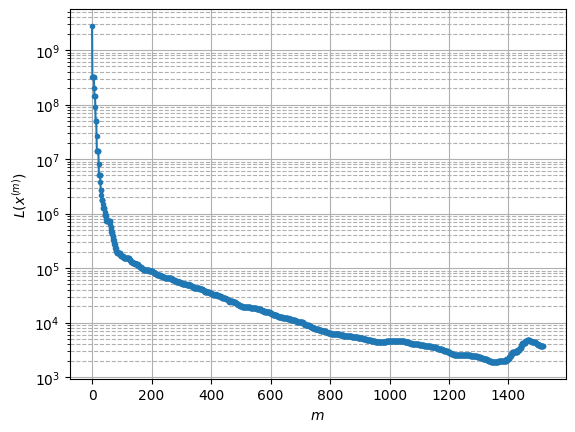

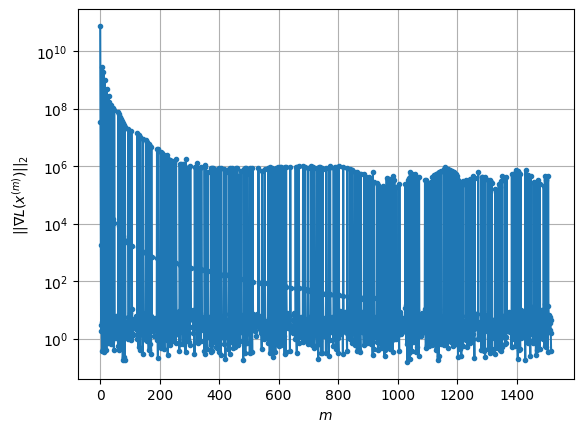

Windows:  48%|████▊     | 143/296 [1:05:28<50:15, 19.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3648.7923752649344
Gradient norm: 558345.1960563288
Global relative error: 81.69374468832802
Position relative errors: 0.04672402005456646 m, 56.51940857122094 m, 29.298687081792533 m, 51.19579104850649 m

Iteration 1
Cost function: 3581.034542641069 (-1.86%)
Gradient norm: 10.543019005107428 (-100.00%)
Global relative error = 81.32646701973472 (-0.45%)
Position relative errors: 0.04142817702380386 m, 56.390093512150976 m, 28.62599019050884 m, 51.1341612891093 m

Iteration 2
Cost function: 3581.0345424387315 (-0.00%)
Gradient norm: 6.262391136499302 (-40.60%)
Global relative error = 81.3264648338167 (-0.00%)
Position relative errors: 0.04142855204653965 m, 56.39009334389401 m, 28.6259843549327 m, 51.13416126463654 m

Iteration 3
Cost function: 3581.034542615267 (0.00%)
Gradient norm: 2.0804719900961053 (-66.78%)
Global relative error = 81.32646483375076 (-0.00%)
Position relative errors: 0.0414285495331

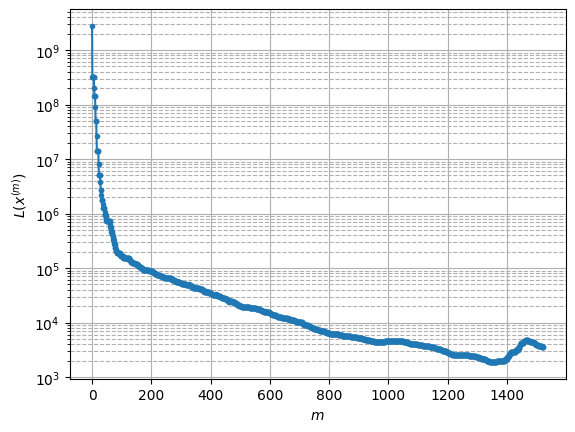

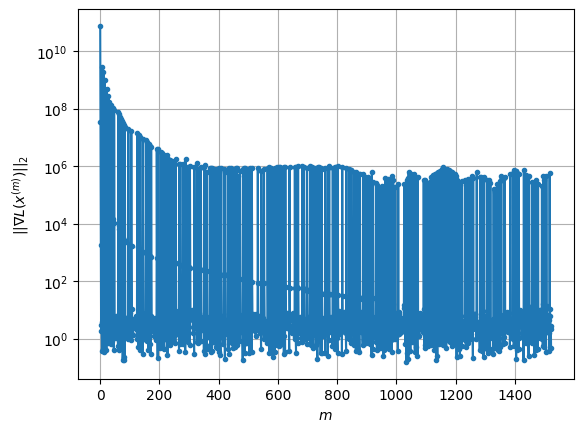

Windows:  49%|████▊     | 144/296 [1:05:44<46:47, 18.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3546.641979291529
Gradient norm: 540988.0692912136
Global relative error: 81.68408016704942
Position relative errors: 0.04115545941538124 m, 56.429536285249895 m, 28.850688178221247 m, 51.53282882221317 m

Iteration 1
Cost function: 3481.156460109136 (-1.85%)
Gradient norm: 12.657502546259037 (-100.00%)
Global relative error = 81.33187525389901 (-0.43%)
Position relative errors: 0.03923811462144788 m, 56.298295222352145 m, 28.218896955821936 m, 51.46909908829787 m

Iteration 2
Cost function: 3481.156459536078 (-0.00%)
Gradient norm: 5.718347634412618 (-54.82%)
Global relative error = 81.33187340168371 (-0.00%)
Position relative errors: 0.03923845570485226 m, 56.29829508395688 m, 28.218891942244625 m, 51.46909906132031 m

Iteration 3
Cost function: 3481.1564587702774 (-0.00%)
Gradient norm: 2.636033085277862 (-53.90%)
Global relative error = 81.33187340204562 (0.00%)
Position relative errors: 0.039238455

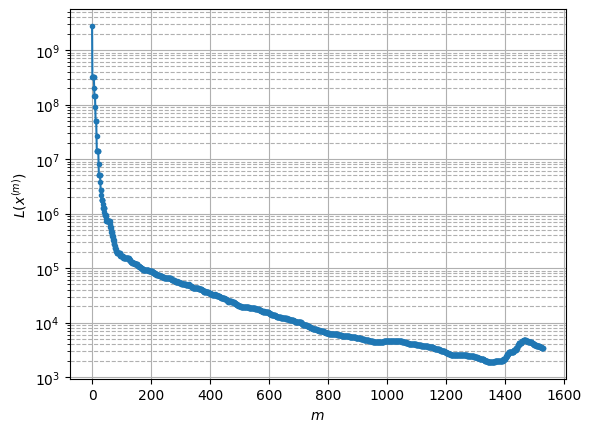

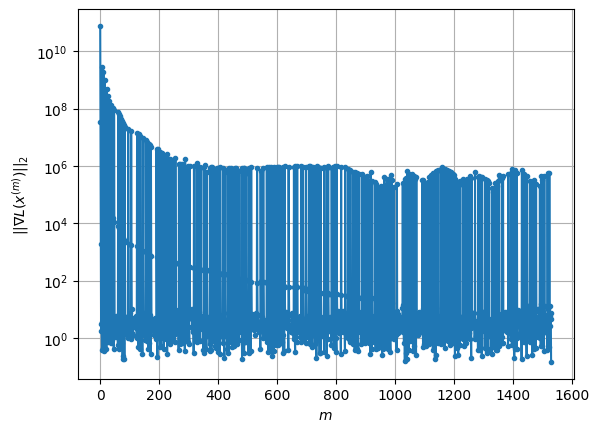

Windows:  49%|████▉     | 145/296 [1:06:01<45:42, 18.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3436.4811475757706
Gradient norm: 540399.8290010465
Global relative error: 81.34182490677468
Position relative errors: 0.038987738519907306 m, 56.09250914965513 m, 28.33997837516572 m, 51.64268547821227 m

Iteration 1
Cost function: 3375.126771541159 (-1.79%)
Gradient norm: 10.56755339860751 (-100.00%)
Global relative error = 81.00426040553576 (-0.41%)
Position relative errors: 0.037953321402920646 m, 55.96037510783801 m, 27.747156166718497 m, 51.57732511227708 m

STOP on Iteration 2
Cost function = 3375.126771548958 (0.00%)
Gradient norm = 0.3203930797088327 (-96.97%)
Global relative error = 81.00425878121791 (-0.00%)
Final position relative errors: 0.03795361950662748 m, 55.96037495900286 m, 27.74715177641127 m, 51.57732508434668 m

Majorization-Minimization converged after 1 iterations


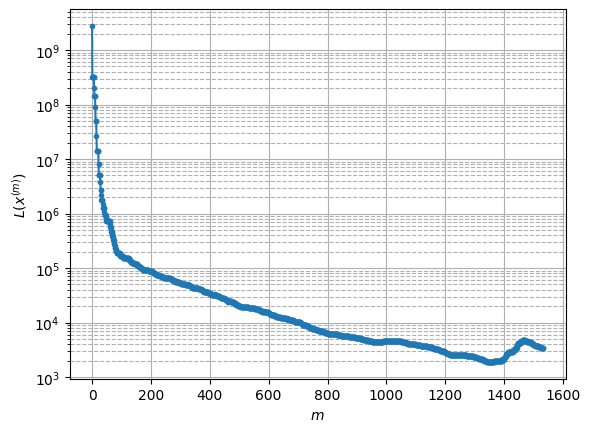

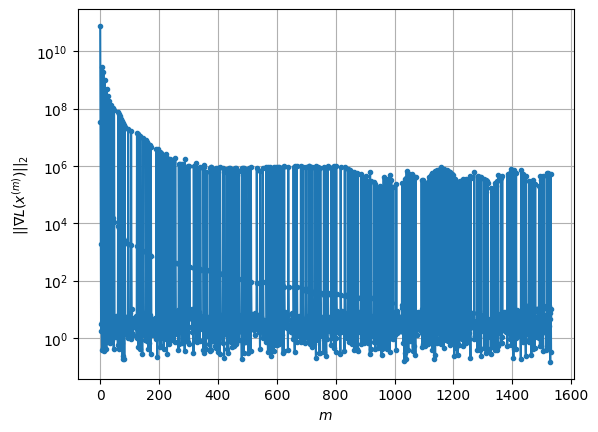

Windows:  49%|████▉     | 146/296 [1:06:09<37:46, 15.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3351.2214930352975
Gradient norm: 541869.6435061077
Global relative error: 80.66915787311797
Position relative errors: 0.03776551733780355 m, 55.51131653335164 m, 27.768304217532418 m, 51.525979062141005 m

Iteration 1
Cost function: 3293.997166312418 (-1.71%)
Gradient norm: 5.385515108912081 (-100.00%)
Global relative error = 80.3444502775818 (-0.40%)
Position relative errors: 0.04221684287521552 m, 55.37784731455525 m, 27.216473608477738 m, 51.45664577761674 m

STOP on Iteration 2
Cost function = 3293.9971660883225 (-0.00%)
Gradient norm = 0.36226459565284336 (-93.27%)
Global relative error = 80.34444876451525 (-0.00%)
Final position relative errors: 0.042217105486801736 m, 55.377847098421725 m, 27.216469639524995 m, 51.45664574676215 m

Majorization-Minimization converged after 1 iterations


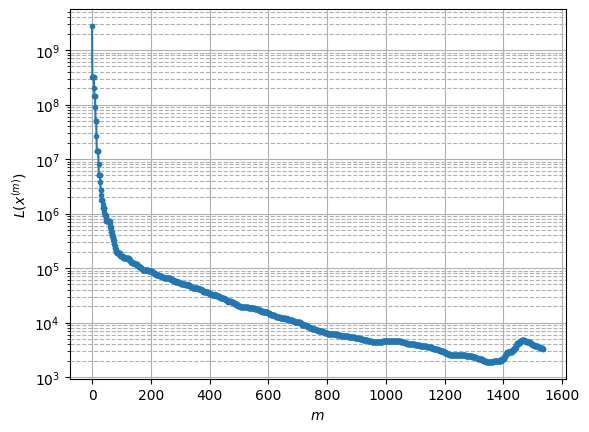

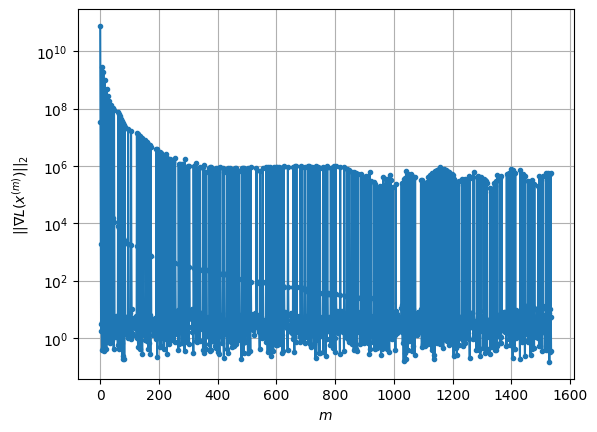

Windows:  50%|████▉     | 147/296 [1:06:17<32:07, 12.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3251.7475059822873
Gradient norm: 522460.1836981973
Global relative error: 79.66848223404423
Position relative errors: 0.041869948812226394 m, 54.688546276879535 m, 27.141673136381254 m, 51.18161348507911 m

Iteration 1
Cost function: 3198.3911562760277 (-1.64%)
Gradient norm: 8.847243352321714 (-100.00%)
Global relative error = 79.35973028049138 (-0.39%)
Position relative errors: 0.04244022323108382 m, 54.55715710351368 m, 26.631815081599772 m, 51.10995784195377 m

Iteration 2
Cost function: 3198.391156366005 (0.00%)
Gradient norm: 3.8725808725232005 (-56.23%)
Global relative error = 79.35972911858634 (-0.00%)
Position relative errors: 0.04244044331262359 m, 54.55715693277995 m, 26.631812025585894 m, 51.109957812295185 m

Iteration 3
Cost function: 3198.3911561897967 (-0.00%)
Gradient norm: 1.944561813415772 (-49.79%)
Global relative error = 79.35972911867518 (0.00%)
Position relative errors: 0.0424404

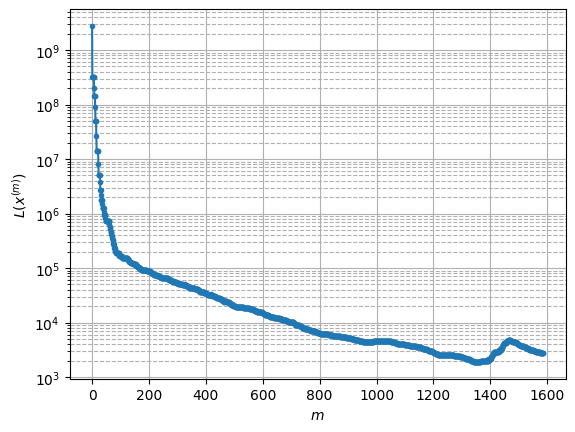

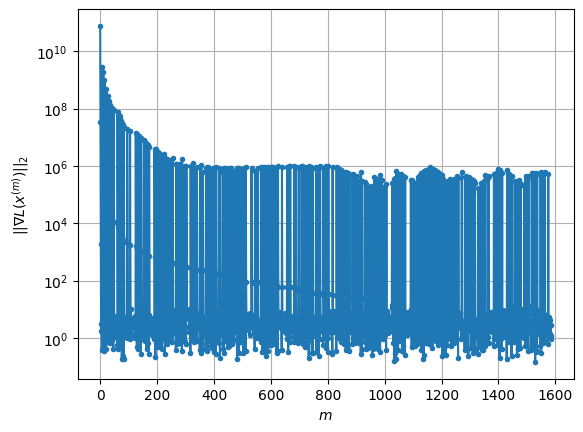

Windows:  52%|█████▏    | 154/296 [1:08:25<48:34, 20.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2713.467681994743
Gradient norm: 604938.1295118494
Global relative error: 64.17645271332718
Position relative errors: 0.042370519906930505 m, 42.82152547608829 m, 21.410214155453733 m, 42.73795094722701 m

Iteration 1
Cost function: 2678.2791474280934 (-1.30%)
Gradient norm: 2.7045067358238937 (-100.00%)
Global relative error = 63.97649745855534 (-0.31%)
Position relative errors: 0.03693532406763725 m, 42.746368740882616 m, 21.120553611570372 m, 42.65745582457772 m

STOP on Iteration 2
Cost function = 2678.2791480529854 (0.00%)
Gradient norm = 0.9933292571349213 (-63.27%)
Global relative error = 63.976497026230334 (-0.00%)
Final position relative errors: 0.036935416763510226 m, 42.74636862792365 m, 21.120552608503196 m, 42.657455785942425 m

Majorization-Minimization converged after 1 iterations


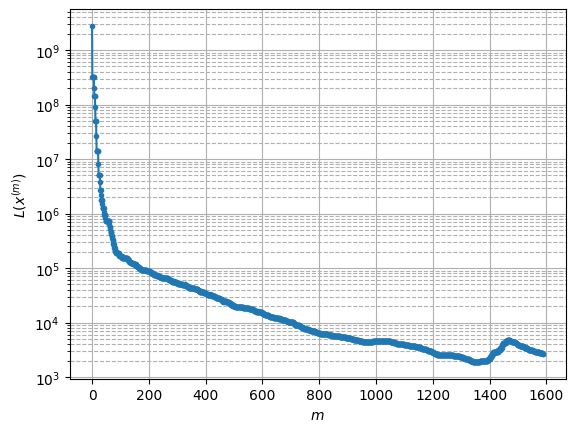

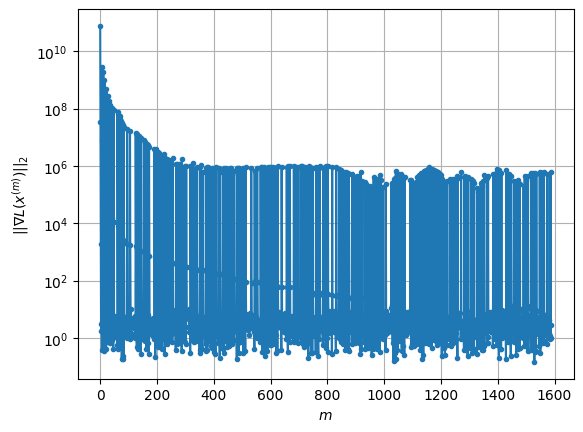

Windows:  52%|█████▏    | 155/296 [1:08:33<39:19, 16.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2621.5034753001323
Gradient norm: 442850.0761486257
Global relative error: 60.88146200212405
Position relative errors: 0.03611785648880469 m, 40.36765449602033 m, 20.417671202700344 m, 40.74456181748127 m

Iteration 1
Cost function: 2587.429275241561 (-1.30%)
Gradient norm: 4.771884721057775 (-100.00%)
Global relative error = 60.69979893291825 (-0.30%)
Position relative errors: 0.029148142757497365 m, 40.30586772350649 m, 20.152565472772935 m, 40.66660707512486 m

Iteration 2
Cost function: 2587.429274370123 (-0.00%)
Gradient norm: 1.5621036632050749 (-67.26%)
Global relative error = 60.69979856735088 (-0.00%)
Position relative errors: 0.029148211763458644 m, 40.30586762530757 m, 20.152564641438687 m, 40.666607038723875 m

Iteration 3
Cost function: 2587.4292741652325 (-0.00%)
Gradient norm: 2.519391524734496 (61.28%)
Global relative error = 60.699798566435604 (-0.00%)
Position relative errors: 0.029148

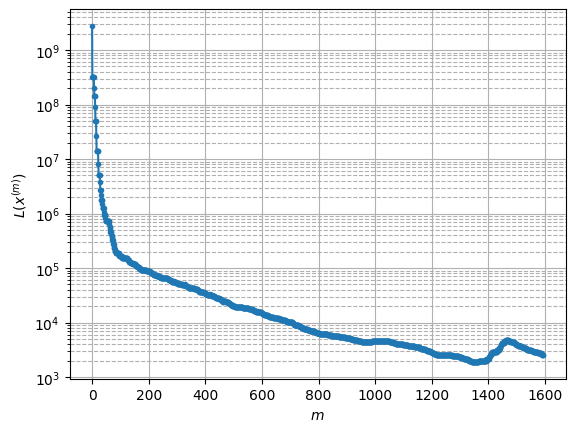

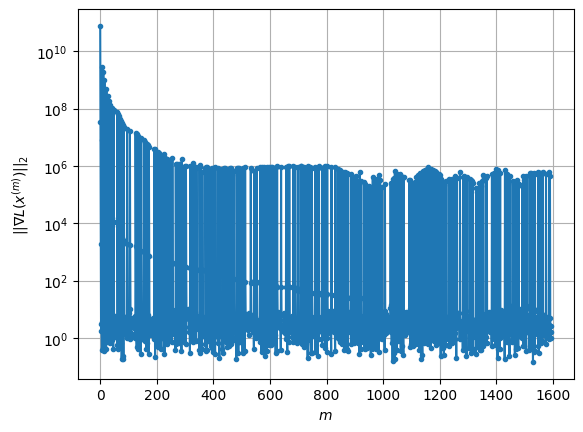

Windows:  53%|█████▎    | 156/296 [1:08:46<36:19, 15.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2538.3812604645823
Gradient norm: 483936.8507816662
Global relative error: 57.35962552433345
Position relative errors: 0.02839616183148874 m, 37.75781879286325 m, 19.390583615263314 m, 38.58075690491902 m

Iteration 1
Cost function: 2507.197059451335 (-1.23%)
Gradient norm: 6.596155842789324 (-100.00%)
Global relative error = 57.196304518965306 (-0.28%)
Position relative errors: 0.023273577136769048 m, 37.70432059581261 m, 19.156964017888896 m, 38.50724940043855 m

Iteration 2
Cost function: 2507.1970594420927 (-0.00%)
Gradient norm: 1.3570192483582633 (-79.43%)
Global relative error = 57.19630421404802 (-0.00%)
Position relative errors: 0.023273620102071 m, 37.70432051665656 m, 19.156963320714738 m, 38.507249371851415 m

STOP on Iteration 3
Cost function = 2507.1970577920897 (-0.00%)
Gradient norm = 0.6256826049921285 (-53.89%)
Global relative error = 57.19630421409877 (0.00%)
Final position relative e

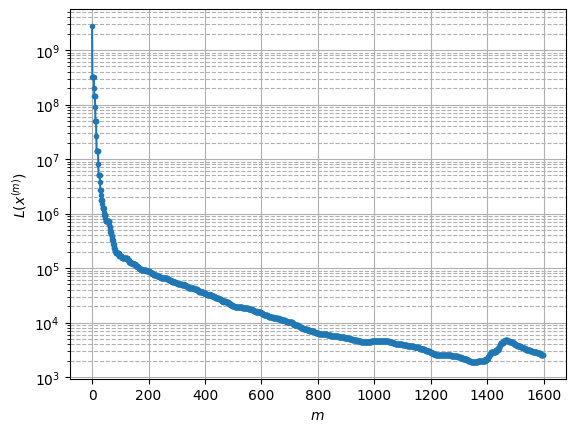

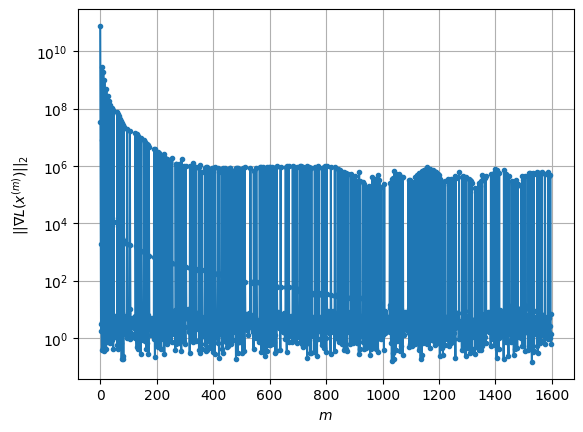

Windows:  53%|█████▎    | 157/296 [1:08:56<32:30, 14.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2437.9760609098985
Gradient norm: 480264.7581675388
Global relative error: 53.627665282999125
Position relative errors: 0.02221163307538644 m, 34.99862809625243 m, 18.340384937949718 m, 36.25808095206489 m

Iteration 1
Cost function: 2406.7004322860703 (-1.28%)
Gradient norm: 4.695466906980605 (-100.00%)
Global relative error = 53.483894038046785 (-0.27%)
Position relative errors: 0.017698424208827522 m, 34.95853657612477 m, 18.13233280267423 m, 36.18897618587124 m

Iteration 2
Cost function: 2406.7004302379382 (-0.00%)
Gradient norm: 2.8984964562786915 (-38.27%)
Global relative error = 53.48389378947435 (-0.00%)
Position relative errors: 0.017698407584003532 m, 34.95853650355877 m, 18.132332265661333 m, 36.188976157681324 m

Iteration 3
Cost function: 2406.700431414931 (0.00%)
Gradient norm: 1.3101940130554555 (-54.80%)
Global relative error = 53.483893787885926 (-0.00%)
Position relative errors: 0.017

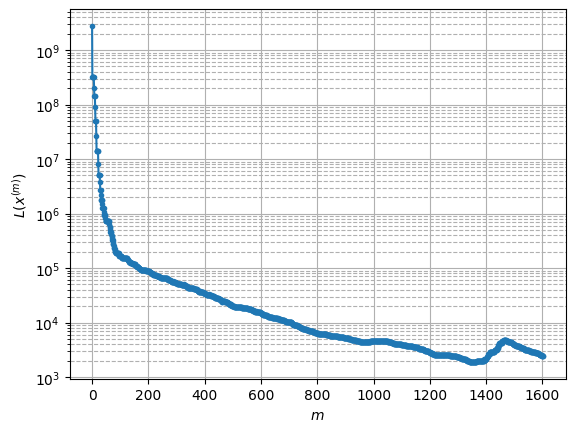

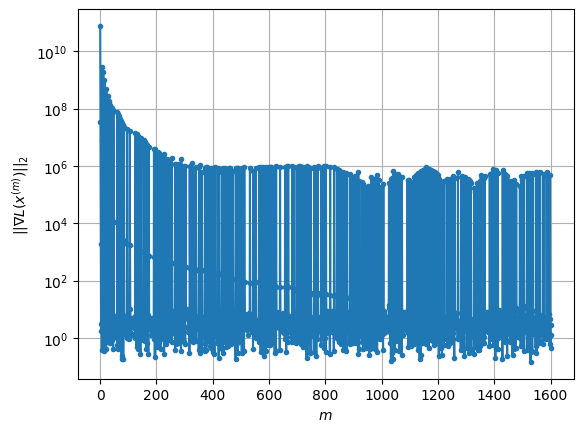

Windows:  53%|█████▎    | 158/296 [1:09:09<31:32, 13.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2339.1149877667995
Gradient norm: 340183.7448150904
Global relative error: 49.704657628722245
Position relative errors: 0.016468374648812092 m, 32.10761091977184 m, 17.265774191077234 m, 33.786724798123515 m

Iteration 1
Cost function: 2309.7862887891747 (-1.25%)
Gradient norm: 5.974652480153128 (-100.00%)
Global relative error = 49.58401629534041 (-0.24%)
Position relative errors: 0.013048414908458275 m, 32.08131641684321 m, 17.094604385886914 m, 33.721415472853046 m

Iteration 2
Cost function: 2309.7862850734705 (-0.00%)
Gradient norm: 1.4461118598757419 (-75.80%)
Global relative error = 49.584016129751305 (-0.00%)
Position relative errors: 0.013048394238790943 m, 32.08131632890973 m, 17.09460411995153 m, 33.72141544784947 m

STOP on Iteration 3
Cost function = 2309.7862852485287 (0.00%)
Gradient norm = 0.8631932223334959 (-40.31%)
Global relative error = 49.58401612921126 (-0.00%)
Final position rela

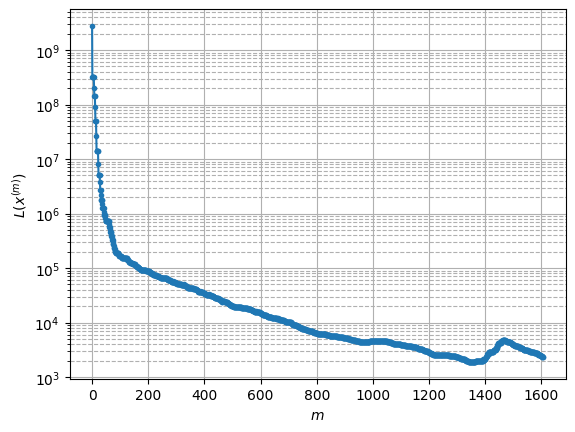

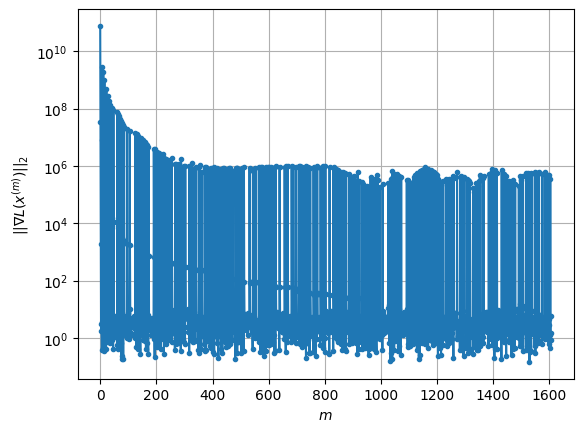

Windows:  54%|█████▎    | 159/296 [1:09:20<29:08, 12.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2241.617558765591
Gradient norm: 449850.35508138075
Global relative error: 45.613438224010956
Position relative errors: 0.01193732619823186 m, 29.098112542567634 m, 16.18235523094171 m, 31.177108524333093 m

Iteration 1
Cost function: 2213.192599863359 (-1.27%)
Gradient norm: 6.972081445902183 (-100.00%)
Global relative error = 45.517077906939754 (-0.21%)
Position relative errors: 0.016667388725753875 m, 29.083399065341133 m, 16.049203264684845 m, 31.11877849408299 m

Iteration 2
Cost function: 2213.1925996329906 (-0.00%)
Gradient norm: 2.348648977813742 (-66.31%)
Global relative error = 45.517077848725805 (-0.00%)
Position relative errors: 0.016667330182672 m, 29.08339898535101 m, 16.04920328720248 m, 31.11877847211251 m

STOP on Iteration 3
Cost function = 2213.1926013754496 (0.00%)
Gradient norm = 0.6569665678425249 (-72.03%)
Global relative error = 45.517077847465906 (-0.00%)
Final position relative

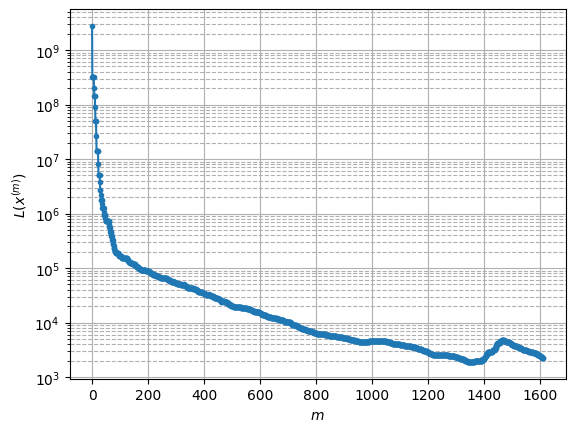

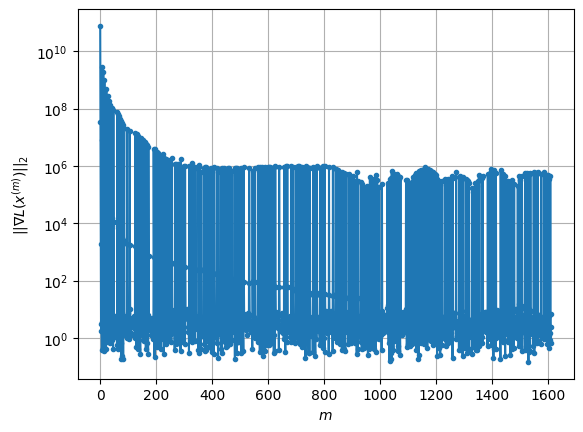

Windows:  54%|█████▍    | 160/296 [1:09:30<27:25, 12.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2173.5752623991325
Gradient norm: 265608.00338015
Global relative error: 41.37617261663295
Position relative errors: 0.015310801042579522 m, 25.981574731617112 m, 15.095526769897642 m, 28.444070323042016 m

Iteration 1
Cost function: 2148.114666470992 (-1.17%)
Gradient norm: 4.963693129668896 (-100.00%)
Global relative error = 41.300795187775584 (-0.18%)
Position relative errors: 0.01541929962571733 m, 25.97341799960864 m, 15.00448387855728 m, 28.390092707006342 m

STOP on Iteration 2
Cost function = 2148.1146676162325 (0.00%)
Gradient norm = 0.4614033281729598 (-90.70%)
Global relative error = 41.30079524405631 (0.00%)
Final position relative errors: 0.015419309553292678 m, 25.973417958076617 m, 15.00448414426695 m, 28.39009268644416 m

Majorization-Minimization converged after 1 iterations


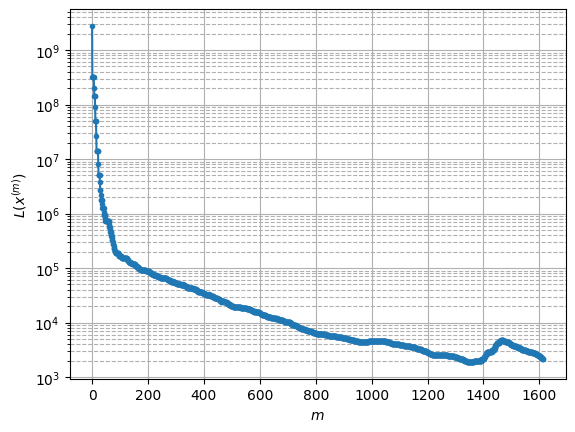

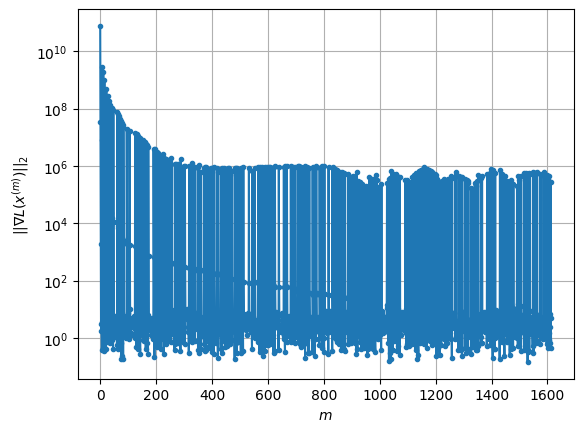

Windows:  54%|█████▍    | 161/296 [1:09:38<24:23, 10.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2090.871770554214
Gradient norm: 230245.14386129193
Global relative error: 37.01285696002463
Position relative errors: 0.014825723754186304 m, 22.767392459516937 m, 14.013392229783964 m, 25.597197745514467 m

Iteration 1
Cost function: 2066.2989654643284 (-1.18%)
Gradient norm: 4.558394863952182 (-100.00%)
Global relative error = 36.96358499801947 (-0.13%)
Position relative errors: 0.01895347766883815 m, 22.774667901724925 m, 13.955123741792443 m, 25.551317124255707 m

Iteration 2
Cost function: 2066.29896668138 (0.00%)
Gradient norm: 1.065944356630462 (-76.62%)
Global relative error = 36.96358515893195 (0.00%)
Position relative errors: 0.01895348480926954 m, 22.774667852643383 m, 13.955124279164453 m, 25.551317107291503 m

Iteration 3
Cost function: 2066.298965249215 (-0.00%)
Gradient norm: 2.6324435861884905 (146.96%)
Global relative error = 36.96358515939486 (0.00%)
Position relative errors: 0.018953

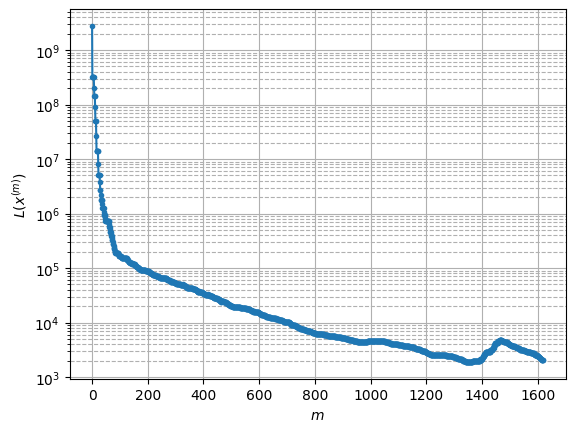

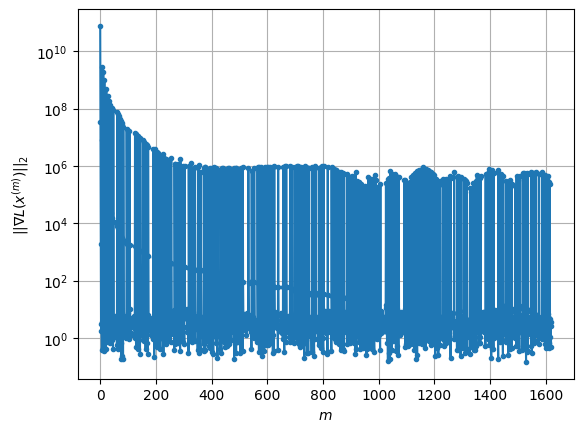

Windows:  55%|█████▍    | 162/296 [1:09:53<27:07, 12.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2034.8838048939874
Gradient norm: 375393.5157703613
Global relative error: 32.55535643130187
Position relative errors: 0.01842879961989575 m, 19.480162359171036 m, 12.930671602516997 m, 22.65316880751406 m

Iteration 1
Cost function: 2013.956966580499 (-1.03%)
Gradient norm: 5.444628392999079 (-100.00%)
Global relative error = 32.52418108221458 (-0.10%)
Position relative errors: 0.03264937868199759 m, 19.491970280162278 m, 12.912003008022294 m, 22.60882028291819 m

STOP on Iteration 2
Cost function = 2013.9569661199798 (-0.00%)
Gradient norm = 0.25794423439569575 (-95.26%)
Global relative error = 32.52418134869756 (0.00%)
Final position relative errors: 0.03264940031120253 m, 19.491970255947635 m, 12.91200373915814 m, 22.608820269562557 m

Majorization-Minimization converged after 1 iterations


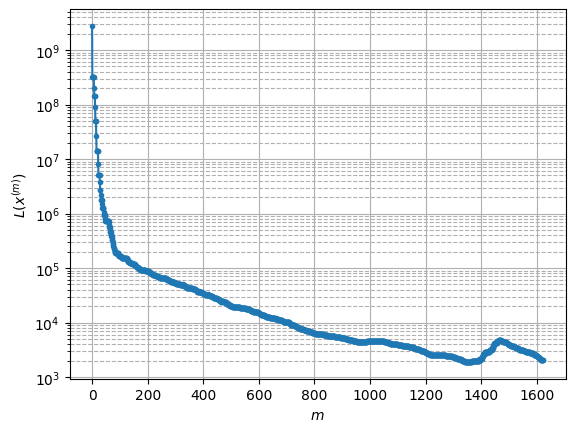

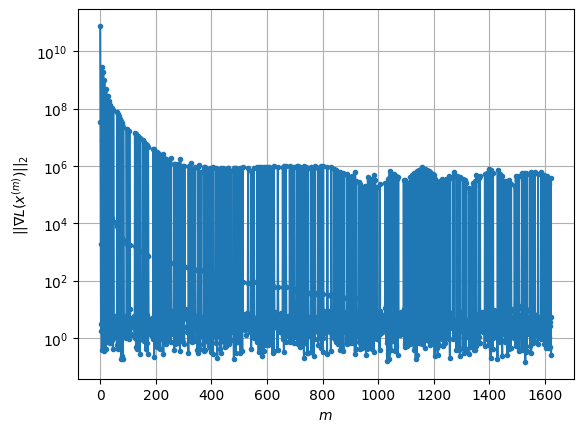

Windows:  55%|█████▌    | 163/296 [1:10:02<24:15, 10.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1985.9466455655188
Gradient norm: 247861.18478594837
Global relative error: 28.02792836156052
Position relative errors: 0.03184074249137149 m, 16.12583254428961 m, 11.857961642547316 m, 19.618967606275085 m

Iteration 1
Cost function: 1966.6496021685236 (-0.97%)
Gradient norm: 3.571234800666385 (-100.00%)
Global relative error = 28.02003566824539 (-0.03%)
Position relative errors: 0.030393791528337915 m, 16.146513259955697 m, 11.867365080971878 m, 19.584972069494473 m

STOP on Iteration 2
Cost function = 1966.6496008241782 (-0.00%)
Gradient norm = 0.7792090075163413 (-78.18%)
Global relative error = 28.02003599520619 (0.00%)
Final position relative errors: 0.03039380291878549 m, 16.1465132217824 m, 11.867365917429542 m, 19.5849720618849 m

Majorization-Minimization converged after 1 iterations


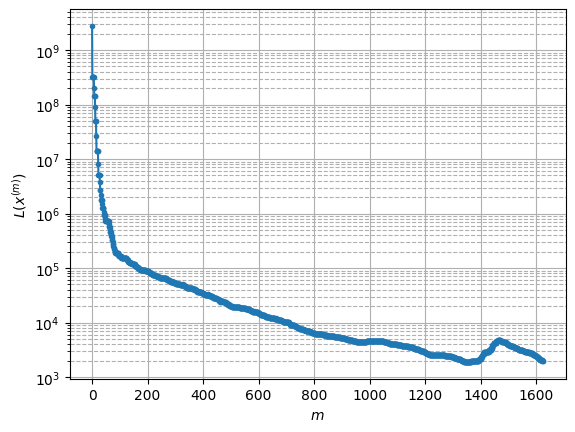

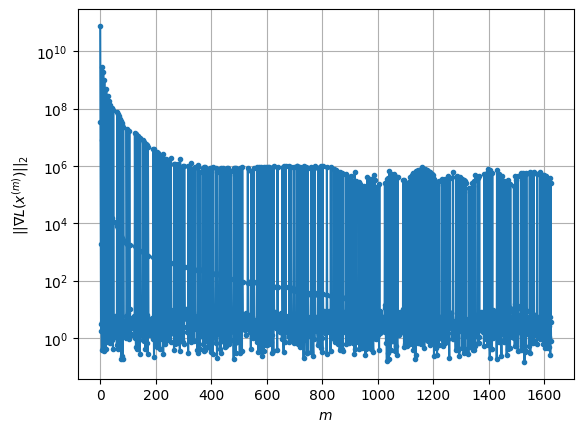

Windows:  55%|█████▌    | 164/296 [1:10:10<22:18, 10.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1929.9806432640269
Gradient norm: 203342.7195121622
Global relative error: 23.478723474632343
Position relative errors: 0.029641332290607225 m, 12.728984593506944 m, 10.787568259388552 m, 16.518005900119284 m

Iteration 1
Cost function: 1911.28236357292 (-0.97%)
Gradient norm: 10.757250588990619 (-99.99%)
Global relative error = 23.49746873688531 (0.08%)
Position relative errors: 0.011799128685266927 m, 12.757231320711327 m, 10.82427906145968 m, 16.49886615142976 m

Iteration 2
Cost function: 1911.2823623261609 (-0.00%)
Gradient norm: 6.400481995172437 (-40.50%)
Global relative error = 23.497469127367115 (0.00%)
Position relative errors: 0.011799096913121197 m, 12.75723127361685 m, 10.824279972106526 m, 16.49886614654736 m

Iteration 3
Cost function: 1911.282364311372 (0.00%)
Gradient norm: 1.1723696040605491 (-81.68%)
Global relative error = 23.49746912672959 (-0.00%)
Position relative errors: 0.011799

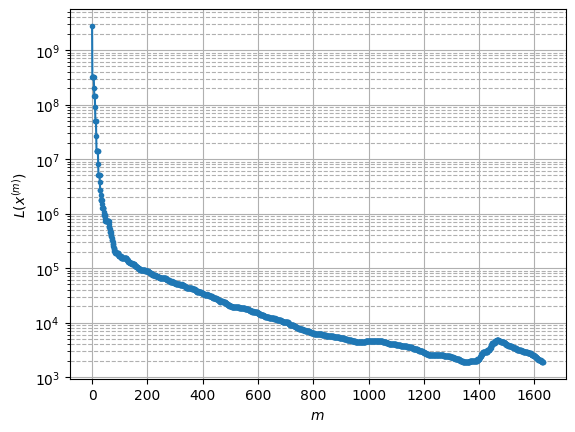

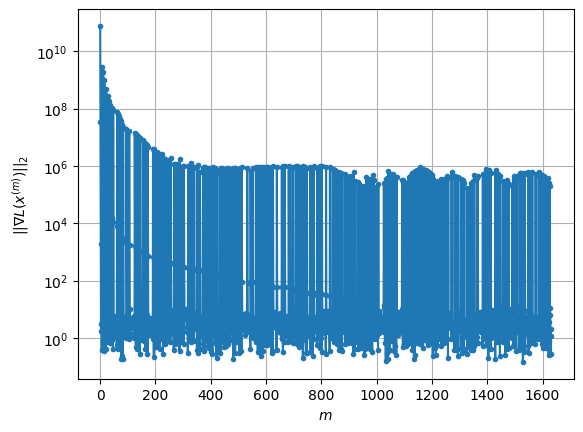

Windows:  56%|█████▌    | 165/296 [1:10:25<25:35, 11.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1881.1050553872367
Gradient norm: 361967.4031903713
Global relative error: 18.977151270232472
Position relative errors: 0.011066559948436768 m, 9.317274906599282 m, 9.722417052289515 m, 13.371184205679658 m

Iteration 1
Cost function: 1863.2080176181555 (-0.95%)
Gradient norm: 3.8871024166036827 (-100.00%)
Global relative error = 19.023026701752155 (0.24%)
Position relative errors: 0.007143354562025794 m, 9.352303969663156 m, 9.779633134501005 m, 13.37019594270723 m

Iteration 2
Cost function: 1863.208017727791 (0.00%)
Gradient norm: 6.181430528841928 (59.02%)
Global relative error = 19.02302718242271 (0.00%)
Position relative errors: 0.007143310557677282 m, 9.352303940150012 m, 9.7796341089321 m, 13.370195934524117 m

STOP on Iteration 3
Cost function = 1863.208017456671 (-0.00%)
Gradient norm = 0.24248218013676592 (-96.08%)
Global relative error = 19.023027180140396 (-0.00%)
Final position relative er

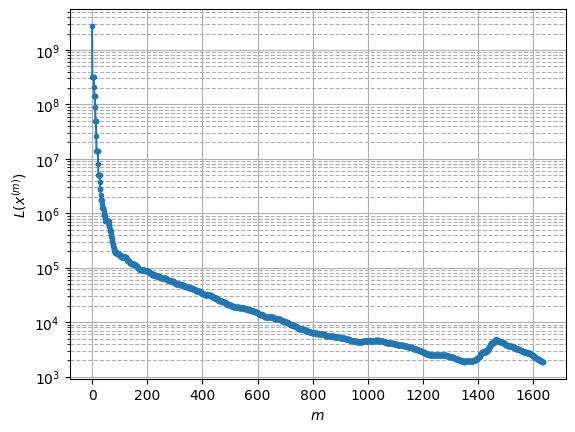

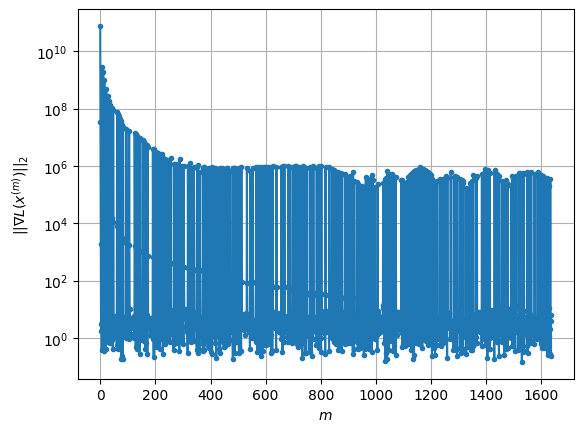

Windows:  56%|█████▌    | 166/296 [1:10:36<24:38, 11.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1862.258152393217
Gradient norm: 492804.5925464113
Global relative error: 14.645885163276034
Position relative errors: 0.0060920392514928175 m, 5.950676469336216 m, 8.659237865295166 m, 10.203050880356063 m

STOP on Iteration 1
Cost function = 1807.522409015444 (-0.83%)
Gradient norm = 0.7355392333556563 (-100.00%)
Global relative error = 18.121295280334 (-0.27%)
Final position relative errors: 0.003857974855707517 m, 15.210199705127058 m, 2.4996348959836316 m, 9.527677163937597 m

Majorization-Minimization converged after 1 iterations


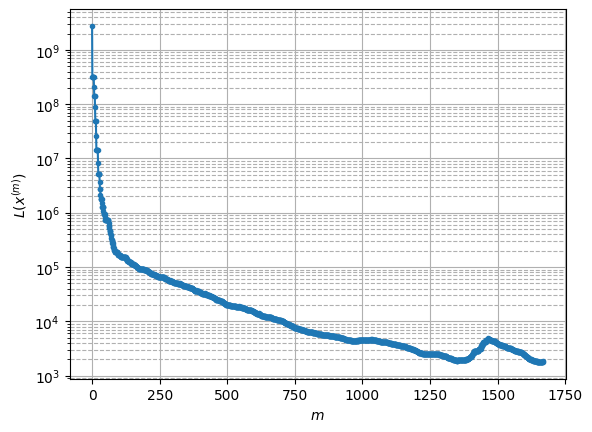

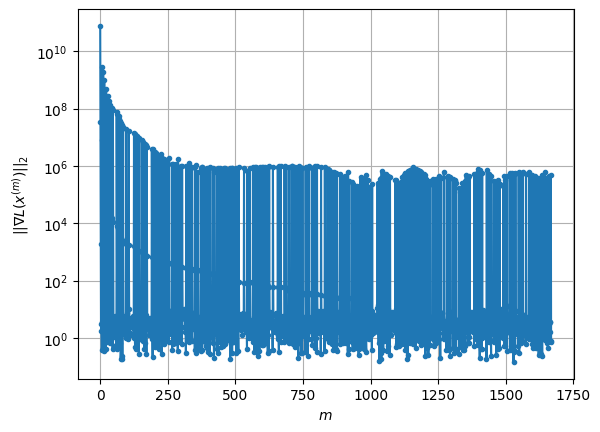

Windows:  58%|█████▊    | 173/296 [1:12:02<22:26, 10.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1816.482152930203
Gradient norm: 421181.82024212054
Global relative error: 22.45594488660832
Position relative errors: 0.003343545510151433 m, 18.52011509282658 m, 1.3527827105064227 m, 12.626901192402691 m

Iteration 1
Cost function: 1803.0443729506055 (-0.74%)
Gradient norm: 3.420530437126609 (-100.00%)
Global relative error = 22.39021621550383 (-0.29%)
Position relative errors: 0.0036860199966212417 m, 18.452300439194318 m, 1.4953346644862344 m, 12.593341404410998 m

STOP on Iteration 2
Cost function = 1803.0443749738042 (0.00%)
Gradient norm = 0.3744950883116703 (-89.05%)
Global relative error = 22.390216277049866 (0.00%)
Final position relative errors: 0.0036860542085473216 m, 18.45230043397314 m, 1.4953355341882375 m, 12.59334141820901 m

Majorization-Minimization converged after 1 iterations


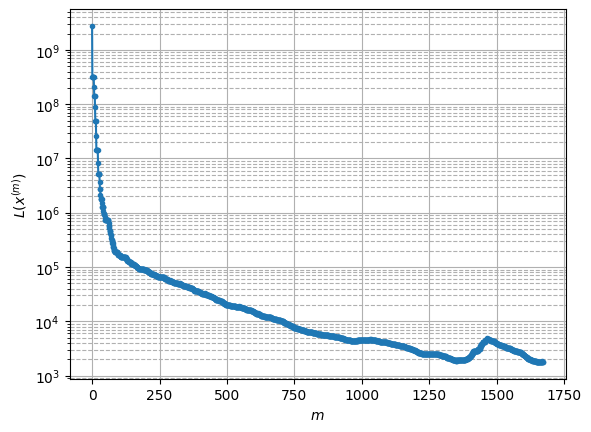

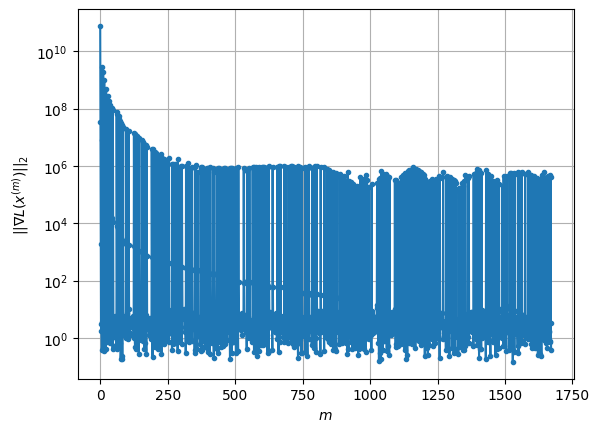

Windows:  59%|█████▉    | 174/296 [1:12:10<20:32, 10.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1817.3323696885511
Gradient norm: 586599.9528570782
Global relative error: 26.749885765411985
Position relative errors: 0.004552006259359786 m, 21.684642114282415 m, 0.42291837097206 m, 15.657201575317925 m

Iteration 1
Cost function: 1803.4017454617067 (-0.77%)
Gradient norm: 3.399791228903639 (-100.00%)
Global relative error = 26.667260573358575 (-0.31%)
Position relative errors: 0.009927048875671552 m, 21.612932149970632 m, 0.5719244282046702 m, 15.610603374399195 m

Iteration 2
Cost function: 1803.401744451036 (-0.00%)
Gradient norm: 3.955617499342469 (16.35%)
Global relative error = 26.667260605243634 (0.00%)
Position relative errors: 0.009927063238417405 m, 21.612932162764185 m, 0.5719252319227021 m, 15.610603381700788 m

Iteration 3
Cost function: 1803.4017450232143 (0.00%)
Gradient norm: 3.6579178224619966 (-7.53%)
Global relative error = 26.667260605130267 (-0.00%)
Position relative errors: 0.0

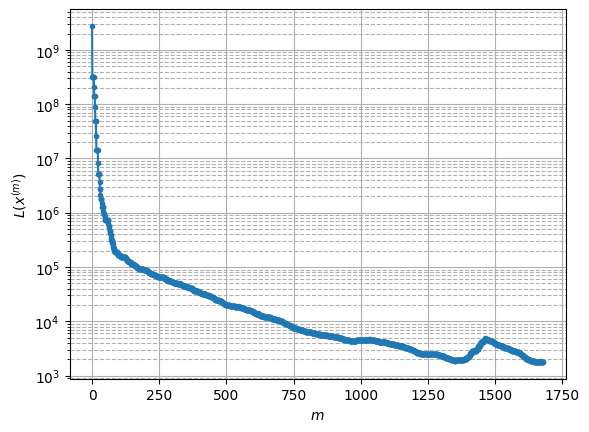

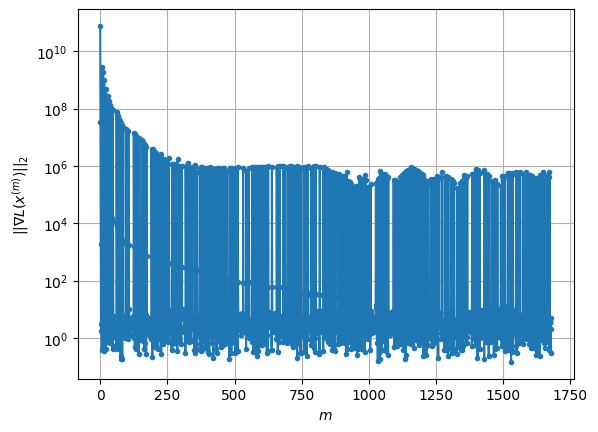

Windows:  59%|█████▉    | 175/296 [1:12:28<25:14, 12.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1812.96314201972
Gradient norm: 515351.40108625335
Global relative error: 30.978851027623232
Position relative errors: 0.010621721739588814 m, 24.750586090011147 m, 0.7548336826589962 m, 18.615109402765743 m

Iteration 1
Cost function: 1799.618084532413 (-0.74%)
Gradient norm: 1.0407770064540713 (-100.00%)
Global relative error = 30.884301456866293 (-0.31%)
Position relative errors: 0.016991596177384993 m, 24.676066770457762 m, 0.6688144442809559 m, 18.56013776820963 m

Iteration 2
Cost function: 1799.6180868306944 (0.00%)
Gradient norm: 2.585013171282728 (148.37%)
Global relative error = 30.8843014473491 (-0.00%)
Position relative errors: 0.016991589151562625 m, 24.676066775031487 m, 0.6688140054939204 m, 18.560137762110696 m

Iteration 3
Cost function: 1799.6180847044689 (-0.00%)
Gradient norm: 2.0443811011135025 (-20.91%)
Global relative error = 30.884301447161036 (-0.00%)
Position relative errors: 0

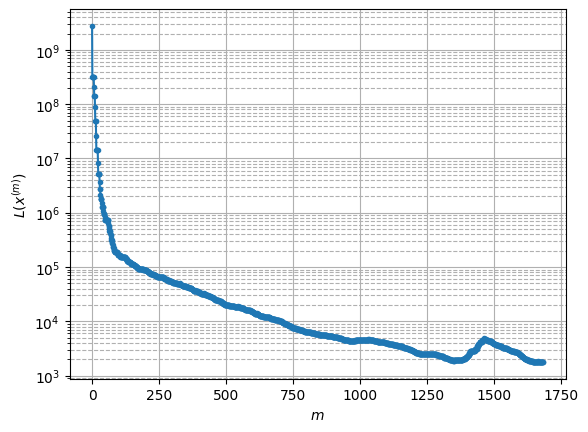

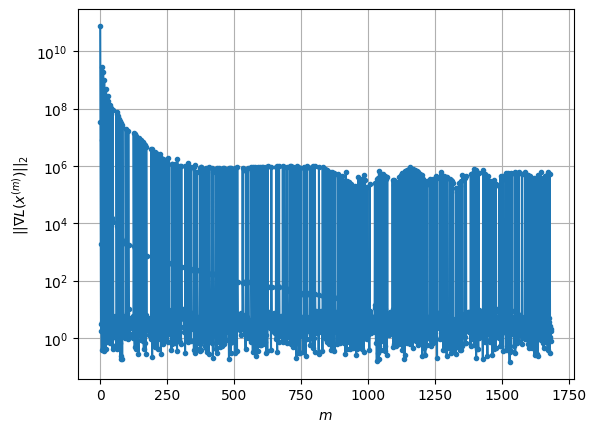

Windows:  59%|█████▉    | 176/296 [1:12:44<26:45, 13.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1815.128048012691
Gradient norm: 499368.211111313
Global relative error: 35.10144908904406
Position relative errors: 0.016783507123545146 m, 27.703887636481216 m, 1.703912204446167 m, 21.48714936644076 m

Iteration 1
Cost function: 1801.4323548362654 (-0.75%)
Gradient norm: 2.1561884748491713 (-100.00%)
Global relative error = 34.995763968752165 (-0.30%)
Position relative errors: 0.014399163891361155 m, 27.62250592785944 m, 1.5806632734369328 m, 21.428878399636595 m

Iteration 2
Cost function: 1801.4323546380551 (-0.00%)
Gradient norm: 3.38459584050268 (56.97%)
Global relative error = 34.99576393146526 (-0.00%)
Position relative errors: 0.014399160424021123 m, 27.62250591005449 m, 1.5806626941328445 m, 21.428878404428108 m

Iteration 3
Cost function: 1801.432353714385 (-0.00%)
Gradient norm: 1.8455776427549386 (-45.47%)
Global relative error = 34.99576393070568 (-0.00%)
Position relative errors: 0.01439

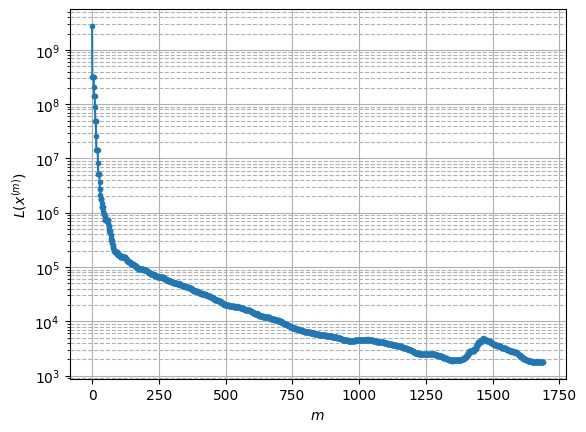

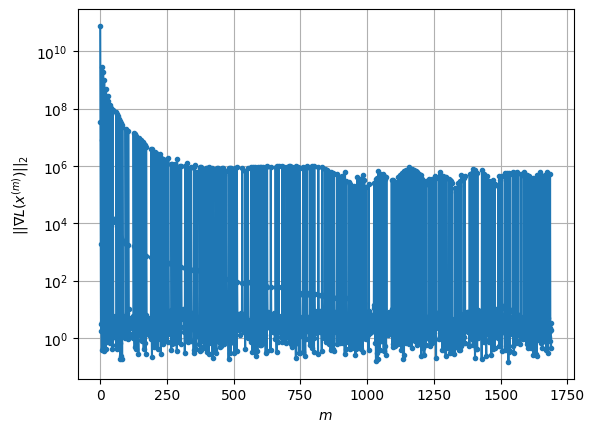

Windows:  60%|█████▉    | 177/296 [1:12:56<26:11, 13.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1800.012958110789
Gradient norm: 519886.6387531915
Global relative error: 39.08508154968598
Position relative errors: 0.014127360621188512 m, 30.527886082689804 m, 2.6579924856433474 m, 24.261531004460124 m

STOP on Iteration 1
Cost function = 1787.4923063629803 (-0.70%)
Gradient norm = 0.8024095002538978 (-100.00%)
Global relative error = 38.973504996681164 (-0.29%)
Final position relative errors: 0.016926275734470312 m, 30.44662422381597 m, 2.5201248349756695 m, 24.19878321913736 m

Majorization-Minimization converged after 1 iterations


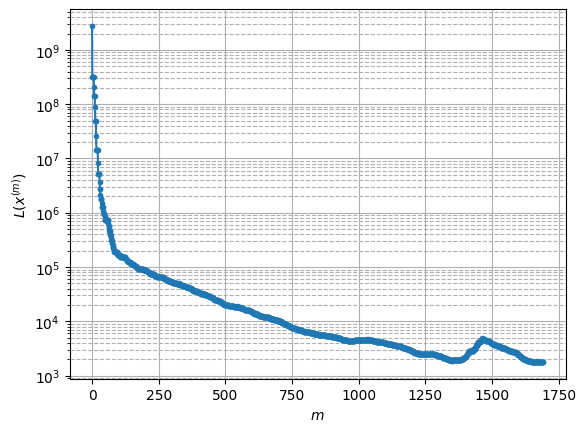

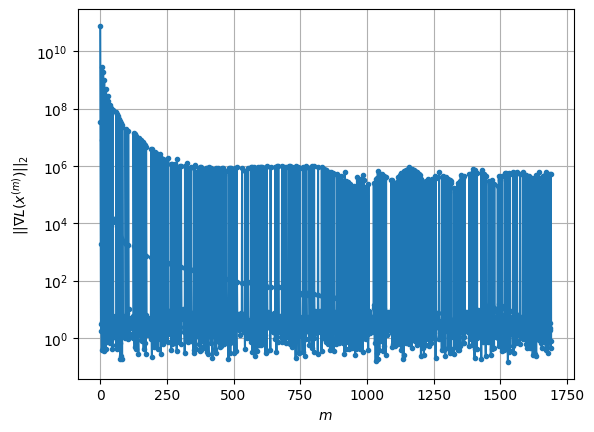

Windows:  60%|██████    | 178/296 [1:13:02<21:24, 10.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1797.3142869960905
Gradient norm: 604189.3636149524
Global relative error: 42.90805475286999
Position relative errors: 0.01663719243553452 m, 33.21639123044705 m, 3.5918241679564984 m, 26.923348416647936 m

Iteration 1
Cost function: 1784.6042188150202 (-0.71%)
Gradient norm: 1.216667330381705 (-100.00%)
Global relative error = 42.78979140024845 (-0.28%)
Position relative errors: 0.024637854558669302 m, 33.13453032041412 m, 3.440758545352953 m, 26.855639855121865 m

STOP on Iteration 2
Cost function = 1784.6042199047354 (0.00%)
Gradient norm = 0.3139133140278766 (-74.20%)
Global relative error = 42.789791314973506 (-0.00%)
Final position relative errors: 0.024637856505787543 m, 33.13453028868638 m, 3.440757860083014 m, 26.855639846192464 m

Majorization-Minimization converged after 1 iterations


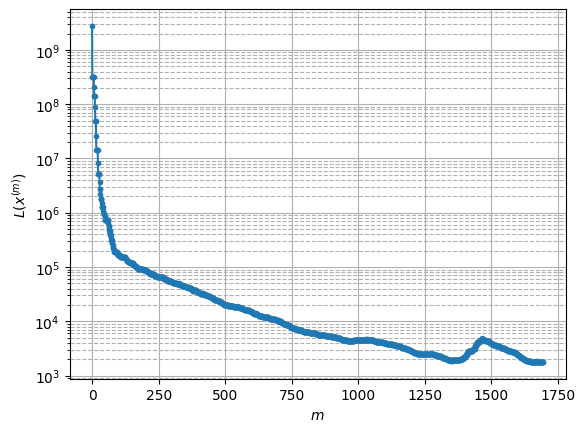

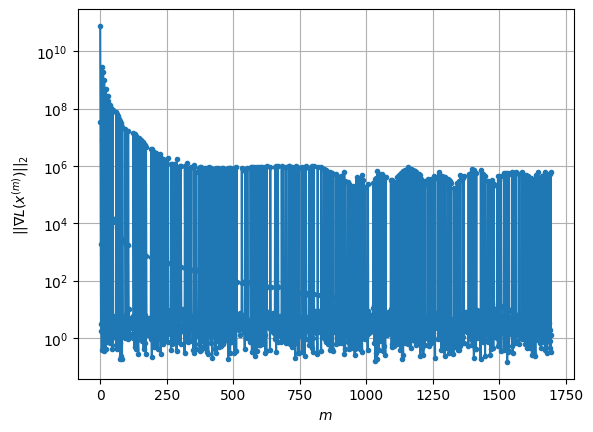

Windows:  60%|██████    | 179/296 [1:13:10<19:35, 10.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1781.1022118428116
Gradient norm: 468625.0193645342
Global relative error: 46.54722695361038
Position relative errors: 0.023509786128356344 m, 35.756671079002274 m, 4.4979588478394295 m, 29.45961136352499 m

STOP on Iteration 1
Cost function = 1768.9096230780722 (-0.68%)
Gradient norm = 0.6041315138265254 (-100.00%)
Global relative error = 46.423671563829785 (-0.27%)
Final position relative errors: 0.025918261629455614 m, 35.67334348545729 m, 4.334797737006631 m, 29.390045883982346 m

Majorization-Minimization converged after 1 iterations


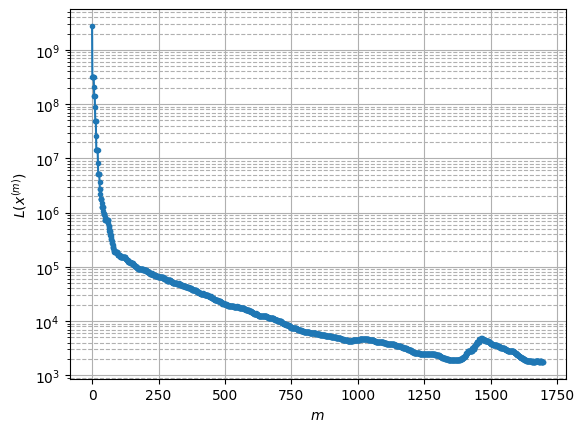

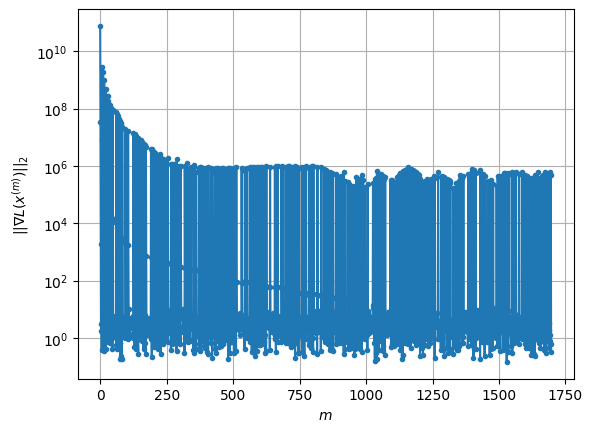

Windows:  61%|██████    | 180/296 [1:13:16<16:54,  8.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1764.9947644847823
Gradient norm: 457881.27988430427
Global relative error: 49.98452569460384
Position relative errors: 0.024599394226172976 m, 38.136620722224016 m, 5.3733177728101404 m, 31.8618005009555 m

Iteration 1
Cost function: 1753.1580564731846 (-0.67%)
Gradient norm: 2.7836711036293997 (-100.00%)
Global relative error = 49.85739384216545 (-0.25%)
Position relative errors: 0.02297508320532518 m, 38.05345654272417 m, 5.205236607309995 m, 31.78986749633034 m

Iteration 2
Cost function: 1753.1580575802923 (0.00%)
Gradient norm: 2.460790041540694 (-11.60%)
Global relative error = 49.85739374208069 (-0.00%)
Position relative errors: 0.022975063893112647 m, 38.053456527726055 m, 5.205235898936329 m, 31.78986747331878 m

Iteration 3
Cost function: 1753.1580568047646 (-0.00%)
Gradient norm: 1.7870066385306183 (-27.38%)
Global relative error = 49.85739374209029 (0.00%)
Position relative errors: 0.022975

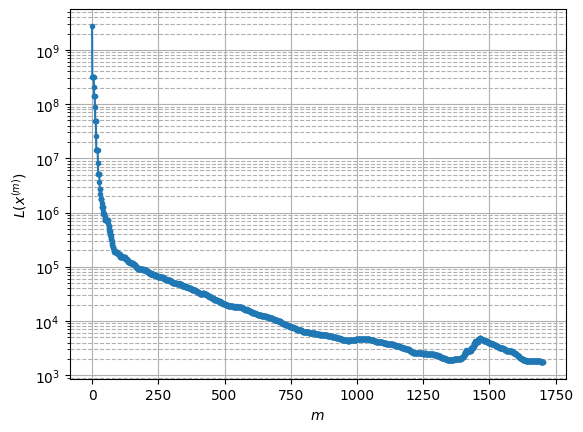

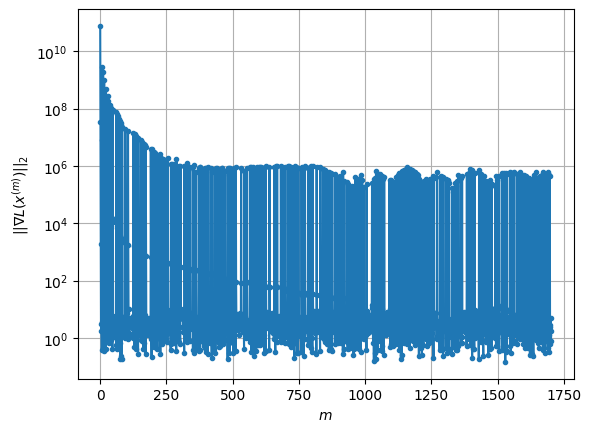

Windows:  61%|██████    | 181/296 [1:13:31<20:31, 10.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1733.1933402422494
Gradient norm: 405315.3495654715
Global relative error: 53.2041089946755
Position relative errors: 0.021836491040512163 m, 40.347494556240335 m, 6.220145831862729 m, 34.11836969582139 m

Iteration 1
Cost function: 1720.4565592740507 (-0.73%)
Gradient norm: 1.4694313155057408 (-100.00%)
Global relative error = 53.075622465122485 (-0.24%)
Position relative errors: 0.028503774620727007 m, 40.26109198435352 m, 6.058983118806863 m, 34.04924433815448 m

STOP on Iteration 2
Cost function = 1720.4565582704074 (-0.00%)
Gradient norm = 0.7839199333656508 (-46.65%)
Global relative error = 53.0756223446816 (-0.00%)
Final position relative errors: 0.028503780493240205 m, 40.261091971271235 m, 6.058982410965827 m, 34.04924429183527 m

Majorization-Minimization converged after 1 iterations


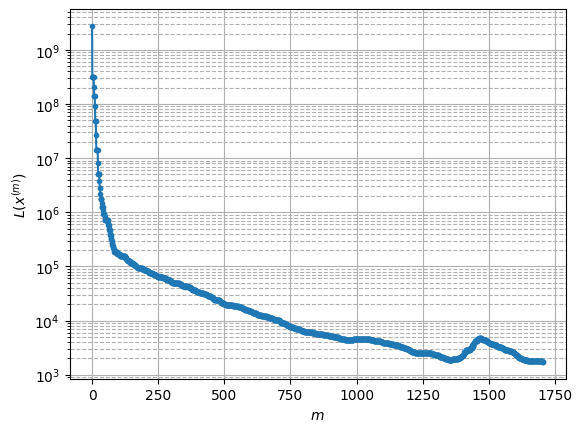

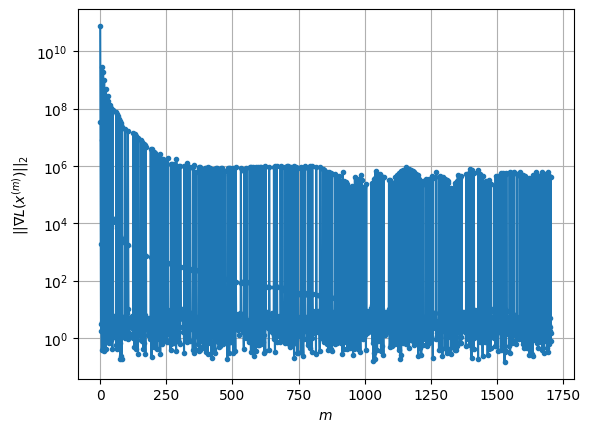

Windows:  61%|██████▏   | 182/296 [1:13:39<18:52,  9.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1701.499630508858
Gradient norm: 442477.2676107639
Global relative error: 56.192399711458144
Position relative errors: 0.027118290435069917 m, 42.37642533887929 m, 7.043732145430436 m, 36.22439555769094 m

Iteration 1
Cost function: 1689.6758416904372 (-0.69%)
Gradient norm: 1.4031112398511145 (-100.00%)
Global relative error = 56.063578028751834 (-0.23%)
Position relative errors: 0.027369842816705705 m, 42.28955667611849 m, 6.8780264234523845 m, 36.15809122761112 m

Iteration 2
Cost function: 1689.6758439685827 (0.00%)
Gradient norm: 3.954155551585825 (181.81%)
Global relative error = 56.06357789997357 (-0.00%)
Position relative errors: 0.027369845316558054 m, 42.289556665226534 m, 6.878025679237449 m, 36.15809118224122 m

STOP on Iteration 3
Cost function = 1689.6758429207628 (-0.00%)
Gradient norm = 0.8902411261340144 (-77.49%)
Global relative error = 56.063577899439785 (-0.00%)
Final position relati

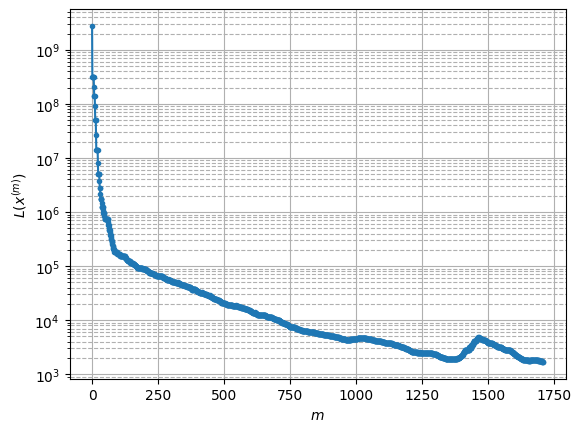

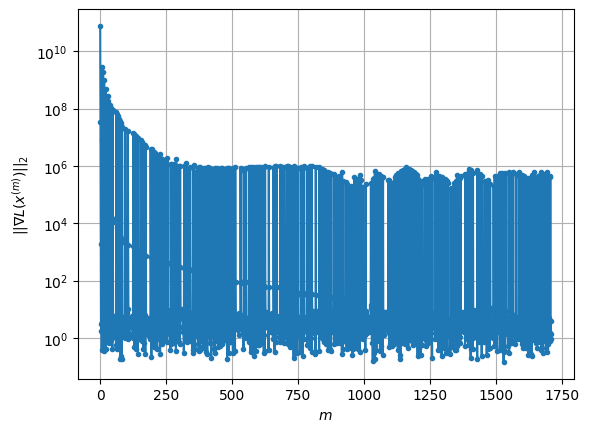

Windows:  62%|██████▏   | 183/296 [1:13:49<18:58, 10.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1652.3166189428196
Gradient norm: 353376.0806439168
Global relative error: 58.936307856582935
Position relative errors: 0.02604451649090078 m, 44.21754067398953 m, 7.830460636253928 m, 38.17038734988432 m

Iteration 1
Cost function: 1640.034536117566 (-0.74%)
Gradient norm: 1.8750848446084951 (-100.00%)
Global relative error = 58.80869745679626 (-0.22%)
Position relative errors: 0.02067612127395093 m, 44.13145772465055 m, 7.666033100082066 m, 38.106516951307874 m

Iteration 2
Cost function: 1640.0345366320703 (0.00%)
Gradient norm: 1.2203586632929095 (-34.92%)
Global relative error = 58.80869731331273 (-0.00%)
Position relative errors: 0.020676123026547255 m, 44.13145769637987 m, 7.666032397020844 m, 38.10651690405098 m

Iteration 3
Cost function: 1640.034535432432 (-0.00%)
Gradient norm: 2.2881770671945065 (87.50%)
Global relative error = 58.808697313226276 (-0.00%)
Position relative errors: 0.02067612

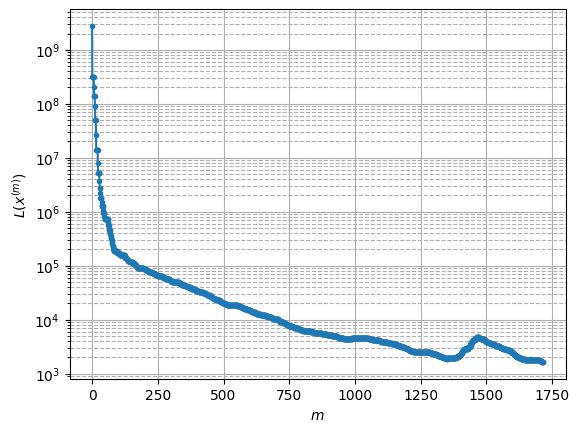

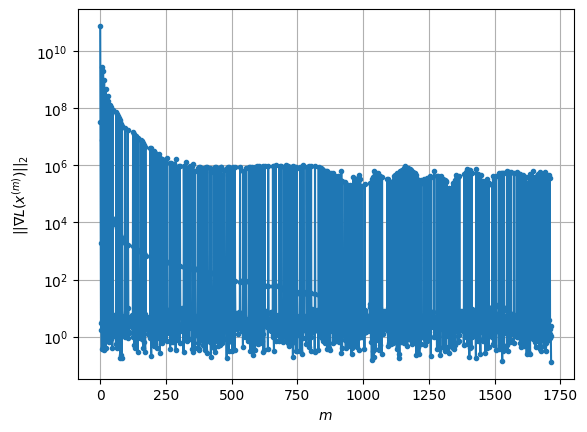

Windows:  62%|██████▏   | 184/296 [1:14:04<21:32, 11.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1607.3413145505374
Gradient norm: 341829.1704306384
Global relative error: 61.424702417617844
Position relative errors: 0.019617938765349324 m, 45.864298715833826 m, 8.582752544745508 m, 39.94739436308608 m

Iteration 1
Cost function: 1595.9605770571698 (-0.71%)
Gradient norm: 1.108928027129636 (-100.00%)
Global relative error = 61.298405901038514 (-0.21%)
Position relative errors: 0.01636514452394477 m, 45.7793922144022 m, 8.416293527194963 m, 39.886159597948996 m

Iteration 2
Cost function: 1595.9605752462974 (-0.00%)
Gradient norm: 3.636806117350923 (227.96%)
Global relative error = 61.298405747354565 (-0.00%)
Position relative errors: 0.01636514644095582 m, 45.77939217160717 m, 8.416292861701086 m, 39.88615955130403 m

Iteration 3
Cost function: 1595.9605772488003 (0.00%)
Gradient norm: 4.653483528272908 (27.96%)
Global relative error = 61.2984057474253 (0.00%)
Position relative errors: 0.0163651438

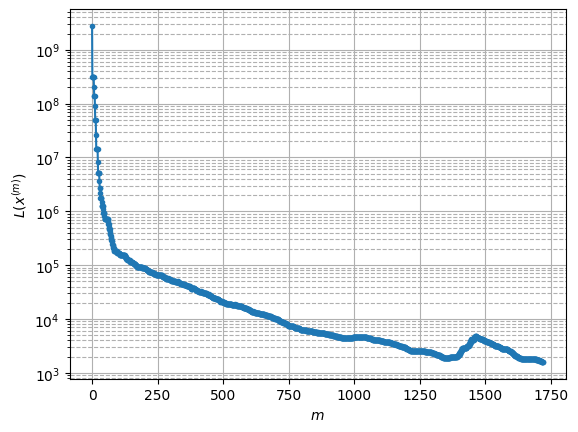

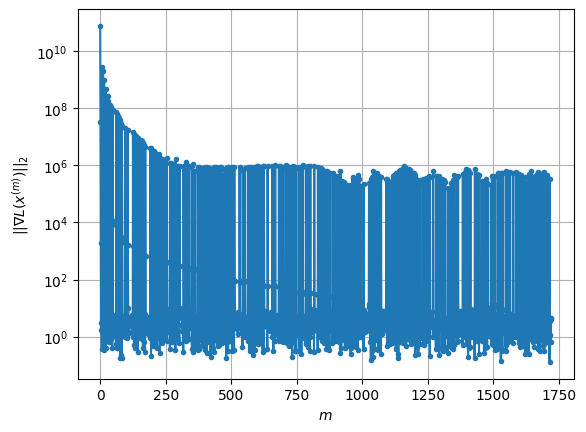

Windows:  62%|██████▎   | 185/296 [1:14:20<23:25, 12.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1560.5062199621698
Gradient norm: 289082.6196850196
Global relative error: 63.646552489378955
Position relative errors: 0.01559528097326476 m, 47.310138409425655 m, 9.295168409879674 m, 41.54795522133474 m

Iteration 1
Cost function: 1548.741982896524 (-0.75%)
Gradient norm: 1.0539167842280213 (-100.00%)
Global relative error = 63.522305314676515 (-0.20%)
Position relative errors: 0.03546605140380586 m, 47.22692213815492 m, 9.126972973891286 m, 41.48971851503804 m

Iteration 2
Cost function: 1548.7419820471564 (-0.00%)
Gradient norm: 4.020583660847902 (281.49%)
Global relative error = 63.52230516638489 (-0.00%)
Position relative errors: 0.03546605961270933 m, 47.22692209733468 m, 9.126972376392816 m, 41.48971846589453 m

Iteration 3
Cost function: 1548.7419809181094 (-0.00%)
Gradient norm: 1.81632073741715 (-54.82%)
Global relative error = 63.52230516697908 (0.00%)
Position relative errors: 0.0354660484

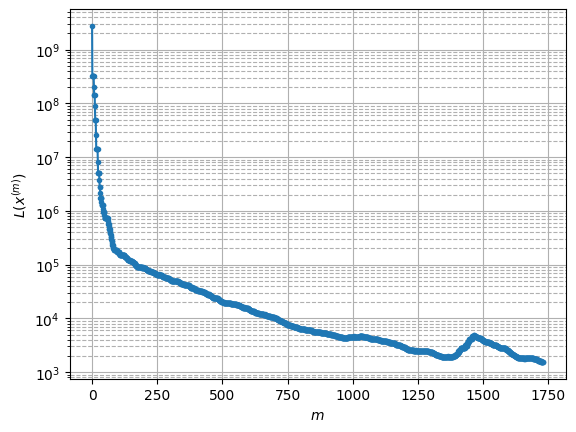

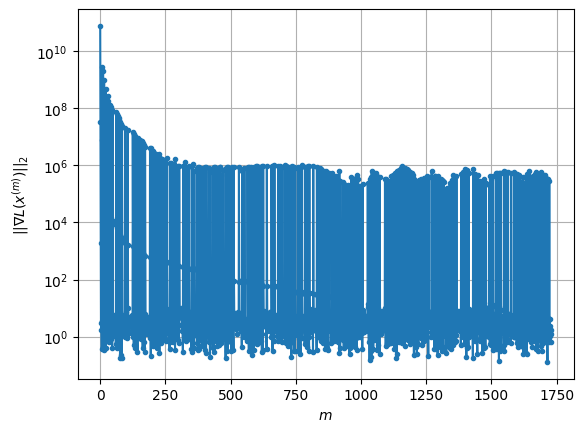

Windows:  63%|██████▎   | 186/296 [1:14:40<27:27, 14.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1529.4743621158566
Gradient norm: 248267.47451682942
Global relative error: 65.59285918053442
Position relative errors: 0.03384615146211165 m, 48.54953012100115 m, 9.96586364333447 m, 42.96563255002771 m

Iteration 1
Cost function: 1519.9060670728572 (-0.63%)
Gradient norm: 3.842313547532603 (-100.00%)
Global relative error = 65.46862708406094 (-0.19%)
Position relative errors: 0.03443956324519403 m, 48.46687733188388 m, 9.794530866158098 m, 42.908831010666326 m

Iteration 2
Cost function: 1519.906066894137 (-0.00%)
Gradient norm: 1.835610419147255 (-52.23%)
Global relative error = 65.4686269399974 (-0.00%)
Position relative errors: 0.03443957506005698 m, 48.46687729173026 m, 9.79453028820087 m, 42.908830968131696 m

Iteration 3
Cost function: 1519.9060671129014 (0.00%)
Gradient norm: 1.0837743580564192 (-40.96%)
Global relative error = 65.46862694028074 (0.00%)
Position relative errors: 0.0344395663111

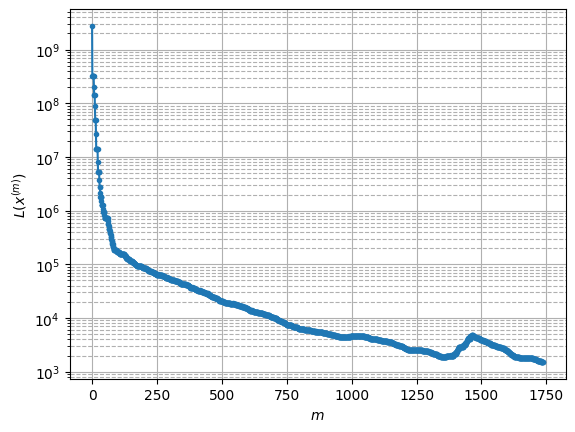

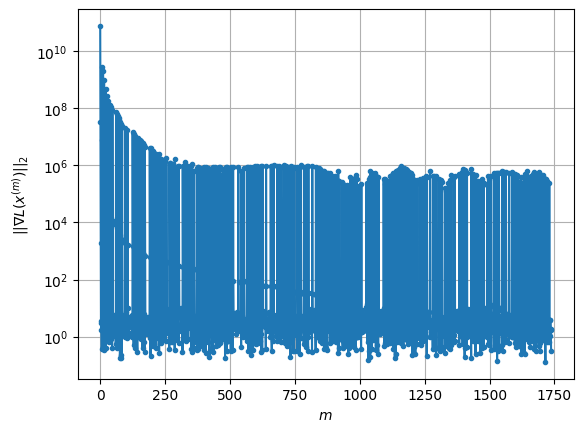

Windows:  63%|██████▎   | 187/296 [1:15:00<30:09, 16.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1501.192221971046
Gradient norm: 273292.37862704386
Global relative error: 67.25346180338701
Position relative errors: 0.03284606971382193 m, 49.57631180066819 m, 10.591856588165857 m, 44.19307731119657 m

Iteration 1
Cost function: 1491.6202075996468 (-0.64%)
Gradient norm: 3.643687307151609 (-100.00%)
Global relative error = 67.1303091848245 (-0.18%)
Position relative errors: 0.02471662351730082 m, 49.49539102390462 m, 10.423139250202277 m, 44.136621879605734 m

Iteration 2
Cost function: 1491.6202070889674 (-0.00%)
Gradient norm: 4.914717715297915 (34.88%)
Global relative error = 67.13030905044198 (-0.00%)
Position relative errors: 0.024716610344582182 m, 49.4953909847591 m, 10.423138713336073 m, 44.13662184590438 m

Iteration 3
Cost function: 1491.620208528496 (0.00%)
Gradient norm: 5.451440626911969 (10.92%)
Global relative error = 67.13030904996253 (-0.00%)
Position relative errors: 0.024716599061

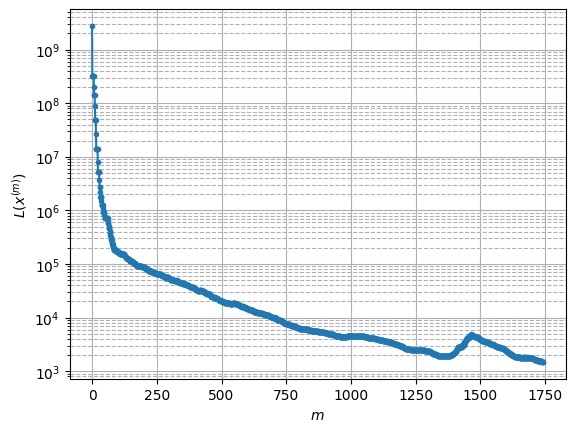

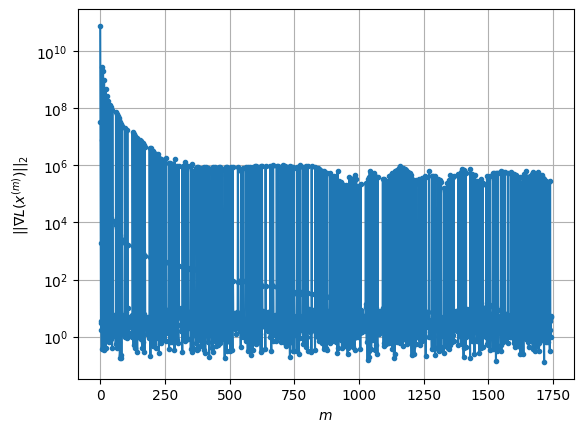

Windows:  64%|██████▎   | 188/296 [1:15:13<27:52, 15.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1464.4249097231118
Gradient norm: 326520.7925718529
Global relative error: 68.62250995956715
Position relative errors: 0.023305701387618144 m, 50.38752145603111 m, 11.176211652593093 m, 45.2243043795383 m

Iteration 1
Cost function: 1455.129726540501 (-0.63%)
Gradient norm: 3.8605104958469583 (-100.00%)
Global relative error = 68.50148135608754 (-0.18%)
Position relative errors: 0.041113756554934294 m, 50.307639142724945 m, 11.011457907264859 m, 45.17012173821572 m

Iteration 2
Cost function: 1455.1297248224662 (-0.00%)
Gradient norm: 8.572092450160588 (122.05%)
Global relative error = 68.50148122864421 (-0.00%)
Position relative errors: 0.04111375352366983 m, 50.307639104952365 m, 11.011457445224508 m, 45.170121699651574 m

Iteration 3
Cost function: 1455.12972549903 (0.00%)
Gradient norm: 6.289961392243299 (-26.62%)
Global relative error = 68.50148122871154 (0.00%)
Position relative errors: 0.04111374

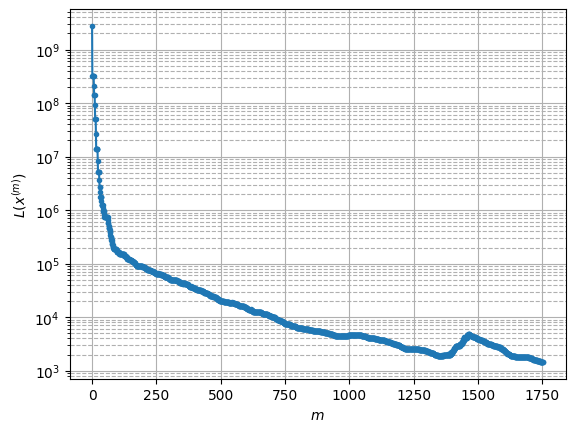

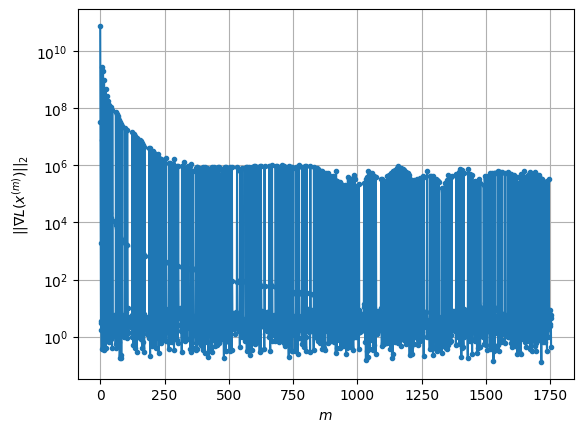

Windows:  64%|██████▍   | 189/296 [1:15:41<34:13, 19.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1438.5707922937936
Gradient norm: 324852.504490665
Global relative error: 69.69556098529128
Position relative errors: 0.03904936818205843 m, 50.97932324039699 m, 11.717881776746244 m, 46.057237734952444 m

Iteration 1
Cost function: 1430.1887769202513 (-0.58%)
Gradient norm: 2.5221789835824433 (-100.00%)
Global relative error = 69.57503804462854 (-0.17%)
Position relative errors: 0.05171776374898311 m, 50.90127244785265 m, 11.555126312310856 m, 46.002416948201805 m

Iteration 2
Cost function: 1430.1887780002266 (0.00%)
Gradient norm: 3.9179317899921973 (55.34%)
Global relative error = 69.57503793514206 (-0.00%)
Position relative errors: 0.05171777541864033 m, 50.90127240253725 m, 11.555125969175325 m, 46.00241691893059 m

Iteration 3
Cost function: 1430.1887781796083 (0.00%)
Gradient norm: 2.7279088430566487 (-30.37%)
Global relative error = 69.57503793510824 (-0.00%)
Position relative errors: 0.0517177

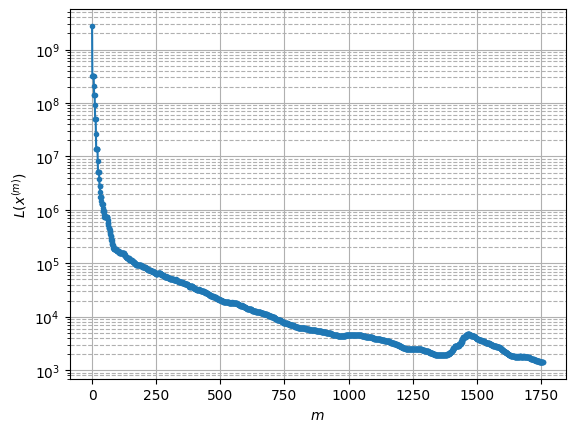

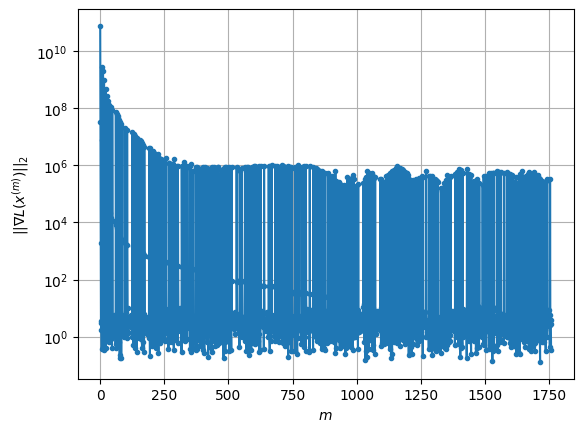

Windows:  64%|██████▍   | 190/296 [1:15:55<30:49, 17.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1414.7576227522045
Gradient norm: 432031.2681374422
Global relative error: 70.46701465360633
Position relative errors: 0.049326264870282334 m, 51.35027492589849 m, 12.213229108342981 m, 46.68601263096888 m

STOP on Iteration 1
Cost function = 1406.210306568399 (-0.60%)
Gradient norm = 0.7246417114342292 (-100.00%)
Global relative error = 70.3492169164262 (-0.17%)
Final position relative errors: 0.050592655105212575 m, 51.27396351973495 m, 12.056993869781643 m, 46.63281116917603 m

Majorization-Minimization converged after 1 iterations


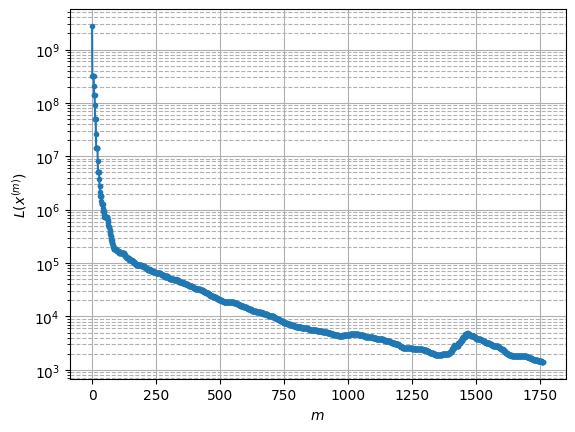

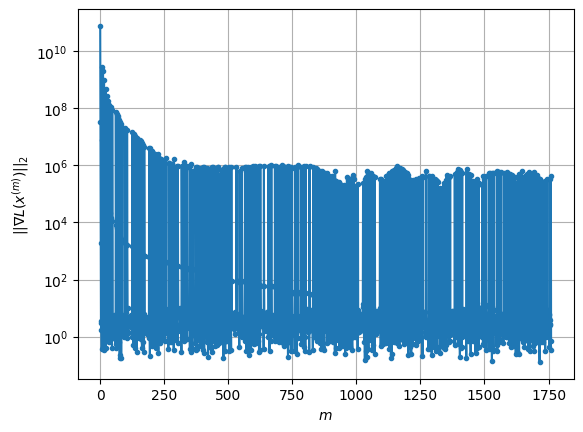

Windows:  65%|██████▍   | 191/296 [1:16:00<24:29, 13.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1414.2876203705182
Gradient norm: 453052.85685413406
Global relative error: 70.93630373267239
Position relative errors: 0.04859824778046166 m, 51.49903569141386 m, 12.664450629670641 m, 47.110696162544684 m

Iteration 1
Cost function: 1406.3142376119768 (-0.56%)
Gradient norm: 1.0823231921518577 (-100.00%)
Global relative error = 70.8176976732875 (-0.17%)
Position relative errors: 0.047200847262071084 m, 51.42309977784484 m, 12.512257512660474 m, 47.05584075869154 m

Iteration 2
Cost function: 1406.3142374893484 (-0.00%)
Gradient norm: 3.1741109316638823 (193.27%)
Global relative error = 70.81769759002802 (-0.00%)
Position relative errors: 0.047200853630475985 m, 51.42309975869485 m, 12.5122572751045 m, 47.055840717475895 m

Iteration 3
Cost function: 1406.3142380751692 (0.00%)
Gradient norm: 3.142141761586367 (-1.01%)
Global relative error = 70.8176975901268 (0.00%)
Position relative errors: 0.04720085

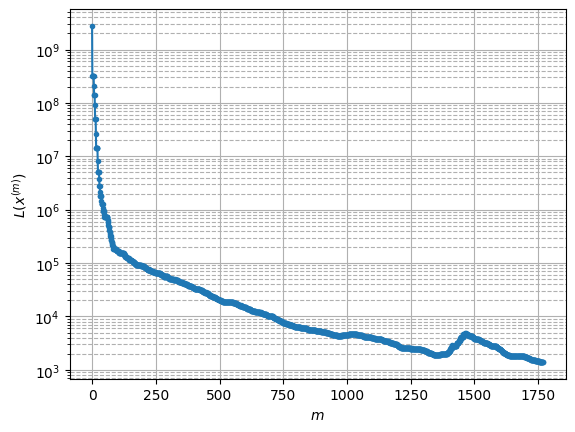

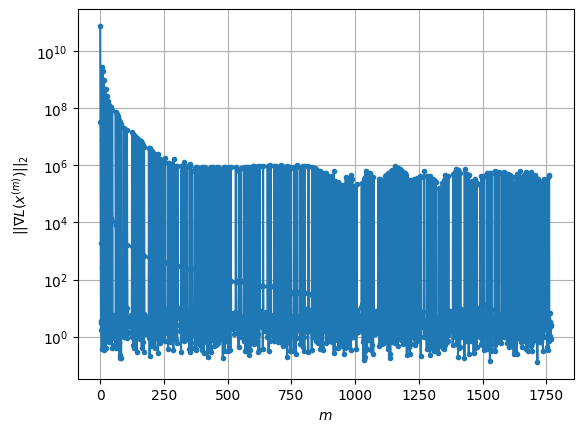

Windows:  65%|██████▍   | 192/296 [1:16:23<28:31, 16.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1404.1989081001077
Gradient norm: 228580.28488512128
Global relative error: 71.09890176588465
Position relative errors: 0.0455630682533319 m, 51.42415040137655 m, 13.067675921391643 m, 47.32699292990596 m

Iteration 1
Cost function: 1397.4581389721905 (-0.48%)
Gradient norm: 6.551557460006205 (-100.00%)
Global relative error = 70.98240993602633 (-0.16%)
Position relative errors: 0.04630217310036114 m, 51.34773035940579 m, 12.923916438431597 m, 47.274551793531806 m

Iteration 2
Cost function: 1397.4581402141885 (0.00%)
Gradient norm: 5.658875206576303 (-13.63%)
Global relative error = 70.98240985659805 (-0.00%)
Position relative errors: 0.04630216861281256 m, 51.34773032028828 m, 12.923916253849741 m, 47.274551767224 m

Iteration 3
Cost function: 1397.4581394149968 (-0.00%)
Gradient norm: 2.2853308806080026 (-59.62%)
Global relative error = 70.98240985672167 (0.00%)
Position relative errors: 0.0463021700

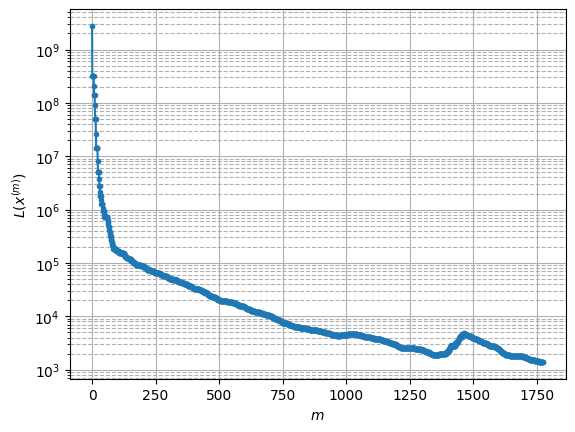

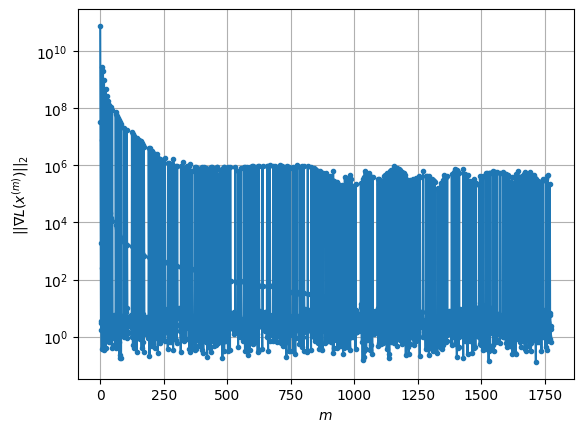

Windows:  65%|██████▌   | 193/296 [1:16:38<27:50, 16.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1420.2367815646307
Gradient norm: 336653.86491280625
Global relative error: 70.95777775159264
Position relative errors: 0.044721684242658044 m, 51.12544341570589 m, 13.425256625359765 m, 47.33873298113399 m

Iteration 1
Cost function: 1413.5067271994142 (-0.47%)
Gradient norm: 3.788861830515378 (-100.00%)
Global relative error = 70.83942957956127 (-0.17%)
Position relative errors: 0.03636565212764794 m, 51.05048442966955 m, 13.28850424711904 m, 47.28093749728206 m

Iteration 2
Cost function: 1413.5067271342084 (-0.00%)
Gradient norm: 1.0604030687845254 (-72.01%)
Global relative error = 70.83942950192683 (-0.00%)
Position relative errors: 0.03636567179074083 m, 51.05048438991934 m, 13.288504112072923 m, 47.280937461824465 m

Iteration 3
Cost function: 1413.5067276942582 (0.00%)
Gradient norm: 6.156739213582093 (480.60%)
Global relative error = 70.8394295021142 (0.00%)
Position relative errors: 0.03636565

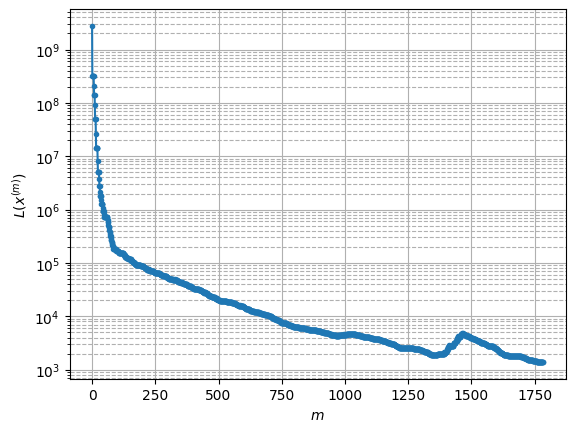

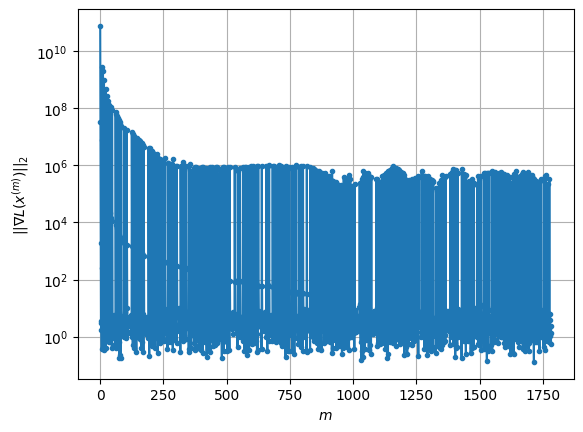

Windows:  66%|██████▌   | 194/296 [1:17:00<30:26, 17.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1413.602954068607
Gradient norm: 198884.98069837823
Global relative error: 70.5107049609329
Position relative errors: 0.035213204003059995 m, 50.60652704158475 m, 13.734456050493918 m, 47.13917958523531 m

Iteration 1
Cost function: 1408.2390971233212 (-0.38%)
Gradient norm: 5.197959040992541 (-100.00%)
Global relative error = 70.39388397998289 (-0.17%)
Position relative errors: 0.033748862604263095 m, 50.53323386327792 m, 13.606130710662848 m, 47.08038959760135 m

Iteration 2
Cost function: 1408.2390968843679 (-0.00%)
Gradient norm: 3.771390691845436 (-27.44%)
Global relative error = 70.39388391498903 (-0.00%)
Position relative errors: 0.033748883844846166 m, 50.53323382570467 m, 13.606130615670251 m, 47.08038956818976 m

STOP on Iteration 3
Cost function = 1408.239097274375 (0.00%)
Gradient norm = 0.364046166746047 (-90.35%)
Global relative error = 70.39388391558202 (0.00%)
Final position relative err

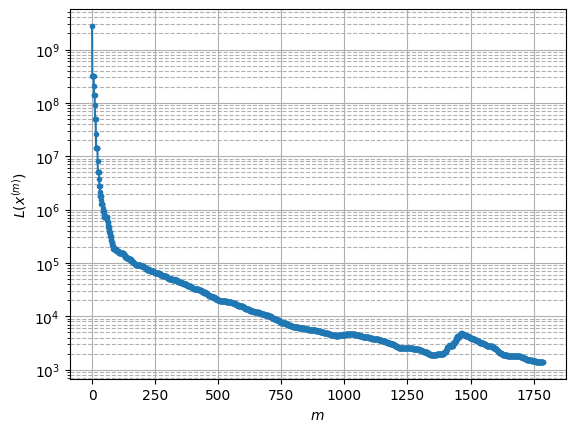

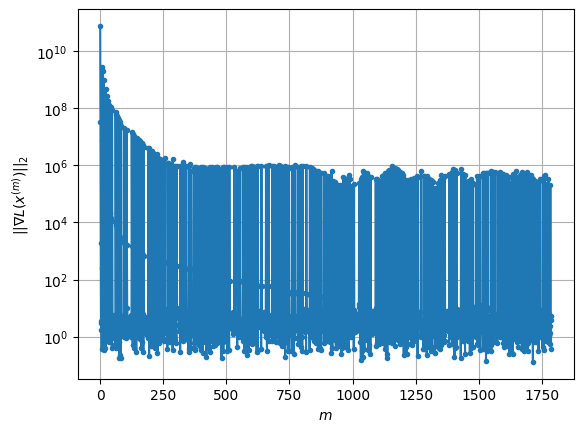

Windows:  66%|██████▌   | 195/296 [1:17:11<26:31, 15.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1440.3589855394657
Gradient norm: 290685.40860537696
Global relative error: 69.7639261982267
Position relative errors: 0.03285939435345316 m, 49.8702854788196 m, 13.995233602636397 m, 46.73427130792245 m

STOP on Iteration 1
Cost function = 1434.305963388536 (-0.42%)
Gradient norm = 0.5316956054861994 (-100.00%)
Global relative error = 69.64573405071971 (-0.17%)
Final position relative errors: 0.03750111366817505 m, 49.796823517348976 m, 13.875897684624102 m, 46.67185907852577 m

Majorization-Minimization converged after 1 iterations


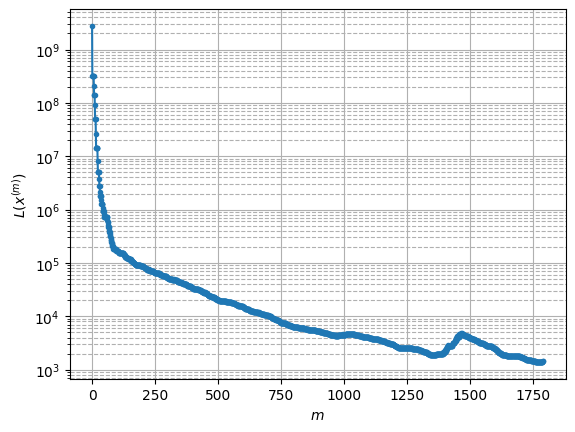

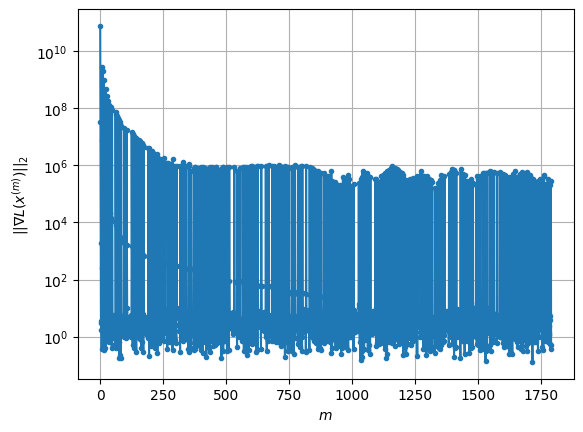

Windows:  66%|██████▌   | 196/296 [1:17:17<21:13, 12.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1451.9910968774934
Gradient norm: 336787.6331020984
Global relative error: 68.71903218907657
Position relative errors: 0.0364930651420097 m, 48.91868365127033 m, 14.20735627552282 m, 46.12393141957637 m

Iteration 1
Cost function: 1445.8289711921045 (-0.42%)
Gradient norm: 2.5492582566761506 (-100.00%)
Global relative error = 68.6008893372623 (-0.17%)
Position relative errors: 0.032120630282151084 m, 48.84532510939062 m, 14.099426356007386 m, 46.05888576759551 m

Iteration 2
Cost function: 1445.8289709021844 (-0.00%)
Gradient norm: 1.8801474189921936 (-26.25%)
Global relative error = 68.60088927382579 (-0.00%)
Position relative errors: 0.03212063629686301 m, 48.8453250647615 m, 14.099426316805642 m, 46.05888573243727 m

Iteration 3
Cost function: 1445.8289702361383 (-0.00%)
Gradient norm: 4.719865996306995 (151.04%)
Global relative error = 68.60088927395488 (0.00%)
Position relative errors: 0.0321206384

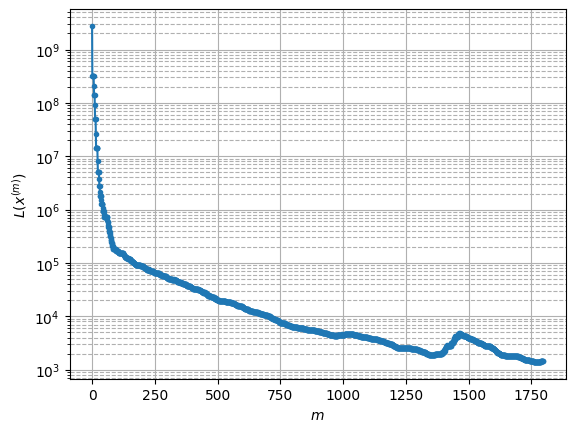

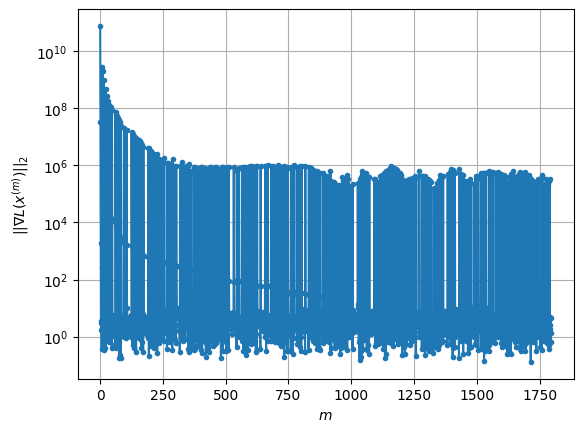

Windows:  67%|██████▋   | 197/296 [1:17:34<23:27, 14.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1462.4319413246453
Gradient norm: 324773.5637404865
Global relative error: 67.38314189566886
Position relative errors: 0.03127568647016481 m, 47.75665539465406 m, 14.37237597158829 m, 45.31250256132093 m

Iteration 1
Cost function: 1456.3585934286968 (-0.42%)
Gradient norm: 4.733246720312768 (-100.00%)
Global relative error = 67.26510172047945 (-0.18%)
Position relative errors: 0.04063906320812552 m, 47.68559789781876 m, 14.276235820736975 m, 45.24228647415754 m

Iteration 2
Cost function: 1456.358594727724 (0.00%)
Gradient norm: 1.339375054013812 (-71.70%)
Global relative error = 67.26510166085156 (-0.00%)
Position relative errors: 0.040639073797438974 m, 47.685597861561284 m, 14.276235793783266 m, 45.24228643221557 m

STOP on Iteration 3
Cost function = 1456.3585941754782 (-0.00%)
Gradient norm = 0.46645167775454444 (-65.17%)
Global relative error = 67.26510166054061 (-0.00%)
Final position relative e

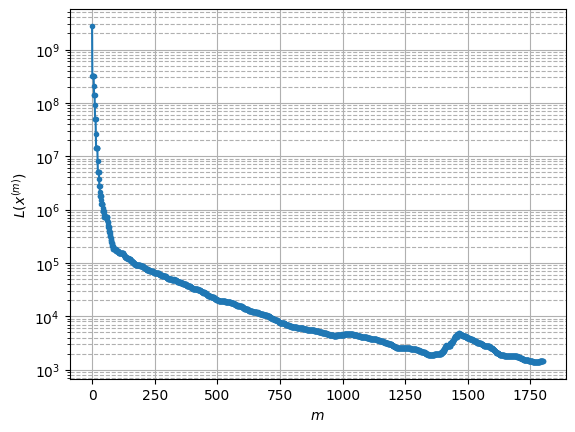

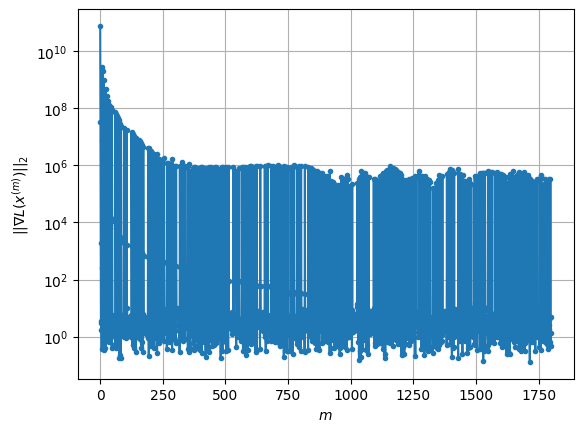

Windows:  67%|██████▋   | 198/296 [1:17:45<21:26, 13.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1467.2686626981695
Gradient norm: 543514.6841743513
Global relative error: 65.76327437576002
Position relative errors: 0.03961268677783749 m, 46.39186257001914 m, 14.490036632705527 m, 44.30169020294515 m

Iteration 1
Cost function: 1460.441067428082 (-0.47%)
Gradient norm: 6.513447471190227 (-100.00%)
Global relative error = 65.64803079824817 (-0.18%)
Position relative errors: 0.028344578227311963 m, 46.323685924540314 m, 14.407997609004 m, 44.228814337951505 m

Iteration 2
Cost function: 1460.4410666915783 (-0.00%)
Gradient norm: 3.477077713670223 (-46.62%)
Global relative error = 65.64803073260514 (-0.00%)
Position relative errors: 0.02834457650085765 m, 46.32368587869083 m, 14.407997575771175 m, 44.22881429936693 m

STOP on Iteration 3
Cost function = 1460.441067127238 (0.00%)
Gradient norm = 0.5393695853955462 (-84.49%)
Global relative error = 65.6480307336479 (0.00%)
Final position relative errors

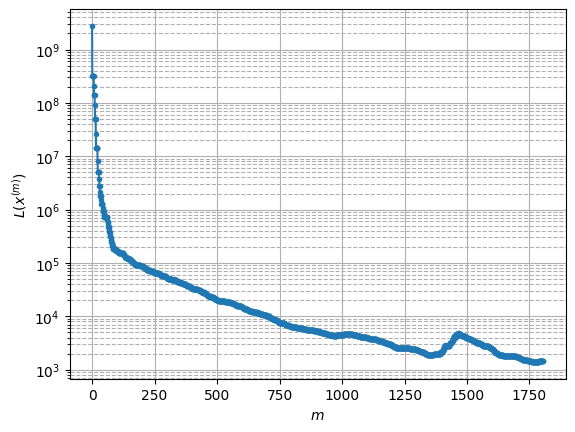

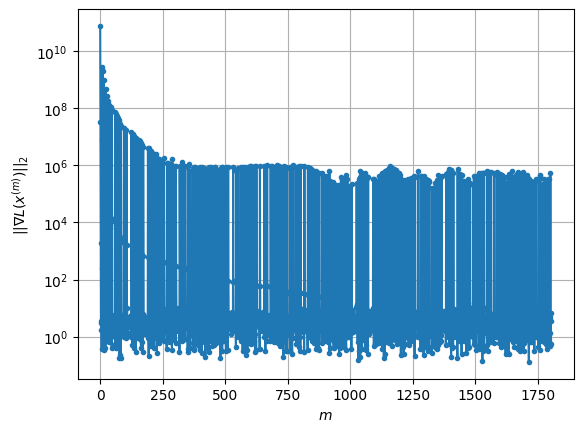

Windows:  67%|██████▋   | 199/296 [1:17:56<20:07, 12.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1462.3914382204782
Gradient norm: 299086.75271054765
Global relative error: 63.87031738081604
Position relative errors: 0.028192890578920878 m, 44.83124310204301 m, 14.562301766890224 m, 43.09889237574541 m

STOP on Iteration 1
Cost function = 1456.2444476934108 (-0.42%)
Gradient norm = 0.6245365599909343 (-100.00%)
Global relative error = 63.75939947235872 (-0.17%)
Final position relative errors: 0.020507612219721003 m, 44.76558035272982 m, 14.492477431598358 m, 43.02639175129517 m

Majorization-Minimization converged after 1 iterations


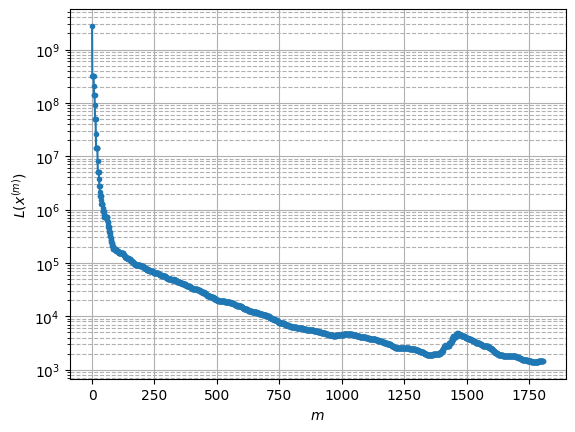

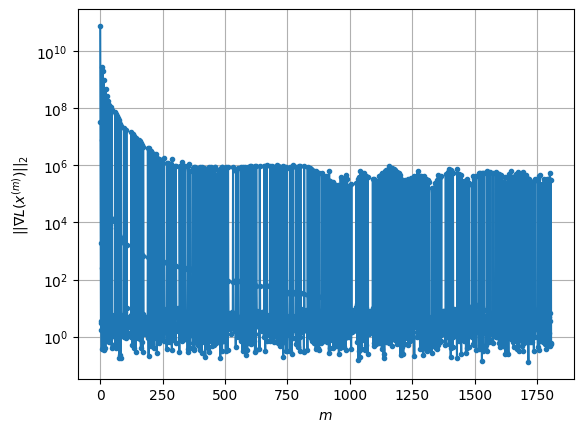

Windows:  68%|██████▊   | 200/296 [1:18:02<16:44, 10.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1460.5617503018136
Gradient norm: 321034.29109301796
Global relative error: 61.71520200008914
Position relative errors: 0.02078587113760517 m, 43.08166425340734 m, 14.587223543324193 m, 41.712676762182966 m

Iteration 1
Cost function: 1453.9429497600597 (-0.45%)
Gradient norm: 1.803403046776372 (-100.00%)
Global relative error = 61.60603186289336 (-0.18%)
Position relative errors: 0.014406039779984302 m, 43.0191009233929 m, 14.526920132012947 m, 41.63684751822348 m

Iteration 2
Cost function: 1453.9429490047366 (-0.00%)
Gradient norm: 2.0377703666609928 (13.00%)
Global relative error = 61.60603179868503 (-0.00%)
Position relative errors: 0.014406043745120273 m, 43.019100874898335 m, 14.526920093140687 m, 41.63684748688614 m

Iteration 3
Cost function: 1453.9429497795095 (0.00%)
Gradient norm: 2.118903406392783 (3.98%)
Global relative error = 61.60603179879668 (0.00%)
Position relative errors: 0.01440604

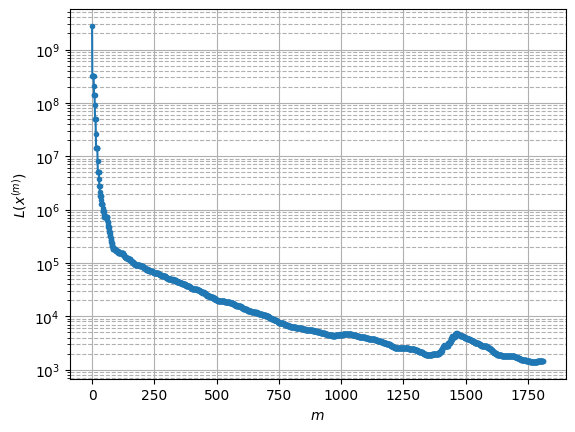

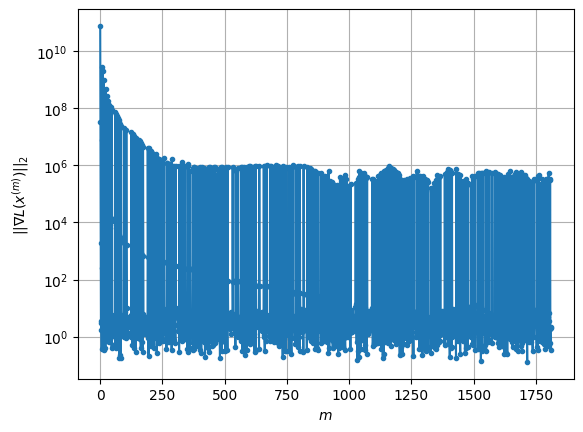

Windows:  68%|██████▊   | 201/296 [1:18:15<17:45, 11.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1450.41245512712
Gradient norm: 285210.4615360505
Global relative error: 59.30603353985243
Position relative errors: 0.014822763256575498 m, 41.151613645591766 m, 14.562344838793873 m, 40.14581465696822 m

Iteration 1
Cost function: 1444.4488751681122 (-0.41%)
Gradient norm: 1.0244676627639622 (-100.00%)
Global relative error = 59.201098202772215 (-0.18%)
Position relative errors: 0.011001181372320009 m, 41.094247758170184 m, 14.50927935231005 m, 40.06883780303995 m

Iteration 2
Cost function: 1444.4488739283515 (-0.00%)
Gradient norm: 7.432689934470029 (625.52%)
Global relative error = 59.20109815037435 (-0.00%)
Position relative errors: 0.011001187671703699 m, 41.09424772238994 m, 14.509279324647384 m, 40.06883777233403 m

Iteration 3
Cost function: 1444.4488788360038 (0.00%)
Gradient norm: 8.552243636552355 (15.06%)
Global relative error = 59.201098149763546 (-0.00%)
Position relative errors: 0.01100

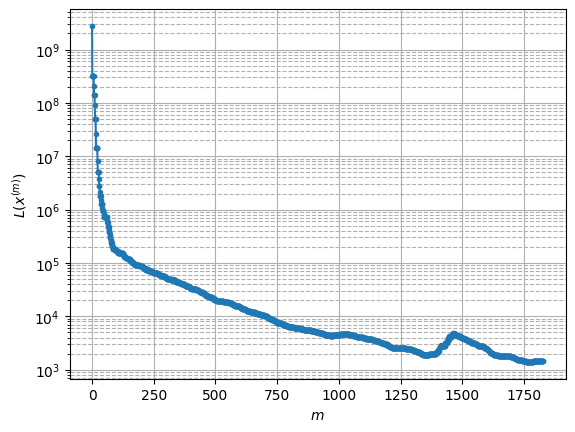

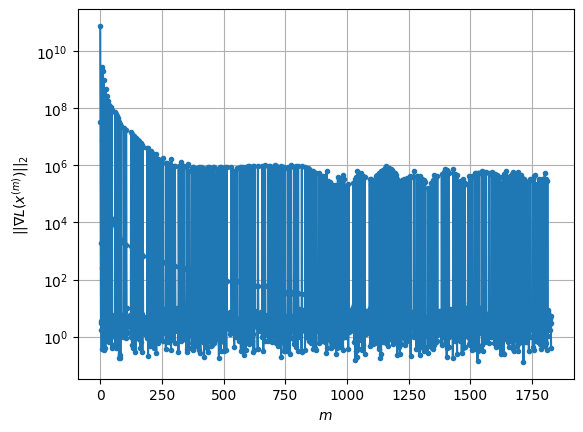

Windows:  68%|██████▊   | 202/296 [1:18:55<31:15, 19.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1439.8027552822232
Gradient norm: 343955.3938066623
Global relative error: 56.657157519959426
Position relative errors: 0.011465111259206441 m, 39.05187257071385 m, 14.48589193628467 m, 38.407570021361835 m

Iteration 1
Cost function: 1433.7897198093463 (-0.42%)
Gradient norm: 4.171539908042191 (-100.00%)
Global relative error = 56.558784405732105 (-0.17%)
Position relative errors: 0.009386645903206436 m, 38.99817887624389 m, 14.444361176256677 m, 38.33270633071406 m

Iteration 2
Cost function: 1433.7897181043932 (-0.00%)
Gradient norm: 3.800398011995222 (-8.90%)
Global relative error = 56.55878435528918 (-0.00%)
Position relative errors: 0.009386650886070507 m, 38.998178840785044 m, 14.444361139774424 m, 38.33270630610737 m

STOP on Iteration 3
Cost function = 1433.789720483708 (0.00%)
Gradient norm = 0.9367617923964328 (-75.35%)
Global relative error = 56.558784354731856 (-0.00%)
Final position relati

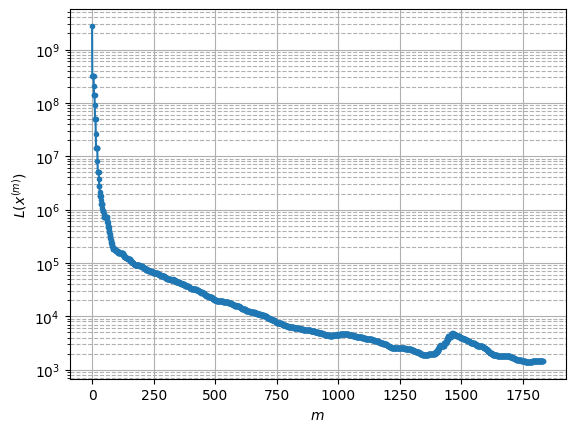

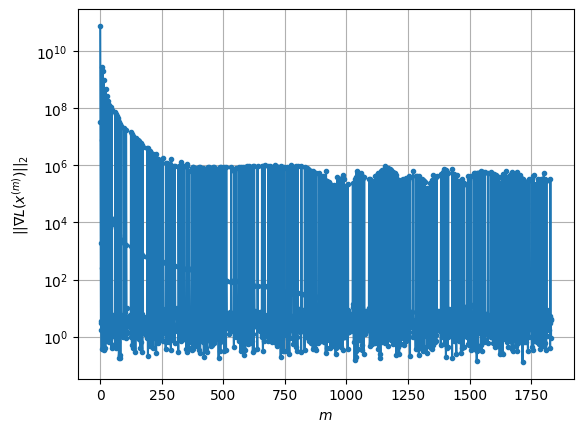

Windows:  69%|██████▊   | 203/296 [1:19:05<26:20, 16.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1429.7630804722664
Gradient norm: 294406.87229348504
Global relative error: 53.78406633577745
Position relative errors: 0.009827129107637042 m, 36.79035101069844 m, 14.362809690351652 m, 36.508943963230536 m

STOP on Iteration 1
Cost function = 1422.2631826196666 (-0.52%)
Gradient norm = 0.6612869756146341 (-100.00%)
Global relative error = 53.692469879488215 (-0.17%)
Final position relative errors: 0.00927130696076415 m, 36.73900738875759 m, 14.335306358876837 m, 36.43656266473101 m

Majorization-Minimization converged after 1 iterations


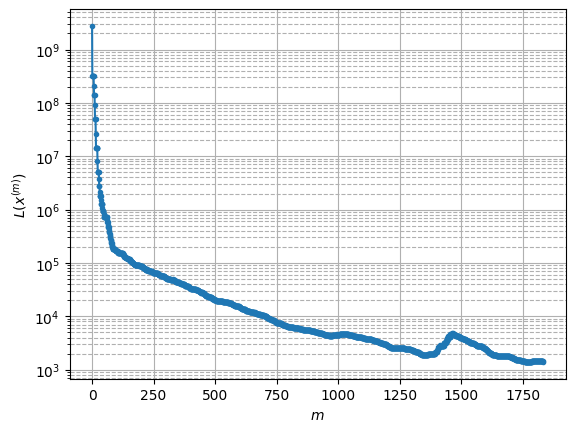

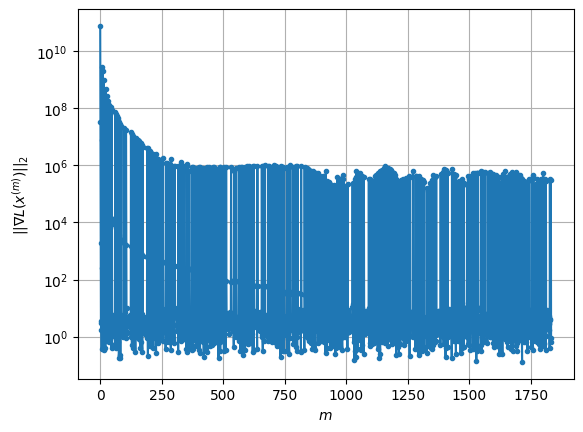

Windows:  69%|██████▉   | 204/296 [1:19:11<20:55, 13.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1401.7059978568532
Gradient norm: 259025.87782888857
Global relative error: 50.701448586144835
Position relative errors: 0.009569310281339397 m, 34.375831799119815 m, 14.196379231257158 m, 34.458655796462466 m

STOP on Iteration 1
Cost function = 1394.9400308629547 (-0.48%)
Gradient norm = 0.8822238439804805 (-100.00%)
Global relative error = 50.61916666624094 (-0.16%)
Final position relative errors: 0.01626196383140618 m, 34.328471833410845 m, 14.177876819608489 m, 34.39245222025847 m

Majorization-Minimization converged after 1 iterations


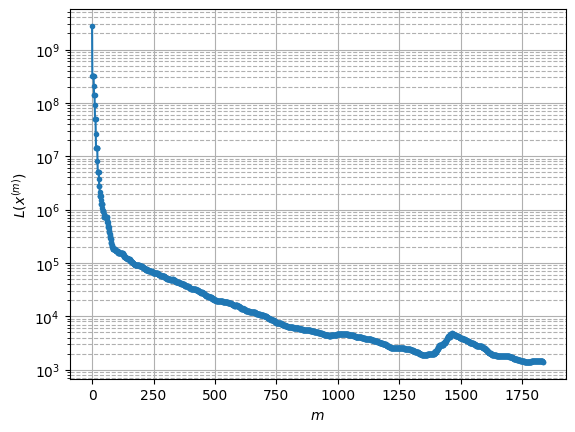

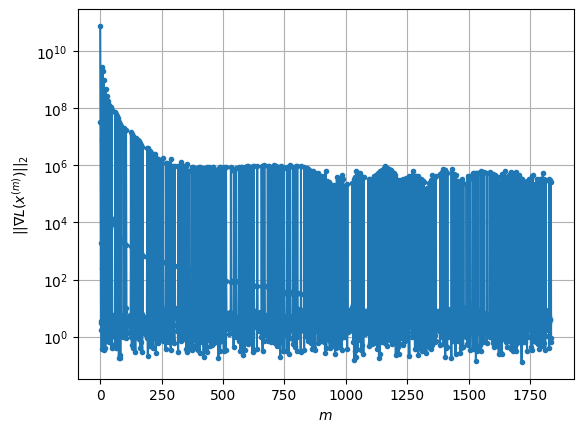

Windows:  69%|██████▉   | 205/296 [1:19:16<16:53, 11.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1375.435421971724
Gradient norm: 236177.08721028367
Global relative error: 47.4276531889607
Position relative errors: 0.016256046258792577 m, 31.82058756894793 m, 13.982850887708242 m, 32.269318269658726 m

Iteration 1
Cost function: 1368.4930440891585 (-0.50%)
Gradient norm: 3.274709464425994 (-100.00%)
Global relative error = 47.35620145144777 (-0.15%)
Position relative errors: 0.005245780823626912 m, 31.77866428416609 m, 13.975933889278103 m, 32.20863798635152 m

Iteration 2
Cost function: 1368.493043130566 (-0.00%)
Gradient norm: 1.031540333550911 (-68.50%)
Global relative error = 47.35620139572672 (-0.00%)
Position relative errors: 0.00524578218868082 m, 31.778664238330816 m, 13.975933821629603 m, 32.20863797900232 m

Iteration 3
Cost function: 1368.4930421973388 (-0.00%)
Gradient norm: 1.821029332876086 (76.53%)
Global relative error = 47.35620139604155 (0.00%)
Position relative errors: 0.00524577

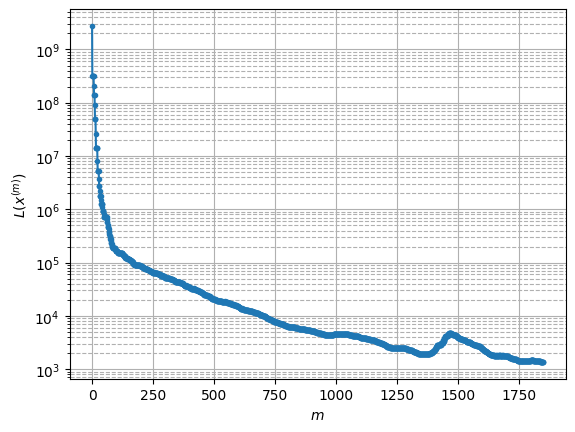

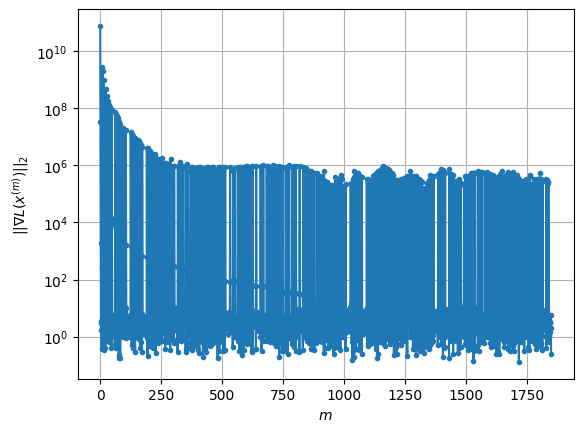

Windows:  70%|██████▉   | 206/296 [1:19:46<25:05, 16.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1347.3101296216134
Gradient norm: 181084.89962111556
Global relative error: 43.98166106118938
Position relative errors: 0.005153690012295858 m, 29.137314458310065 m, 13.726209476022879 m, 29.949807915722705 m

Iteration 1
Cost function: 1340.0545901627265 (-0.54%)
Gradient norm: 3.1742104372066917 (-100.00%)
Global relative error = 43.920006325945295 (-0.14%)
Position relative errors: 0.00948462750144587 m, 29.100869959258645 m, 13.728422686519702 m, 29.89369648424745 m

Iteration 2
Cost function: 1340.054589275915 (-0.00%)
Gradient norm: 1.7450175504643084 (-45.03%)
Global relative error = 43.9200062756677 (-0.00%)
Position relative errors: 0.009484632545252777 m, 29.100869929555806 m, 13.728422599323105 m, 29.89369647933713 m

STOP on Iteration 3
Cost function = 1340.0545883050943 (-0.00%)
Gradient norm = 0.23625957696025893 (-86.46%)
Global relative error = 43.92000627514121 (-0.00%)
Final position r

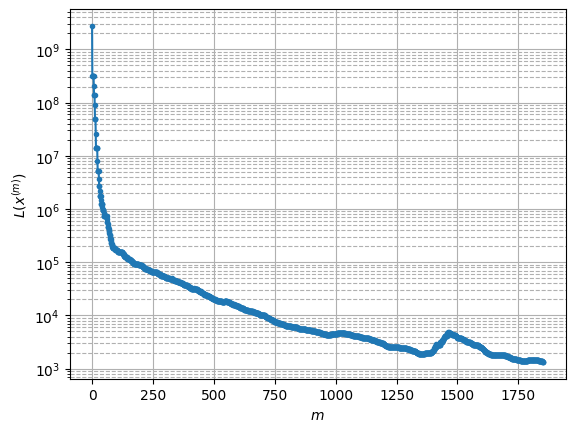

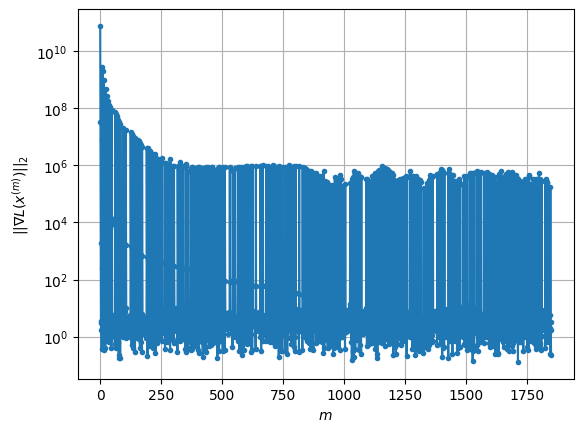

Windows:  70%|██████▉   | 207/296 [1:19:56<21:57, 14.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1315.3702499438946
Gradient norm: 170195.14331327745
Global relative error: 40.381784454101705
Position relative errors: 0.009651741551777619 m, 26.337805054487628 m, 13.425824108614044 m, 27.509121750303308 m

Iteration 1
Cost function: 1308.4921383409858 (-0.52%)
Gradient norm: 4.766177220922627 (-100.00%)
Global relative error = 40.330275115352535 (-0.13%)
Position relative errors: 0.00867022515253586 m, 26.306743279470695 m, 13.43290858957881 m, 27.459776773402304 m

STOP on Iteration 2
Cost function = 1308.4921381470404 (-0.00%)
Gradient norm = 0.8748406364838213 (-81.64%)
Global relative error = 40.3302750717832 (-0.00%)
Final position relative errors: 0.008670230769681904 m, 26.30674324698279 m, 13.432908528729662 m, 27.459776770300387 m

Majorization-Minimization converged after 1 iterations


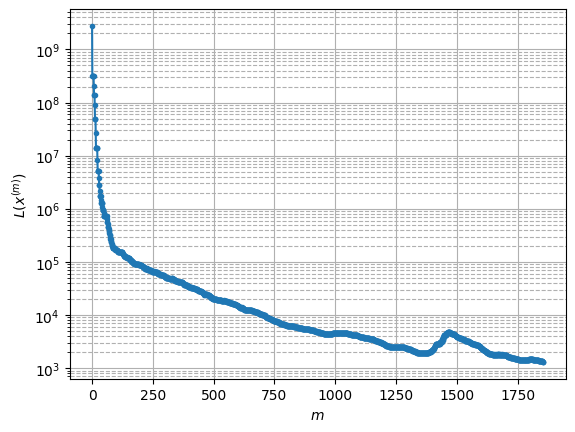

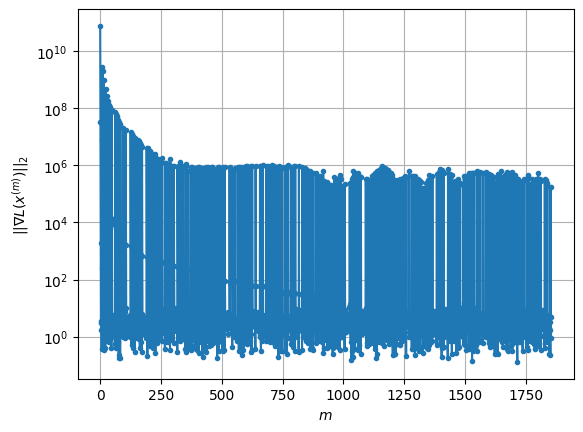

Windows:  70%|███████   | 208/296 [1:20:05<18:52, 12.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1268.2847133585342
Gradient norm: 164055.96109815524
Global relative error: 36.65016297094356
Position relative errors: 0.008915398533865707 m, 23.434233258236773 m, 13.079423559771401 m, 24.959878101796278 m

Iteration 1
Cost function: 1260.8605365591231 (-0.59%)
Gradient norm: 1.536349261354927 (-100.00%)
Global relative error = 36.61661759807243 (-0.09%)
Position relative errors: 0.017177939795568625 m, 23.411743309451737 m, 13.101085847640652 m, 24.920352863788562 m

Iteration 2
Cost function: 1260.860536937226 (0.00%)
Gradient norm: 1.3331238985483975 (-13.23%)
Global relative error = 36.61661753055975 (-0.00%)
Position relative errors: 0.017177943567979446 m, 23.411743263934223 m, 13.101085740021636 m, 24.920352863925828 m

Iteration 3
Cost function: 1260.8605362881603 (-0.00%)
Gradient norm: 2.9409979862419027 (120.61%)
Global relative error = 36.61661753052771 (-0.00%)
Position relative errors: 

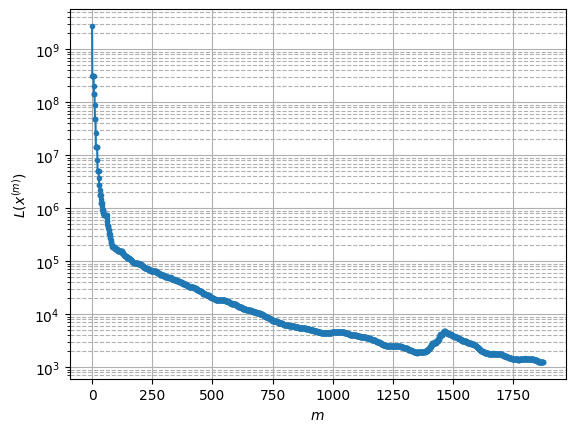

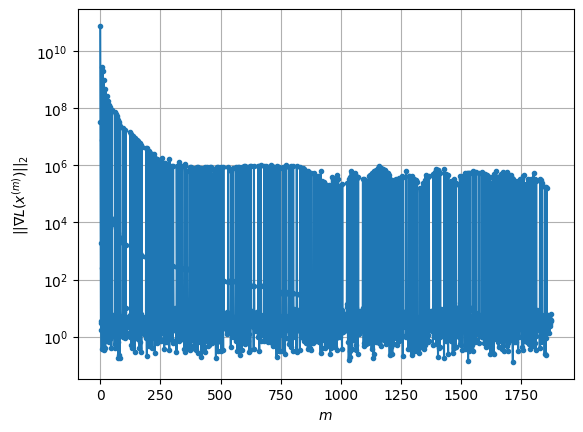

Windows:  71%|███████   | 209/296 [1:20:55<34:49, 24.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1239.5574329219519
Gradient norm: 211822.50193390454
Global relative error: 32.8202753871403
Position relative errors: 0.016946824356941604 m, 20.442577365957824 m, 12.698749740724141 m, 22.31610247111174 m

Iteration 1
Cost function: 1232.165640433345 (-0.60%)
Gradient norm: 4.661310366573785 (-100.00%)
Global relative error = 32.79843697465222 (-0.07%)
Position relative errors: 0.01478221326125381 m, 20.42441579970464 m, 12.725949640538353 m, 22.285110826126758 m

Iteration 2
Cost function: 1232.1656397758775 (-0.00%)
Gradient norm: 1.1348418296916922 (-75.65%)
Global relative error = 32.79843692642995 (-0.00%)
Position relative errors: 0.01478222807314275 m, 20.424415756491495 m, 12.725949586599564 m, 22.285110825552138 m

STOP on Iteration 3
Cost function = 1232.1656396827757 (-0.00%)
Gradient norm = 0.7153097147132585 (-36.97%)
Global relative error = 32.798436926060745 (-0.00%)
Final position rela

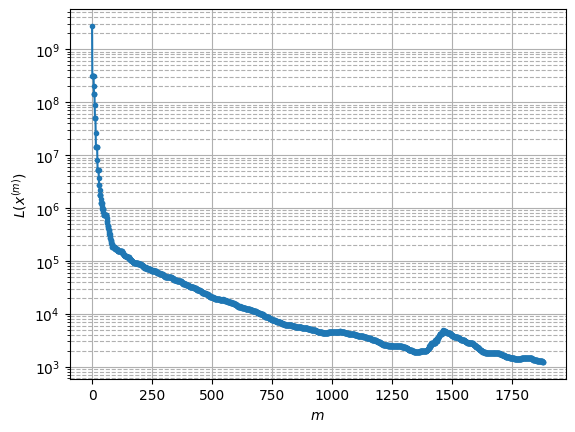

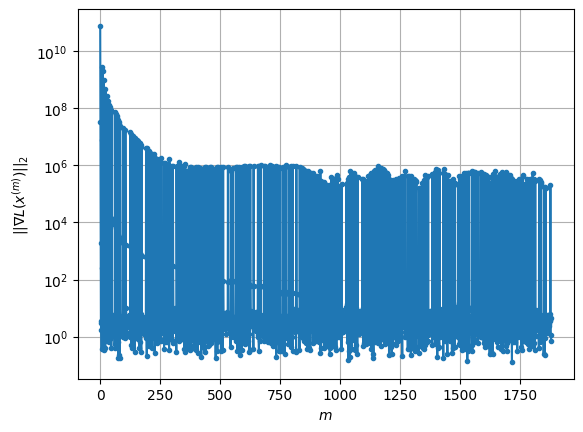

Windows:  71%|███████   | 210/296 [1:21:05<28:37, 19.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1201.520918182792
Gradient norm: 187439.12989267102
Global relative error: 28.916982191355014
Position relative errors: 0.014858347283642367 m, 17.37172259952186 m, 12.277074159850153 m, 19.587841214598647 m

STOP on Iteration 1
Cost function = 1194.2192054625684 (-0.61%)
Gradient norm = 0.6759059321968723 (-100.00%)
Global relative error = 28.912819333857982 (-0.01%)
Final position relative errors: 0.017230686730838003 m, 17.365146780616804 m, 12.312144040082968 m, 19.565500458435423 m

Majorization-Minimization converged after 1 iterations


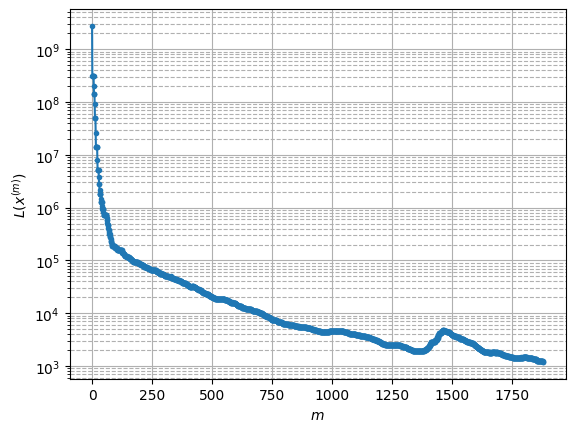

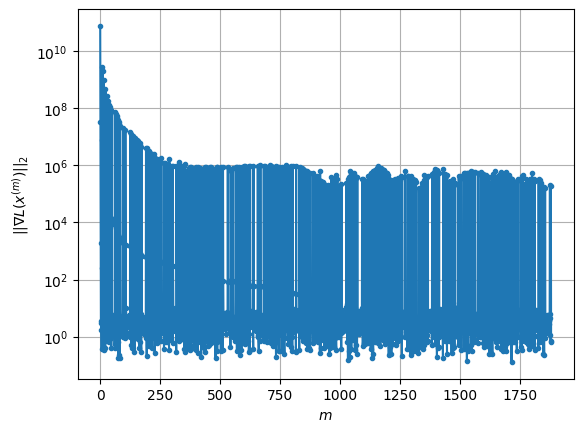

Windows:  71%|███████▏  | 211/296 [1:21:11<22:10, 15.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1174.6323019089568
Gradient norm: 206949.71516129252
Global relative error: 24.987527166093795
Position relative errors: 0.01712359126808536 m, 14.243088478847316 m, 11.819446569050045 m, 16.787086584651497 m

Iteration 1
Cost function: 1168.2546766062999 (-0.54%)
Gradient norm: 4.786486445181334 (-100.00%)
Global relative error = 24.992908707977293 (0.02%)
Position relative errors: 0.02019152569128071 m, 14.24632827184937 m, 11.843933463052432 m, 16.77508292157631 m

STOP on Iteration 2
Cost function = 1168.254677573027 (0.00%)
Gradient norm = 0.3313825354069911 (-93.08%)
Global relative error = 24.9929086974654 (-0.00%)
Final position relative errors: 0.020191536630400672 m, 14.246328225254889 m, 11.843933502211398 m, 16.775082917824324 m

Majorization-Minimization converged after 1 iterations


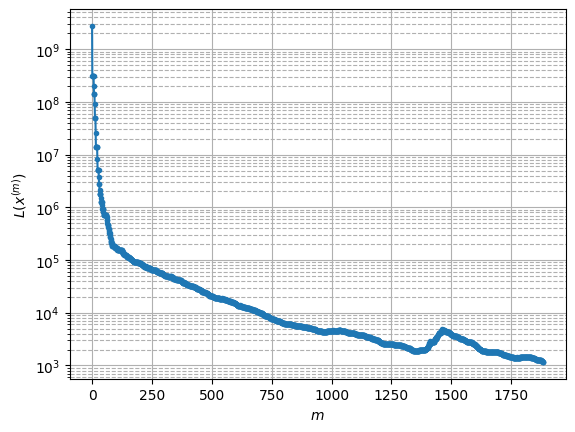

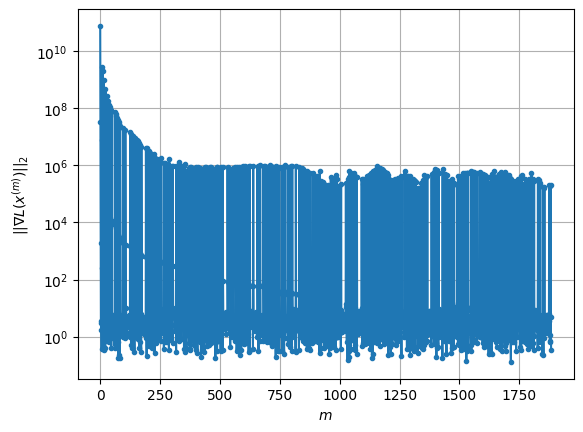

Windows:  72%|███████▏  | 212/296 [1:21:19<18:53, 13.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1157.0262382911387
Gradient norm: 292890.8308885223
Global relative error: 21.08266093596625
Position relative errors: 0.019986369596827685 m, 11.070375119364119 m, 11.310712798764289 m, 13.927939717379047 m

Iteration 1
Cost function: 1151.0484714732238 (-0.52%)
Gradient norm: 6.650131220732063 (-100.00%)
Global relative error = 21.10299273711811 (0.10%)
Position relative errors: 0.025242300702347672 m, 11.084762493016514 m, 11.337891580603014 m, 13.925181431612268 m

Iteration 2
Cost function: 1151.048470819515 (-0.00%)
Gradient norm: 5.540784899406285 (-16.68%)
Global relative error = 21.102992741664778 (0.00%)
Position relative errors: 0.025242317322851572 m, 11.084762439127266 m, 11.337891647335722 m, 13.925181427035717 m

Iteration 3
Cost function: 1151.0484712471787 (0.00%)
Gradient norm: 1.5958580248474776 (-71.20%)
Global relative error = 21.102992741747396 (0.00%)
Position relative errors: 0.0

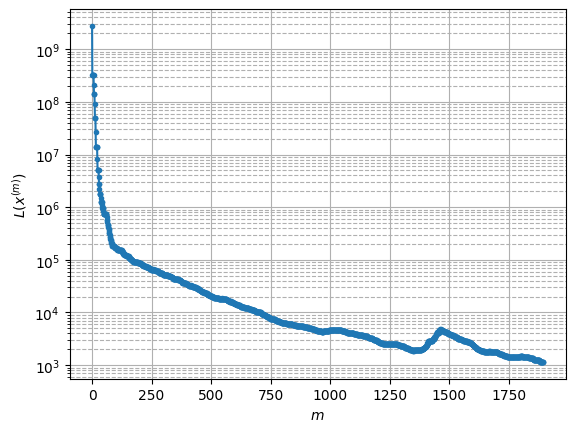

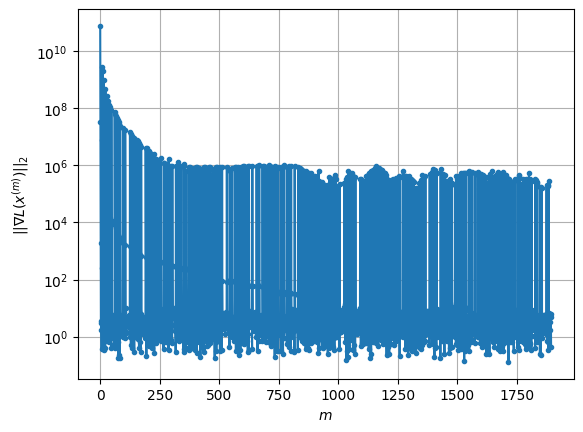

Windows:  72%|███████▏  | 213/296 [1:21:47<24:48, 17.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1139.0538366552164
Gradient norm: 285614.30136354885
Global relative error: 17.3044471982425
Position relative errors: 0.02496204693825411 m, 7.874629468145113 m, 10.767200863770661 m, 11.022497378205914 m

Iteration 1
Cost function: 1133.7905475766713 (-0.46%)
Gradient norm: 2.5606758027256156 (-100.00%)
Global relative error = 17.33248462449779 (0.16%)
Position relative errors: 0.02060173603934755 m, 7.901737174573865 m, 10.784447171142121 m, 11.030296761158601 m

Iteration 2
Cost function: 1133.790546882879 (-0.00%)
Gradient norm: 3.5163538158513297 (37.32%)
Global relative error = 17.33248467863893 (0.00%)
Position relative errors: 0.02060174807020784 m, 7.90173711349114 m, 10.784447312203701 m, 11.030296752050976 m

Iteration 3
Cost function: 1133.79054758552 (0.00%)
Gradient norm: 2.0224249684395432 (-42.49%)
Global relative error = 17.332484679485127 (0.00%)
Position relative errors: 0.0206017490

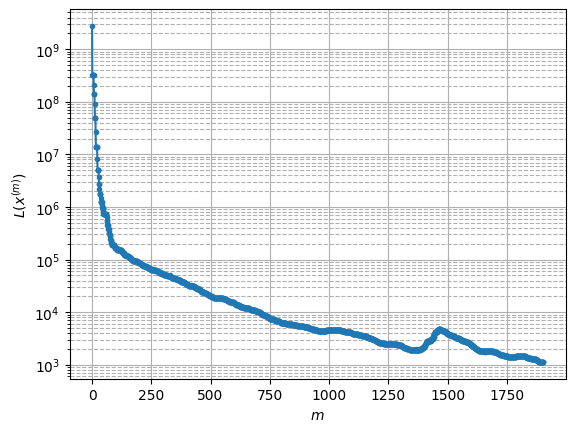

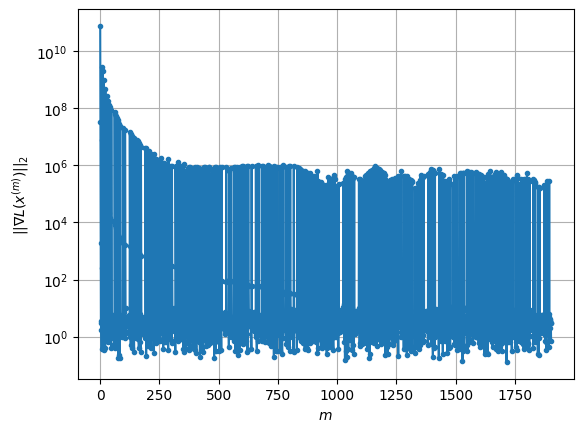

Windows:  72%|███████▏  | 214/296 [1:22:10<26:35, 19.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1124.9555085306026
Gradient norm: 205913.5964657388
Global relative error: 13.82266903811213
Position relative errors: 0.020205517696535842 m, 4.694919306556657 m, 10.179167801222707 m, 8.087182120349976 m

Iteration 1
Cost function: 1119.7139503445792 (-0.47%)
Gradient norm: 3.0427238787129864 (-100.00%)
Global relative error = 13.86717404223304 (0.32%)
Position relative errors: 0.016960079025320377 m, 4.742878814602246 m, 10.19971280466095 m, 8.109480376942782 m

Iteration 2
Cost function: 1119.7139500743626 (-0.00%)
Gradient norm: 3.731827060563461 (22.65%)
Global relative error = 13.867174142363533 (0.00%)
Position relative errors: 0.016960090603086925 m, 4.742878746503438 m, 10.199712982233114 m, 8.109480364627455 m

STOP on Iteration 3
Cost function = 1119.7139511499345 (0.00%)
Gradient norm = 0.5630983312603132 (-84.91%)
Global relative error = 13.867174141999776 (-0.00%)
Final position relative 

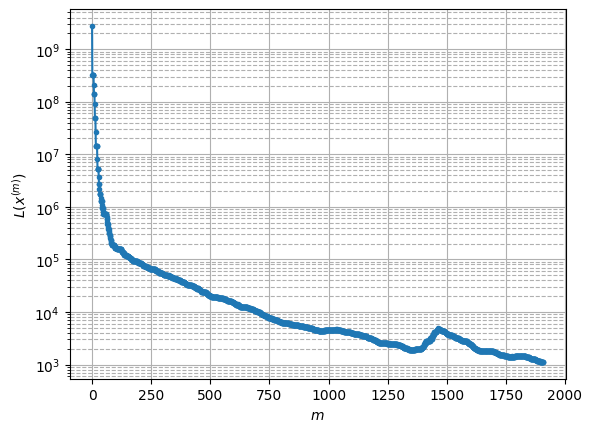

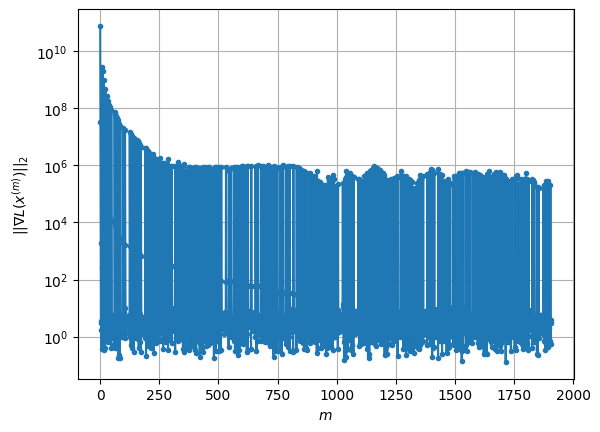

Windows:  73%|███████▎  | 215/296 [1:22:21<22:39, 16.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1112.2693959305916
Gradient norm: 249738.74202041165
Global relative error: 11.004591835216146
Position relative errors: 0.016897838043110517 m, 1.7696773881423262 m, 9.563280074626903 m, 5.148501888700041 m

STOP on Iteration 1
Cost function = 1107.556097800312 (-0.42%)
Gradient norm = 0.6246915410125172 (-100.00%)
Global relative error = 11.058413089384176 (0.49%)
Final position relative errors: 0.010790454879122113 m, 1.8991115171891162 m, 9.582571094076402 m, 5.181747410409388 m

Majorization-Minimization converged after 1 iterations


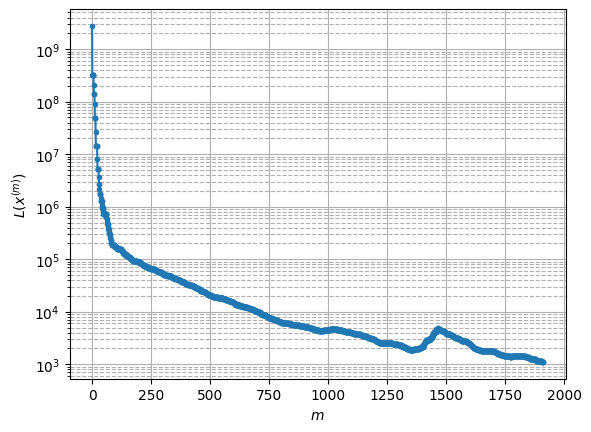

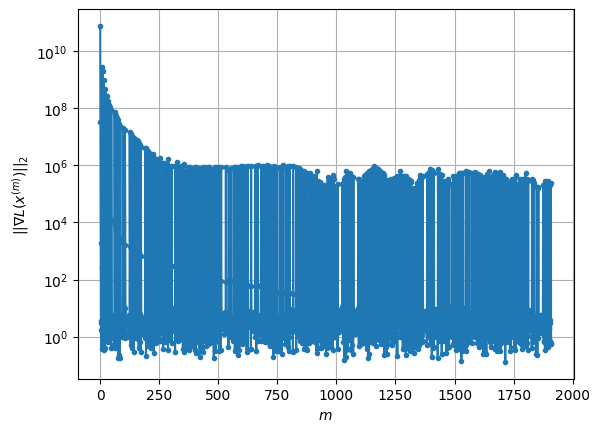

Windows:  73%|███████▎  | 216/296 [1:22:27<18:06, 13.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1109.9287696475417
Gradient norm: 283260.6026552155
Global relative error: 9.497757691889078
Position relative errors: 0.010855014155085423 m, 2.3401024416318137 m, 8.918231171095037 m, 2.278318471466221 m

Iteration 1
Cost function: 1105.4779126071148 (-0.40%)
Gradient norm: 1.6482413887726899 (-100.00%)
Global relative error = 9.559149356254464 (0.65%)
Position relative errors: 0.009027479743771568 m, 2.3998222862321614 m, 8.95026588002073 m, 2.346325400348005 m

Iteration 2
Cost function: 1105.4779152828228 (0.00%)
Gradient norm: 2.547717129706919 (54.57%)
Global relative error = 9.55914952435502 (0.00%)
Position relative errors: 0.009027476758522451 m, 2.3998222647238303 m, 8.950266069696207 m, 2.3463253836808495 m

STOP on Iteration 3
Cost function = 1105.4779125998432 (-0.00%)
Gradient norm = 0.9324419175565397 (-63.40%)
Global relative error = 9.559149522079071 (-0.00%)
Final position relative er

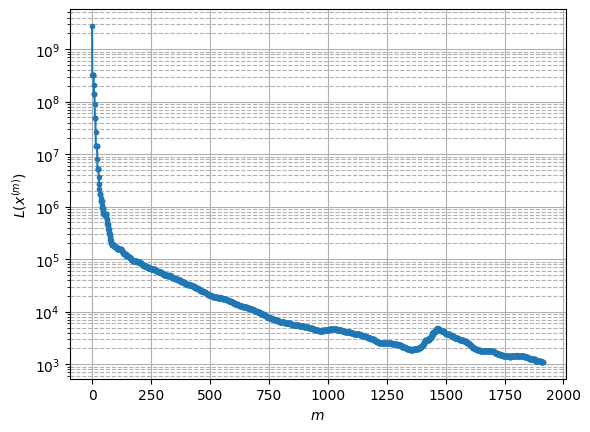

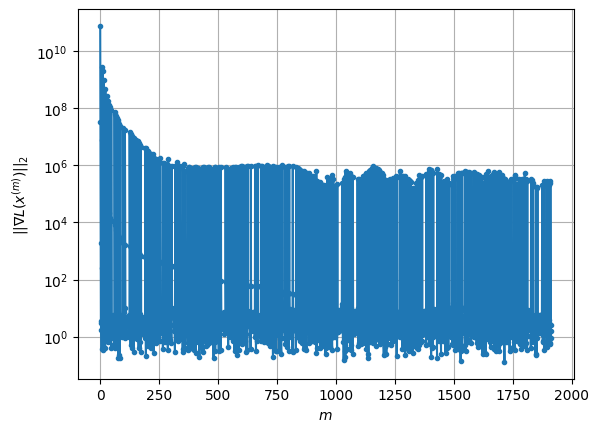

Windows:  73%|███████▎  | 217/296 [1:22:37<16:36, 12.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1114.9825293724061
Gradient norm: 227130.29563991632
Global relative error: 9.934160970111476
Position relative errors: 0.00908566399889899 m, 5.358293269784006 m, 8.262334092051956 m, 1.3055284590625873 m

Iteration 1
Cost function: 1111.1192989096794 (-0.35%)
Gradient norm: 2.712907718191018 (-100.00%)
Global relative error = 9.956724597956127 (0.23%)
Position relative errors: 0.008633972494153578 m, 5.361698772990941 m, 8.27846817286181 m, 1.3600961044019495 m

Iteration 2
Cost function: 1111.1192993237762 (0.00%)
Gradient norm: 3.4644120129538365 (27.70%)
Global relative error = 9.956724770892995 (0.00%)
Position relative errors: 0.00863397484746321 m, 5.361698787460693 m, 8.278468374679516 m, 1.3600960849463506 m

STOP on Iteration 3
Cost function = 1111.1192992827819 (-0.00%)
Gradient norm = 0.8259699669208392 (-76.16%)
Global relative error = 9.956724771019212 (0.00%)
Final position relative erro

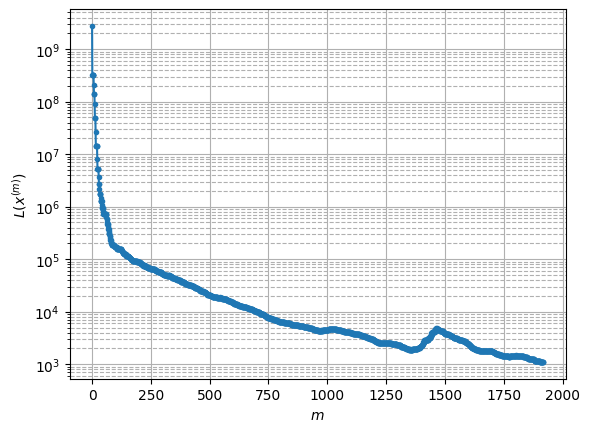

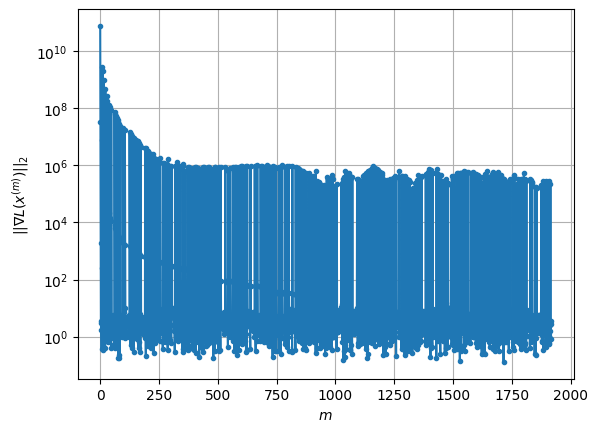

Windows:  74%|███████▎  | 218/296 [1:22:48<15:29, 11.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1117.3907810155952
Gradient norm: 327285.22600925283
Global relative error: 12.06174913836714
Position relative errors: 0.008774670123067879 m, 8.50163030632254 m, 7.570918933018527 m, 3.985431138013806 m

Iteration 1
Cost function: 1113.9974489677934 (-0.30%)
Gradient norm: 1.8465011295379634 (-100.00%)
Global relative error = 12.055084675198332 (-0.06%)
Position relative errors: 0.011436612641267448 m, 8.48423211843358 m, 7.588026496621007 m, 3.969771780631798 m

STOP on Iteration 2
Cost function = 1113.9974488298892 (-0.00%)
Gradient norm = 0.8852024182316044 (-52.06%)
Global relative error = 12.055084806306953 (0.00%)
Final position relative errors: 0.011436604160863353 m, 8.484232141261955 m, 7.588026679445928 m, 3.9697717805458663 m

Majorization-Minimization converged after 1 iterations


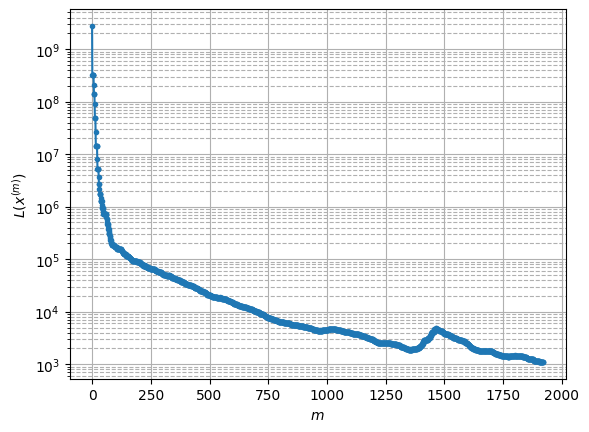

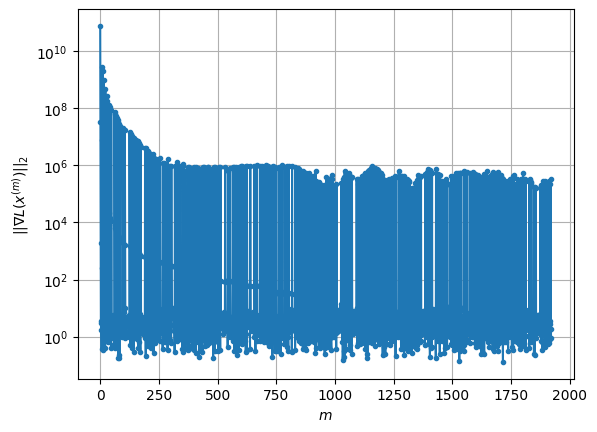

Windows:  74%|███████▍  | 219/296 [1:22:56<13:52, 10.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1113.2077529151263
Gradient norm: 202677.00281596338
Global relative error: 15.155530383551117
Position relative errors: 0.011462718115491231 m, 11.628984260455244 m, 6.866124590132588 m, 6.878053797342465 m

Iteration 1
Cost function: 1109.7990406685033 (-0.31%)
Gradient norm: 1.51775693296416 (-100.00%)
Global relative error = 15.138527187098504 (-0.11%)
Position relative errors: 0.023186434650898684 m, 11.60563221611138 m, 6.897429797622162 m, 6.84863794379117 m

Iteration 2
Cost function: 1109.799041556202 (0.00%)
Gradient norm: 1.354467552295065 (-10.76%)
Global relative error = 15.13852729833714 (0.00%)
Position relative errors: 0.023186423932973918 m, 11.605632258303478 m, 6.897429973061459 m, 6.8486379415262855 m

Iteration 3
Cost function: 1109.7990419094112 (0.00%)
Gradient norm: 4.7768112109145795 (252.67%)
Global relative error = 15.138527298655951 (0.00%)
Position relative errors: 0.0231864

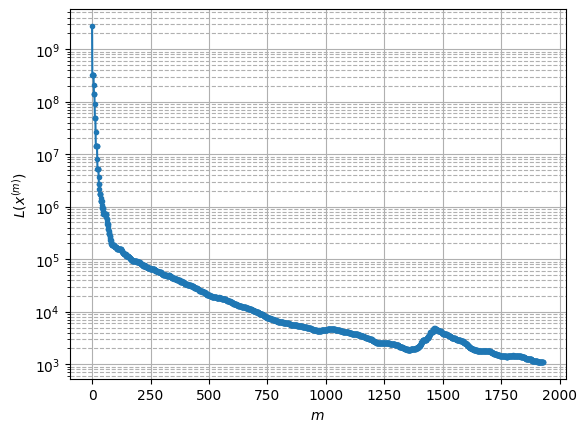

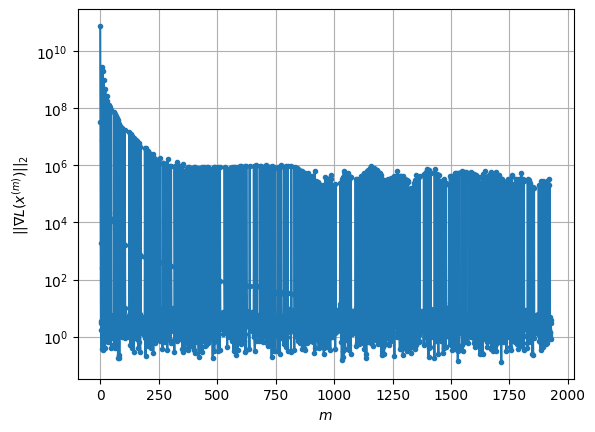

Windows:  74%|███████▍  | 220/296 [1:23:17<17:24, 13.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1126.8889822858841
Gradient norm: 355984.17001393787
Global relative error: 18.704254781285595
Position relative errors: 0.022677466403927152 m, 14.712153495258748 m, 6.167955227547534 m, 9.76484808948962 m

Iteration 1
Cost function: 1123.6404647675415 (-0.29%)
Gradient norm: 5.249212798280202 (-100.00%)
Global relative error = 18.660983436957306 (-0.23%)
Position relative errors: 0.015281361983775825 m, 14.676220655329981 m, 6.177904610097753 m, 9.729793604477226 m

Iteration 2
Cost function: 1123.6404661189804 (0.00%)
Gradient norm: 6.5666776964840645 (25.10%)
Global relative error = 18.66098350223623 (0.00%)
Position relative errors: 0.015281360875526279 m, 14.676220678541846 m, 6.177904753793531 m, 9.72979360342716 m

Iteration 3
Cost function: 1123.6404662392163 (0.00%)
Gradient norm: 5.140283242197542 (-21.72%)
Global relative error = 18.66098350230743 (0.00%)
Position relative errors: 0.01528135

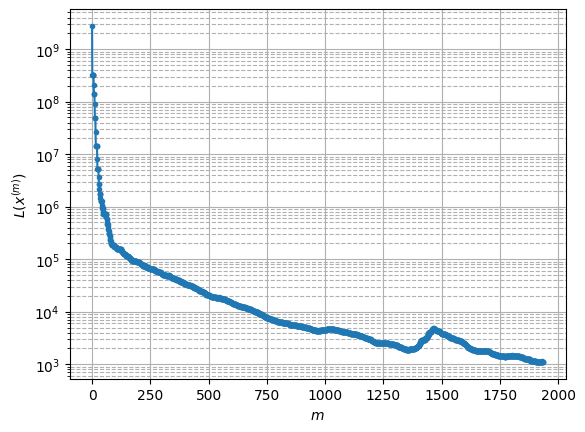

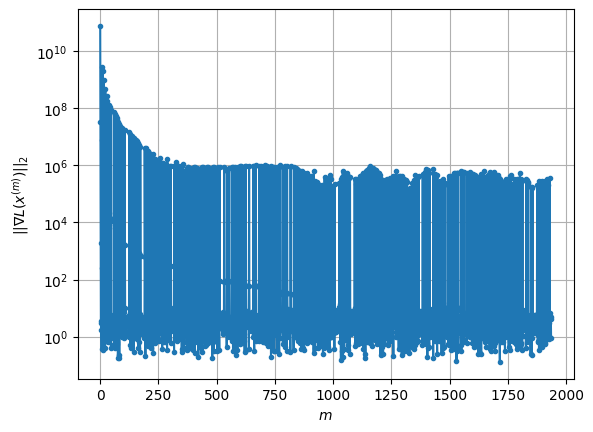

Windows:  75%|███████▍  | 221/296 [1:23:34<18:33, 14.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1137.8546912575082
Gradient norm: 327551.5581531731
Global relative error: 22.426597421511232
Position relative errors: 0.015190690377669088 m, 17.725250088402085 m, 5.447417658380114 m, 12.613015166459085 m

STOP on Iteration 1
Cost function = 1133.9931177207118 (-0.34%)
Gradient norm = 0.3121661673769872 (-100.00%)
Global relative error = 22.36505527468523 (-0.27%)
Final position relative errors: 0.01483154811788413 m, 17.681504014507713 m, 5.424732744535679 m, 12.57486153427932 m

Majorization-Minimization converged after 1 iterations


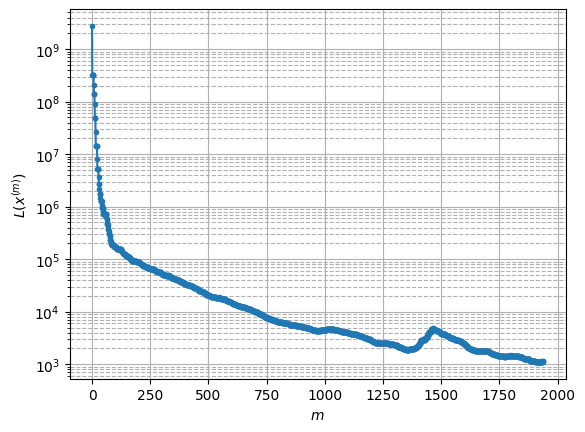

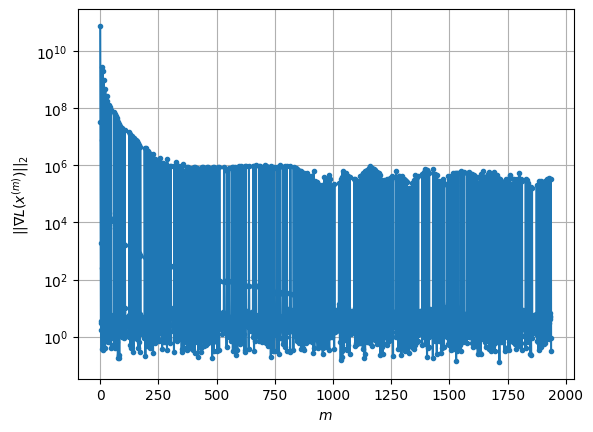

Windows:  75%|███████▌  | 222/296 [1:23:40<14:56, 12.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1158.7537989014918
Gradient norm: 292638.37887195655
Global relative error: 26.194150619245267
Position relative errors: 0.014723491275938295 m, 20.656530094361823 m, 4.700752769116385 m, 15.405817016849504 m

STOP on Iteration 1
Cost function = 1154.9478296465031 (-0.33%)
Gradient norm = 0.49102423564709596 (-100.00%)
Global relative error = 26.130150879024942 (-0.24%)
Final position relative errors: 0.014841247731488911 m, 20.60719826214739 m, 4.69664948239462 m, 15.36439526241223 m

Majorization-Minimization converged after 1 iterations


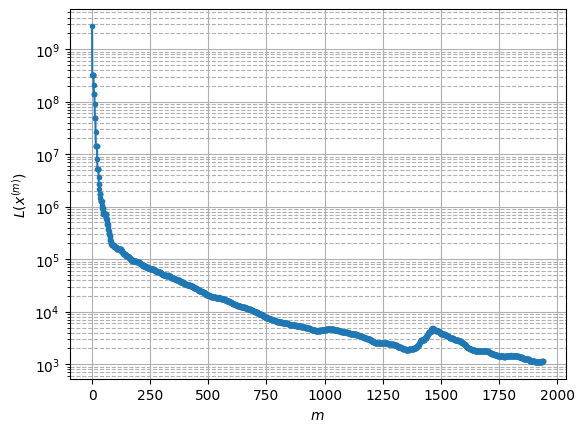

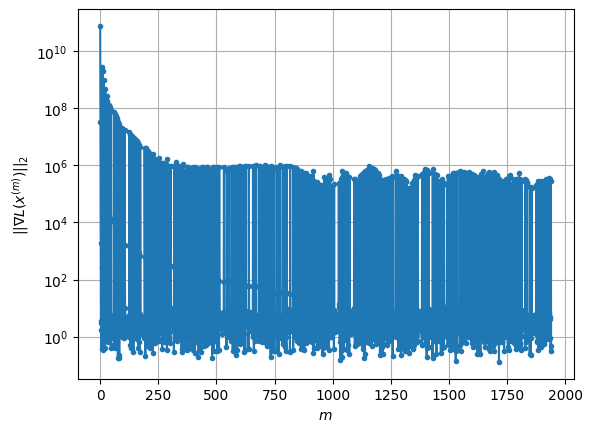

Windows:  75%|███████▌  | 223/296 [1:23:45<12:19, 10.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1176.2324026791098
Gradient norm: 371063.1941423276
Global relative error: 29.94207067456702
Position relative errors: 0.014689843178068174 m, 23.49348704992234 m, 3.99611537912582 m, 18.127602744984273 m

Iteration 1
Cost function: 1171.3004799732144 (-0.42%)
Gradient norm: 3.5233369124645675 (-100.00%)
Global relative error = 29.866491100492397 (-0.25%)
Position relative errors: 0.013420911606053538 m, 23.440684308626658 m, 3.9430670156765544 m, 18.082840981974712 m

Iteration 2
Cost function: 1171.300480205364 (0.00%)
Gradient norm: 2.290728784369051 (-34.98%)
Global relative error = 29.86649107207804 (-0.00%)
Position relative errors: 0.01342092250401892 m, 23.44068432809399 m, 3.9430667220225275 m, 18.0828409738337 m

Iteration 3
Cost function: 1171.3004809258282 (0.00%)
Gradient norm: 1.0666012085889724 (-53.44%)
Global relative error = 29.866491072429856 (0.00%)
Position relative errors: 0.013420

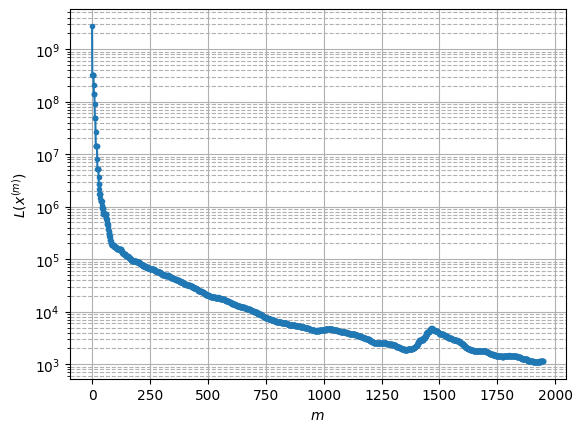

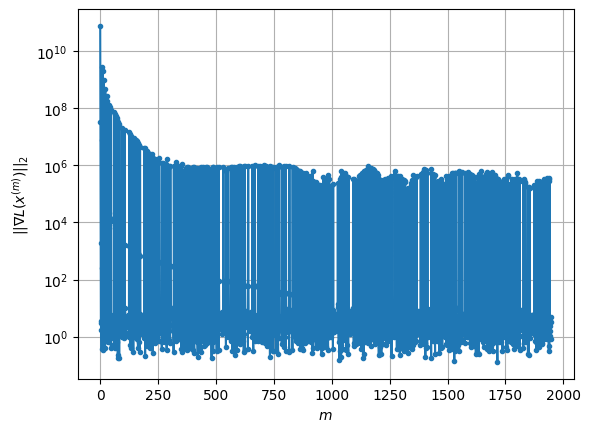

Windows:  76%|███████▌  | 224/296 [1:24:06<15:59, 13.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1178.3849802785553
Gradient norm: 318185.1166568414
Global relative error: 33.61173143350827
Position relative errors: 0.013259155406028674 m, 26.22497284398408 m, 3.282488514110724 m, 20.76584109396778 m

STOP on Iteration 1
Cost function = 1172.8712940039406 (-0.47%)
Gradient norm = 0.3423659737623406 (-100.00%)
Global relative error = 33.53243608650416 (-0.24%)
Final position relative errors: 0.011010834470630155 m, 26.1673811417911 m, 3.208847464569073 m, 20.721761429414812 m

Majorization-Minimization converged after 1 iterations


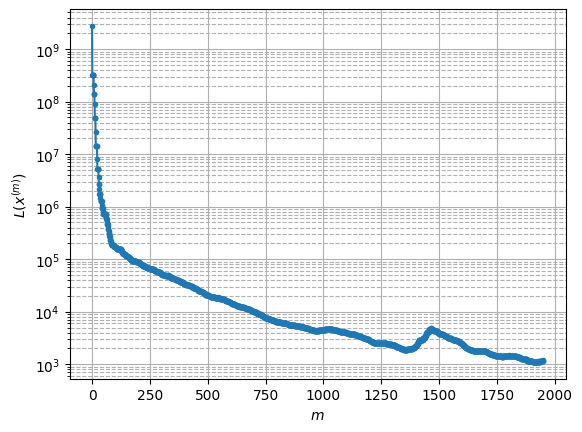

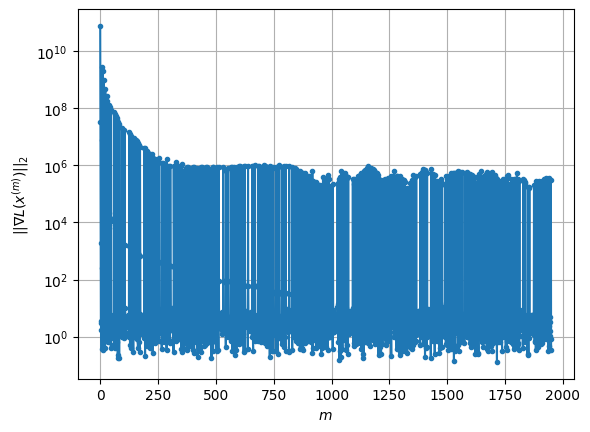

Windows:  76%|███████▌  | 225/296 [1:24:12<13:05, 11.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1172.4938661618555
Gradient norm: 293488.05627994565
Global relative error: 37.17450548379015
Position relative errors: 0.01090769908211975 m, 28.83729315678944 m, 2.626287468860296 m, 23.312077860361697 m

Iteration 1
Cost function: 1167.1292850623515 (-0.46%)
Gradient norm: 3.9739845998729897 (-100.00%)
Global relative error = 37.09583381190769 (-0.21%)
Position relative errors: 0.007987746894366538 m, 28.780751312501586 m, 2.523321580800876 m, 23.267963669749342 m

Iteration 2
Cost function: 1167.1292844588215 (-0.00%)
Gradient norm: 1.543074676249183 (-61.17%)
Global relative error = 37.09583376467731 (-0.00%)
Position relative errors: 0.007987734855631437 m, 28.78075130649627 m, 2.5233210675109126 m, 23.26796365754723 m

Iteration 3
Cost function: 1167.129286668728 (0.00%)
Gradient norm: 2.2166487793691365 (43.65%)
Global relative error = 37.09583376502166 (0.00%)
Position relative errors: 0.007987

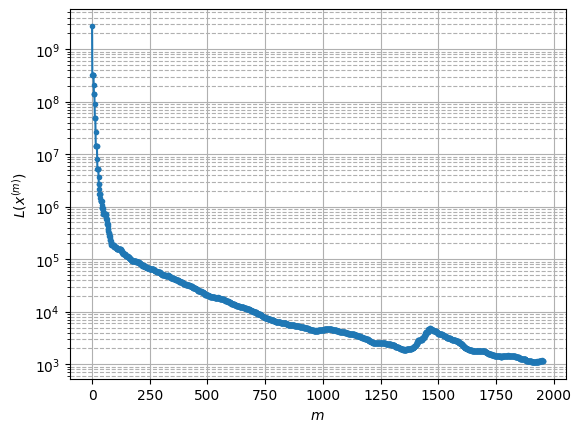

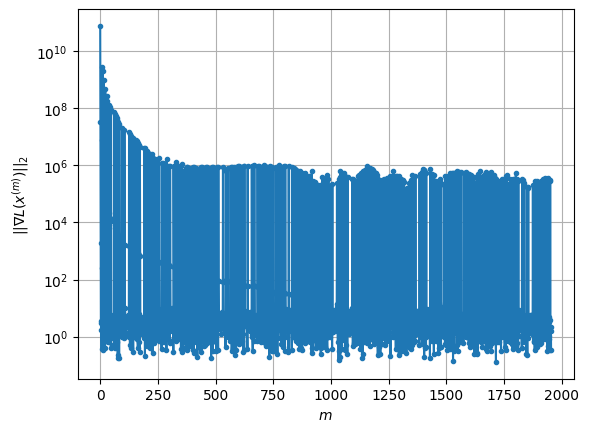

Windows:  76%|███████▋  | 226/296 [1:24:24<13:28, 11.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1153.5032062320106
Gradient norm: 351753.9190672629
Global relative error: 40.60595047365964
Position relative errors: 0.007703086362318957 m, 31.32421053781068 m, 2.0895705946387757 m, 25.753972943039717 m

Iteration 1
Cost function: 1146.4842868503479 (-0.61%)
Gradient norm: 2.0709381722660236 (-100.00%)
Global relative error = 40.52728961296655 (-0.19%)
Position relative errors: 0.007863782433784326 m, 31.26927003961349 m, 1.8873374983746034 m, 25.712415270036693 m

Iteration 2
Cost function: 1146.484287148191 (0.00%)
Gradient norm: 2.2817164150105085 (10.18%)
Global relative error = 40.52728953379837 (-0.00%)
Position relative errors: 0.007863758469921035 m, 31.269270028131462 m, 1.8873361957529078 m, 25.712415254839467 m

STOP on Iteration 3
Cost function = 1146.4842862788537 (-0.00%)
Gradient norm = 0.8916891960313263 (-60.92%)
Global relative error = 40.52728953348429 (-0.00%)
Final position rela

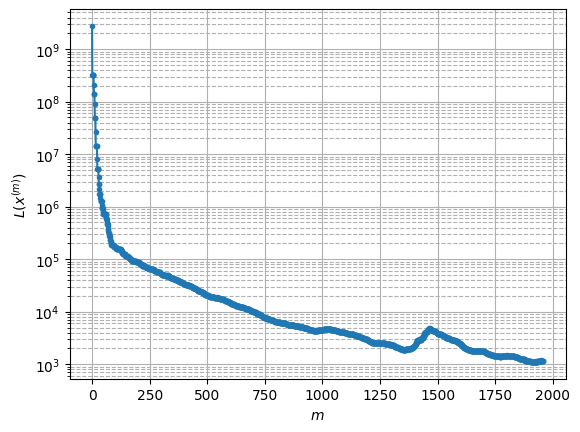

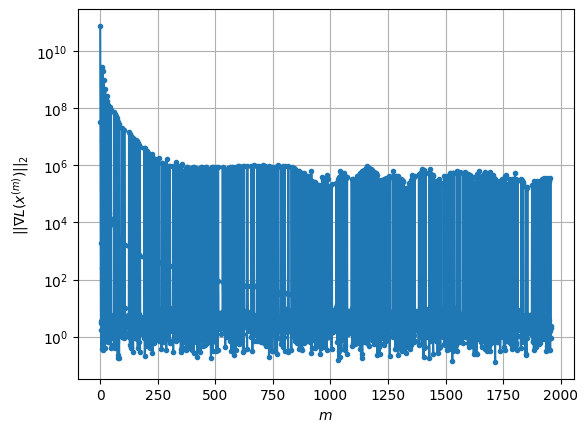

Windows:  77%|███████▋  | 227/296 [1:24:35<12:57, 11.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1143.199508703546
Gradient norm: 365332.9134981329
Global relative error: 43.88222390836968
Position relative errors: 0.00772384125250301 m, 33.67509495585626 m, 1.724709029168 m, 28.083085046652624 m

Iteration 1
Cost function: 1137.0186624873809 (-0.54%)
Gradient norm: 1.699583578426176 (-100.00%)
Global relative error = 43.804927957839496 (-0.18%)
Position relative errors: 0.014717684181556568 m, 33.618762729650044 m, 1.5049997288044836 m, 28.042504628810356 m

Iteration 2
Cost function: 1137.0186652673233 (0.00%)
Gradient norm: 4.607855887751025 (171.12%)
Global relative error = 43.80492791062888 (-0.00%)
Position relative errors: 0.01471762884862827 m, 33.61876273380433 m, 1.5049984667408929 m, 28.042504617844997 m

STOP on Iteration 3
Cost function = 1137.0186638399505 (-0.00%)
Gradient norm = 0.6338114738626082 (-86.24%)
Global relative error = 43.804927910032994 (-0.00%)
Final position relative 

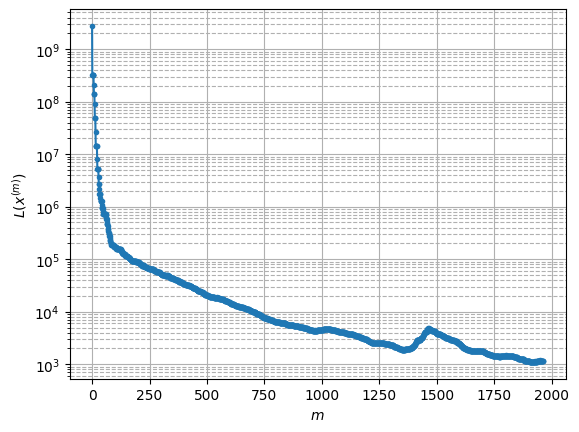

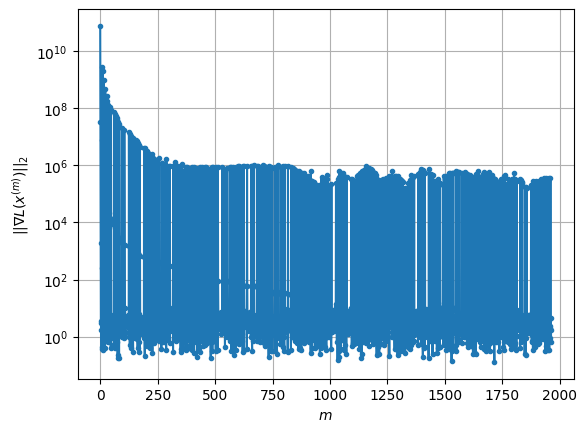

Windows:  77%|███████▋  | 228/296 [1:24:46<12:31, 11.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1117.7873838947778
Gradient norm: 236172.5065391863
Global relative error: 46.9845579093989
Position relative errors: 0.01440136091180338 m, 35.87663034655842 m, 1.753915175850588 m, 30.287568424859813 m

Iteration 1
Cost function: 1111.877819115527 (-0.53%)
Gradient norm: 5.209936247490132 (-100.00%)
Global relative error = 46.910491489226004 (-0.16%)
Position relative errors: 0.011895735386041531 m, 35.823167778127996 m, 1.53097350426142 m, 30.248107352635927 m

Iteration 2
Cost function: 1111.8778206726158 (0.00%)
Gradient norm: 2.4994293442633317 (-52.03%)
Global relative error = 46.91049142969883 (-0.00%)
Position relative errors: 0.011895684486119053 m, 35.82316777413207 m, 1.530972007327958 m, 30.248107340835926 m

STOP on Iteration 3
Cost function = 1111.8778194441036 (-0.00%)
Gradient norm = 0.8770724809200716 (-64.91%)
Global relative error = 46.910491429940855 (0.00%)
Final position relative 

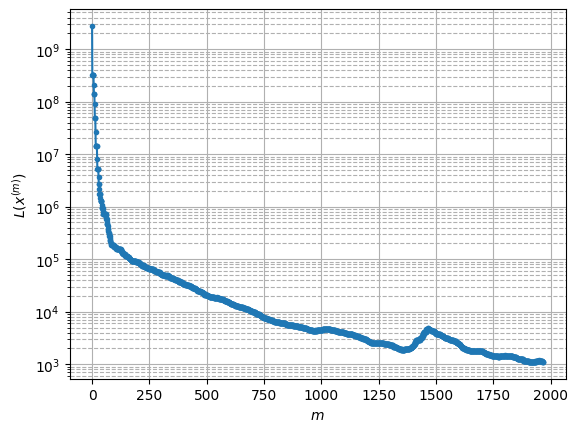

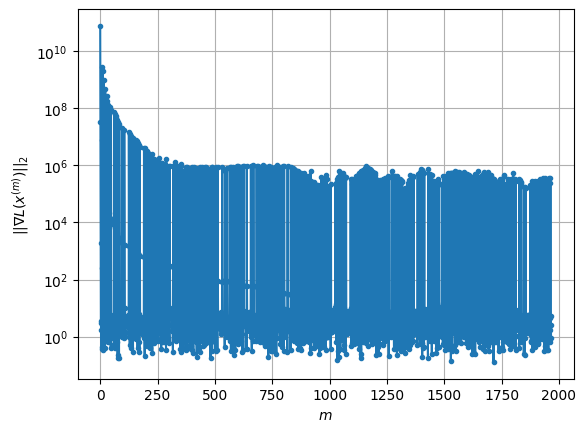

Windows:  77%|███████▋  | 229/296 [1:24:56<12:07, 10.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1082.4778511048517
Gradient norm: 256482.20125274512
Global relative error: 49.89726258157845
Position relative errors: 0.011600069821847322 m, 37.92322133400532 m, 2.1269291394188596 m, 32.35799193787129 m

STOP on Iteration 1
Cost function = 1076.5186110647542 (-0.55%)
Gradient norm = 0.7400557066832786 (-100.00%)
Global relative error = 49.8268786897685 (-0.14%)
Final position relative errors: 0.004859512983476152 m, 37.87191579765476 m, 1.9467471959424767 m, 32.32094521356006 m

Majorization-Minimization converged after 1 iterations


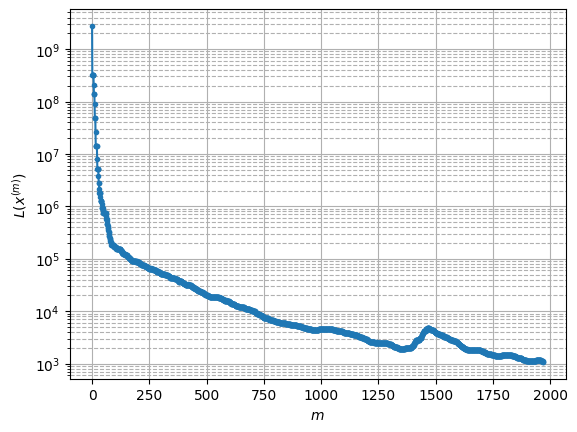

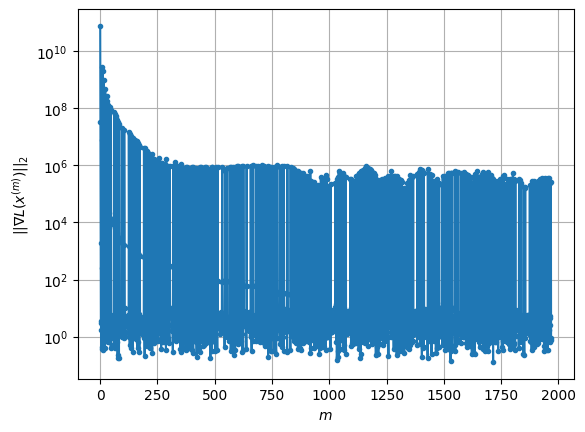

Windows:  78%|███████▊  | 230/296 [1:25:02<10:15,  9.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1041.1366105286927
Gradient norm: 381132.77142773167
Global relative error: 52.6053850091032
Position relative errors: 0.004857123881228841 m, 39.80513944660217 m, 2.701177706788314 m, 34.286715787089584 m

Iteration 1
Cost function: 1033.7928626423584 (-0.71%)
Gradient norm: 2.112963940123471 (-100.00%)
Global relative error = 52.53923048024191 (-0.13%)
Position relative errors: 0.021690897488267268 m, 39.75727031909917 m, 2.5610487831799706 m, 34.251549140761085 m

Iteration 2
Cost function: 1033.7928621331714 (-0.00%)
Gradient norm: 4.080007835536232 (93.09%)
Global relative error = 52.53923039837871 (-0.00%)
Position relative errors: 0.021690847973668874 m, 39.75727028864496 m, 2.561047730068718 m, 34.25154912931324 m

Iteration 3
Cost function: 1033.792862784851 (0.00%)
Gradient norm: 2.8719450957293975 (-29.61%)
Global relative error = 52.53923039826111 (-0.00%)
Position relative errors: 0.0216908

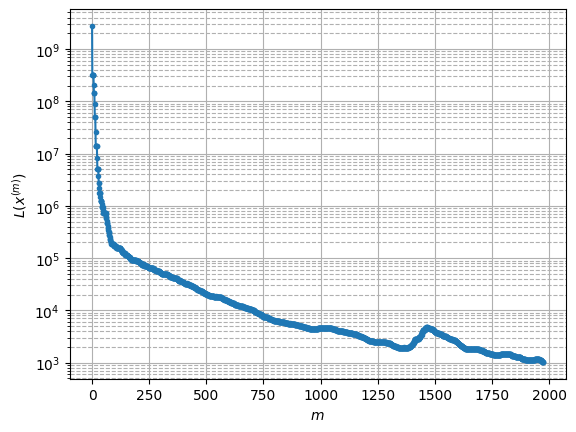

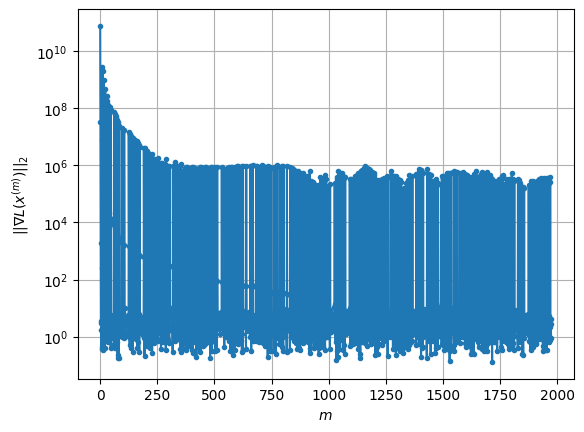

Windows:  78%|███████▊  | 231/296 [1:25:15<11:19, 10.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 998.8834061923055
Gradient norm: 236692.34532392843
Global relative error: 55.09579274580589
Position relative errors: 0.021182753272698637 m, 41.51549592435697 m, 3.365291878571098 m, 36.06497657234654 m

Iteration 1
Cost function: 991.4716478514209 (-0.74%)
Gradient norm: 5.217967983749815 (-100.00%)
Global relative error = 55.03507839925918 (-0.11%)
Position relative errors: 0.01669953918448233 m, 41.47180683585819 m, 3.2687954519063176 m, 36.03140283713533 m

Iteration 2
Cost function: 991.4716482675562 (0.00%)
Gradient norm: 2.221787201921138 (-57.42%)
Global relative error = 55.035078310350585 (-0.00%)
Position relative errors: 0.016699484770745305 m, 41.47180680495097 m, 3.2687944616670443 m, 36.031402826769046 m

Iteration 3
Cost function: 991.4716478297366 (-0.00%)
Gradient norm: 2.7315171638637197 (22.94%)
Global relative error = 55.03507831017007 (-0.00%)
Position relative errors: 0.016699489

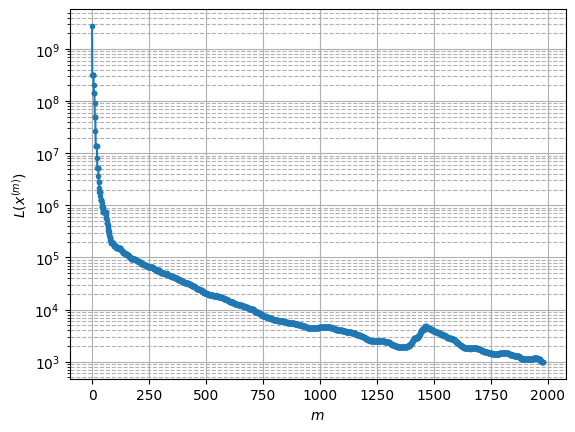

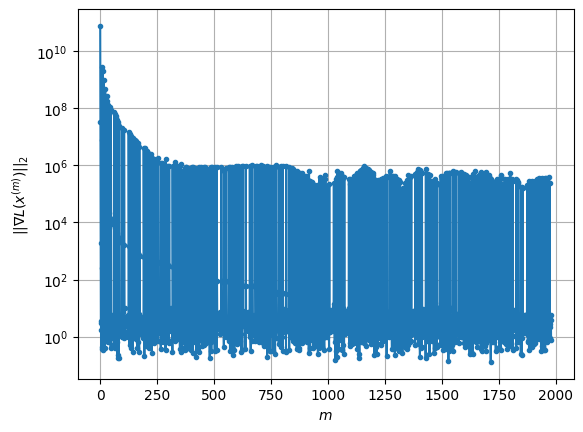

Windows:  78%|███████▊  | 232/296 [1:25:33<13:33, 12.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 963.1919285578164
Gradient norm: 276250.33393448725
Global relative error: 57.357486187044536
Position relative errors: 0.01643963682930388 m, 43.047585614772544 m, 4.078158692114035 m, 37.684923548507136 m

Iteration 1
Cost function: 956.7412397555785 (-0.67%)
Gradient norm: 7.4377186073641 (-100.00%)
Global relative error = 57.30122999860746 (-0.10%)
Position relative errors: 0.014112294549174516 m, 43.007165153167406 m, 4.02165063180612 m, 37.651551783599295 m

STOP on Iteration 2
Cost function = 956.7412387702891 (-0.00%)
Gradient norm = 0.7634240994612309 (-89.74%)
Global relative error = 57.30122993622775 (-0.00%)
Final position relative errors: 0.014112261833685068 m, 43.00716512837093 m, 4.021650078692948 m, 37.65155177607991 m

Majorization-Minimization converged after 1 iterations


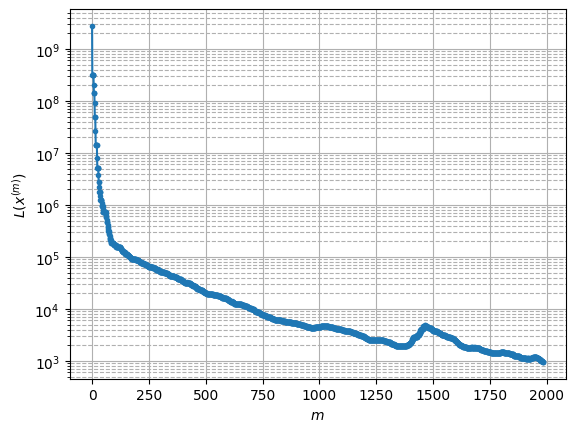

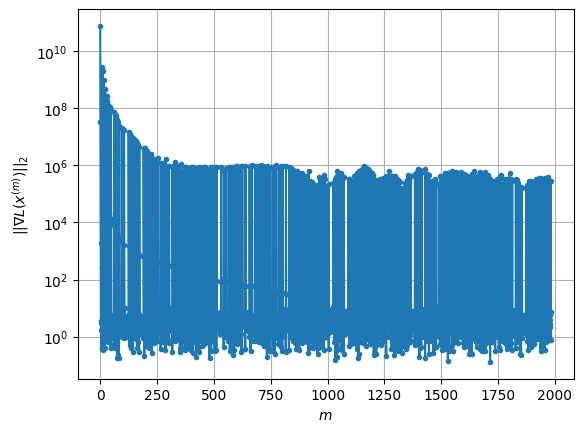

Windows:  79%|███████▊  | 233/296 [1:25:41<11:58, 11.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 934.6128488029968
Gradient norm: 274867.3346472289
Global relative error: 59.37879790914655
Position relative errors: 0.013859297327477307 m, 44.39390914890125 m, 4.817765448234955 m, 39.13834729875976 m

Iteration 1
Cost function: 928.3096078859866 (-0.67%)
Gradient norm: 7.07464066262523 (-100.00%)
Global relative error = 59.325952568550804 (-0.09%)
Position relative errors: 0.00413169948947947 m, 44.356170157031244 m, 4.77542028215632 m, 39.10617568556642 m

Iteration 2
Cost function: 928.3096083003584 (0.00%)
Gradient norm: 2.4562366489323355 (-65.28%)
Global relative error = 59.325952509385594 (-0.00%)
Position relative errors: 0.0041316862479990205 m, 44.35617012222571 m, 4.775419925588116 m, 39.106175678831576 m

Iteration 3
Cost function: 928.3096086809261 (0.00%)
Gradient norm: 4.520079079231208 (84.02%)
Global relative error = 59.32595250908559 (-0.00%)
Position relative errors: 0.004131690301

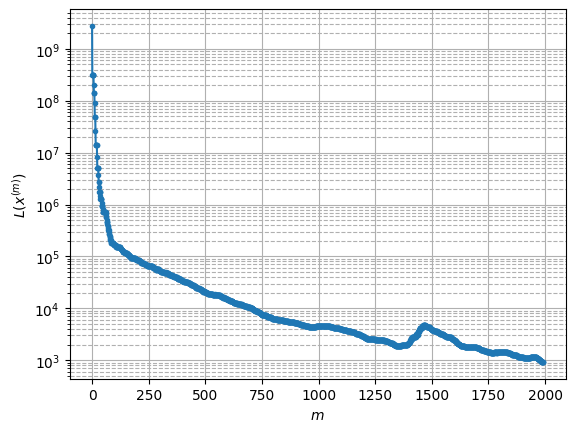

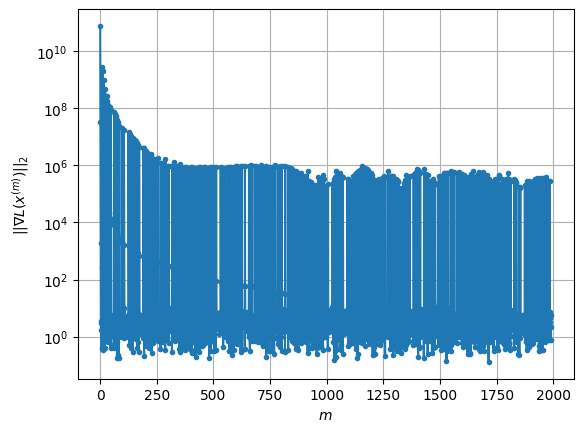

Windows:  79%|███████▉  | 234/296 [1:26:03<14:56, 14.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 902.4075475556965
Gradient norm: 220330.64439311286
Global relative error: 61.14926661771563
Position relative errors: 0.0044278666912931555 m, 45.548175064194616 m, 5.55062942666688 m, 40.420120380279066 m

STOP on Iteration 1
Cost function = 897.6220695393471 (-0.53%)
Gradient norm = 0.6044839479612883 (-100.00%)
Global relative error = 61.09991797283053 (-0.08%)
Final position relative errors: 0.007042504093946695 m, 45.510850966763115 m, 5.538578861416484 m, 40.389176747691124 m

Majorization-Minimization converged after 1 iterations


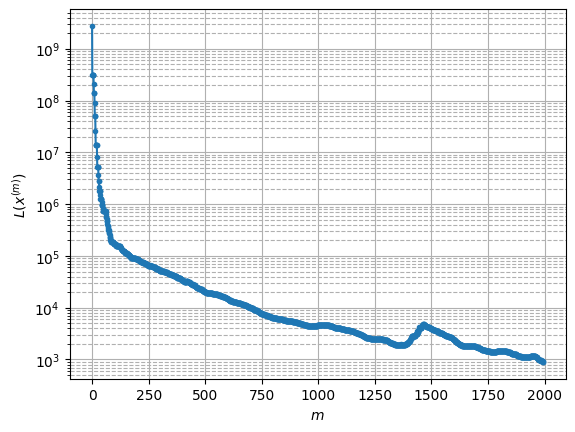

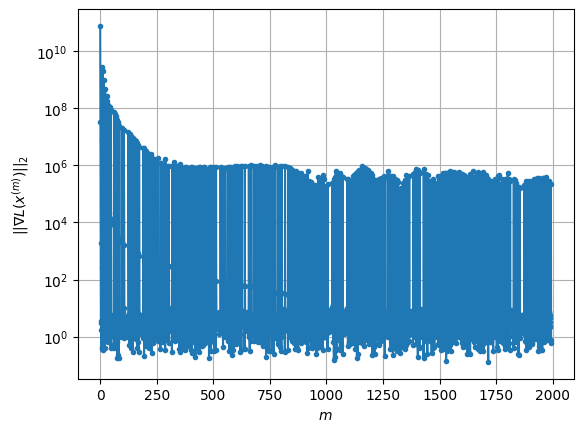

Windows:  79%|███████▉  | 235/296 [1:26:08<11:59, 11.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 862.4358214471129
Gradient norm: 205214.90661643457
Global relative error: 62.66126135712197
Position relative errors: 0.0066606708416530915 m, 46.503399951856316 m, 6.288253334122442 m, 41.52498779329045 m

Iteration 1
Cost function: 858.5802123199294 (-0.45%)
Gradient norm: 1.4525956452089623 (-100.00%)
Global relative error = 62.61506530229612 (-0.07%)
Position relative errors: 0.009596203966995885 m, 46.466351618141694 m, 6.303363955182357 m, 41.494474323816185 m

Iteration 2
Cost function: 858.5802120649348 (-0.00%)
Gradient norm: 6.967332008830083 (379.65%)
Global relative error = 62.61506528659065 (-0.00%)
Position relative errors: 0.00959619343063962 m, 46.46635160549709 m, 6.303363941050973 m, 41.494474316425475 m

Iteration 3
Cost function: 858.5802113776756 (-0.00%)
Gradient norm: 1.694475561304099 (-75.68%)
Global relative error = 62.615065286568516 (-0.00%)
Position relative errors: 0.00959

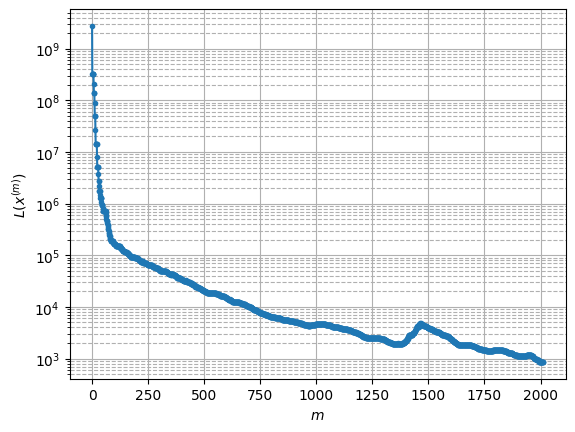

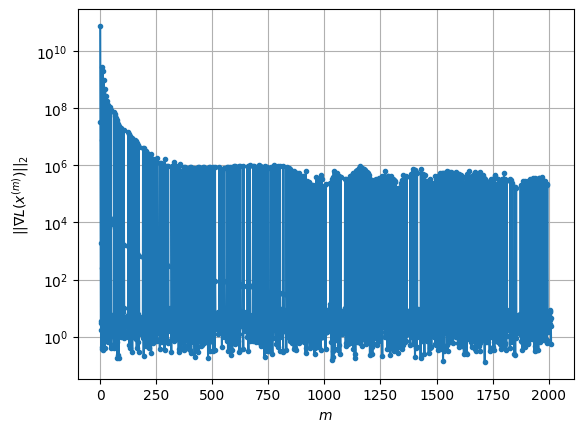

Windows:  80%|███████▉  | 236/296 [1:26:53<21:32, 21.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 849.6305783071257
Gradient norm: 249376.2557494077
Global relative error: 63.907962842737604
Position relative errors: 0.00952646046952094 m, 47.25557481591502 m, 7.023389556285033 m, 42.447730084227864 m

Iteration 1
Cost function: 846.0273257694141 (-0.42%)
Gradient norm: 2.8501892365558703 (-100.00%)
Global relative error = 63.863339353961216 (-0.07%)
Position relative errors: 0.00700323985906106 m, 47.21776334017685 m, 7.046796405856402 m, 42.41875844174108 m

STOP on Iteration 2
Cost function = 846.0273253947059 (-0.00%)
Gradient norm = 0.8264771646001449 (-71.00%)
Global relative error = 63.863339341871885 (-0.00%)
Final position relative errors: 0.0070032276024892485 m, 47.21776332148799 m, 7.046796456730364 m, 42.418758435893885 m

Majorization-Minimization converged after 1 iterations


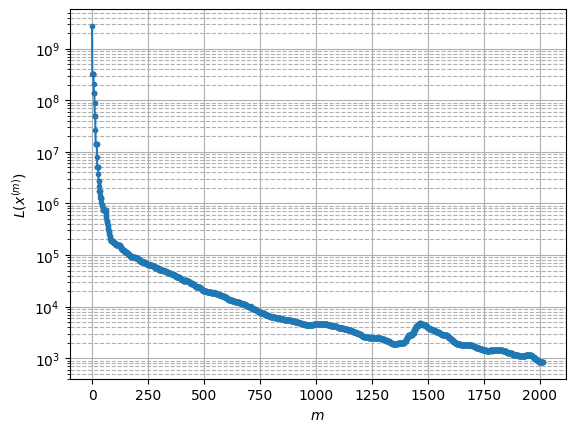

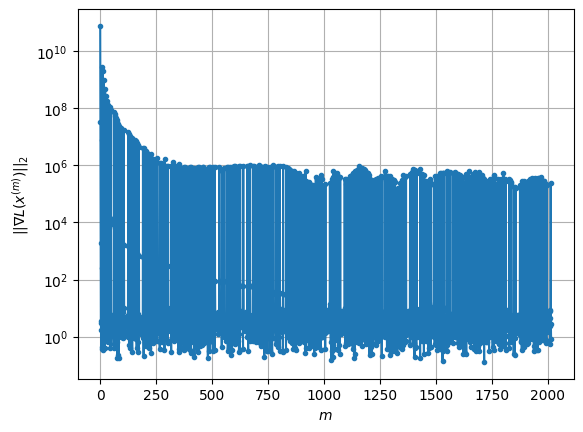

Windows:  80%|████████  | 237/296 [1:27:00<17:08, 17.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 838.8226382336671
Gradient norm: 340646.475594581
Global relative error: 64.88241547071168
Position relative errors: 0.0070976421284107034 m, 47.80070857613659 m, 7.733800725487728 m, 43.18573897053561 m

Iteration 1
Cost function: 835.7901293972648 (-0.36%)
Gradient norm: 1.1157306055792597 (-100.00%)
Global relative error = 64.83704364888258 (-0.07%)
Position relative errors: 0.025282806816217487 m, 47.763134022404365 m, 7.756326626874153 m, 43.15511201867579 m

STOP on Iteration 2
Cost function = 835.790128169755 (-0.00%)
Gradient norm = 0.24296491833305855 (-78.22%)
Global relative error = 64.83704363878535 (-0.00%)
Final position relative errors: 0.02528280400336562 m, 47.76313400615356 m, 7.756326673219009 m, 43.15511201316359 m

Majorization-Minimization converged after 1 iterations


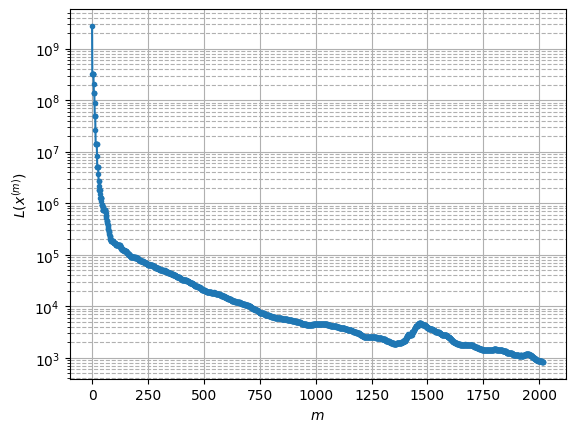

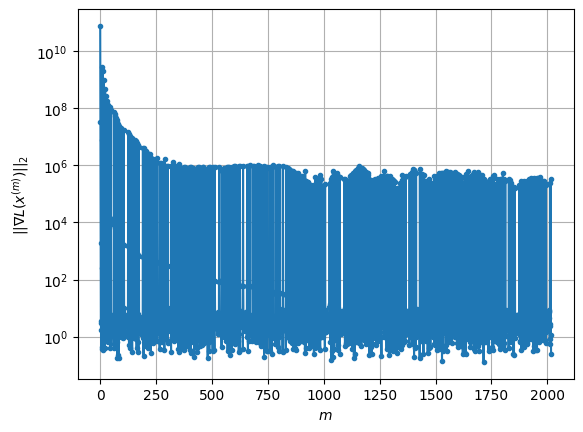

Windows:  80%|████████  | 238/296 [1:27:08<14:03, 14.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 850.9368487384902
Gradient norm: 263564.30882384285
Global relative error: 65.57821981418583
Position relative errors: 0.024831244572136 m, 48.1376597599122 m, 8.406847148248337 m, 43.733199369557184 m

Iteration 1
Cost function: 848.9273173484418 (-0.24%)
Gradient norm: 1.5665697306563633 (-100.00%)
Global relative error = 65.53042857070136 (-0.07%)
Position relative errors: 0.01823453865924236 m, 48.099636894500385 m, 8.42469927342408 m, 43.69995314892317 m

Iteration 2
Cost function: 848.9273175507097 (0.00%)
Gradient norm: 4.859500194894647 (210.20%)
Global relative error = 65.53042855632174 (-0.00%)
Position relative errors: 0.018234540549599863 m, 48.09963687638762 m, 8.424699299426065 m, 43.69995314228291 m

Iteration 3
Cost function: 848.927316656536 (-0.00%)
Gradient norm: 8.171350507361948 (68.15%)
Global relative error = 65.53042855639268 (0.00%)
Position relative errors: 0.018234539176852672

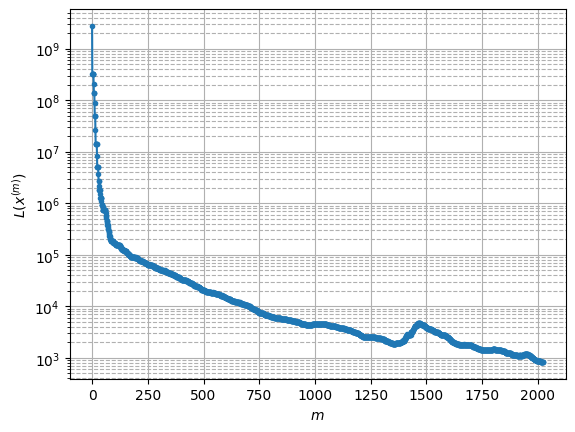

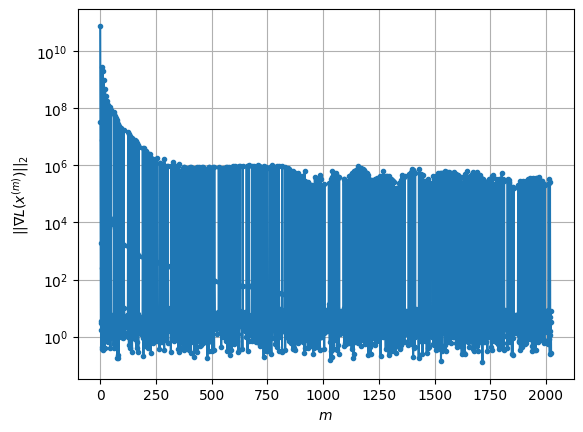

Windows:  81%|████████  | 239/296 [1:27:24<14:06, 14.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 861.140683850152
Gradient norm: 219712.26758365854
Global relative error: 65.99100339931884
Position relative errors: 0.018390338820656858 m, 48.26457706738526 m, 9.036048429622493 m, 44.08732801303446 m

Iteration 1
Cost function: 859.2835158214982 (-0.22%)
Gradient norm: 1.8735912934921413 (-100.00%)
Global relative error = 65.94075265474275 (-0.08%)
Position relative errors: 0.02135076331826059 m, 48.22566737305229 m, 9.049403821482835 m, 44.05196446227014 m

Iteration 2
Cost function: 859.2835151211607 (-0.00%)
Gradient norm: 2.594024345658182 (38.45%)
Global relative error = 65.94075263597904 (-0.00%)
Position relative errors: 0.021350762447179268 m, 48.22566735053074 m, 9.049403836237275 m, 44.05196445580785 m

Iteration 3
Cost function: 859.2835145267286 (-0.00%)
Gradient norm: 2.429242162808906 (-6.35%)
Global relative error = 65.94075263659803 (0.00%)
Position relative errors: 0.021350760236920

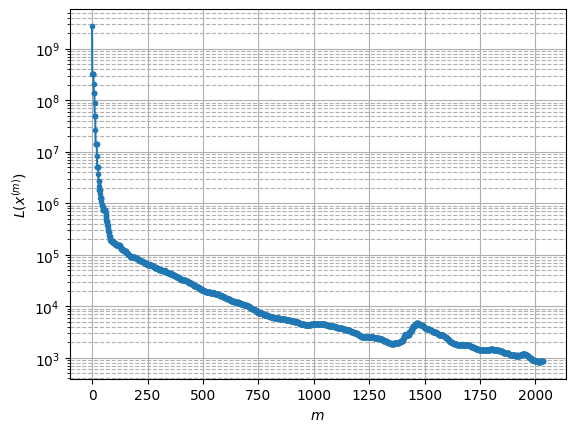

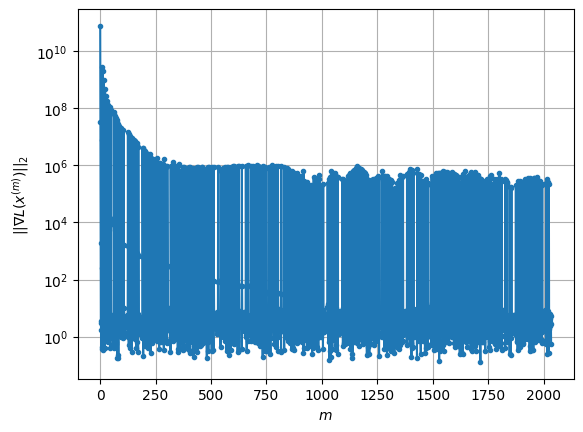

Windows:  81%|████████  | 240/296 [1:27:52<17:28, 18.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 873.6419078753246
Gradient norm: 264287.26408110885
Global relative error: 66.11922513812037
Position relative errors: 0.021619088634474093 m, 48.18077321618024 m, 9.61885365085775 m, 44.24750968067749 m

Iteration 1
Cost function: 871.28332157853 (-0.27%)
Gradient norm: 8.163824926136504 (-100.00%)
Global relative error = 66.06755798591963 (-0.08%)
Position relative errors: 0.013584719694687553 m, 48.1413255183212 m, 9.630298333241706 m, 44.21076867216304 m

Iteration 2
Cost function: 871.2833214187586 (-0.00%)
Gradient norm: 1.7996279581795587 (-77.96%)
Global relative error = 66.06755796997562 (-0.00%)
Position relative errors: 0.013584716754054623 m, 48.14132550241586 m, 9.630298346010752 m, 44.210768662875516 m

Iteration 3
Cost function: 871.2833224366328 (0.00%)
Gradient norm: 3.441221834280781 (91.22%)
Global relative error = 66.067557970448 (0.00%)
Position relative errors: 0.013584721386655957

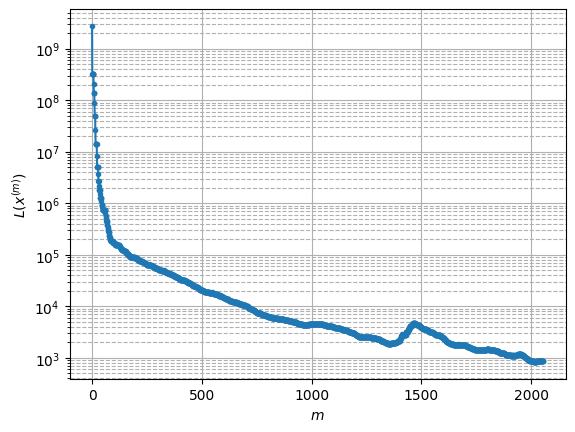

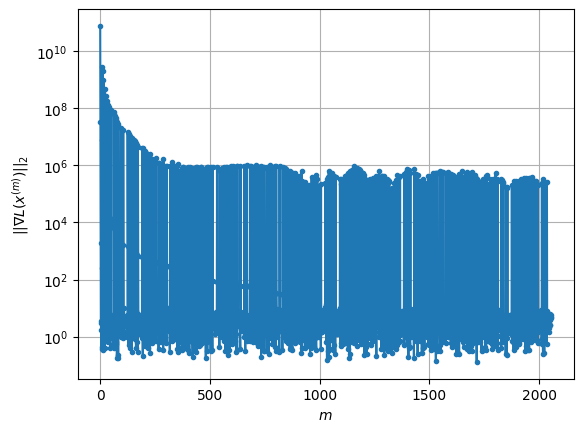

Windows:  81%|████████▏ | 241/296 [1:28:43<26:14, 28.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 886.2544408489083
Gradient norm: 429093.2635934367
Global relative error: 65.96363800121509
Position relative errors: 0.014288506794335807 m, 47.8872465842115 m, 10.155035284155415 m, 44.2141164442867 m

Iteration 1
Cost function: 884.2158171626662 (-0.23%)
Gradient norm: 3.017505859792606 (-100.00%)
Global relative error = 65.90959227168933 (-0.08%)
Position relative errors: 0.019158149501376617 m, 47.84819154045176 m, 10.16290143824773 m, 44.173972812804095 m

STOP on Iteration 2
Cost function = 884.2158170620625 (-0.00%)
Gradient norm = 0.47053117077135986 (-84.41%)
Global relative error = 65.90959225380948 (-0.00%)
Final position relative errors: 0.019158146947913436 m, 47.84819152348378 m, 10.162901445285687 m, 44.17397280288777 m

Majorization-Minimization converged after 1 iterations


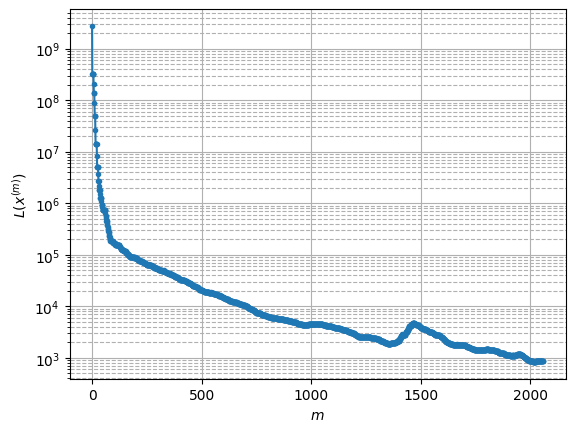

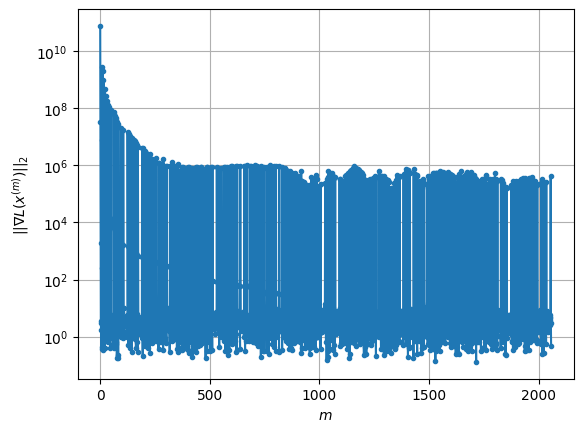

Windows:  82%|████████▏ | 242/296 [1:28:52<20:17, 22.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 895.5110731495975
Gradient norm: 221374.1675165855
Global relative error: 65.52434165398383
Position relative errors: 0.019799283393460775 m, 47.38640801412942 m, 10.640429783940316 m, 43.985774668287135 m

Iteration 1
Cost function: 893.5305995023665 (-0.22%)
Gradient norm: 1.2978028563416715 (-100.00%)
Global relative error = 65.469205524289 (-0.08%)
Position relative errors: 0.023353252541519213 m, 47.34725405071794 m, 10.647539638487272 m, 43.944096168623176 m

STOP on Iteration 2
Cost function = 893.5305991084839 (-0.00%)
Gradient norm = 0.7408492562622592 (-42.92%)
Global relative error = 65.46920550420027 (-0.00%)
Final position relative errors: 0.02335325344467288 m, 47.34725403079151 m, 10.647539643636634 m, 43.94409615891583 m

Majorization-Minimization converged after 1 iterations


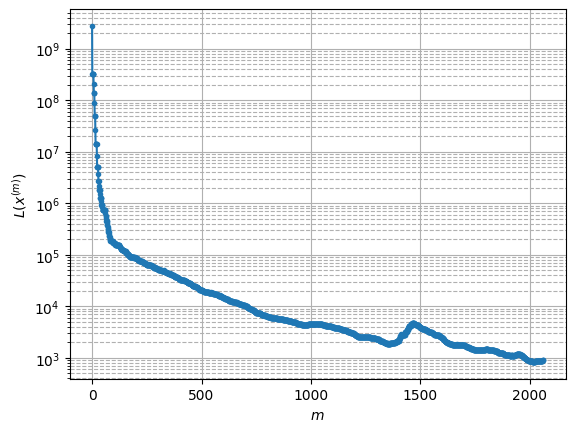

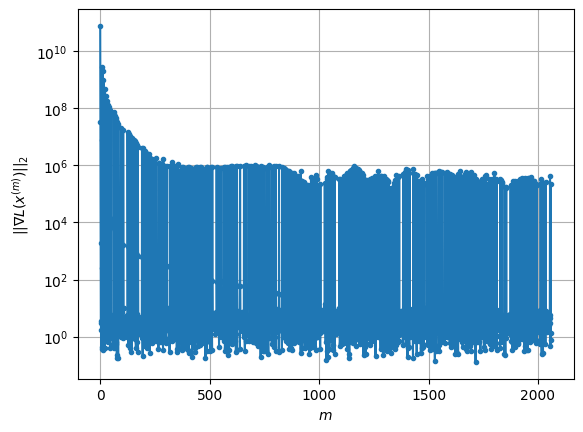

Windows:  82%|████████▏ | 243/296 [1:29:00<16:09, 18.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 913.1889031424171
Gradient norm: 297222.1852700542
Global relative error: 64.80485583108144
Position relative errors: 0.023792729762117385 m, 46.68014021874975 m, 11.075554977640424 m, 43.56564114203929 m

STOP on Iteration 1
Cost function = 910.3475854416718 (-0.31%)
Gradient norm = 0.33521896970310083 (-100.00%)
Global relative error = 64.74866773010405 (-0.09%)
Final position relative errors: 0.023773045293846922 m, 46.64143784330389 m, 11.082111396074787 m, 43.521859062691576 m

Majorization-Minimization converged after 1 iterations


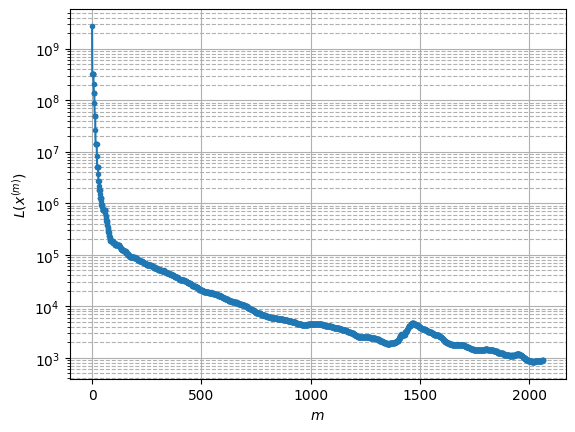

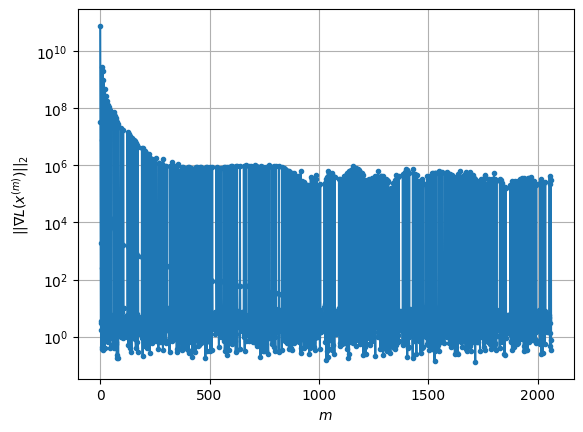

Windows:  82%|████████▏ | 244/296 [1:29:06<12:32, 14.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 913.4157026072058
Gradient norm: 286751.8575425078
Global relative error: 63.8087516769789
Position relative errors: 0.023968805291530292 m, 45.77226067531097 m, 11.458667878034325 m, 42.95526602342548 m

Iteration 1
Cost function: 866.193254077729 (-0.34%)
Gradient norm: 4.6434927713744205 (-100.00%)
Global relative error = 54.87280359498814 (-0.08%)
Position relative errors: 0.030309788872541245 m, 38.37681870913669 m, 12.567976437228811 m, 37.15222432123067 m

Iteration 2
Cost function: 866.1932540257341 (-0.00%)
Gradient norm: 4.93714679289371 (6.32%)
Global relative error = 54.872803578467604 (-0.00%)
Position relative errors: 0.030309784952151416 m, 38.37681869636476 m, 12.567976427608684 m, 37.15222431328075 m

Iteration 3
Cost function: 866.1932524522798 (-0.00%)
Gradient norm: 1.8382677190939032 (-62.77%)
Global relative error = 54.87280357885479 (0.00%)
Position relative errors: 0.030309780532

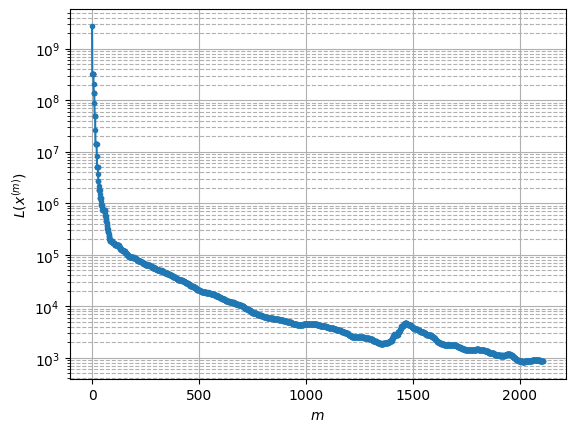

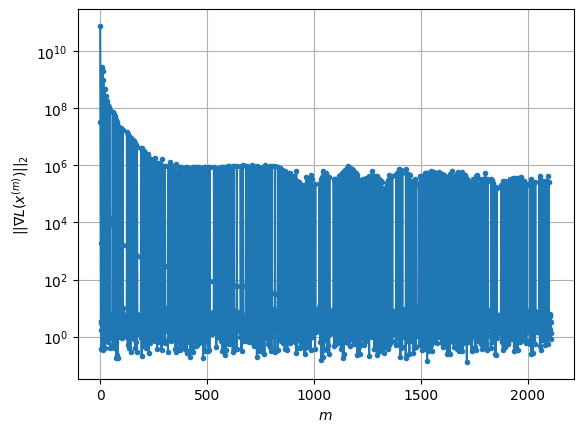

Windows:  84%|████████▍ | 250/296 [1:31:07<16:18, 21.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 862.4021241466194
Gradient norm: 248906.6488209643
Global relative error: 52.42215602783893
Position relative errors: 0.02993408103520229 m, 36.41031429883805 m, 12.607362017824576 m, 35.54466241916654 m

Iteration 1
Cost function: 858.8732283488109 (-0.41%)
Gradient norm: 3.477856101315203 (-100.00%)
Global relative error = 52.37831184791087 (-0.08%)
Position relative errors: 0.040688453966759734 m, 36.38647500721663 m, 12.620170028224209 m, 35.4998547943002 m

Iteration 2
Cost function: 858.8732278120369 (-0.00%)
Gradient norm: 1.8508485201186802 (-46.78%)
Global relative error = 52.37831182763052 (-0.00%)
Position relative errors: 0.0406884536588853 m, 36.38647499048128 m, 12.620170019534436 m, 35.49985478462042 m

Iteration 3
Cost function: 858.8732298271243 (0.00%)
Gradient norm: 2.095009894093214 (13.19%)
Global relative error = 52.37831182790958 (0.00%)
Position relative errors: 0.040688451409445

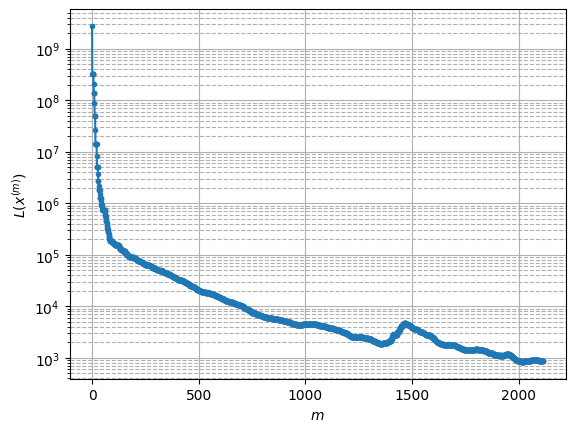

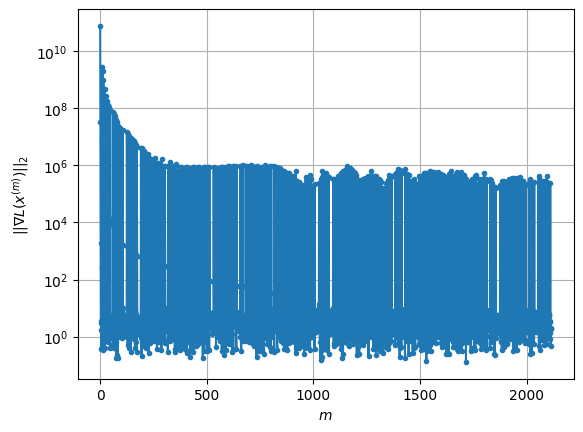

Windows:  85%|████████▍ | 251/296 [1:31:20<14:07, 18.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 849.9632391739127
Gradient norm: 376108.2754993279
Global relative error: 49.711058974140236
Position relative errors: 0.03987084410447297 m, 34.26338526794034 m, 12.601494519581596 m, 33.740306462128636 m

STOP on Iteration 1
Cost function = 846.513065495058 (-0.41%)
Gradient norm = 0.5840755849039435 (-100.00%)
Global relative error = 49.67093517272197 (-0.08%)
Final position relative errors: 0.05256106918287007 m, 34.24244483389867 m, 12.613348139117823 m, 33.6979996935924 m

Majorization-Minimization converged after 1 iterations


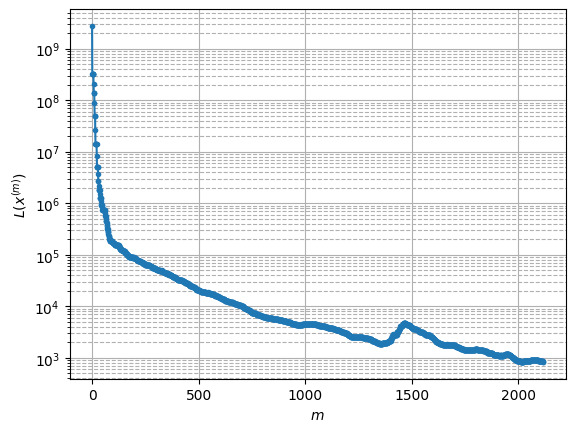

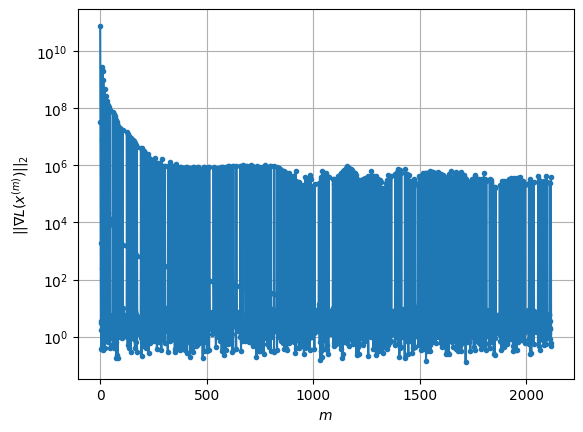

Windows:  85%|████████▌ | 252/296 [1:31:26<10:54, 14.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 838.7201086110861
Gradient norm: 541633.3748829105
Global relative error: 46.80039957818549
Position relative errors: 0.05115094462183526 m, 31.972169456139255 m, 12.5368832609684 m, 31.794325159803005 m

Iteration 1
Cost function: 834.4063849339311 (-0.51%)
Gradient norm: 1.7718309799529046 (-100.00%)
Global relative error = 46.7639731058336 (-0.08%)
Position relative errors: 0.05314620235161818 m, 31.95492321207766 m, 12.551533234056679 m, 31.752254203223647 m

Iteration 2
Cost function: 834.406385658015 (0.00%)
Gradient norm: 1.6552253953294662 (-6.58%)
Global relative error = 46.76397309193387 (-0.00%)
Position relative errors: 0.05314619959959689 m, 31.954923204712724 m, 12.551533223688741 m, 31.752254194267422 m

Iteration 3
Cost function: 834.406385089077 (-0.00%)
Gradient norm: 1.9776608758765206 (19.48%)
Global relative error = 46.76397309190051 (-0.00%)
Position relative errors: 0.053146200126

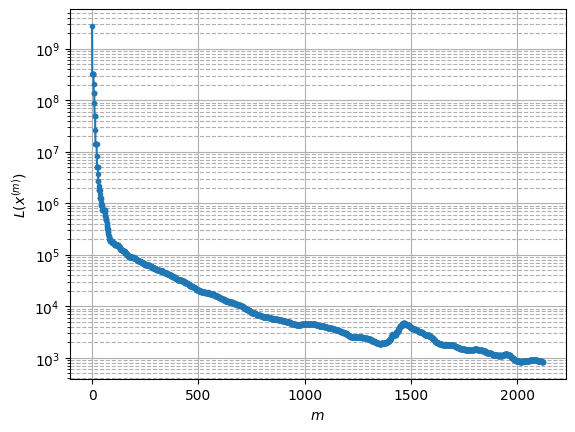

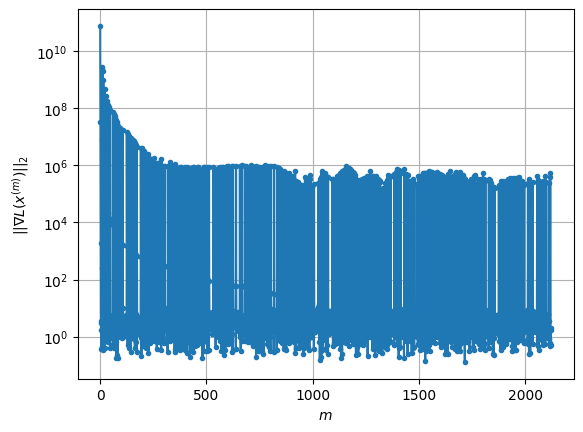

Windows:  85%|████████▌ | 253/296 [1:31:39<10:20, 14.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 824.6415964509807
Gradient norm: 272252.245569606
Global relative error: 43.70487440074028
Position relative errors: 0.051167527628541286 m, 29.54747224885048 m, 12.417679063168686 m, 29.71293689566107 m

Iteration 1
Cost function: 819.4248026938019 (-0.63%)
Gradient norm: 3.133065538732619 (-100.00%)
Global relative error = 43.67264252195452 (-0.07%)
Position relative errors: 0.05090133041411852 m, 29.534175891531312 m, 12.432669304818647 m, 29.67246817989853 m

STOP on Iteration 2
Cost function = 819.4248035399505 (0.00%)
Gradient norm = 0.23680613615688628 (-92.44%)
Global relative error = 43.672642507464175 (-0.00%)
Final position relative errors: 0.050901323098769984 m, 29.534175885213422 m, 12.432669288293951 m, 29.672468171796112 m

Majorization-Minimization converged after 1 iterations


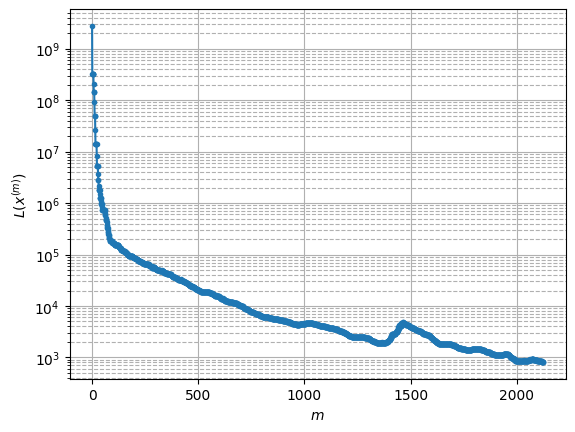

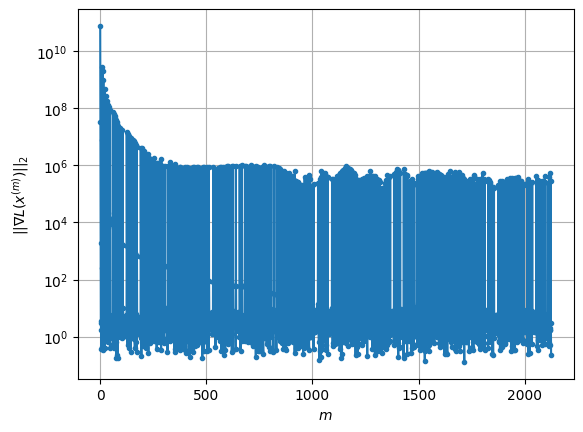

Windows:  86%|████████▌ | 254/296 [1:31:47<08:47, 12.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 808.4932087173092
Gradient norm: 294383.05567950406
Global relative error: 40.441199061141454
Position relative errors: 0.048869994354637264 m, 27.000117352289003 m, 12.242174627753297 m, 27.50650384291345 m

Iteration 1
Cost function: 804.1190544212127 (-0.54%)
Gradient norm: 1.2805552576646744 (-100.00%)
Global relative error = 40.41310266847411 (-0.07%)
Position relative errors: 0.04407794653624351 m, 26.99070536709019 m, 12.250779597407162 m, 27.47060046842424 m

Iteration 2
Cost function: 804.1190529495611 (-0.00%)
Gradient norm: 5.356219881227976 (318.27%)
Global relative error = 40.4131026567867 (-0.00%)
Position relative errors: 0.04407795310309261 m, 26.99070536185708 m, 12.25077958284091 m, 27.470600462857554 m

Iteration 3
Cost function: 804.1190537827035 (0.00%)
Gradient norm: 6.287764947509468 (17.39%)
Global relative error = 40.41310265656136 (-0.00%)
Position relative errors: 0.0440779450

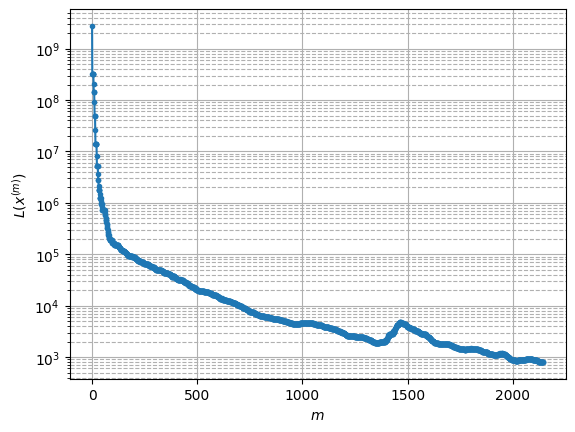

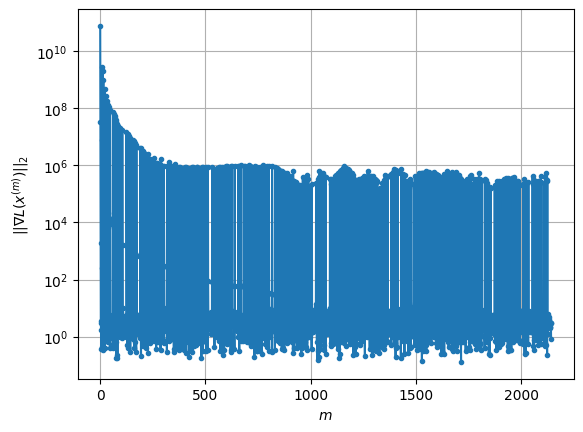

Windows:  86%|████████▌ | 255/296 [1:32:35<15:46, 23.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 795.5282733578169
Gradient norm: 221903.49792012645
Global relative error: 37.02739973952439
Position relative errors: 0.042165810166326825 m, 24.34117593938723 m, 12.005019511663477 m, 25.18748974610925 m

Iteration 1
Cost function: 791.1776918995924 (-0.55%)
Gradient norm: 3.5868055752301857 (-100.00%)
Global relative error = 37.00364705524677 (-0.06%)
Position relative errors: 0.04509051766295734 m, 24.334775376246483 m, 12.01202872874847 m, 25.155400351862394 m

Iteration 2
Cost function: 791.1776920163697 (0.00%)
Gradient norm: 2.002695649561466 (-44.16%)
Global relative error = 37.00364704735465 (-0.00%)
Position relative errors: 0.045090519389668016 m, 24.334775372736583 m, 12.01202872196651 m, 25.155400346883855 m

Iteration 3
Cost function: 791.1776912120806 (-0.00%)
Gradient norm: 1.273161957557707 (-36.43%)
Global relative error = 37.003647046924904 (-0.00%)
Position relative errors: 0.045090

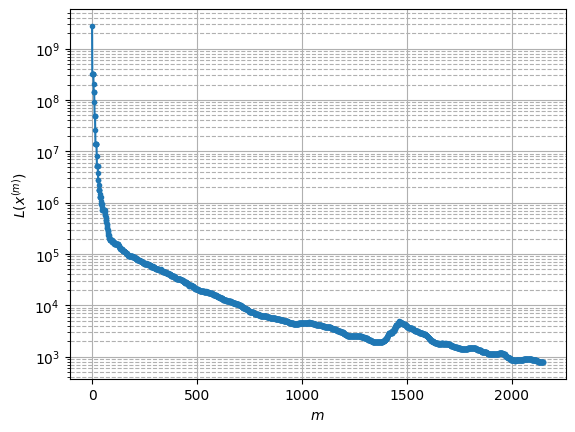

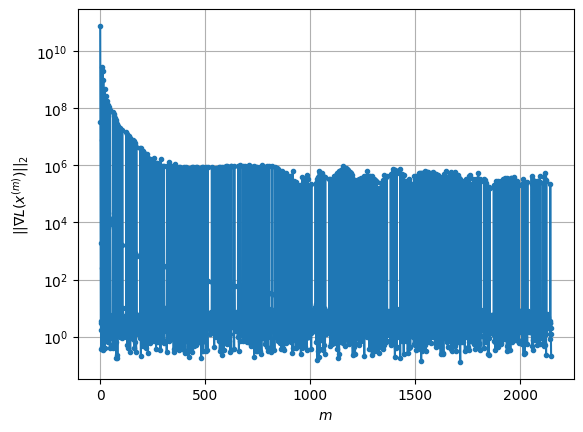

Windows:  86%|████████▋ | 256/296 [1:32:49<13:31, 20.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 784.5763010139163
Gradient norm: 363523.69118696876
Global relative error: 33.48422626982198
Position relative errors: 0.04319951962434329 m, 21.581419332487524 m, 11.71228794703767 m, 22.765155941458758 m

Iteration 1
Cost function: 781.1418135153752 (-0.44%)
Gradient norm: 2.7540845499280544 (-100.00%)
Global relative error = 33.463814888617065 (-0.06%)
Position relative errors: 0.05798067267871337 m, 21.579657053149372 m, 11.711506215832218 m, 22.737165750087474 m

Iteration 2
Cost function: 781.1418127005176 (-0.00%)
Gradient norm: 4.864874065149076 (76.64%)
Global relative error = 33.46381487831854 (-0.00%)
Position relative errors: 0.057980669293941314 m, 21.579657048464295 m, 11.7115062052246 m, 22.73716574484945 m

STOP on Iteration 3
Cost function = 781.141814123913 (0.00%)
Gradient norm = 0.4910341839178943 (-89.91%)
Global relative error = 33.463814877630355 (-0.00%)
Final position relative e

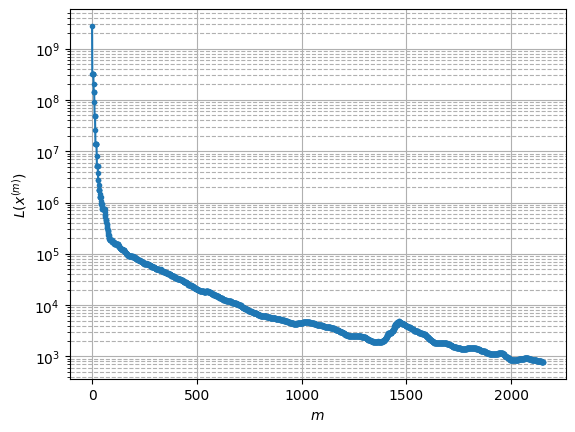

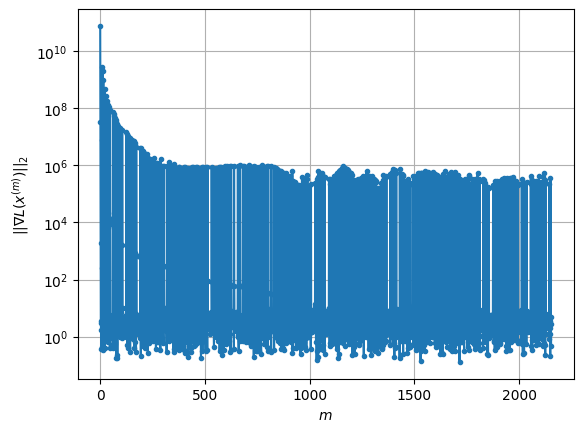

Windows:  87%|████████▋ | 257/296 [1:33:00<11:23, 17.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 767.3984183016655
Gradient norm: 210098.08852647757
Global relative error: 29.834721699586122
Position relative errors: 0.055758117951978964 m, 18.734632073800547 m, 11.35952804716829 m, 20.25038403691064 m

Iteration 1
Cost function: 763.9098223106117 (-0.45%)
Gradient norm: 3.4212503571059223 (-100.00%)
Global relative error = 29.81938683249264 (-0.05%)
Position relative errors: 0.04273304149004397 m, 18.734636072097718 m, 11.356710146930993 m, 20.229394872502166 m

Iteration 2
Cost function: 763.9098220362232 (-0.00%)
Gradient norm: 2.613970831166861 (-23.60%)
Global relative error = 29.819386826517054 (-0.00%)
Position relative errors: 0.04273304756510036 m, 18.73463606700093 m, 11.356710141486653 m, 20.22939487145757 m

Iteration 3
Cost function: 763.9098234427128 (0.00%)
Gradient norm: 1.5976340042163546 (-38.88%)
Global relative error = 29.819386826114368 (-0.00%)
Position relative errors: 0.0427

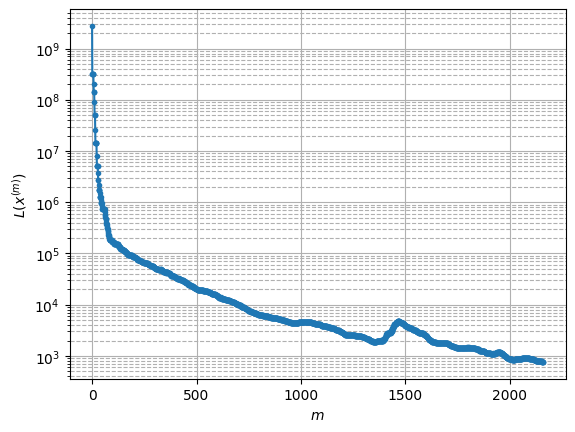

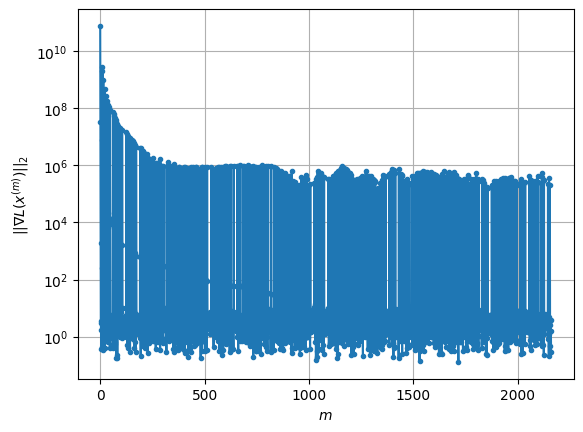

Windows:  87%|████████▋ | 258/296 [1:33:17<11:09, 17.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 759.7732296896321
Gradient norm: 216976.944179667
Global relative error: 26.110316911567086
Position relative errors: 0.04130802717165245 m, 15.810529228259407 m, 10.954174313115086 m, 17.65717387024917 m

STOP on Iteration 1
Cost function = 757.222349349278 (-0.34%)
Gradient norm = 0.8675073334102539 (-100.00%)
Global relative error = 26.097951588966062 (-0.05%)
Final position relative errors: 0.03702011518500243 m, 15.81548974818217 m, 10.944582118938408 m, 17.640400639188393 m

Majorization-Minimization converged after 1 iterations


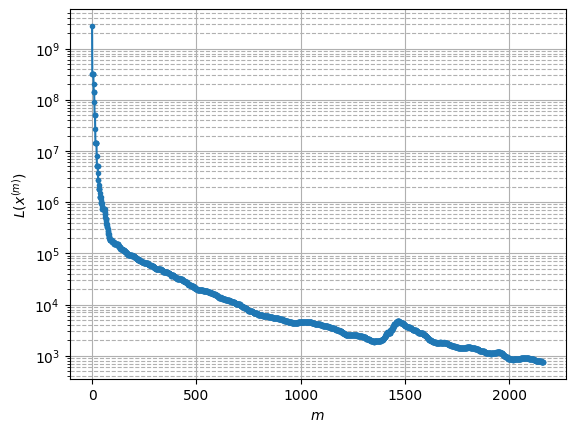

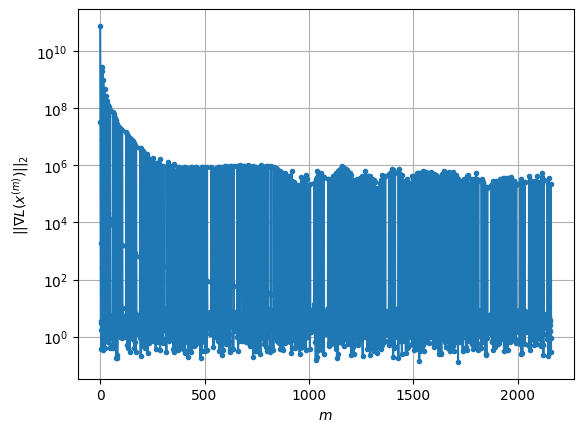

Windows:  88%|████████▊ | 259/296 [1:33:23<08:40, 14.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 750.766683690553
Gradient norm: 258088.05433165107
Global relative error: 22.34830570340118
Position relative errors: 0.03581153618874117 m, 12.825541375270078 m, 10.493571571590257 m, 14.994376677501014 m

Iteration 1
Cost function: 748.0401476777489 (-0.36%)
Gradient norm: 3.2572540351807078 (-100.00%)
Global relative error = 22.340014336775102 (-0.04%)
Position relative errors: 0.025462855064504412 m, 12.834960229762812 m, 10.480540288361679 m, 14.98309287587694 m

Iteration 2
Cost function: 748.0401474382023 (-0.00%)
Gradient norm: 1.7247504401506295 (-47.05%)
Global relative error = 22.340014325342512 (-0.00%)
Position relative errors: 0.02546285271660219 m, 12.834960217160196 m, 10.480540282183856 m, 14.983092873951842 m

Iteration 3
Cost function: 748.0401470843417 (-0.00%)
Gradient norm: 3.7792651970667777 (119.12%)
Global relative error = 22.34001432571135 (0.00%)
Position relative errors: 0.02

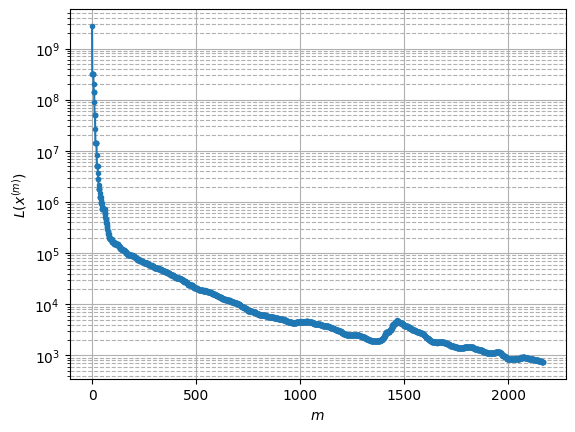

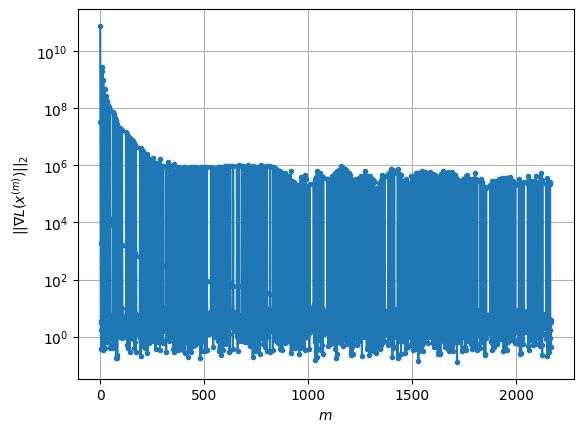

Windows:  88%|████████▊ | 260/296 [1:33:39<08:43, 14.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 735.1466065606297
Gradient norm: 73296.37068165705
Global relative error: 18.60841973903072
Position relative errors: 0.02488406183593795 m, 9.793449590100442 m, 9.983158542771521 m, 12.275698797515506 m

Iteration 1
Cost function: 732.8278698753206 (-0.32%)
Gradient norm: 1.8210237359676253 (-100.00%)
Global relative error = 18.6099834567787 (0.01%)
Position relative errors: 0.02173043968319591 m, 9.805926161069412 m, 9.97319048347695 m, 12.276217911831022 m

STOP on Iteration 2
Cost function = 732.827868143432 (-0.00%)
Gradient norm = 0.3444244329150984 (-81.09%)
Global relative error = 18.609983448843934 (-0.00%)
Final position relative errors: 0.02173043819572015 m, 9.805926150171526 m, 9.973190483284458 m, 12.276217908666357 m

Majorization-Minimization converged after 1 iterations


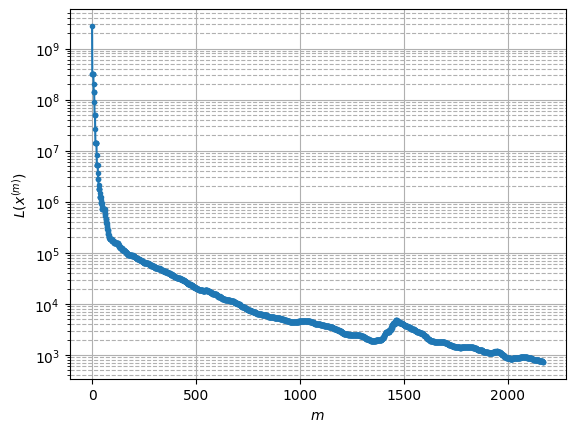

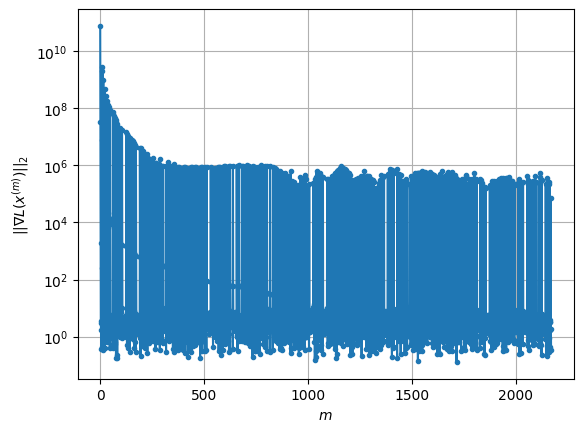

Windows:  88%|████████▊ | 261/296 [1:33:47<07:18, 12.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 731.795420092232
Gradient norm: 96100.44536845727
Global relative error: 14.997313578354396
Position relative errors: 0.021091945405716864 m, 6.729851248984398 m, 9.43167925542929 m, 9.521900144963391 m

Iteration 1
Cost function: 729.871441942422 (-0.26%)
Gradient norm: 3.074840310846244 (-100.00%)
Global relative error = 14.999991506844983 (0.02%)
Position relative errors: 0.023524051245686066 m, 6.742568717662741 m, 9.415616030930865 m, 9.53300707954531 m

Iteration 2
Cost function: 729.8714408449543 (-0.00%)
Gradient norm: 1.7425227023807681 (-43.33%)
Global relative error = 14.999991503081523 (-0.00%)
Position relative errors: 0.0235240508343805 m, 6.7425687124966505 m, 9.415616029848689 m, 9.53300707834733 m

Iteration 3
Cost function: 729.8714416133976 (0.00%)
Gradient norm: 1.869931377300914 (7.31%)
Global relative error = 14.999991502586676 (-0.00%)
Position relative errors: 0.02352405133369934

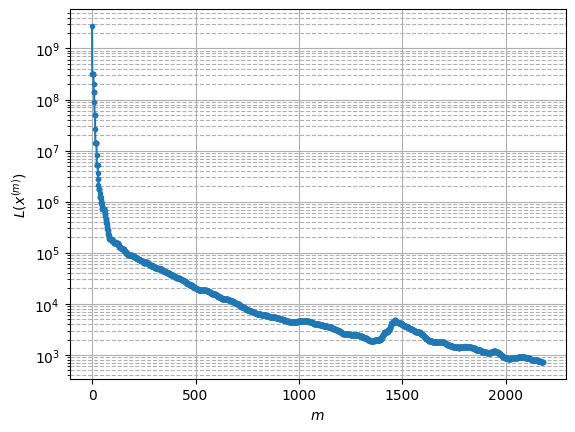

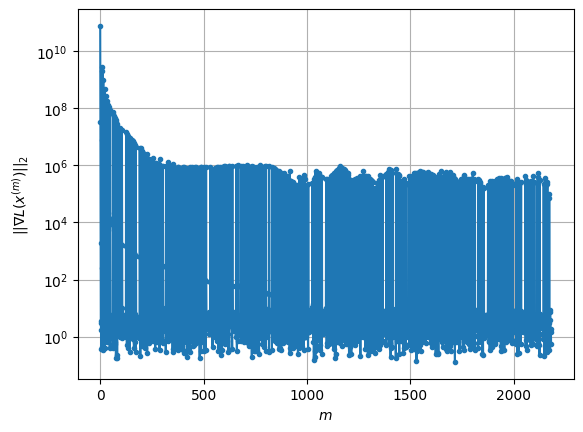

Windows:  89%|████████▊ | 262/296 [1:34:12<09:18, 16.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 723.8415563864628
Gradient norm: 104314.58139250733
Global relative error: 11.70464253566467
Position relative errors: 0.02304315926104229 m, 3.660266878819288 m, 8.83269184927219 m, 6.751230356612615 m

Iteration 1
Cost function: 722.1157612800529 (-0.24%)
Gradient norm: 1.6664046807709303 (-100.00%)
Global relative error = 11.706707970860354 (0.02%)
Position relative errors: 0.02178096151084692 m, 3.6768937804623505 m, 8.810291125415967 m, 6.7750092417838 m

Iteration 2
Cost function: 722.1157623148415 (0.00%)
Gradient norm: 2.4628299346188904 (47.79%)
Global relative error = 11.706707964473335 (-0.00%)
Position relative errors: 0.021780965025292375 m, 3.6768937758528555 m, 8.810291123641914 m, 6.775009235544808 m

Iteration 3
Cost function: 722.1157630665085 (0.00%)
Gradient norm: 5.760869630776683 (133.91%)
Global relative error = 11.706707965860385 (0.00%)
Position relative errors: 0.02178096456709

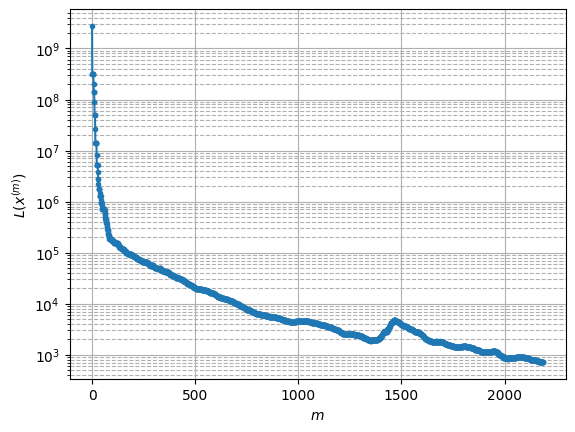

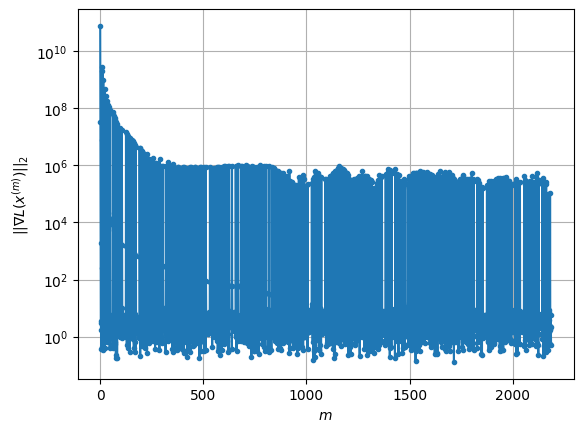

Windows:  89%|████████▉ | 263/296 [1:34:28<08:54, 16.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 736.7216035663279
Gradient norm: 349012.7672574847
Global relative error: 9.159357485145577
Position relative errors: 0.020850339836277314 m, 0.8770841047556243 m, 8.18864782424742 m, 4.008128241219646 m

STOP on Iteration 1
Cost function = 734.4016395929381 (-0.31%)
Gradient norm = 0.5822846058986043 (-100.00%)
Global relative error = 9.153288045479734 (-0.07%)
Final position relative errors: 0.021645517146153922 m, 0.9409641296230924 m, 8.161151863012714 m, 4.035756899251682 m

Majorization-Minimization converged after 1 iterations


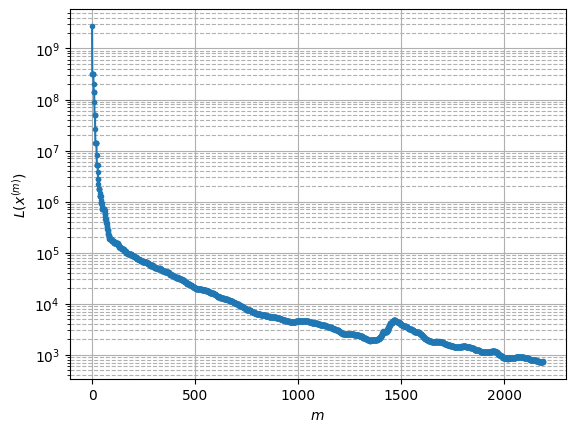

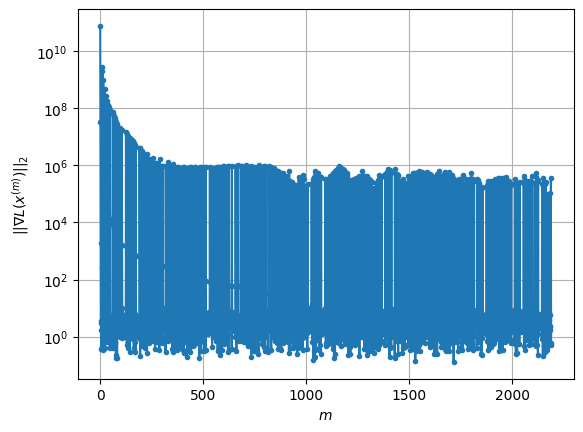

Windows:  89%|████████▉ | 264/296 [1:34:34<07:00, 13.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 736.0907014512824
Gradient norm: 250523.48457587455
Global relative error: 8.143381737879483
Position relative errors: 0.02110672290216349 m, 2.7606219287061733 m, 7.50381749830326 m, 1.5429915604713196 m

STOP on Iteration 1
Cost function = 734.6090914961289 (-0.20%)
Gradient norm = 0.5829907051543924 (-100.00%)
Global relative error = 8.134246494493908 (-0.11%)
Final position relative errors: 0.019304124967736043 m, 2.7723745465980443 m, 7.47558101236496 m, 1.6093913638576873 m

Majorization-Minimization converged after 1 iterations


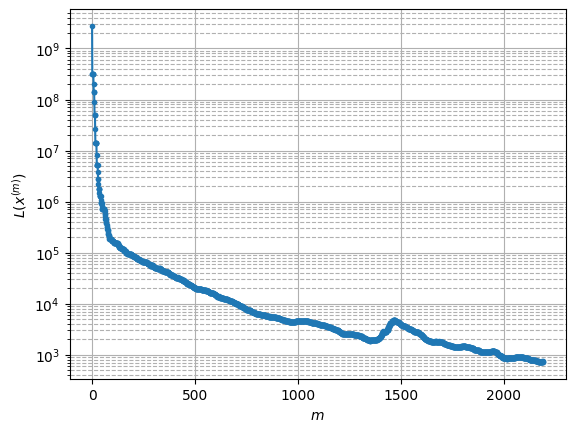

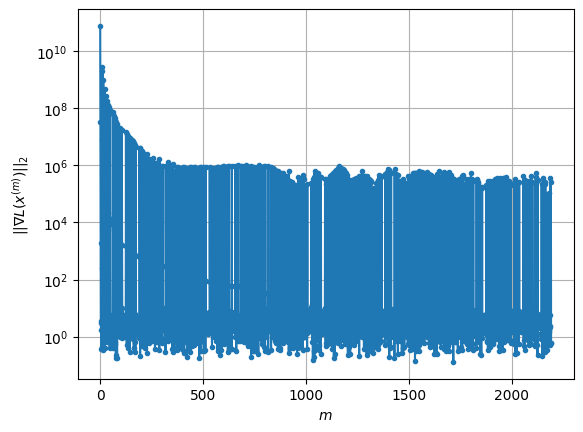

Windows:  90%|████████▉ | 265/296 [1:34:40<05:41, 11.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 748.8775927334826
Gradient norm: 329432.08747851686
Global relative error: 9.19711800203056
Position relative errors: 0.018928061288301847 m, 5.808028564108912 m, 6.785609293029358 m, 2.1917741738892236 m

Iteration 1
Cost function: 745.8653412813545 (-0.40%)
Gradient norm: 2.856403595888438 (-100.00%)
Global relative error = 9.170640486869935 (-0.29%)
Position relative errors: 0.01754974586563505 m, 5.796241788307664 m, 6.743565986975655 m, 2.2412466525838335 m

Iteration 2
Cost function: 745.8653415597249 (0.00%)
Gradient norm: 2.085495958331453 (-26.99%)
Global relative error = 9.17064047404738 (-0.00%)
Position relative errors: 0.017549745188960863 m, 5.796241788351996 m, 6.743565971749309 m, 2.241246645821069 m

STOP on Iteration 3
Cost function = 745.8653424527009 (0.00%)
Gradient norm = 0.3832406095617592 (-81.62%)
Global relative error = 9.170640474494771 (0.00%)
Final position relative errors: 

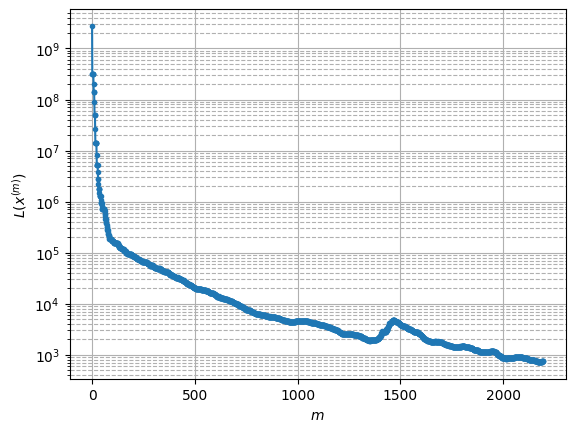

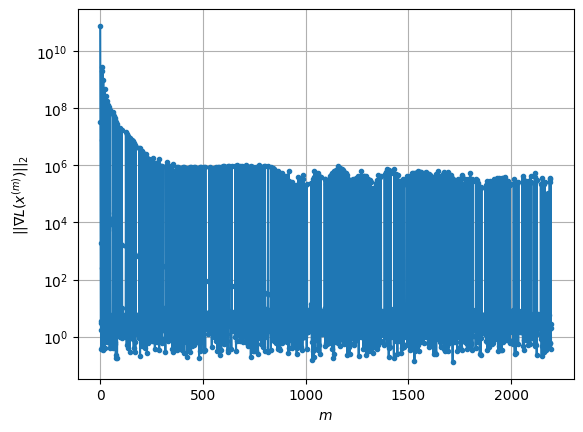

Windows:  90%|████████▉ | 266/296 [1:34:51<05:26, 10.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 751.9357933149064
Gradient norm: 196200.35946887013
Global relative error: 11.747283844243906
Position relative errors: 0.017046237556628072 m, 8.85828567888031 m, 6.0235802713991085 m, 4.820856464994781 m

STOP on Iteration 1
Cost function = 749.3920048193058 (-0.34%)
Gradient norm = 0.3615725909175385 (-100.00%)
Global relative error = 11.720203243189362 (-0.23%)
Final position relative errors: 0.0173706828230303 m, 8.842261606695192 m, 5.98298455955581 m, 4.834892829915181 m

Majorization-Minimization converged after 1 iterations


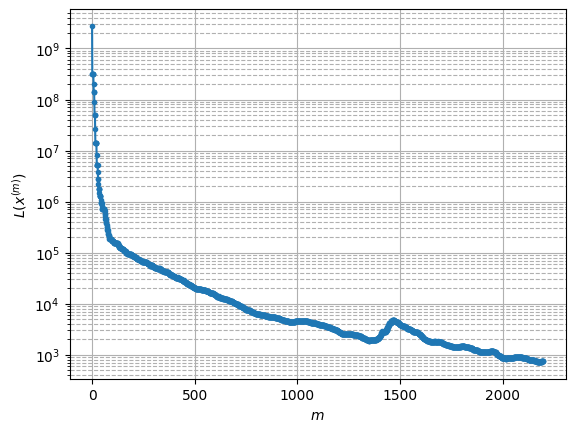

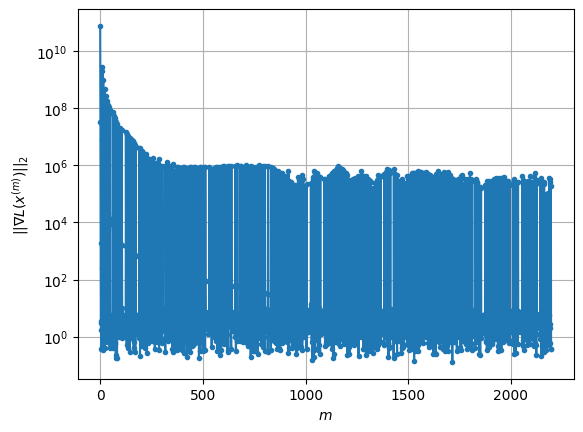

Windows:  90%|█████████ | 267/296 [1:34:56<04:30,  9.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 759.8505148398324
Gradient norm: 207823.4213385188
Global relative error: 15.023501831148248
Position relative errors: 0.01616232940999262 m, 11.876674435428935 m, 5.236021883043443 m, 7.564995275638038 m

Iteration 1
Cost function: 757.7794800126537 (-0.27%)
Gradient norm: 3.653079536329377 (-100.00%)
Global relative error = 14.993782564373689 (-0.20%)
Position relative errors: 0.017238116712300428 m, 11.857851797107328 m, 5.200073874880221 m, 7.560352877406321 m

Iteration 2
Cost function: 757.7794798429138 (-0.00%)
Gradient norm: 5.4821486254250535 (50.07%)
Global relative error = 14.99378256290792 (-0.00%)
Position relative errors: 0.017238116430320385 m, 11.857851797744084 m, 5.200073863203477 m, 7.560352881532616 m

Iteration 3
Cost function: 757.7794793011111 (-0.00%)
Gradient norm: 1.9194296395327548 (-64.99%)
Global relative error = 14.993782562622895 (-0.00%)
Position relative errors: 0.017238

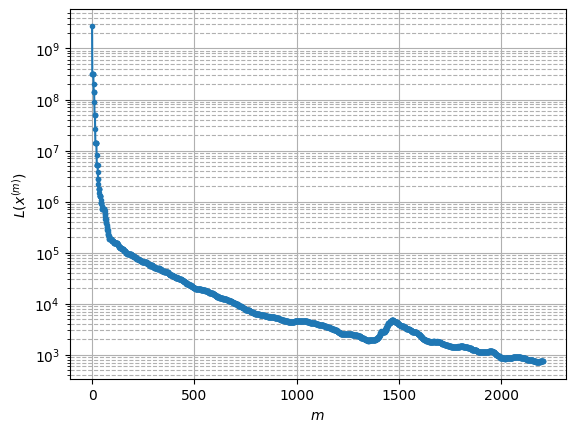

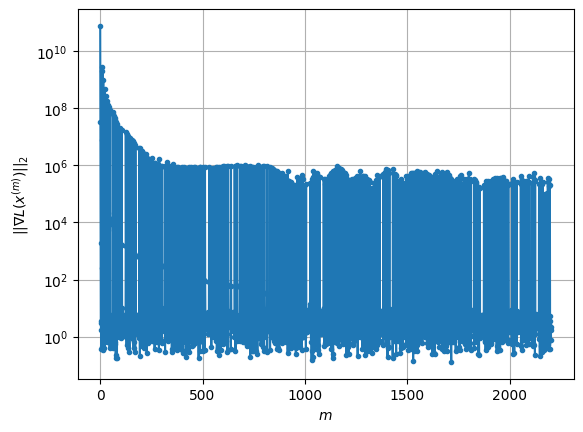

Windows:  91%|█████████ | 268/296 [1:35:14<05:32, 11.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 768.9509717105373
Gradient norm: 244885.1297513839
Global relative error: 18.60058011842693
Position relative errors: 0.01684700037015807 m, 14.843840290744447 m, 4.429860454576786 m, 10.296277023679565 m

Iteration 1
Cost function: 766.9075499122785 (-0.27%)
Gradient norm: 2.0310622615180867 (-100.00%)
Global relative error = 18.5702267509636 (-0.16%)
Position relative errors: 0.010524783338426687 m, 14.82727010314743 m, 4.396667372163046 m, 10.279585411880605 m

STOP on Iteration 2
Cost function = 766.9075514161453 (0.00%)
Gradient norm = 0.39861127871932045 (-80.37%)
Global relative error = 18.570226752681013 (0.00%)
Final position relative errors: 0.010524778763699096 m, 14.827270104275785 m, 4.396667367312011 m, 10.279585415435069 m

Majorization-Minimization converged after 1 iterations


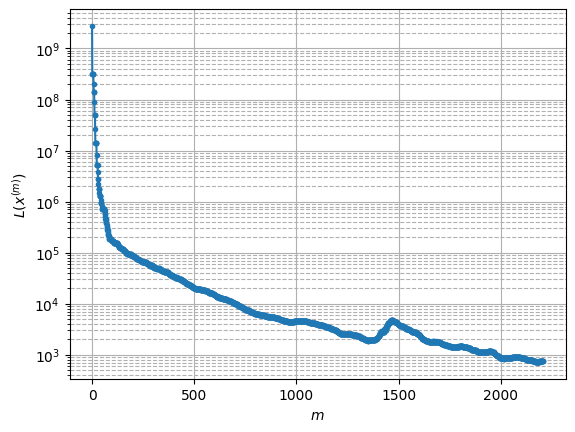

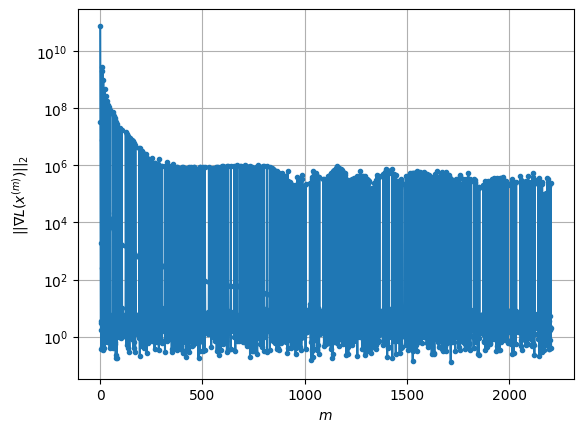

Windows:  91%|█████████ | 269/296 [1:35:22<04:49, 10.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 778.4663488998054
Gradient norm: 564464.8655385039
Global relative error: 22.285745825560085
Position relative errors: 0.009284899523058207 m, 17.74863803232012 m, 3.60757398615218 m, 12.985419172420169 m

Iteration 1
Cost function: 776.6794038677014 (-0.23%)
Gradient norm: 2.162608298404342 (-100.00%)
Global relative error = 22.253071796699093 (-0.15%)
Position relative errors: 0.014779549060440345 m, 17.728007081749173 m, 3.573779088410677 m, 12.966893702385741 m

Iteration 2
Cost function: 776.6794033380025 (-0.00%)
Gradient norm: 1.769835998236356 (-18.16%)
Global relative error = 22.25307179838808 (0.00%)
Position relative errors: 0.01477955396019764 m, 17.728007083639515 m, 3.5737790835768246 m, 12.966893704026486 m

Iteration 3
Cost function: 776.679402256568 (-0.00%)
Gradient norm: 2.3705886487959362 (33.94%)
Global relative error = 22.253071798523287 (0.00%)
Position relative errors: 0.01477954

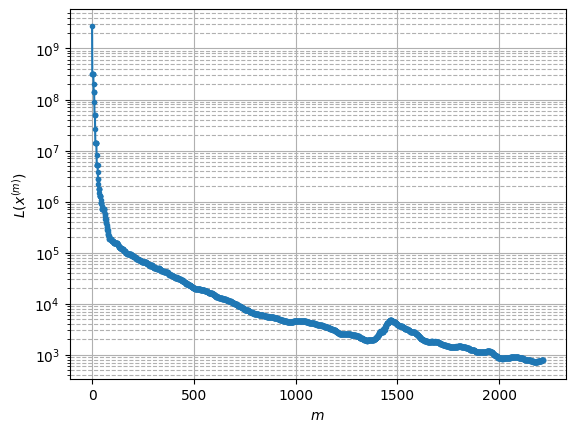

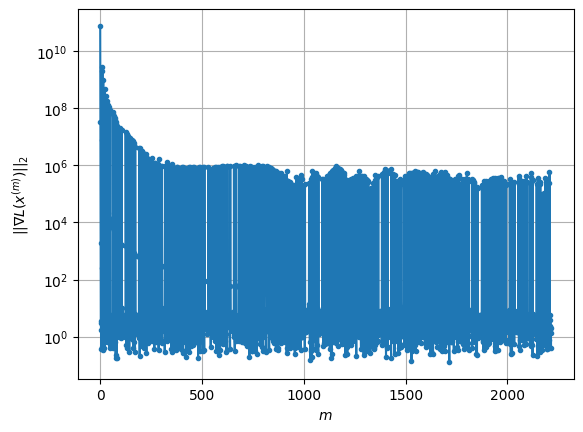

Windows:  91%|█████████ | 270/296 [1:35:45<06:15, 14.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 781.7094675722552
Gradient norm: 286789.85201003443
Global relative error: 25.97922071590799
Position relative errors: 0.013215047667308934 m, 20.571512345097528 m, 2.7707498139700983 m, 15.62213993594621 m

Iteration 1
Cost function: 780.1172490792359 (-0.20%)
Gradient norm: 3.062778282195211 (-100.00%)
Global relative error = 25.944790839721524 (-0.13%)
Position relative errors: 0.011737392109831225 m, 20.54936876837739 m, 2.7387901309093956 m, 15.599686152555444 m

STOP on Iteration 2
Cost function = 780.11724624564 (-0.00%)
Gradient norm = 0.19607434548029315 (-93.60%)
Global relative error = 25.944790842438998 (0.00%)
Final position relative errors: 0.011737399423641305 m, 20.54936877142535 m, 2.7387901266603474 m, 15.599686153800443 m

Majorization-Minimization converged after 1 iterations


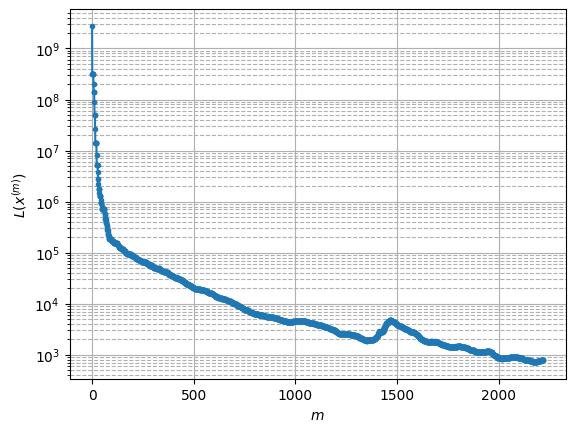

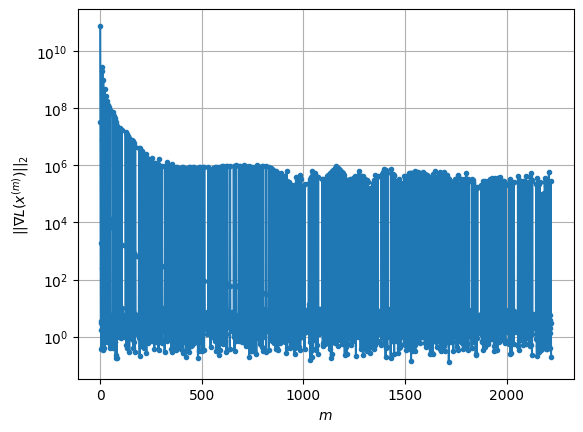

Windows:  92%|█████████▏| 271/296 [1:35:53<05:13, 12.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 801.3051612715711
Gradient norm: 343371.62935065693
Global relative error: 29.62403695069858
Position relative errors: 0.010492895003936976 m, 23.302260762532967 m, 1.9305744185189702 m, 18.189473091068372 m

Iteration 1
Cost function: 798.4967289636052 (-0.35%)
Gradient norm: 3.7372025232951622 (-100.00%)
Global relative error = 29.585515228585788 (-0.13%)
Position relative errors: 0.011121814345185367 m, 23.27879474337651 m, 1.8888150725592876 m, 18.16118489209762 m

Iteration 2
Cost function: 798.4967281987188 (-0.00%)
Gradient norm: 1.0347163231275367 (-72.31%)
Global relative error = 29.585515226287356 (-0.00%)
Position relative errors: 0.011121821762834506 m, 23.278794744190293 m, 1.8888150647162802 m, 18.161184888121404 m

STOP on Iteration 3
Cost function = 798.4967276937685 (-0.00%)
Gradient norm = 0.23967475722594433 (-76.84%)
Global relative error = 29.585515225524723 (-0.00%)
Final position 

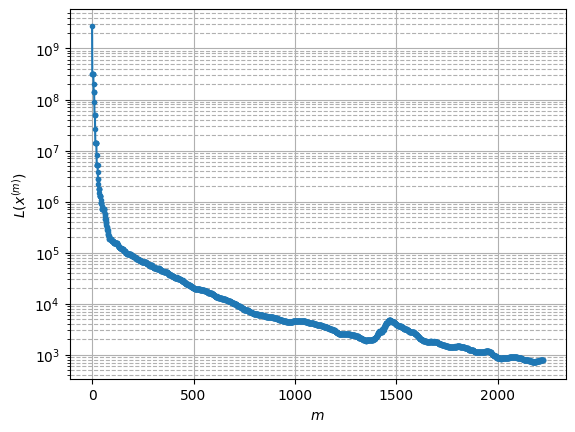

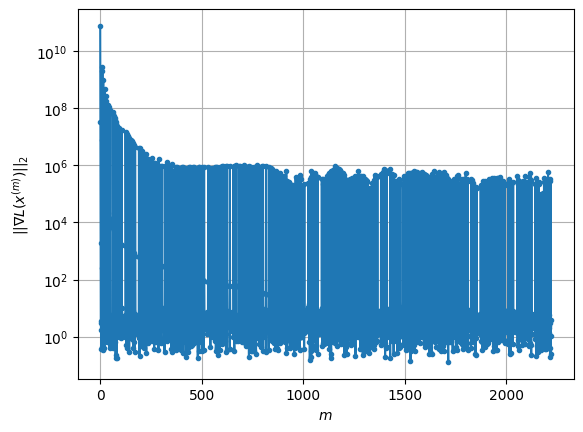

Windows:  92%|█████████▏| 272/296 [1:36:04<04:46, 11.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 800.9292006181239
Gradient norm: 363315.6122744254
Global relative error: 33.17964324659151
Position relative errors: 0.010095617635107823 m, 25.929162788506005 m, 1.0891010356416118 m, 20.673104024126776 m

Iteration 1
Cost function: 797.9217428211382 (-0.38%)
Gradient norm: 3.3578753708772293 (-100.00%)
Global relative error = 33.1416744609772 (-0.11%)
Position relative errors: 0.011074067943503586 m, 25.904531581774044 m, 1.040964600067036 m, 20.645540317048486 m

Iteration 2
Cost function: 797.921743158651 (0.00%)
Gradient norm: 1.846313329245199 (-45.02%)
Global relative error = 33.141674455251966 (-0.00%)
Position relative errors: 0.011074076555718541 m, 25.90453157828507 m, 1.0409645883032188 m, 20.645540312824174 m

Iteration 3
Cost function: 797.9217439055438 (0.00%)
Gradient norm: 5.485311977694411 (197.10%)
Global relative error = 33.14167445553257 (0.00%)
Position relative errors: 0.01107407

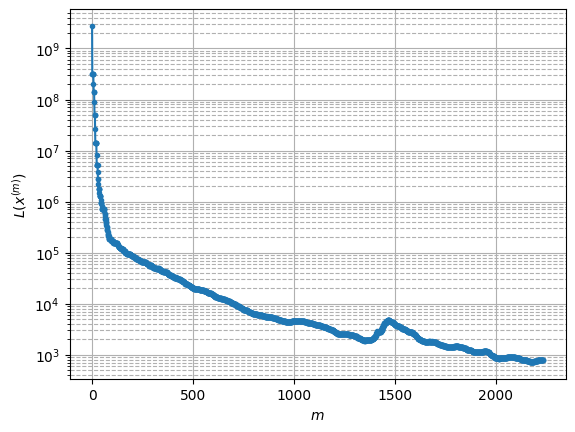

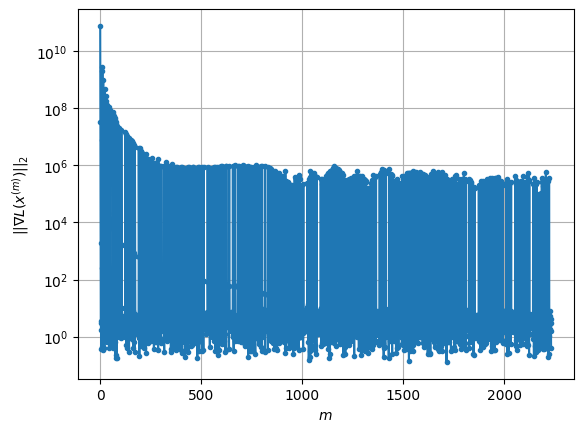

Windows:  92%|█████████▏| 273/296 [1:36:32<06:25, 16.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 805.0804869283171
Gradient norm: 415360.9990373027
Global relative error: 36.62128692565429
Position relative errors: 0.010352916480691575 m, 28.44090874236486 m, 0.37428990101789866 m, 23.06706951189601 m

Iteration 1
Cost function: 801.7759351525283 (-0.41%)
Gradient norm: 1.9000357775370964 (-100.00%)
Global relative error = 36.58334121494174 (-0.10%)
Position relative errors: 0.013839503627213704 m, 28.416195623931486 m, 0.3424655833788514 m, 23.037789420898218 m

Iteration 2
Cost function: 801.7759336558288 (-0.00%)
Gradient norm: 1.6222059602647947 (-14.62%)
Global relative error = 36.58334121220599 (-0.00%)
Position relative errors: 0.013839506789409645 m, 28.41619562442667 m, 0.3424655739846212 m, 23.037789416080866 m

Iteration 3
Cost function: 801.7759360544603 (0.00%)
Gradient norm: 1.8181722766414121 (12.08%)
Global relative error = 36.58334121214207 (-0.00%)
Position relative errors: 0.0138

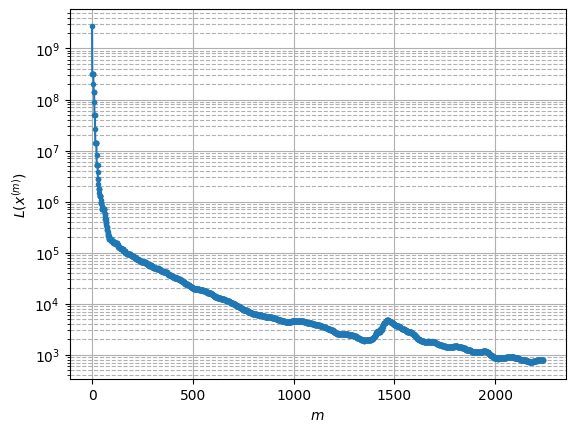

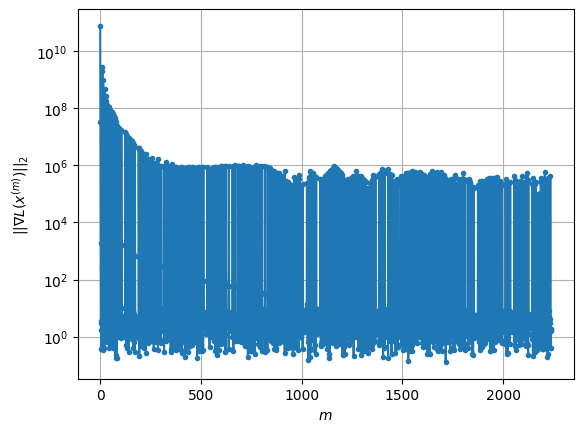

Windows:  93%|█████████▎| 274/296 [1:36:45<05:42, 15.56s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 797.1812482882071
Gradient norm: 270873.2852289163
Global relative error: 39.92462175026911
Position relative errors: 0.01384082669229259 m, 30.8273376853133 m, 0.7986655007636358 m, 25.35763120373064 m

Iteration 1
Cost function: 793.9807330651688 (-0.40%)
Gradient norm: 1.8808561284140821 (-100.00%)
Global relative error = 39.88702844541166 (-0.09%)
Position relative errors: 0.009235877957662146 m, 30.802353973389092 m, 0.8023288402443888 m, 25.328700338165298 m

STOP on Iteration 2
Cost function = 793.9807334810706 (0.00%)
Gradient norm = 0.7850029888852336 (-58.26%)
Global relative error = 39.88702843664277 (-0.00%)
Final position relative errors: 0.009235876903739412 m, 30.80235396974481 m, 0.8023288403078463 m, 25.32870032878646 m

Majorization-Minimization converged after 1 iterations


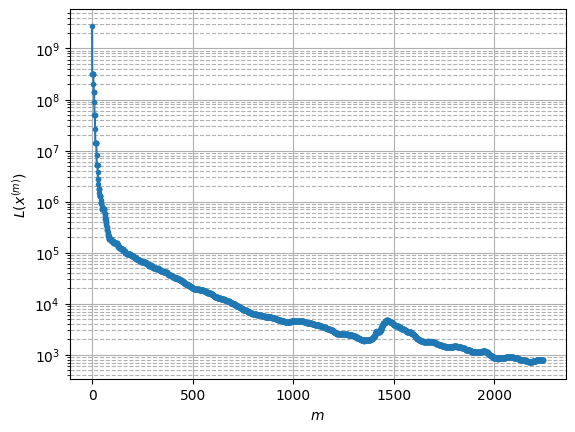

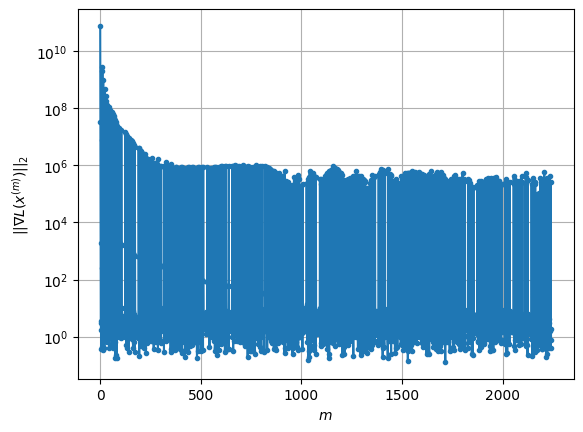

Windows:  93%|█████████▎| 275/296 [1:36:53<04:38, 13.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 790.7846201544447
Gradient norm: 312877.2047056323
Global relative error: 43.06982265704083
Position relative errors: 0.008949566787635475 m, 33.077799341831074 m, 1.6182445972409012 m, 27.536288587803554 m

STOP on Iteration 1
Cost function = 788.229530381814 (-0.32%)
Gradient norm = 0.43518967122054464 (-100.00%)
Global relative error = 43.033070837992746 (-0.09%)
Final position relative errors: 0.005829294614817415 m, 33.05054406610353 m, 1.6374436589156185 m, 27.510409691536566 m

Majorization-Minimization converged after 1 iterations


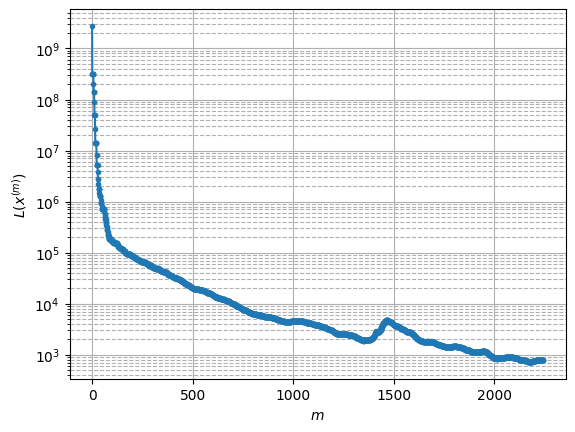

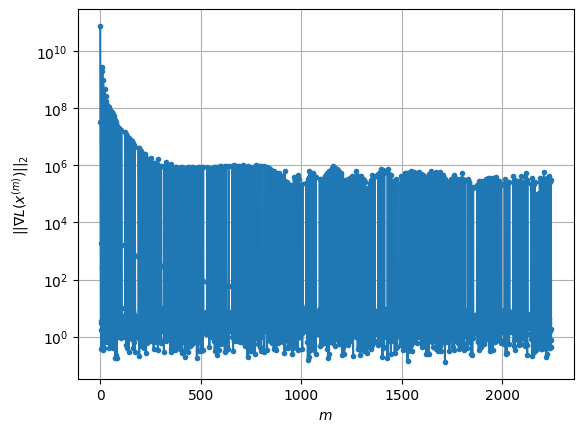

Windows:  93%|█████████▎| 276/296 [1:36:58<03:39, 10.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 786.8339450761439
Gradient norm: 269165.69022281264
Global relative error: 46.03970714372832
Position relative errors: 0.006290472261238065 m, 35.180453344433374 m, 2.4654169394104075 m, 29.595768547002287 m

Iteration 1
Cost function: 782.4841171908068 (-0.55%)
Gradient norm: 6.971778699731729 (-100.00%)
Global relative error = 46.00415750806904 (-0.08%)
Position relative errors: 0.010568961826827983 m, 35.15387314610745 m, 2.4883023893535525 m, 29.57014463301456 m

Iteration 2
Cost function: 782.484118488668 (0.00%)
Gradient norm: 2.0340992875546555 (-70.82%)
Global relative error = 46.004157501173935 (-0.00%)
Position relative errors: 0.010568955199325911 m, 35.15387314501389 m, 2.4883023943492986 m, 29.57014462316945 m

Iteration 3
Cost function: 782.4841190240344 (0.00%)
Gradient norm: 2.6597987749921526 (30.76%)
Global relative error = 46.00415750080453 (-0.00%)
Position relative errors: 0.0105689

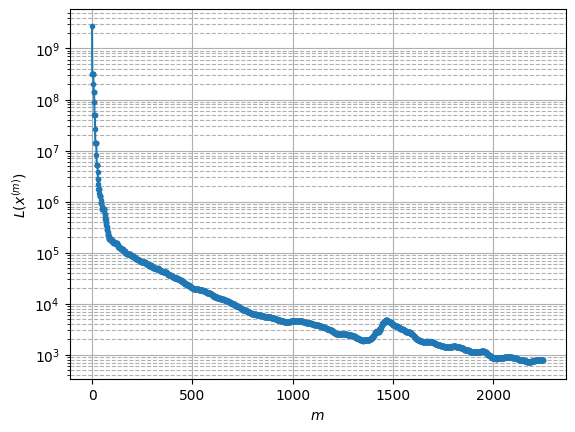

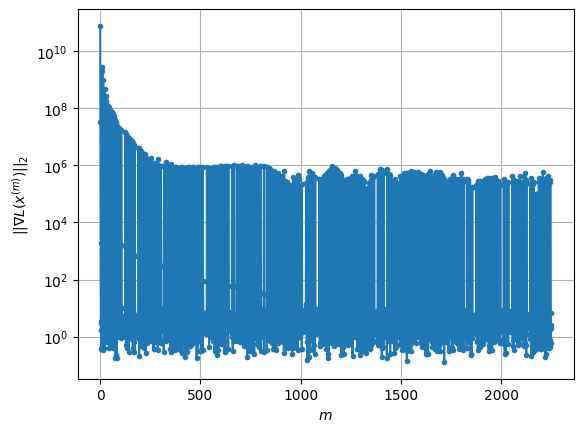

Windows:  94%|█████████▎| 277/296 [1:37:11<03:40, 11.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 771.7112652512205
Gradient norm: 219361.21130909064
Global relative error: 48.81885464294891
Position relative errors: 0.011580335491583759 m, 37.129057767737244 m, 3.308607560900798 m, 31.524029682745475 m

Iteration 1
Cost function: 768.6237053798562 (-0.40%)
Gradient norm: 2.6739962840110394 (-100.00%)
Global relative error = 48.784736999922536 (-0.07%)
Position relative errors: 0.018749158862562596 m, 37.10300866021944 m, 3.331394928315128 m, 31.499469826398805 m

STOP on Iteration 2
Cost function = 768.6237075934274 (0.00%)
Gradient norm = 0.6661310271560055 (-75.09%)
Global relative error = 48.784736991500765 (-0.00%)
Final position relative errors: 0.01874914835581315 m, 37.103008656838924 m, 3.331394932731209 m, 31.499469816876715 m

Majorization-Minimization converged after 1 iterations


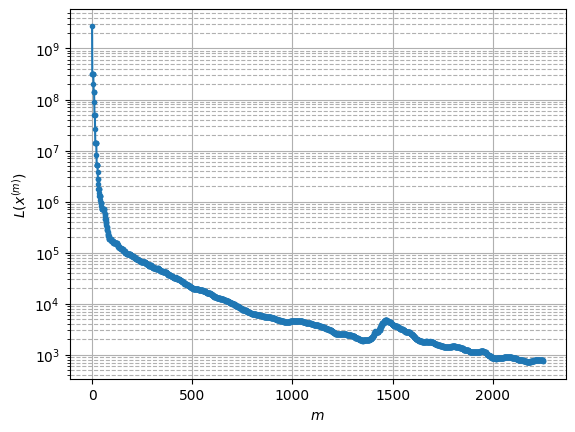

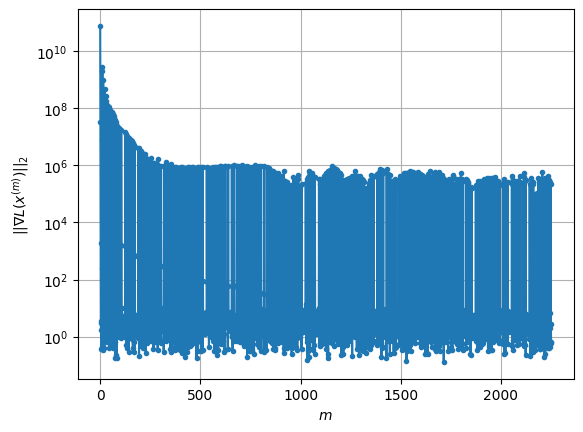

Windows:  94%|█████████▍| 278/296 [1:37:19<03:08, 10.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 751.880856536307
Gradient norm: 252637.19437391707
Global relative error: 51.39334273385135
Position relative errors: 0.01868331962201284 m, 38.91492489001687 m, 4.138537501780123 m, 33.3132797046829 m

Iteration 1
Cost function: 749.4152954053426 (-0.33%)
Gradient norm: 2.150224250302103 (-100.00%)
Global relative error = 51.36088625592714 (-0.06%)
Position relative errors: 0.02794591667613534 m, 38.88997165517283 m, 4.158734697168305 m, 33.28983383919801 m

Iteration 2
Cost function: 749.4152956056233 (0.00%)
Gradient norm: 4.327611662518737 (101.26%)
Global relative error = 51.360886247240266 (-0.00%)
Position relative errors: 0.02794592003214273 m, 38.88997165324516 m, 4.158734699267076 m, 33.289833827782495 m

STOP on Iteration 3
Cost function = 749.4152956524529 (0.00%)
Gradient norm = 0.7556674865789087 (-82.54%)
Global relative error = 51.3608862470522 (-0.00%)
Final position relative errors: 0.

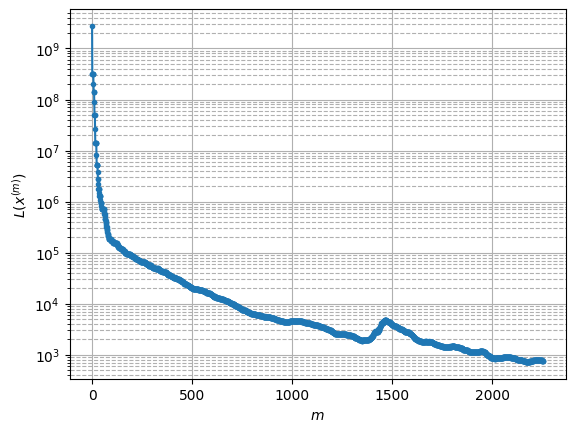

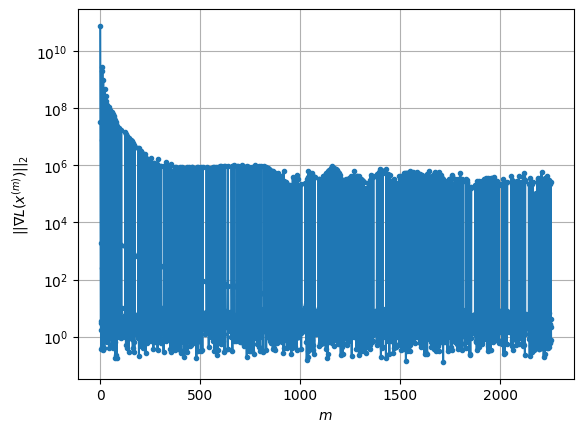

Windows:  94%|█████████▍| 279/296 [1:37:30<03:00, 10.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 742.2222176775218
Gradient norm: 241446.64288478557
Global relative error: 53.750799537198944
Position relative errors: 0.027263404164864426 m, 40.53087274735659 m, 4.949176580396549 m, 34.955688653919104 m

Iteration 1
Cost function: 740.1907225418252 (-0.27%)
Gradient norm: 1.7604450761375319 (-100.00%)
Global relative error = 53.719020933850906 (-0.06%)
Position relative errors: 0.027456827873190825 m, 40.50616756671839 m, 4.967766932518907 m, 34.93282975996116 m

Iteration 2
Cost function: 740.1907201515505 (-0.00%)
Gradient norm: 4.038011865578477 (129.37%)
Global relative error = 53.71902092468691 (-0.00%)
Position relative errors: 0.027456832548887145 m, 40.50616756248712 m, 4.967766933540854 m, 34.93282975062628 m

Iteration 3
Cost function: 740.1907211293823 (0.00%)
Gradient norm: 1.8671184707568993 (-53.76%)
Global relative error = 53.71902092427047 (-0.00%)
Position relative errors: 0.0274568

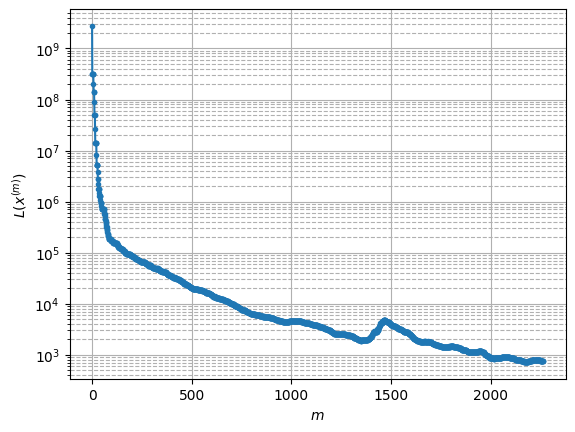

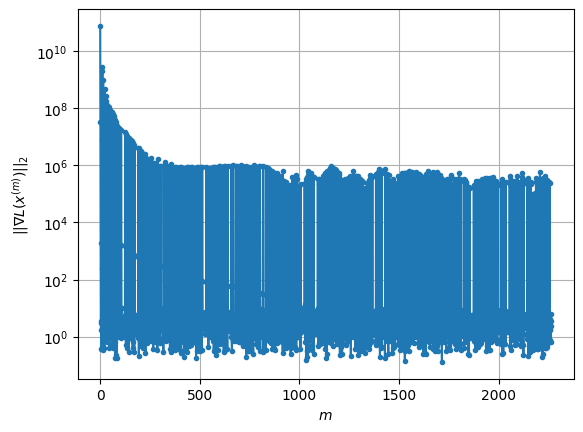

Windows:  95%|█████████▍| 280/296 [1:37:51<03:37, 13.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 732.7602668388353
Gradient norm: 176782.20876032513
Global relative error: 55.87895927449945
Position relative errors: 0.027338194074011873 m, 41.969021336506394 m, 5.737736013323846 m, 36.44359644426682 m

Iteration 1
Cost function: 730.580586535258 (-0.30%)
Gradient norm: 4.200128009757664 (-100.00%)
Global relative error = 55.848098005079315 (-0.06%)
Position relative errors: 0.030945928860371674 m, 41.94383211728343 m, 5.754740339272683 m, 36.422599461915944 m

Iteration 2
Cost function: 730.5805870248576 (0.00%)
Gradient norm: 2.795686725400912 (-33.44%)
Global relative error = 55.84809799681065 (-0.00%)
Position relative errors: 0.0309459277942765 m, 41.94383211450582 m, 5.754740340898631 m, 36.42259945217997 m

Iteration 3
Cost function: 730.5805879067333 (0.00%)
Gradient norm: 1.6112643418409798 (-42.37%)
Global relative error = 55.848097996850704 (0.00%)
Position relative errors: 0.030945936853

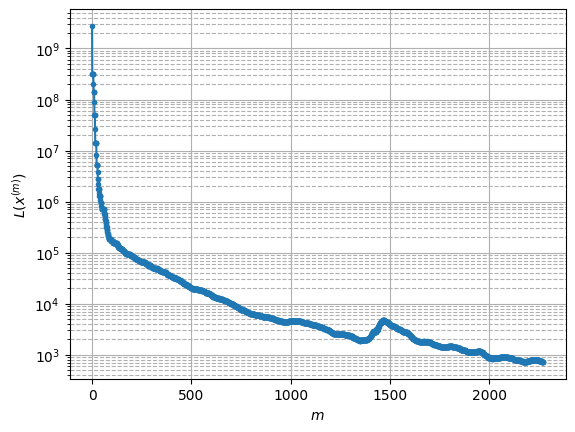

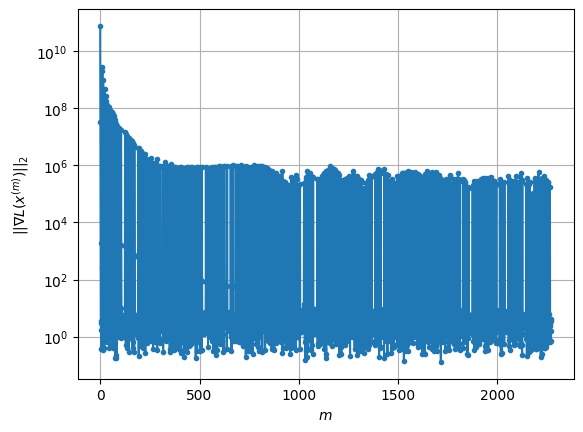

Windows:  95%|█████████▍| 281/296 [1:38:08<03:40, 14.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 720.9750862000756
Gradient norm: 401611.9294043034
Global relative error: 57.76804204317685
Position relative errors: 0.030468325053510038 m, 43.22242544943815 m, 6.500529928193675 m, 37.771812440989656 m

Iteration 1
Cost function: 717.8463293218728 (-0.43%)
Gradient norm: 4.546592938845905 (-100.00%)
Global relative error = 57.738905855339375 (-0.05%)
Position relative errors: 0.02310216558093311 m, 43.19794423754204 m, 6.51709978514039 m, 37.75241387694772 m

Iteration 2
Cost function: 717.8463291426979 (-0.00%)
Gradient norm: 5.4058789942474474 (18.90%)
Global relative error = 57.73890584624407 (-0.00%)
Position relative errors: 0.023102165064963865 m, 43.19794423319518 m, 6.517099787358379 m, 37.75241386762859 m

Iteration 3
Cost function: 717.8463282317749 (-0.00%)
Gradient norm: 4.420761470822639 (-18.22%)
Global relative error = 57.738905846460156 (0.00%)
Position relative errors: 0.023102165815

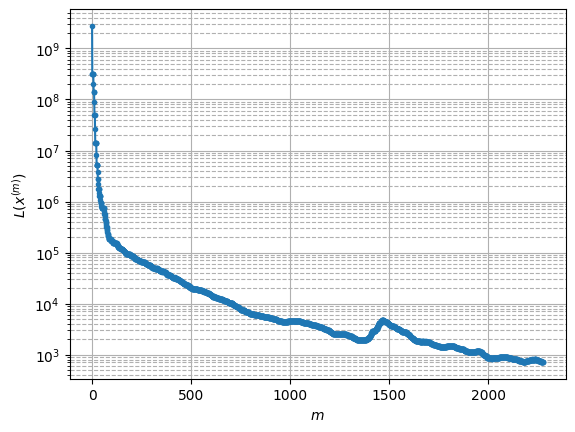

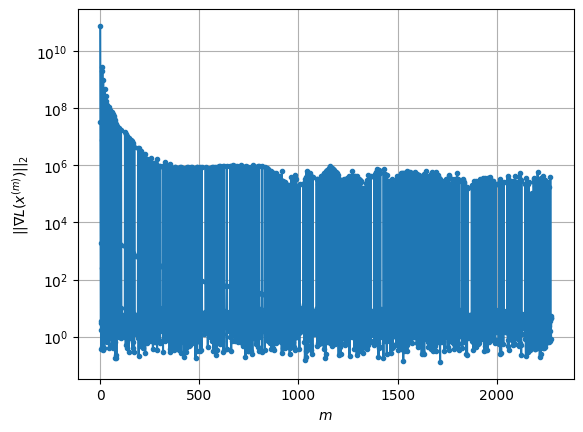

Windows:  95%|█████████▌| 282/296 [1:38:21<03:18, 14.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 709.7715290478311
Gradient norm: 155665.92458427898
Global relative error: 59.40994898141718
Position relative errors: 0.023384236791850328 m, 44.28683953920741 m, 7.23449953881201 m, 38.93428570567306 m

STOP on Iteration 1
Cost function = 707.4084099427631 (-0.33%)
Gradient norm = 0.7101943424087807 (-100.00%)
Global relative error = 59.381238573112 (-0.05%)
Final position relative errors: 0.02831369978258903 m, 44.26234437521529 m, 7.249204233386721 m, 38.915599108023216 m

Majorization-Minimization converged after 1 iterations


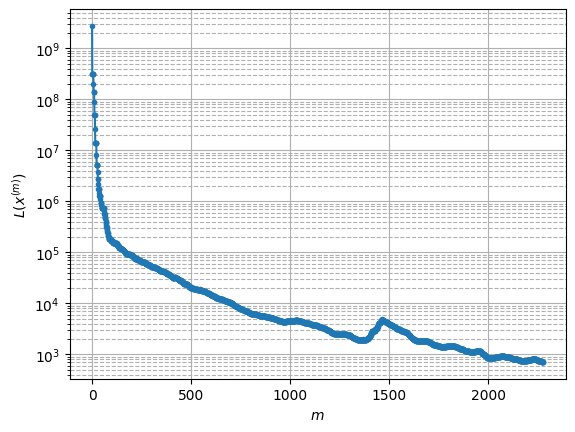

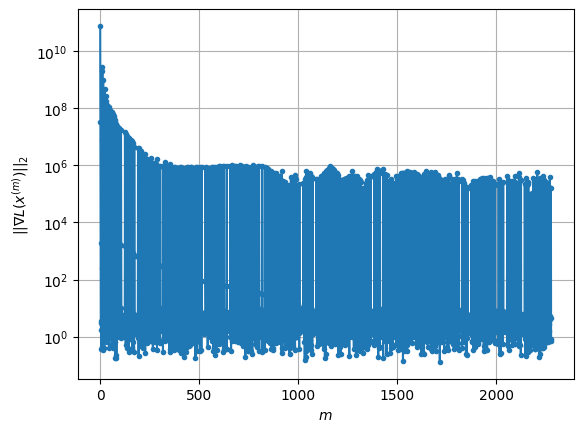

Windows:  96%|█████████▌| 283/296 [1:38:26<02:30, 11.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 704.3114088000891
Gradient norm: 162379.36304748675
Global relative error: 60.795931324903236
Position relative errors: 0.0282945682526598 m, 45.15699287662247 m, 7.935095938377297 m, 39.92523226902954 m

Iteration 1
Cost function: 701.8934591934355 (-0.34%)
Gradient norm: 4.671143322319108 (-100.00%)
Global relative error = 60.76812323847438 (-0.05%)
Position relative errors: 0.025553541794828227 m, 45.13264903625413 m, 7.948482073360865 m, 39.90775905353422 m

Iteration 2
Cost function: 701.8934575438211 (-0.00%)
Gradient norm: 6.6366469793509655 (42.08%)
Global relative error = 60.76812323291205 (-0.00%)
Position relative errors: 0.02555355711900385 m, 45.13264903329514 m, 7.94848207460753 m, 39.90775904815268 m

Iteration 3
Cost function: 701.8934595694567 (0.00%)
Gradient norm: 5.545134999205772 (-16.45%)
Global relative error = 60.76812323256325 (-0.00%)
Position relative errors: 0.025553547833544

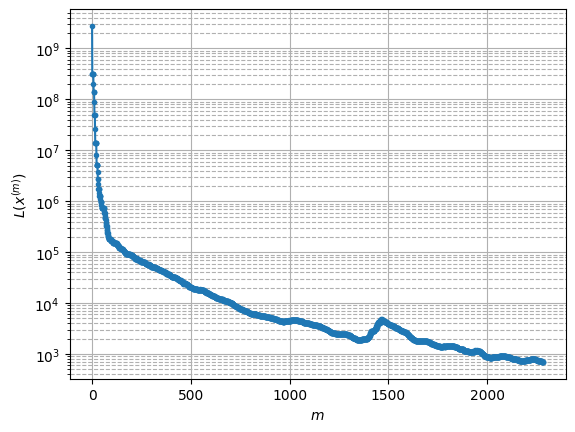

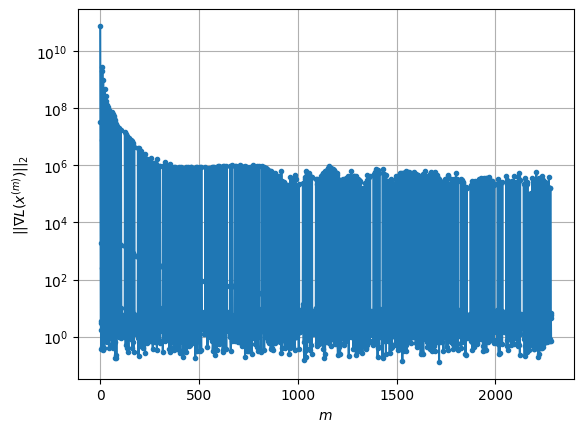

Windows:  96%|█████████▌| 284/296 [1:38:39<02:22, 11.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 701.9422091844887
Gradient norm: 286379.56150144595
Global relative error: 61.92018183373367
Position relative errors: 0.025665068206146266 m, 45.82932815608778 m, 8.599528221647079 m, 40.740995166018784 m

Iteration 1
Cost function: 699.7617969502958 (-0.31%)
Gradient norm: 1.5908113643303954 (-100.00%)
Global relative error = 61.89174558499676 (-0.05%)
Position relative errors: 0.022323709896231756 m, 45.80452194610289 m, 8.611854298161141 m, 40.7230774921807 m

Iteration 2
Cost function: 699.761795995699 (-0.00%)
Gradient norm: 1.3825151459531182 (-13.09%)
Global relative error = 61.89174557843919 (-0.00%)
Position relative errors: 0.022323713399067673 m, 45.804521942320136 m, 8.611854300262856 m, 40.723077486022774 m

Iteration 3
Cost function: 699.7617971034726 (0.00%)
Gradient norm: 1.125236110868804 (-18.61%)
Global relative error = 61.891745578671674 (0.00%)
Position relative errors: 0.022323713

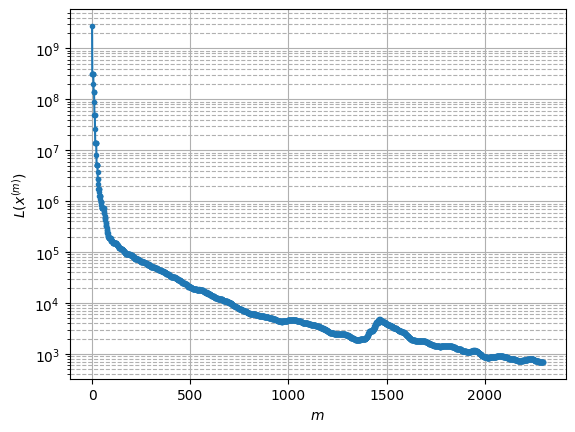

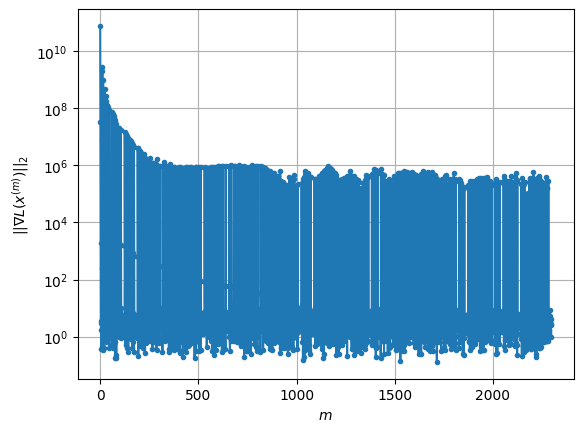

Windows:  96%|█████████▋| 285/296 [1:39:16<03:34, 19.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 704.4400410905049
Gradient norm: 338499.76054978324
Global relative error: 62.77627272479978
Position relative errors: 0.023002858254263472 m, 46.30044567987765 m, 9.224921398551116 m, 41.37667471040197 m

Iteration 1
Cost function: 702.2521945693122 (-0.31%)
Gradient norm: 5.24105295057628 (-100.00%)
Global relative error = 62.747544518021215 (-0.05%)
Position relative errors: 0.0226345955699719 m, 46.274940080746994 m, 9.236824310905382 m, 41.35897236075238 m

Iteration 2
Cost function: 702.2521941621835 (-0.00%)
Gradient norm: 4.875877699333341 (-6.97%)
Global relative error = 62.747544508217096 (-0.00%)
Position relative errors: 0.022634597571261312 m, 46.27494007206285 m, 9.23682431216876 m, 41.358972355311224 m

Iteration 3
Cost function: 702.2521939094044 (-0.00%)
Gradient norm: 1.94001352586042 (-60.21%)
Global relative error = 62.74754450770476 (-0.00%)
Position relative errors: 0.0226345950256

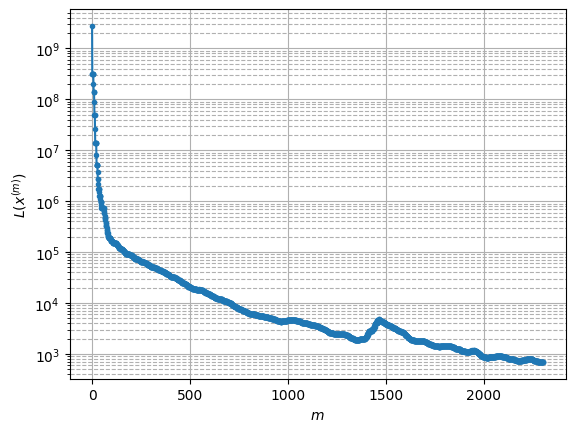

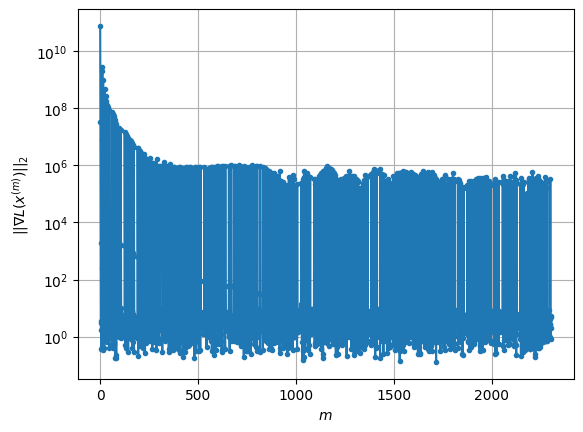

Windows:  97%|█████████▋| 286/296 [1:39:30<02:56, 17.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 704.6478405194756
Gradient norm: 151580.19033514953
Global relative error: 63.36087603131541
Position relative errors: 0.023620083480490363 m, 46.568203193334526 m, 9.808934172950933 m, 41.83045752424179 m

STOP on Iteration 1
Cost function = 703.3651547222144 (-0.18%)
Gradient norm = 0.4760057172030375 (-100.00%)
Global relative error = 63.33076522365671 (-0.05%)
Final position relative errors: 0.02409553479450503 m, 46.54179738763731 m, 9.820829733591983 m, 41.81145182638346 m

Majorization-Minimization converged after 1 iterations


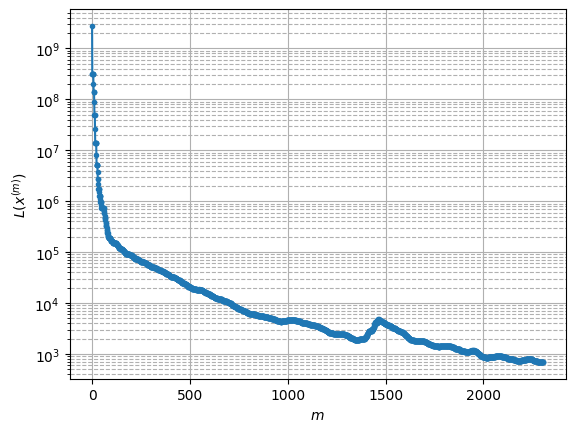

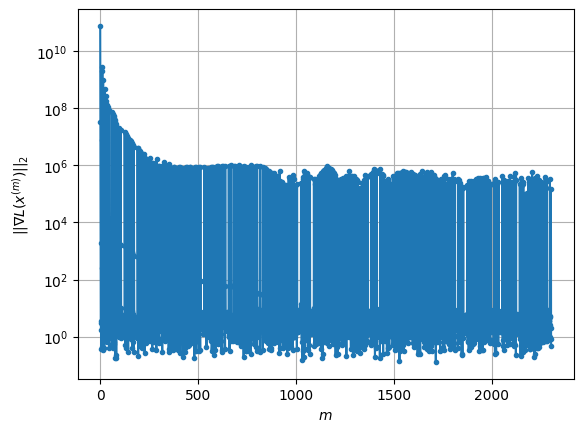

Windows:  97%|█████████▋| 287/296 [1:39:35<02:05, 13.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 702.1745371724512
Gradient norm: 355736.0924563873
Global relative error: 63.67057473057082
Position relative errors: 0.024984683126648463 m, 46.63144040758036 m, 10.349198432980746 m, 42.099218922751405 m

STOP on Iteration 1
Cost function = 700.5687911841884 (-0.23%)
Gradient norm = 0.4968516658811534 (-100.00%)
Global relative error = 63.641079282412434 (-0.05%)
Final position relative errors: 0.027685452838305098 m, 46.60345670090171 m, 10.361499016691615 m, 42.08257693495648 m

Majorization-Minimization converged after 1 iterations


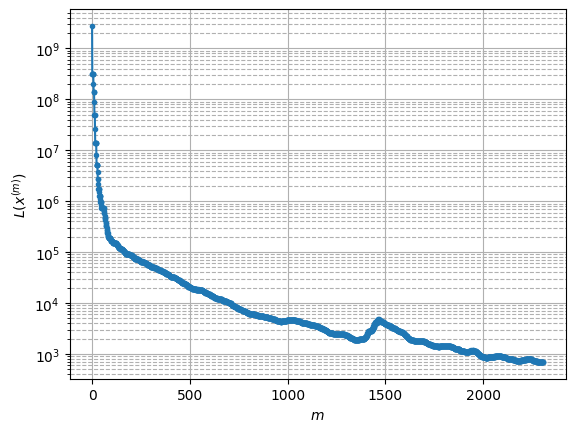

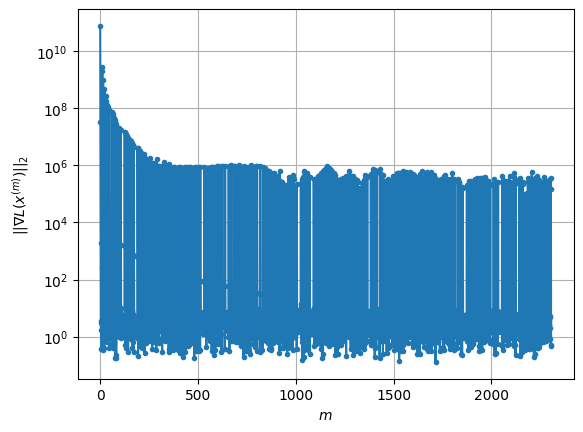

Windows:  97%|█████████▋| 288/296 [1:39:41<01:31, 11.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 708.8422434928855
Gradient norm: 158324.24064539513
Global relative error: 63.70613274236575
Position relative errors: 0.02849832492718476 m, 46.48934830497847 m, 10.843566433858921 m, 42.185637634957246 m

Iteration 1
Cost function: 707.3825647825363 (-0.21%)
Gradient norm: 1.0463242460753963 (-100.00%)
Global relative error = 63.675214554939465 (-0.05%)
Position relative errors: 0.03131199710018815 m, 46.46112974613502 m, 10.85616702587996 m, 42.16679917901824 m

Iteration 2
Cost function: 707.3825650044738 (0.00%)
Gradient norm: 1.1588042274115933 (10.75%)
Global relative error = 63.67521454841883 (-0.00%)
Position relative errors: 0.031311997118449626 m, 46.46112974026901 m, 10.856167027987418 m, 42.166799175092386 m

Iteration 3
Cost function: 707.3825642416652 (-0.00%)
Gradient norm: 2.205290649042437 (90.31%)
Global relative error = 63.67521454856035 (0.00%)
Position relative errors: 0.0313119951

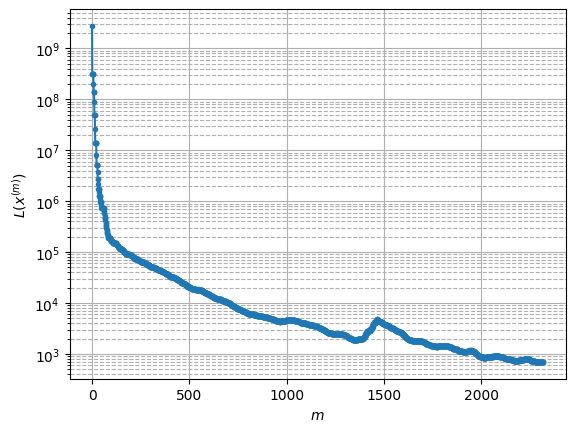

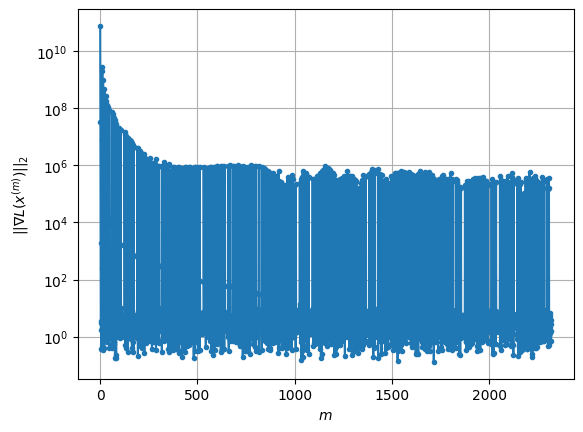

Windows:  98%|█████████▊| 289/296 [1:40:10<01:58, 16.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 709.8077187555905
Gradient norm: 235953.62452896681
Global relative error: 63.46567933188955
Position relative errors: 0.0323239600272983 m, 46.143989892300226 m, 11.289588201940205 m, 42.085255089912685 m

Iteration 1
Cost function: 708.6627868228659 (-0.16%)
Gradient norm: 3.398923360686867 (-100.00%)
Global relative error = 63.43520838977884 (-0.05%)
Position relative errors: 0.030876459750821827 m, 46.11571246228082 m, 11.301708979451755 m, 42.067054104069705 m

Iteration 2
Cost function: 708.6627868406698 (0.00%)
Gradient norm: 2.966218259958061 (-12.73%)
Global relative error = 63.43520838468508 (-0.00%)
Position relative errors: 0.0308764610282669 m, 46.11571245931271 m, 11.30170897937409 m, 42.06705409966223 m

STOP on Iteration 3
Cost function = 708.6627874577712 (0.00%)
Gradient norm = 0.4064418776941751 (-86.30%)
Global relative error = 63.435208384446945 (-0.00%)
Final position relative erro

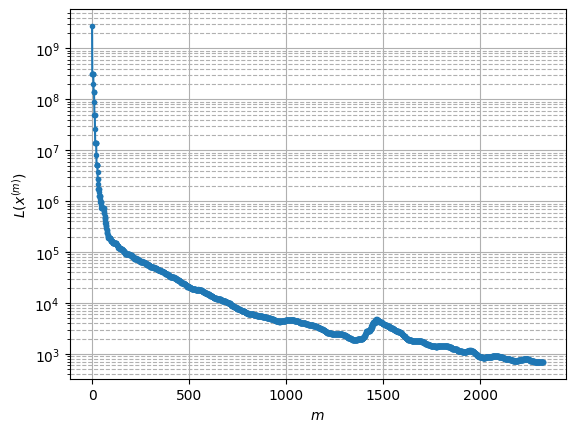

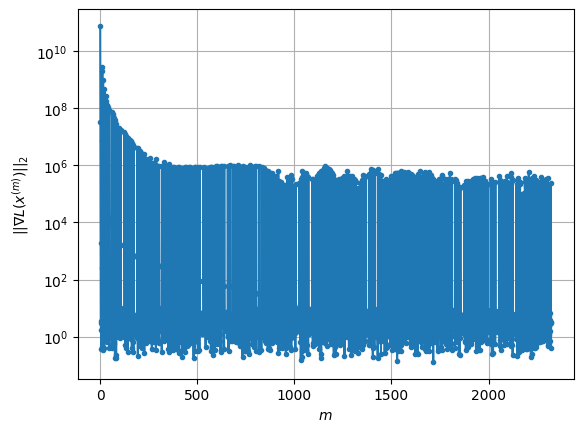

Windows:  98%|█████████▊| 290/296 [1:40:21<01:29, 14.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 721.7394370528605
Gradient norm: 325520.5915998925
Global relative error: 62.95240558270364
Position relative errors: 0.0317270939067216 m, 45.59717213003702 m, 11.684410889461292 m, 41.801634141931174 m

STOP on Iteration 1
Cost function = 719.7986534224258 (-0.27%)
Gradient norm = 0.5474259425992317 (-100.00%)
Global relative error = 62.920420987617085 (-0.05%)
Final position relative errors: 0.024854864162271683 m, 45.570581658084016 m, 11.697246936495182 m, 41.77888318500966 m

Majorization-Minimization converged after 1 iterations


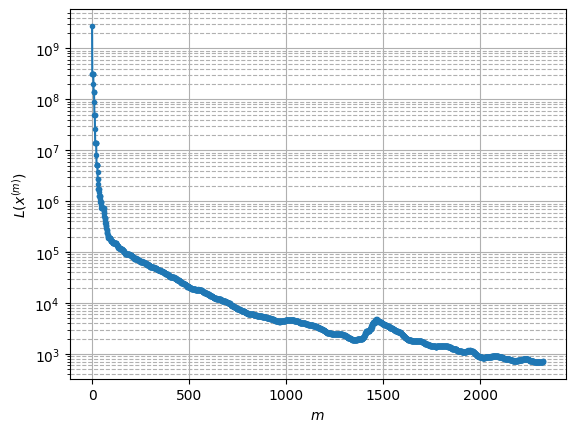

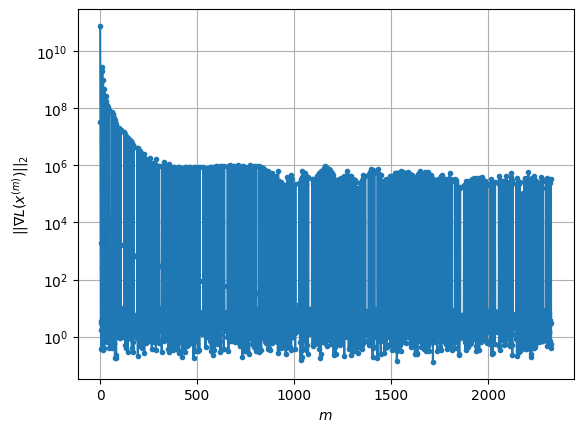

Windows:  98%|█████████▊| 291/296 [1:40:26<01:00, 12.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 724.8330941250911
Gradient norm: 180284.51832593358
Global relative error: 62.16706477997487
Position relative errors: 0.025413698270466866 m, 44.85312131534964 m, 12.027361677102398 m, 41.331381323005765 m

Iteration 1
Cost function: 723.6886115473451 (-0.16%)
Gradient norm: 1.3707802607839699 (-100.00%)
Global relative error = 62.13367172762554 (-0.05%)
Position relative errors: 0.027472920585619953 m, 44.82594567849517 m, 12.040287744466509 m, 41.30687810197112 m

Iteration 2
Cost function: 723.6886112341004 (-0.00%)
Gradient norm: 3.8743558082905776 (182.64%)
Global relative error = 62.133671718390275 (-0.00%)
Position relative errors: 0.027472914681043403 m, 44.8259456700916 m, 12.040287744966955 m, 41.30687809705701 m



In [ ]:
# Main execution loop
def run_estimation():
    
    Y = np.zeros((9, 1, T))
    for t in range(T):
        Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
        
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = MM_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

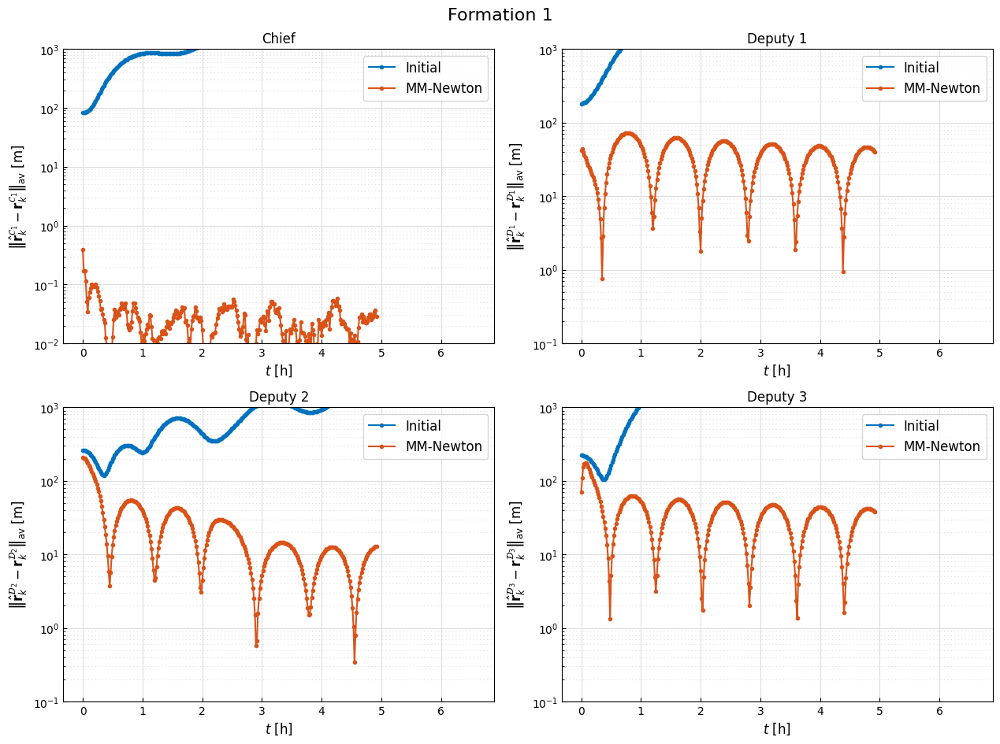

In [25]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "MM-Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [32]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm

# Save to pickle file
with open(
    f'mm_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)